# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 449kB/s]
100% 255k/255k [00:00<00:00, 448kB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

100% 66.1k/66.1k [00:00<00:00, 423kB/s]
100% 66.1k/66.1k [00:00<00:00, 423kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:50<00:00, 23.3MB/s]
100% 1.09G/1.09G [00:50<00:00, 23.1MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.6 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 31.1 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
import torchvision.models as models

In [ ]:
from scipy.stats import spearmanr

# Preprocess & Split

In [ ]:
df_landscape = pd.read_csv("/content/landscape.csv")
df_landscape["image_file"] =df_landscape["image_file"].apply(lambda file: "/content/landscape" +"/"+ file) # Create image path
df_landscape["memorability_wo_fa_correction"] = df_landscape["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_landscape.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,4001,/content/landscape/00da7332b7397d6f.jpg,landscape,badlands,342.0,455.0,open images,Badlands,0.111134,67,16,116,0.577586,0.439655
1,4002,/content/landscape/059749eaad9544d9.jpg,landscape,badlands,303.0,404.0,open images,Badlands,0.123819,47,10,103,0.456311,0.359223
2,4003,/content/landscape/0a41e7b2e1f24787.jpg,landscape,badlands,259.0,346.0,open images,Badlands,0.135316,55,11,108,0.509259,0.407407
3,4004,/content/landscape/0bdbfdfbf9606d17.jpg,landscape,badlands,449.0,673.0,open images,Badlands,0.129940,75,1,95,0.789474,0.778947
4,4005,/content/landscape/0c25ec21ea3806e6.jpg,landscape,badlands,389.0,519.0,open images,Badlands,0.200469,71,2,90,0.788889,0.766667


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 117.6827192416029
Standard deviation of pixel values: 66.35625502037836


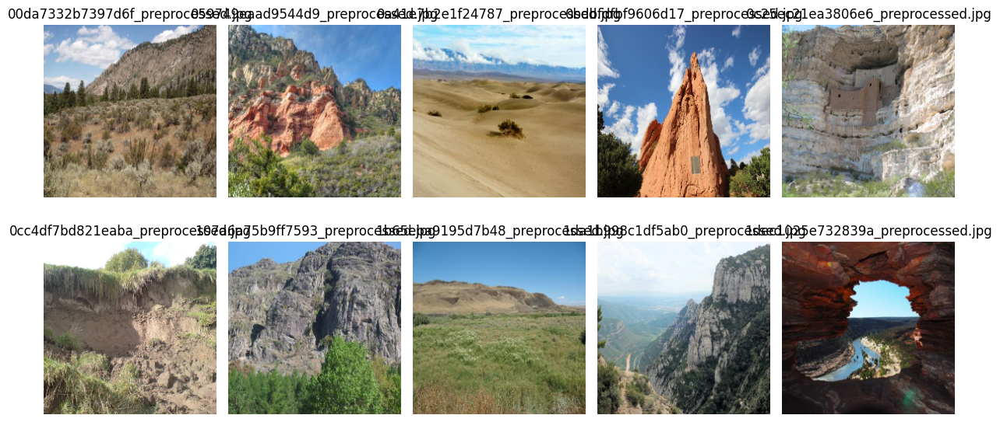

In [ ]:
# Sample data (replace this with your DataFrame)
df_landscape= pd.DataFrame({
    'image_file': df_landscape["image_file"],
    'memoscore': df_landscape["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_landscape['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_landscape.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_landscape.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_landscape.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_landscape.head()

,image_file,memoscore,preprocessed_image_path
0,/content/landscape/00da7332b7397d6f.jpg,0.577586,/content/landscape/00da7332b7397d6f_preprocess...
1,/content/landscape/059749eaad9544d9.jpg,0.456311,/content/landscape/059749eaad9544d9_preprocess...
2,/content/landscape/0a41e7b2e1f24787.jpg,0.509259,/content/landscape/0a41e7b2e1f24787_preprocess...
3,/content/landscape/0bdbfdfbf9606d17.jpg,0.789474,/content/landscape/0bdbfdfbf9606d17_preprocess...
4,/content/landscape/0c25ec21ea3806e6.jpg,0.788889,/content/landscape/0c25ec21ea3806e6_preprocess...


In [ ]:
del df_landscape["image_file"]

In [ ]:
df_landscape.head()

,memoscore,preprocessed_image_path
0,0.577586,/content/landscape/00da7332b7397d6f_preprocess...
1,0.456311,/content/landscape/059749eaad9544d9_preprocess...
2,0.509259,/content/landscape/0a41e7b2e1f24787_preprocess...
3,0.789474,/content/landscape/0bdbfdfbf9606d17_preprocess...
4,0.788889,/content/landscape/0c25ec21ea3806e6_preprocess...


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_landscape.drop('memoscore', axis=1)), pd.DataFrame(df_landscape['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
394,/content/landscape/n09393605_61113_preprocesse...
545,/content/landscape/sun_acivpotgwohctvsc_prepro...
182,/content/landscape/01bd4bab4175a966_preprocess...
1480,/content/landscape/n09421951_11154_preprocesse...
1041,/content/landscape/n09359803_32774_preprocesse...


In [ ]:
merged_train_landscape= pd.concat([X_train, y_train], axis=1)
merged_train_landscape

,preprocessed_image_path,memoscore
394,/content/landscape/n09393605_61113_preprocesse...,0.622222
545,/content/landscape/sun_acivpotgwohctvsc_prepro...,0.446429
182,/content/landscape/01bd4bab4175a966_preprocess...,0.563636
1480,/content/landscape/n09421951_11154_preprocesse...,0.645455
1041,/content/landscape/n09359803_32774_preprocesse...,0.500000
...,...,...
1518,/content/landscape/n09428293_28986_preprocesse...,0.430108
508,/content/landscape/sun_asitqcjdhmptwyly_prepro...,0.509259
1083,/content/landscape/n07801091_55837_preprocesse...,0.365591
775,/content/landscape/n09309168_432_preprocessed.jpg,0.598039


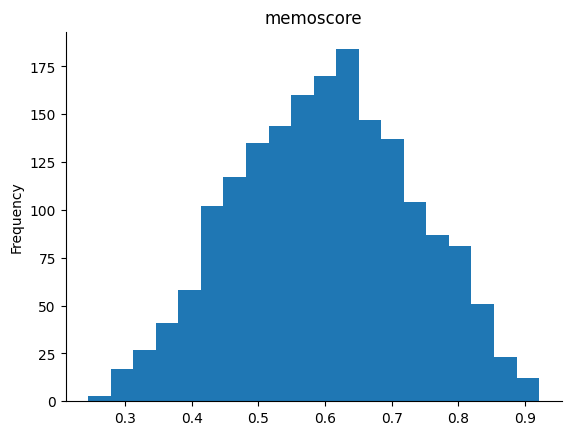

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_train_landscape['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_val_landscape = pd.concat([X_val, y_val], axis=1)
merged_val_landscape

,preprocessed_image_path,memoscore
816,/content/landscape/a017ac25346efdcd_preprocess...,0.522222
1055,/content/landscape/n09359803_42313_preprocesse...,0.669565
1811,/content/landscape/sun_anlbtbdfjkxivzbt_prepro...,0.715686
223,/content/landscape/be3ff20a17c22e90_preprocess...,0.520833
1992,/content/landscape/n04587559_13370_preprocesse...,0.768421
...,...,...
754,/content/landscape/n09308572_3703_preprocessed...,0.731183
1245,/content/landscape/n09415671_16809_preprocesse...,0.591837
426,/content/landscape/sun_acfbqplfoqfohnbj_prepro...,0.543689
1213,/content/landscape/sun_apdbcyzwitltnzyz_prepro...,0.644444


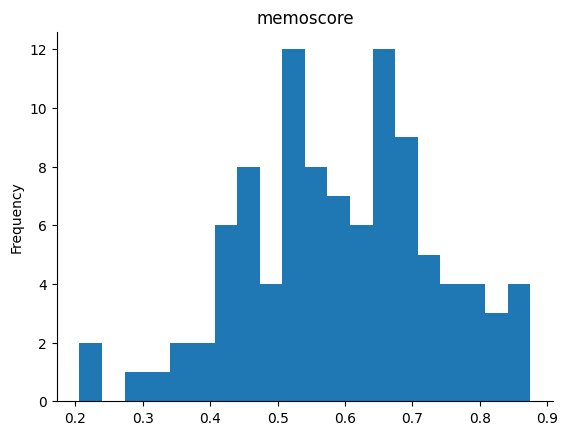

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_val_landscape['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_test_landscape = pd.concat([X_test, y_test], axis=1)
merged_test_landscape

,preprocessed_image_path,memoscore
1617,/content/landscape/n09468604_18462_preprocesse...,0.536364
1285,/content/landscape/n09415671_820_preprocessed.jpg,0.586957
109,/content/landscape/n02793495_14549_preprocesse...,0.706422
1233,/content/landscape/n09415671_1275_preprocessed...,0.509434
163,/content/landscape/n02793495_7388_preprocessed...,0.726316
...,...,...
1356,/content/landscape/e2fc18d1ca1800c0_preprocess...,0.405941
814,/content/landscape/954ef758d906cb65_preprocess...,0.479167
1881,/content/landscape/15268687891e8808_preprocess...,0.680851
1723,/content/landscape/n09472597_22017_preprocesse...,0.495146


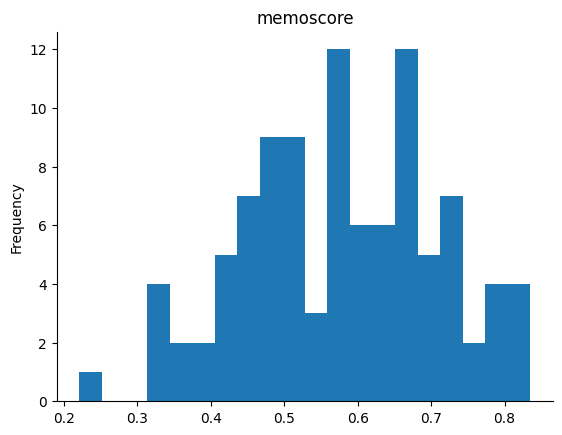

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_landscape['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/landscape_Vit+Res.csv'
merged_train_landscape.to_csv(csv_train_landscape, index=False)

In [ ]:
csv_val_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/landscape_Vit+Res.csv'
merged_val_landscape.to_csv(csv_val_landscape, index=False)

In [ ]:
csv_test_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/landscape_Vit+Res.csv'
merged_test_landscape.to_csv(csv_test_landscape, index=False)

#Load Dataset

In [ ]:
df_train_landscape = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/landscape_Vit+Res.csv")
df_val_landscape = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/landscape_Vit+Res.csv')
df_test_landscape = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/landscape_Vit+Res.csv')

In [ ]:
df_train_landscape.head()

,preprocessed_image_path,memoscore
0,/content/landscape/n09393605_61113_preprocesse...,0.622222
1,/content/landscape/sun_acivpotgwohctvsc_prepro...,0.446429
2,/content/landscape/01bd4bab4175a966_preprocess...,0.563636
3,/content/landscape/n09421951_11154_preprocesse...,0.645455
4,/content/landscape/n09359803_32774_preprocesse...,0.500000


In [ ]:
df_train_landscape.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_landscape(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_landscape(df_train_landscape, trans_transform=trans_transform, res_transform=res_transform)
train_dl = DataLoader(train_ds, batch_size=16, shuffle= False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 187MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

In [ ]:
print(trans_layer_norm )

LayerNorm((768,), eps=1e-12, elementwise_affine=True)


In [ ]:
print(layers_trans)

[ViTEmbeddings(
  (patch_embeddings): ViTPatchEmbeddings(
    (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  )
  (dropout): Dropout(p=0.0, inplace=False)
), ViTEncoder(
  (layer): ModuleList(
    (0-11): 12 x ViTLayer(
      (attention): ViTAttention(
        (attention): ViTSelfAttention(
          (query): Linear(in_features=768, out_features=768, bias=True)
          (key): Linear(in_features=768, out_features=768, bias=True)
          (value): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (output): ViTSelfOutput(
          (dense): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
      (intermediate): ViTIntermediate(
        (dense): Linear(in_features=768, out_features=3072, bias=True)
        (intermediate_act_fn): GELUActivation()
      )
      (output): ViTOutput(
        (dense): Linear(in_features=3072, ou

In [ ]:
# Merge the two models
class model_merge_landscape(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_landscape(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.12440140545368195

 Epoch: (1/50) Loss_rmse = 0.35270583629608154

 Epoch: (1/50) R^2 = -6.430692672729492

 Epoch: (1/50) MAE = 0.2864397168159485

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4642

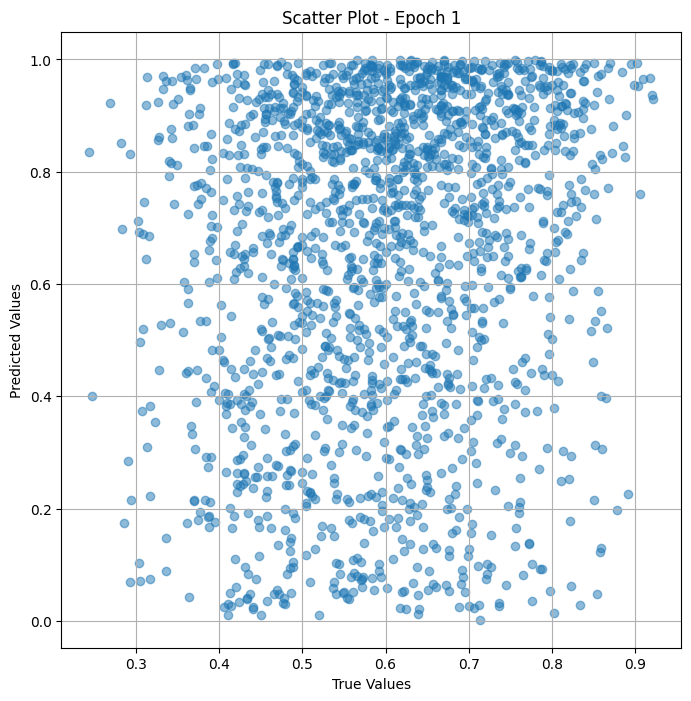


 Epoch: (2/50) Loss = 0.11333820223808289

 Epoch: (2/50) Loss_rmse = 0.33665740489959717

 Epoch: (2/50) R^2 = -5.769869804382324

 Epoch: (2/50) MAE = 0.29025766253471375

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.464

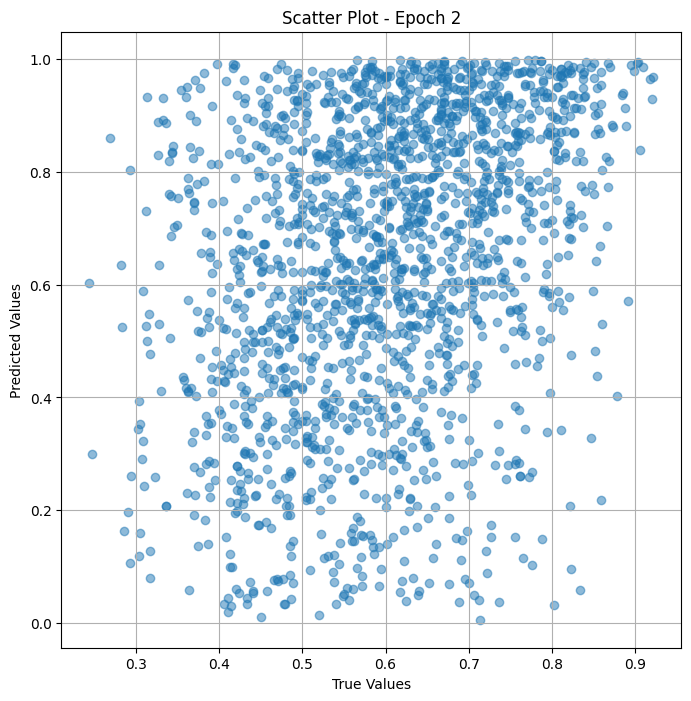


 Epoch: (3/50) Loss = 0.08444732427597046

 Epoch: (3/50) Loss_rmse = 0.29059821367263794

 Epoch: (3/50) R^2 = -4.044172286987305

 Epoch: (3/50) MAE = 0.2545454502105713

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4642

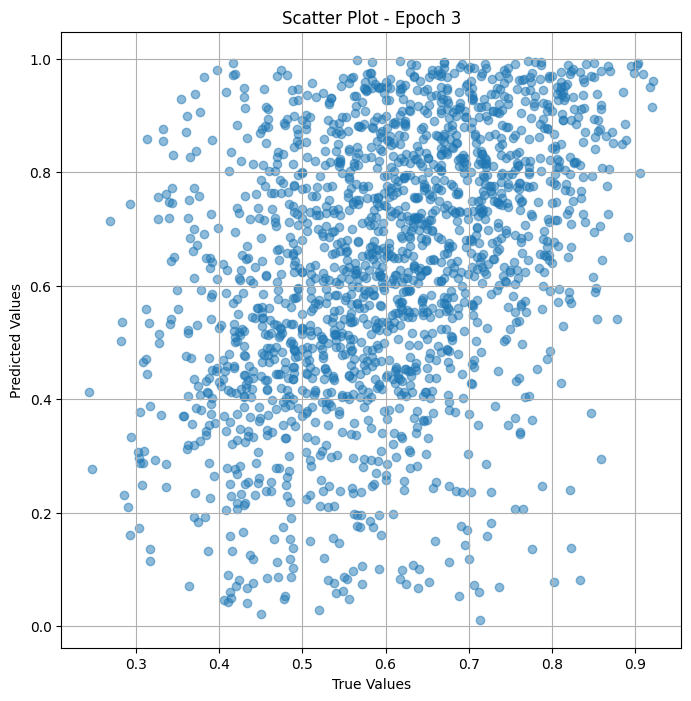


 Epoch: (4/50) Loss = 0.048515111207962036

 Epoch: (4/50) Loss_rmse = 0.22026145458221436

 Epoch: (4/50) R^2 = -1.8978843688964844

 Epoch: (4/50) MAE = 0.19238018989562988

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

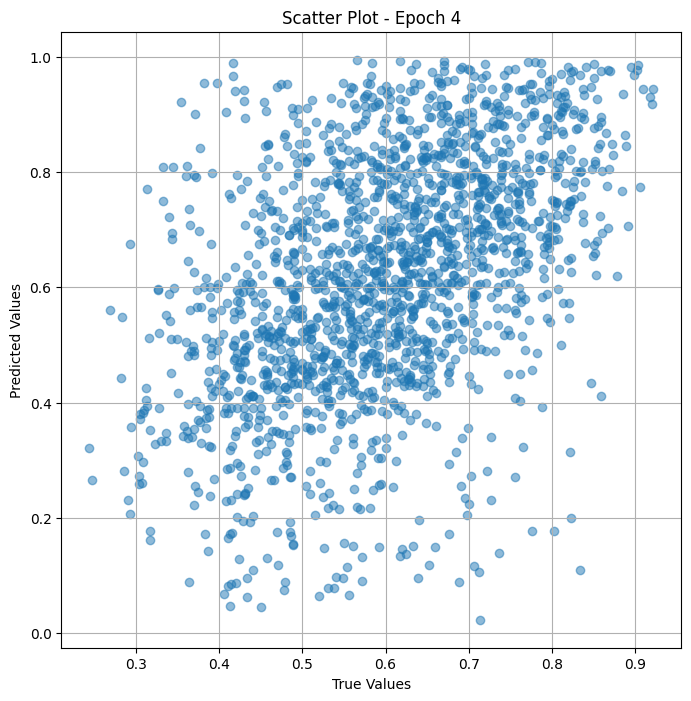


 Epoch: (5/50) Loss = 0.02074013091623783

 Epoch: (5/50) Loss_rmse = 0.14401434361934662

 Epoch: (5/50) R^2 = -0.23884081840515137

 Epoch: (5/50) MAE = 0.12719649076461792

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

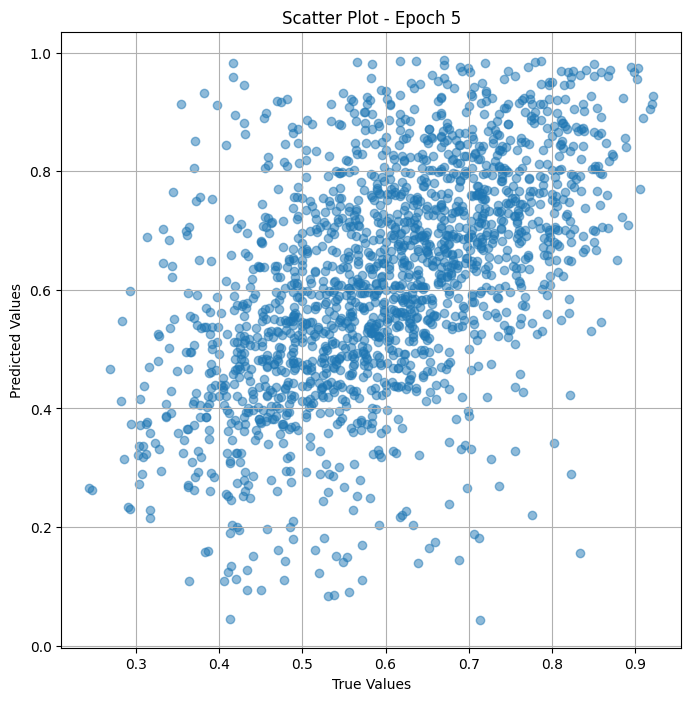


 Epoch: (6/50) Loss = 0.007016422227025032

 Epoch: (6/50) Loss_rmse = 0.08376408368349075

 Epoch: (6/50) R^2 = 0.5808980464935303

 Epoch: (6/50) MAE = 0.07619529962539673

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.46

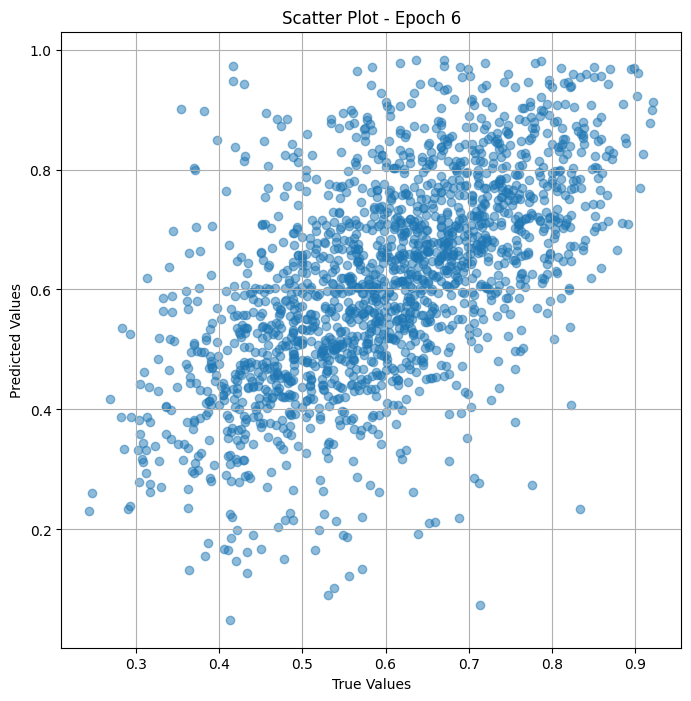


 Epoch: (7/50) Loss = 0.002529140328988433

 Epoch: (7/50) Loss_rmse = 0.050290558487176895

 Epoch: (7/50) R^2 = 0.8489304780960083

 Epoch: (7/50) MAE = 0.04579560458660126

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

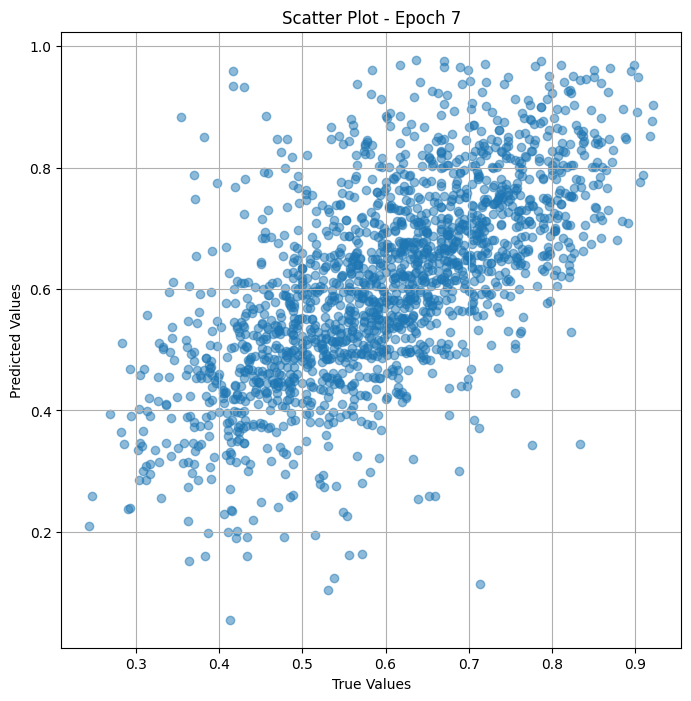


 Epoch: (8/50) Loss = 0.0014676349237561226

 Epoch: (8/50) Loss_rmse = 0.038309723138809204

 Epoch: (8/50) R^2 = 0.9123358726501465

 Epoch: (8/50) MAE = 0.02922923117876053

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.

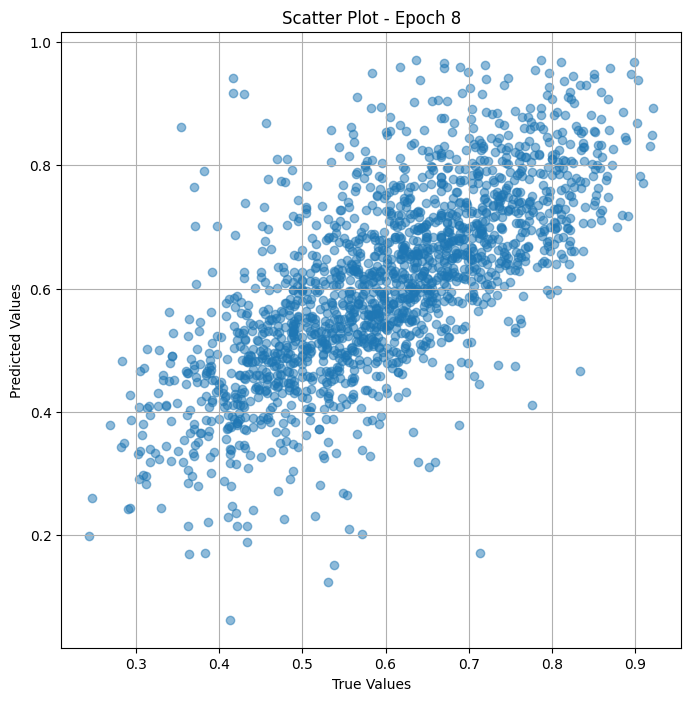


 Epoch: (9/50) Loss = 0.0012568873353302479

 Epoch: (9/50) Loss_rmse = 0.03545260801911354

 Epoch: (9/50) R^2 = 0.9249241352081299

 Epoch: (9/50) MAE = 0.027764752507209778

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.

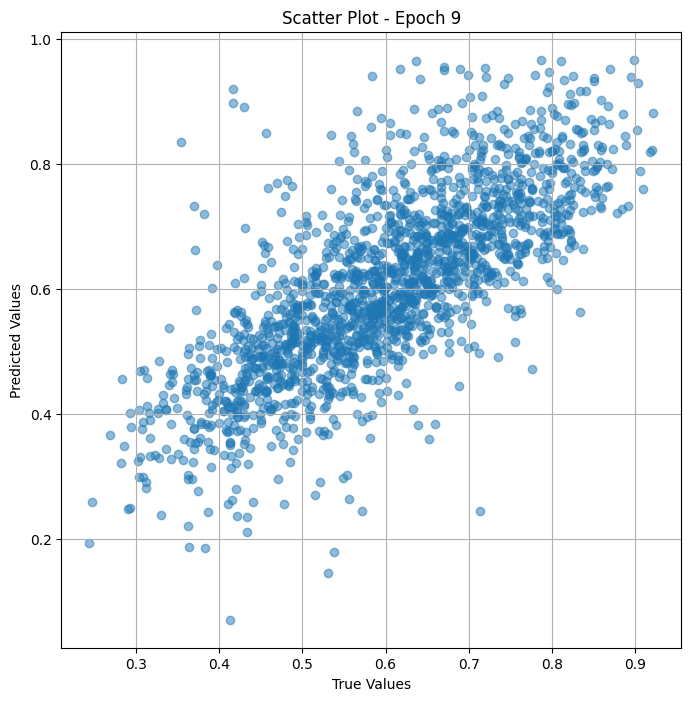


 Epoch: (10/50) Loss = 0.00115897785872221

 Epoch: (10/50) Loss_rmse = 0.03404376283288002

 Epoch: (10/50) R^2 = 0.9307724237442017

 Epoch: (10/50) MAE = 0.0281037837266922

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.

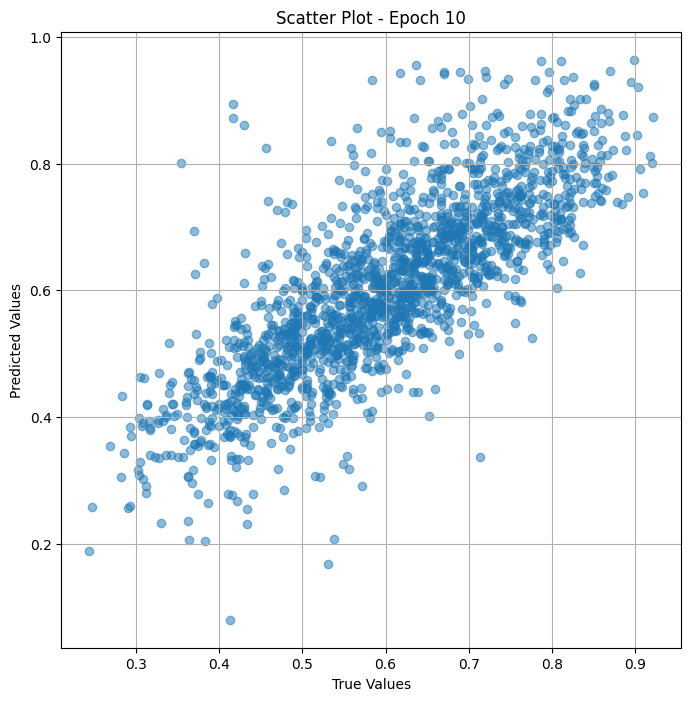


 Epoch: (11/50) Loss = 0.0010470030829310417

 Epoch: (11/50) Loss_rmse = 0.03235742822289467

 Epoch: (11/50) R^2 = 0.9374608397483826

 Epoch: (11/50) MAE = 0.027914345264434814

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

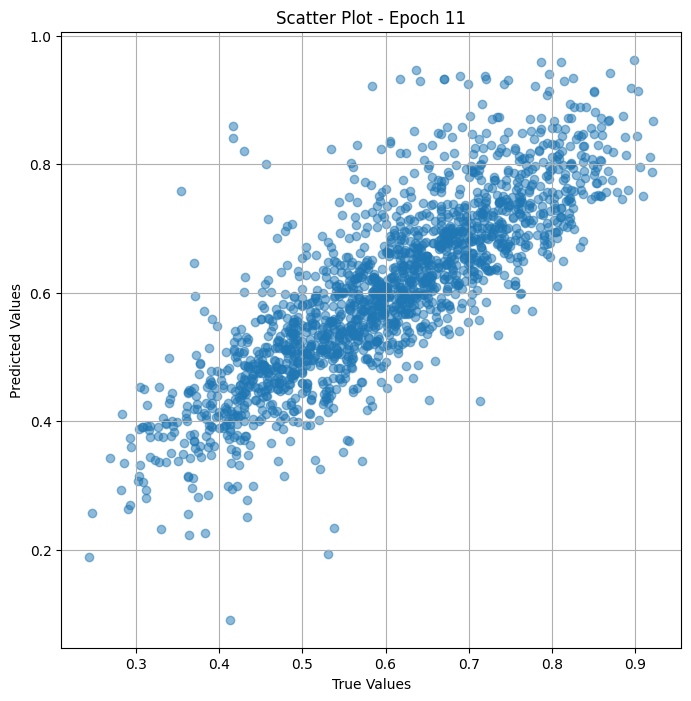


 Epoch: (12/50) Loss = 0.0009291046881116927

 Epoch: (12/50) Loss_rmse = 0.03048121929168701

 Epoch: (12/50) R^2 = 0.944503128528595

 Epoch: (12/50) MAE = 0.027041703462600708

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

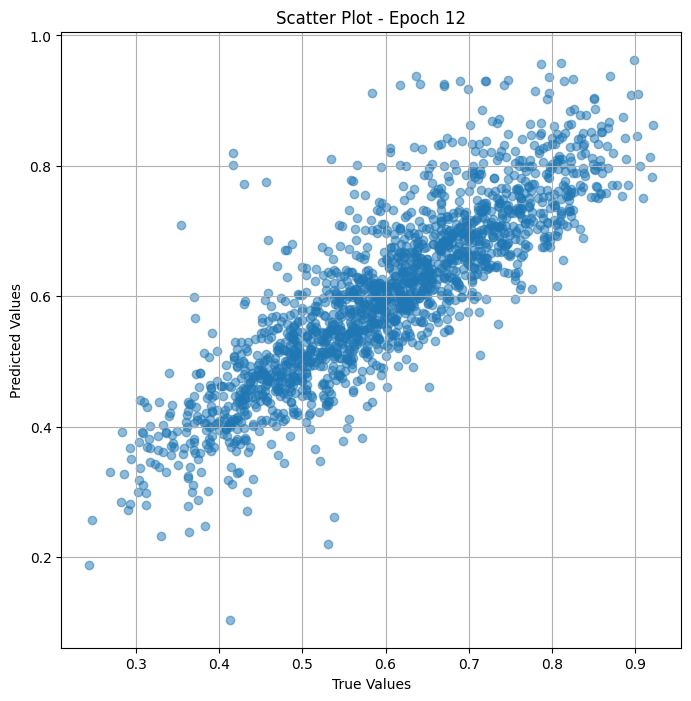


 Epoch: (13/50) Loss = 0.0008193078683689237

 Epoch: (13/50) Loss_rmse = 0.0286235548555851

 Epoch: (13/50) R^2 = 0.9510614275932312

 Epoch: (13/50) MAE = 0.025752317160367966

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

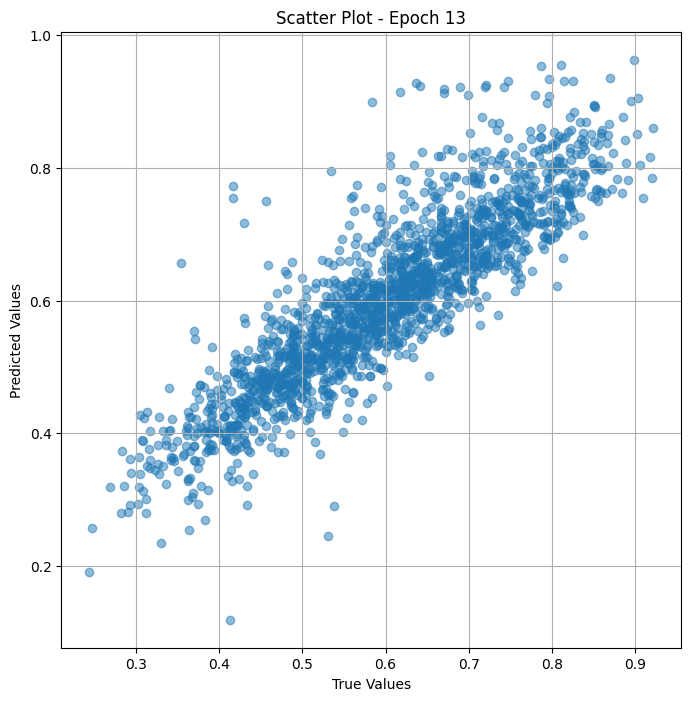


 Epoch: (14/50) Loss = 0.0007288555498234928

 Epoch: (14/50) Loss_rmse = 0.02699732407927513

 Epoch: (14/50) R^2 = 0.9564642906188965

 Epoch: (14/50) MAE = 0.024264737963676453

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

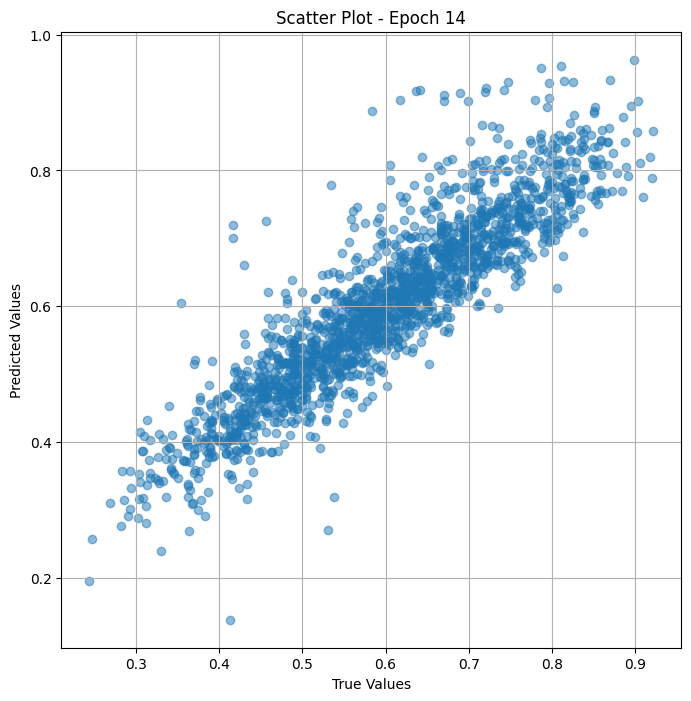


 Epoch: (15/50) Loss = 0.0006609907723031938

 Epoch: (15/50) Loss_rmse = 0.025709740817546844

 Epoch: (15/50) R^2 = 0.9605180025100708

 Epoch: (15/50) MAE = 0.022725574672222137

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

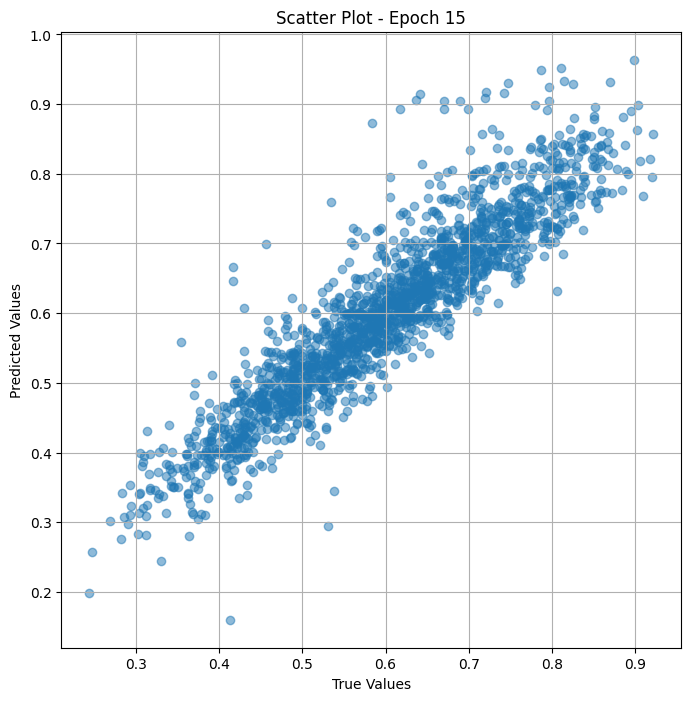


 Epoch: (16/50) Loss = 0.0006094526615925133

 Epoch: (16/50) Loss_rmse = 0.02468709461390972

 Epoch: (16/50) R^2 = 0.9635964035987854

 Epoch: (16/50) MAE = 0.021217353641986847

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

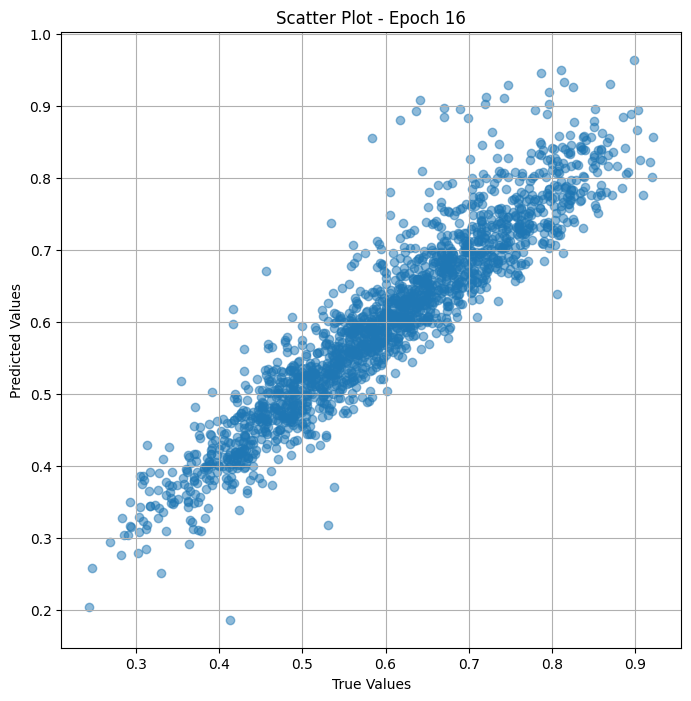


 Epoch: (17/50) Loss = 0.000565333932172507

 Epoch: (17/50) Loss_rmse = 0.02377675101161003

 Epoch: (17/50) R^2 = 0.9662317037582397

 Epoch: (17/50) MAE = 0.019773419946432114

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

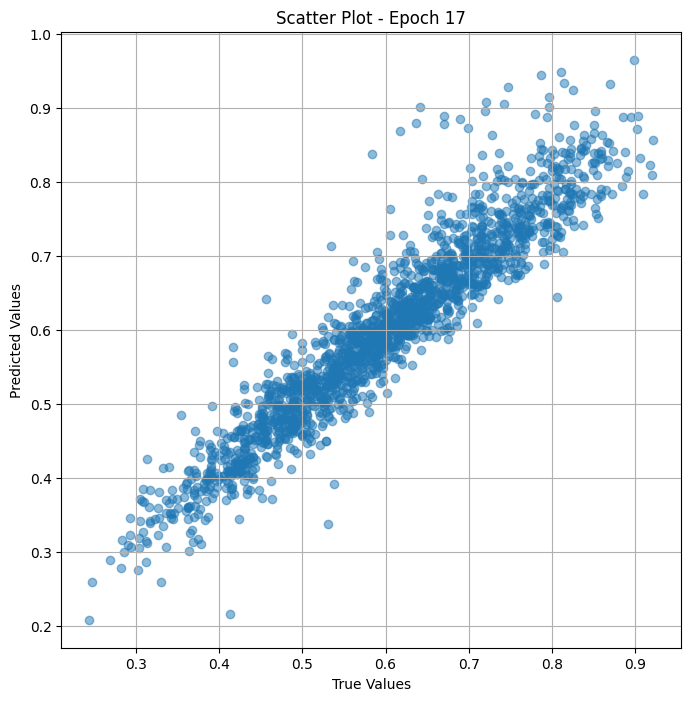


 Epoch: (18/50) Loss = 0.0005268723471090198

 Epoch: (18/50) Loss_rmse = 0.02295370027422905

 Epoch: (18/50) R^2 = 0.9685291051864624

 Epoch: (18/50) MAE = 0.018863514065742493

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

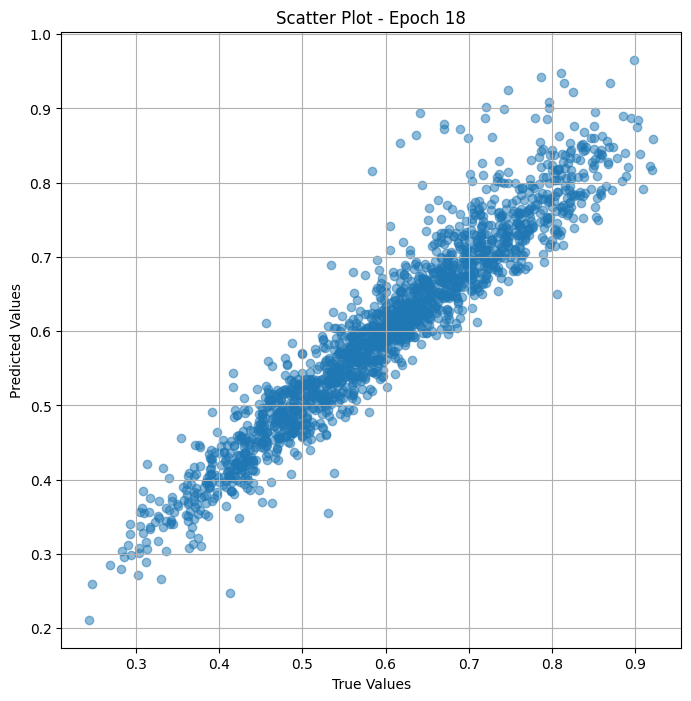


 Epoch: (19/50) Loss = 0.0004987364518456161

 Epoch: (19/50) Loss_rmse = 0.022332407534122467

 Epoch: (19/50) R^2 = 0.9702096581459045

 Epoch: (19/50) MAE = 0.018780063837766647

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

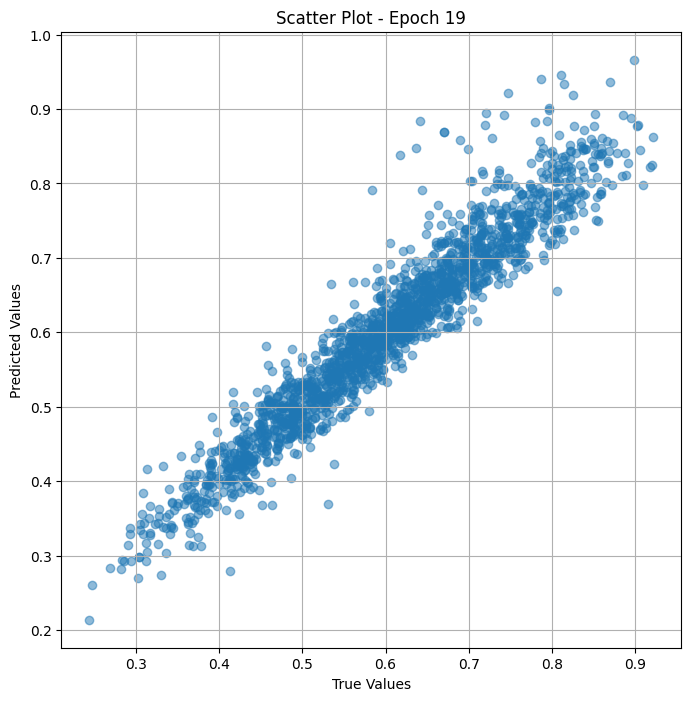


 Epoch: (20/50) Loss = 0.0004885512753389776

 Epoch: (20/50) Loss_rmse = 0.022103196009993553

 Epoch: (20/50) R^2 = 0.970818042755127

 Epoch: (20/50) MAE = 0.018899716436862946

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

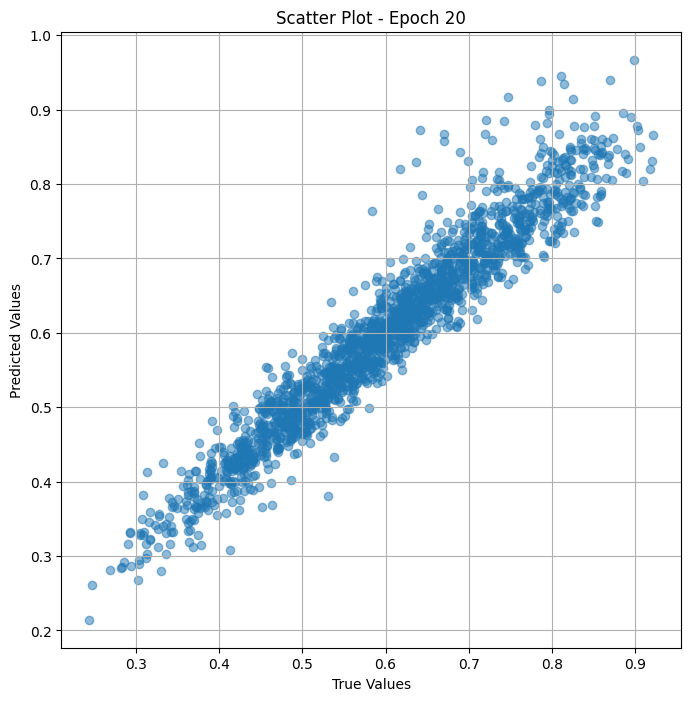


 Epoch: (21/50) Loss = 0.0005055128131061792

 Epoch: (21/50) Loss_rmse = 0.02248361147940159

 Epoch: (21/50) R^2 = 0.9698049426078796

 Epoch: (21/50) MAE = 0.019321933388710022

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

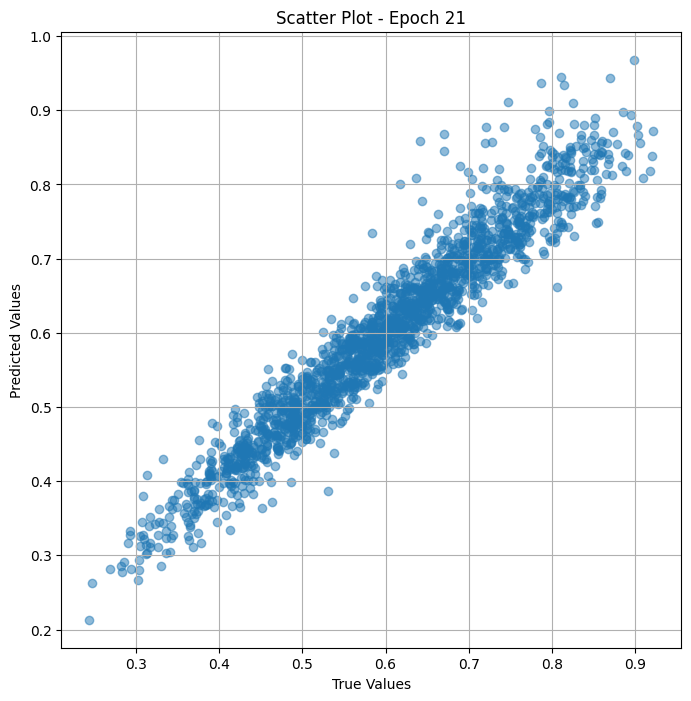


 Epoch: (22/50) Loss = 0.0005646048812195659

 Epoch: (22/50) Loss_rmse = 0.023761415854096413

 Epoch: (22/50) R^2 = 0.9662752747535706

 Epoch: (22/50) MAE = 0.0201958566904068

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

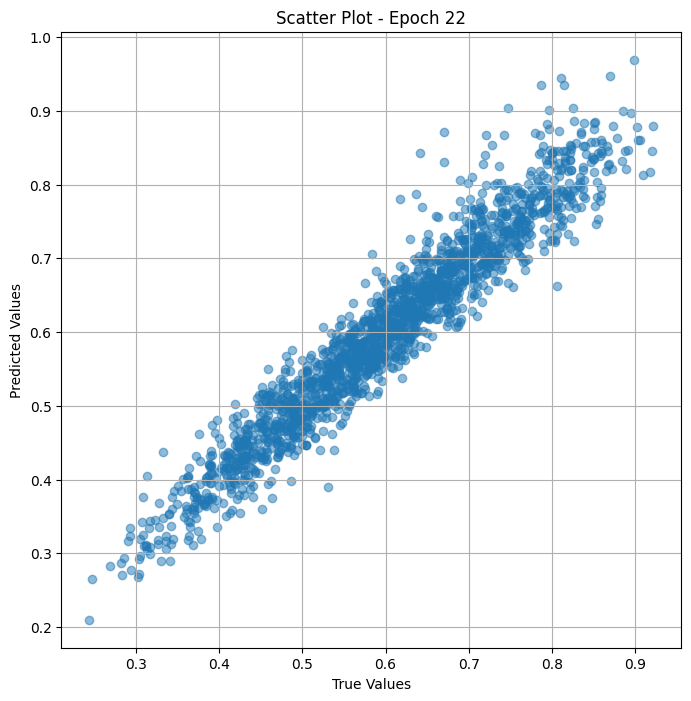


 Epoch: (23/50) Loss = 0.0006952134426683187

 Epoch: (23/50) Loss_rmse = 0.02636690065264702

 Epoch: (23/50) R^2 = 0.958473801612854

 Epoch: (23/50) MAE = 0.022361773997545242

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

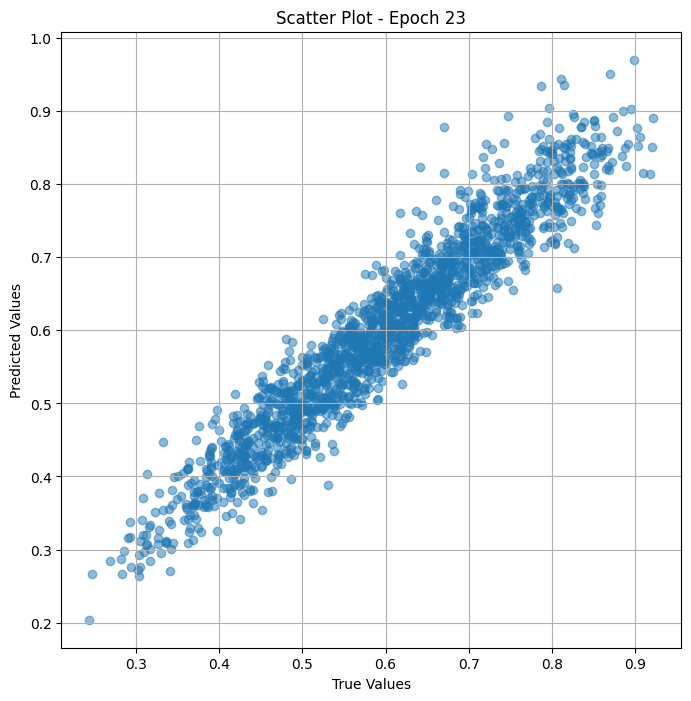


 Epoch: (24/50) Loss = 0.0009837700054049492

 Epoch: (24/50) Loss_rmse = 0.031365107744932175

 Epoch: (24/50) R^2 = 0.9412378668785095

 Epoch: (24/50) MAE = 0.02684624120593071

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

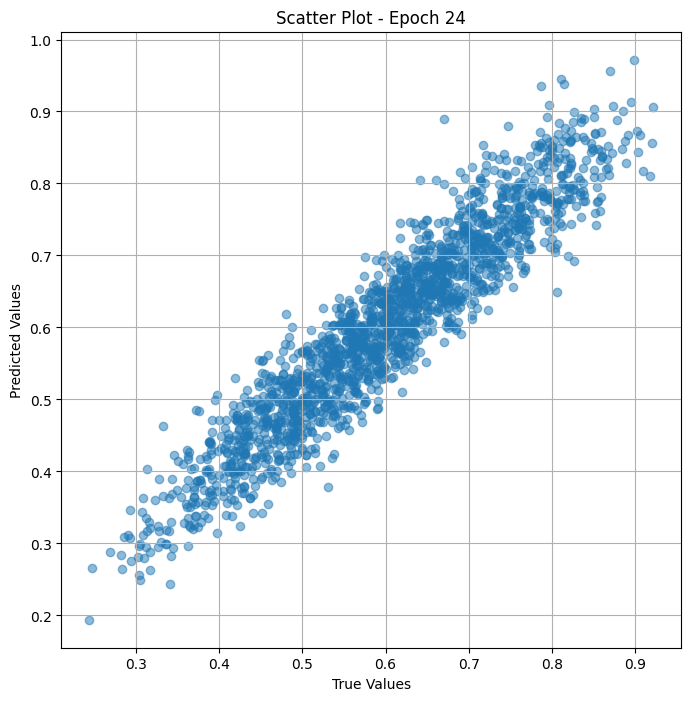


 Epoch: (25/50) Loss = 0.0018151303520426154

 Epoch: (25/50) Loss_rmse = 0.042604345828294754

 Epoch: (25/50) R^2 = 0.8915793895721436

 Epoch: (25/50) MAE = 0.03599681332707405

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

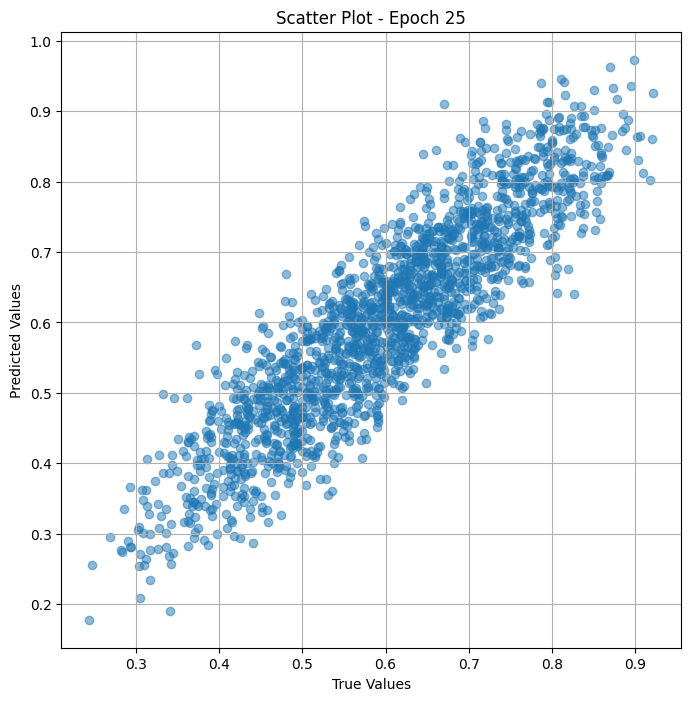


 Epoch: (26/50) Loss = 0.03382579982280731

 Epoch: (26/50) Loss_rmse = 0.18391790986061096

 Epoch: (26/50) R^2 = -1.0204684734344482

 Epoch: (26/50) MAE = 0.16279882192611694

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

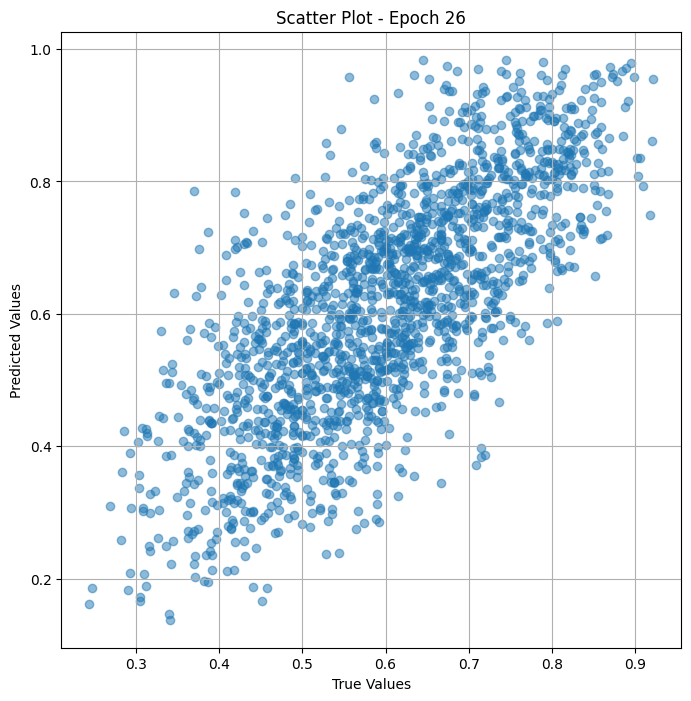


 Epoch: (27/50) Loss = 0.04292876273393631

 Epoch: (27/50) Loss_rmse = 0.2071925699710846

 Epoch: (27/50) R^2 = -1.5642027854919434

 Epoch: (27/50) MAE = 0.19332405924797058

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

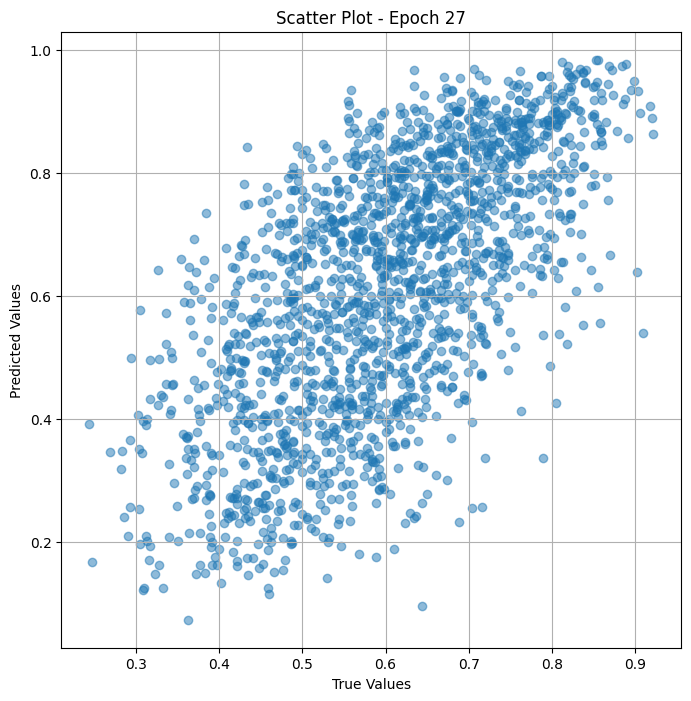


 Epoch: (28/50) Loss = 0.012901192530989647

 Epoch: (28/50) Loss_rmse = 0.11358341574668884

 Epoch: (28/50) R^2 = 0.22939139604568481

 Epoch: (28/50) MAE = 0.10354404896497726

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

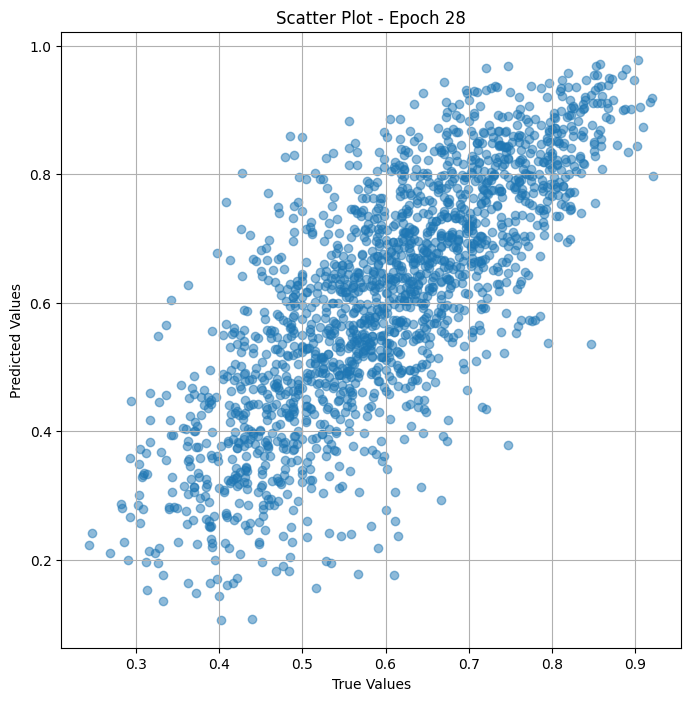


 Epoch: (29/50) Loss = 0.004764511249959469

 Epoch: (29/50) Loss_rmse = 0.0690254420042038

 Epoch: (29/50) R^2 = 0.715408205986023

 Epoch: (29/50) MAE = 0.055725790560245514

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

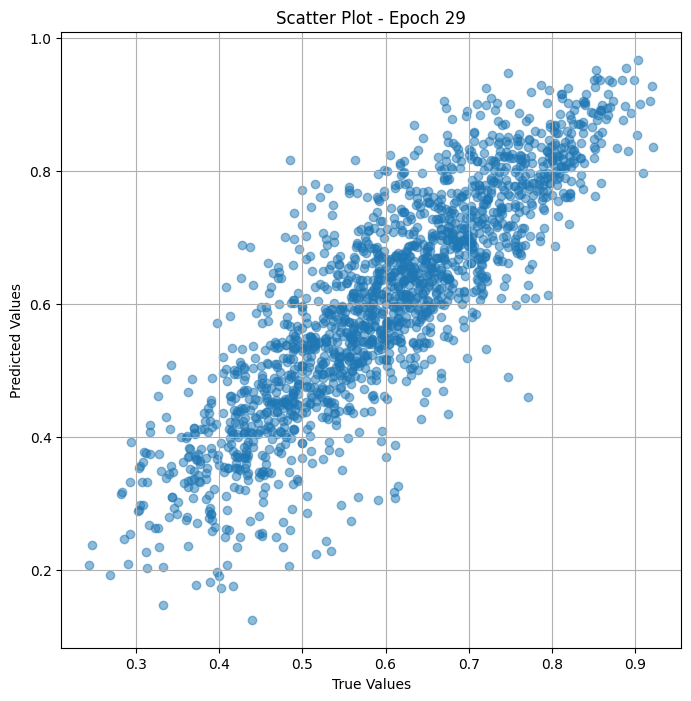


 Epoch: (30/50) Loss = 0.002004606183618307

 Epoch: (30/50) Loss_rmse = 0.04477282986044884

 Epoch: (30/50) R^2 = 0.8802617192268372

 Epoch: (30/50) MAE = 0.02980213239789009

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

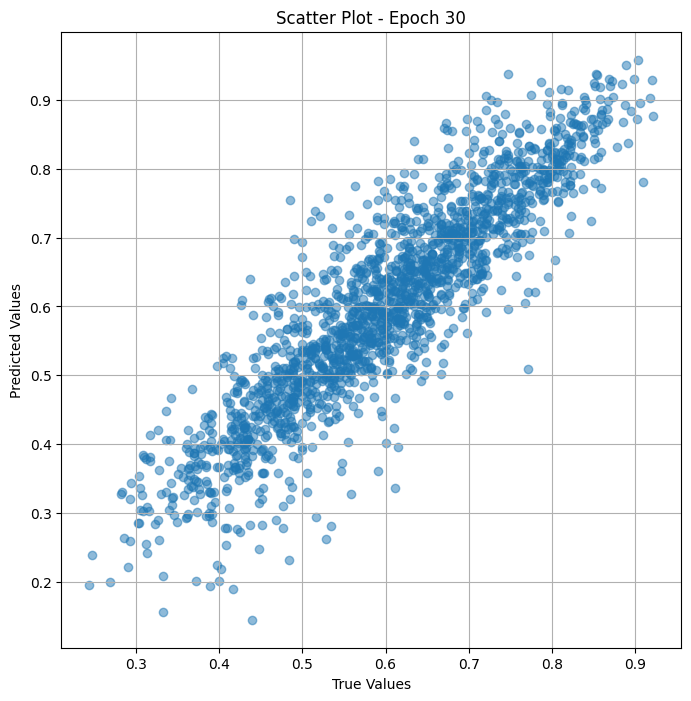


 Epoch: (31/50) Loss = 0.0008787277620285749

 Epoch: (31/50) Loss_rmse = 0.029643341898918152

 Epoch: (31/50) R^2 = 0.9475122094154358

 Epoch: (31/50) MAE = 0.01772317662835121

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

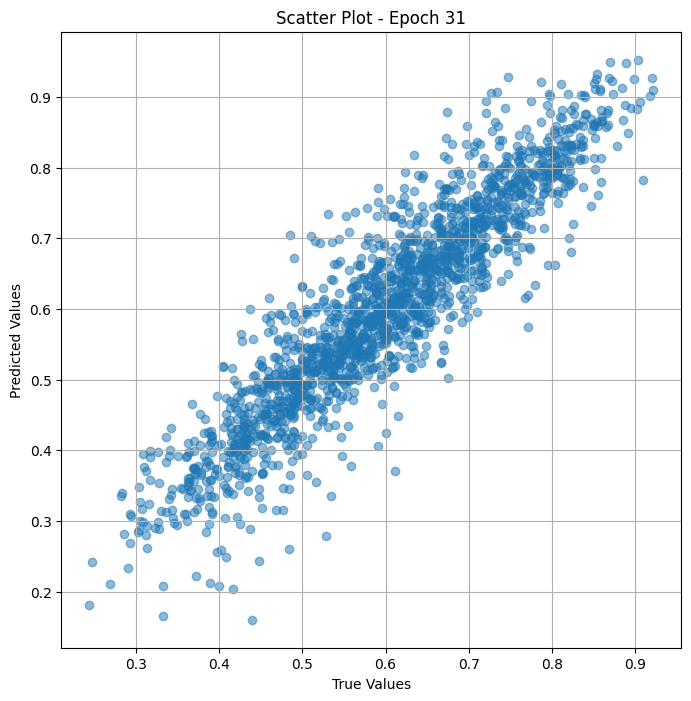


 Epoch: (32/50) Loss = 0.00038732090615667403

 Epoch: (32/50) Loss_rmse = 0.01968047022819519

 Epoch: (32/50) R^2 = 0.9768646955490112

 Epoch: (32/50) MAE = 0.014980588108301163

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

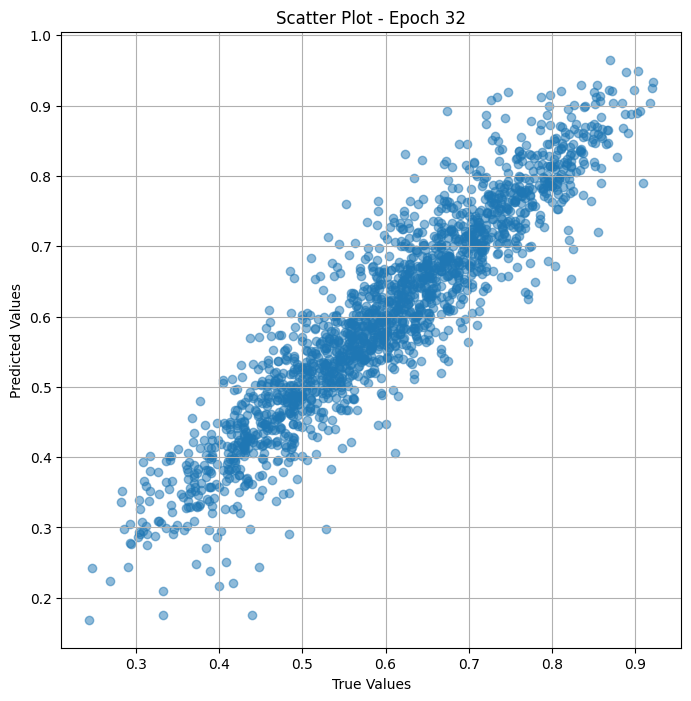


 Epoch: (33/50) Loss = 0.00020020523515995592

 Epoch: (33/50) Loss_rmse = 0.014149390161037445

 Epoch: (33/50) R^2 = 0.9880414009094238

 Epoch: (33/50) MAE = 0.012413199990987778

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.620253

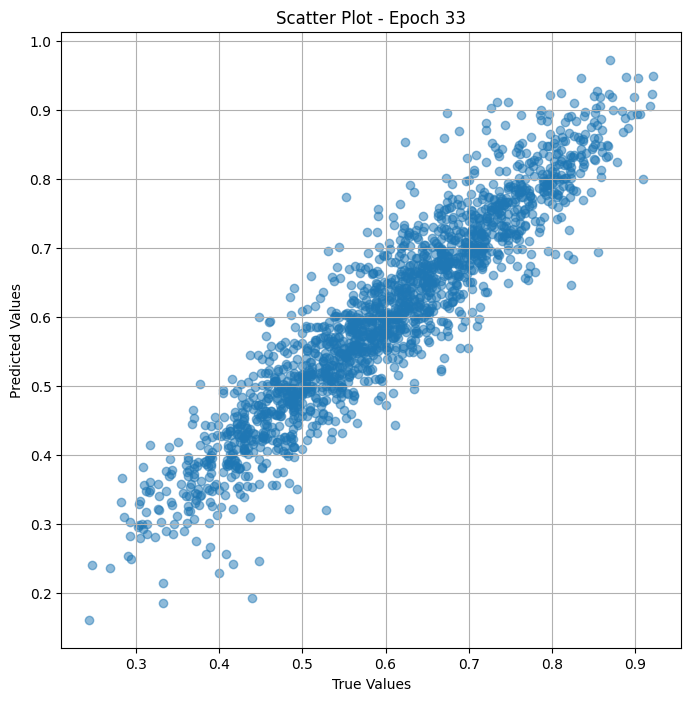


 Epoch: (34/50) Loss = 0.00016247120220214128

 Epoch: (34/50) Loss_rmse = 0.012746418826282024

 Epoch: (34/50) R^2 = 0.9902953505516052

 Epoch: (34/50) MAE = 0.010755158960819244

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.620253

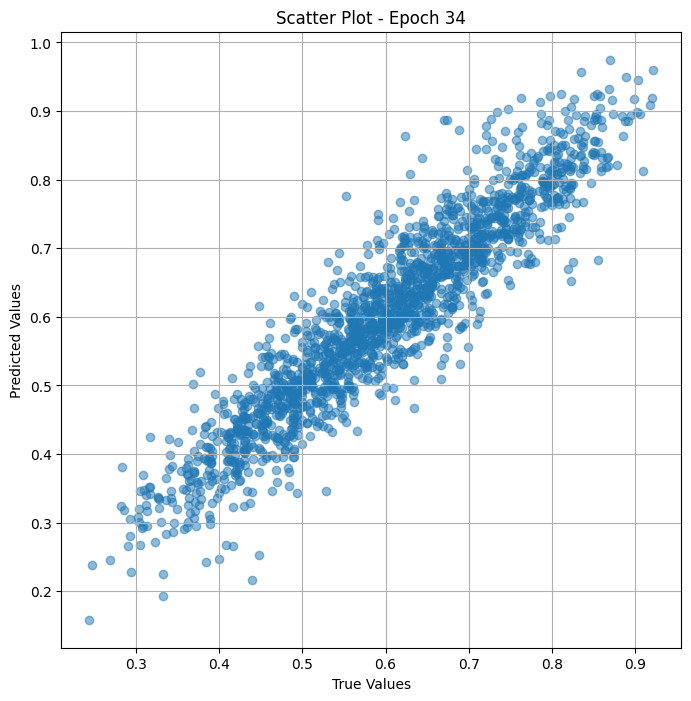


 Epoch: (35/50) Loss = 0.00020729657262563705

 Epoch: (35/50) Loss_rmse = 0.014397797174751759

 Epoch: (35/50) R^2 = 0.9876178503036499

 Epoch: (35/50) MAE = 0.011030033230781555

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.620253

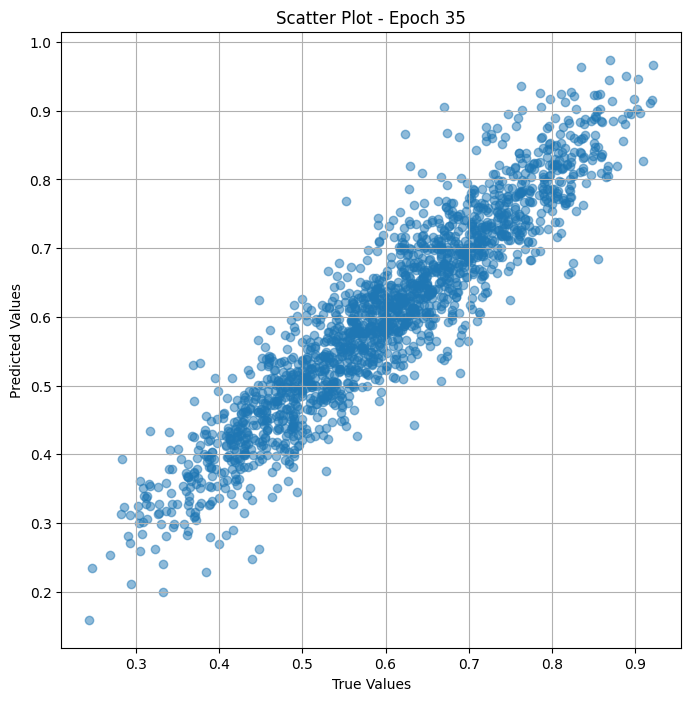


 Epoch: (36/50) Loss = 0.0003459462895989418

 Epoch: (36/50) Loss_rmse = 0.018599631264805794

 Epoch: (36/50) R^2 = 0.9793360829353333

 Epoch: (36/50) MAE = 0.01597556099295616

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

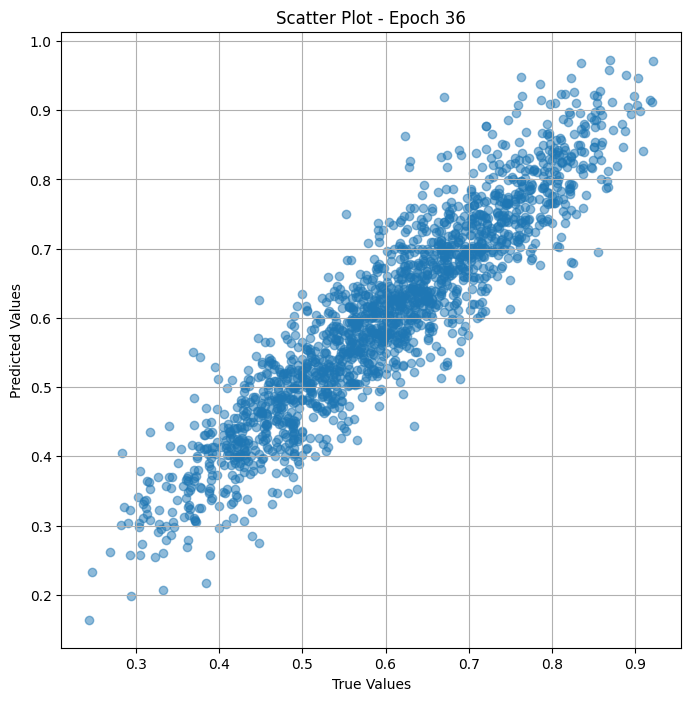


 Epoch: (37/50) Loss = 0.0006639843923039734

 Epoch: (37/50) Loss_rmse = 0.025767894461750984

 Epoch: (37/50) R^2 = 0.9603391885757446

 Epoch: (37/50) MAE = 0.021603401750326157

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

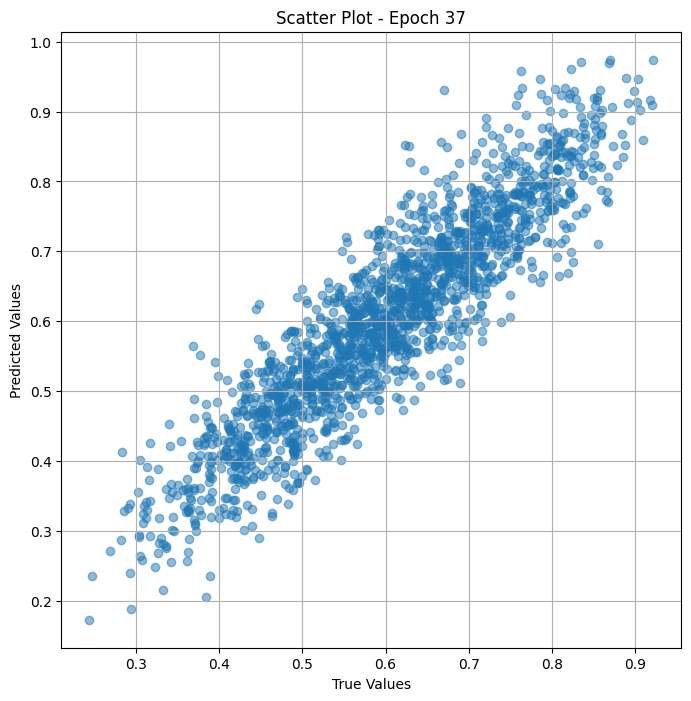


 Epoch: (38/50) Loss = 0.0014411211013793945

 Epoch: (38/50) Loss_rmse = 0.03796210139989853

 Epoch: (38/50) R^2 = 0.9139195680618286

 Epoch: (38/50) MAE = 0.029752343893051147

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

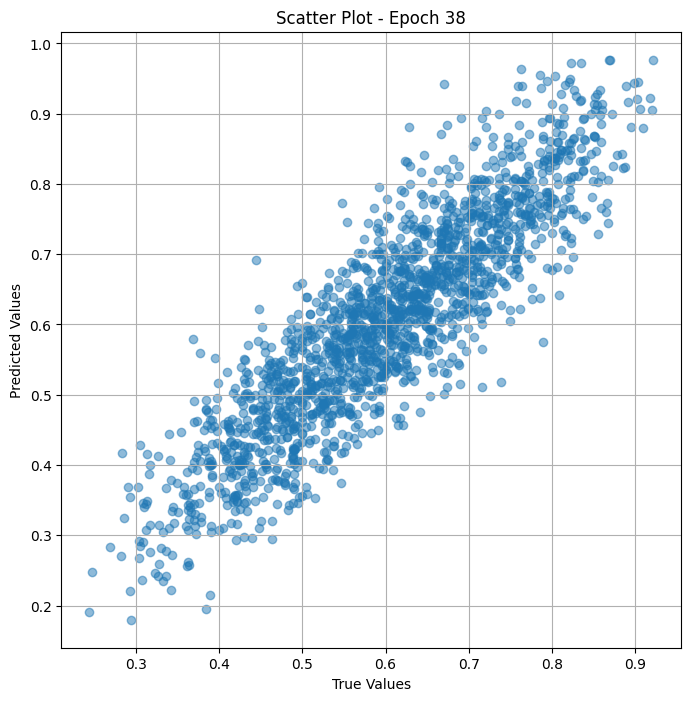


 Epoch: (39/50) Loss = 0.0030101104639470577

 Epoch: (39/50) Loss_rmse = 0.05486447364091873

 Epoch: (39/50) R^2 = 0.8202013373374939

 Epoch: (39/50) MAE = 0.04675532877445221

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

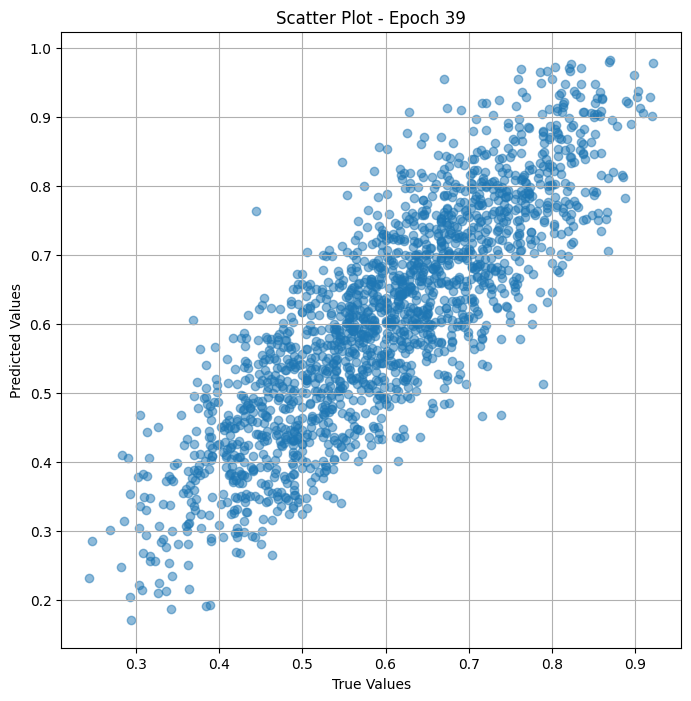


 Epoch: (40/50) Loss = 0.001205784035846591

 Epoch: (40/50) Loss_rmse = 0.0347243994474411

 Epoch: (40/50) R^2 = 0.9279766082763672

 Epoch: (40/50) MAE = 0.02807878702878952

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

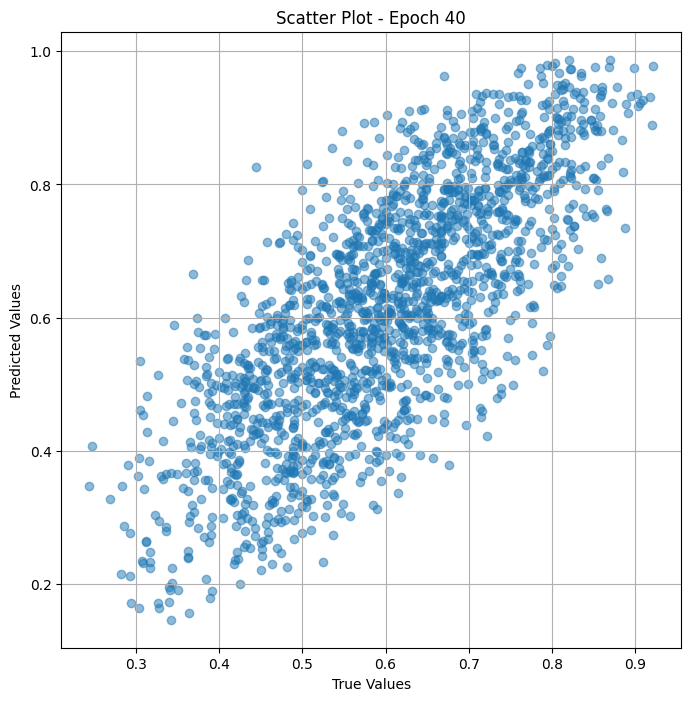


 Epoch: (41/50) Loss = 0.010799642652273178

 Epoch: (41/50) Loss_rmse = 0.1039213314652443

 Epoch: (41/50) R^2 = 0.35492026805877686

 Epoch: (41/50) MAE = 0.09181896597146988

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

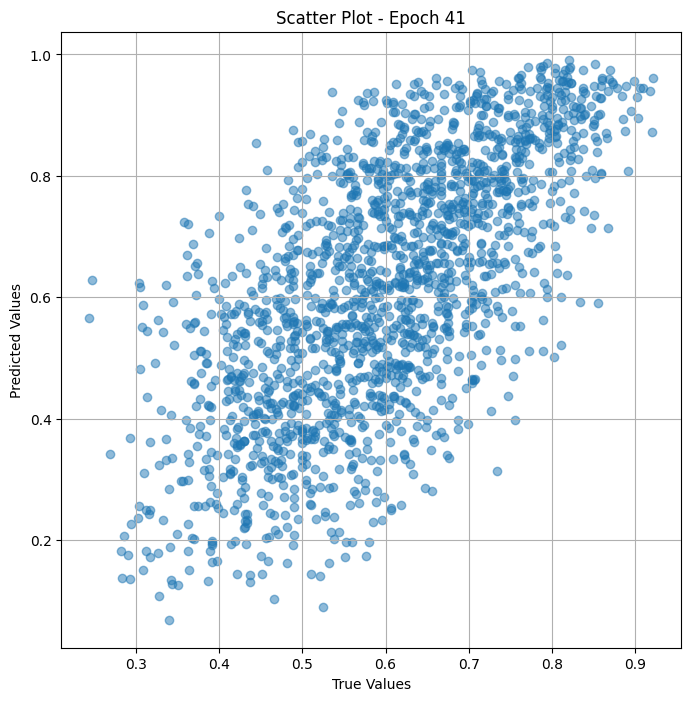


 Epoch: (42/50) Loss = 0.0023567983880639076

 Epoch: (42/50) Loss_rmse = 0.048546869307756424

 Epoch: (42/50) R^2 = 0.8592246770858765

 Epoch: (42/50) MAE = 0.04060973972082138

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

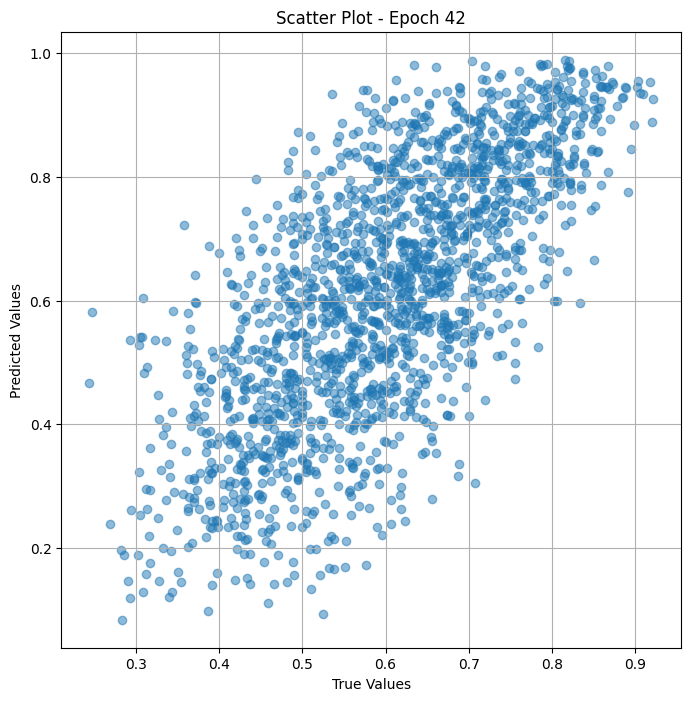


 Epoch: (43/50) Loss = 0.002455233596265316

 Epoch: (43/50) Loss_rmse = 0.049550313502550125

 Epoch: (43/50) R^2 = 0.8533450365066528

 Epoch: (43/50) MAE = 0.040052805095911026

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

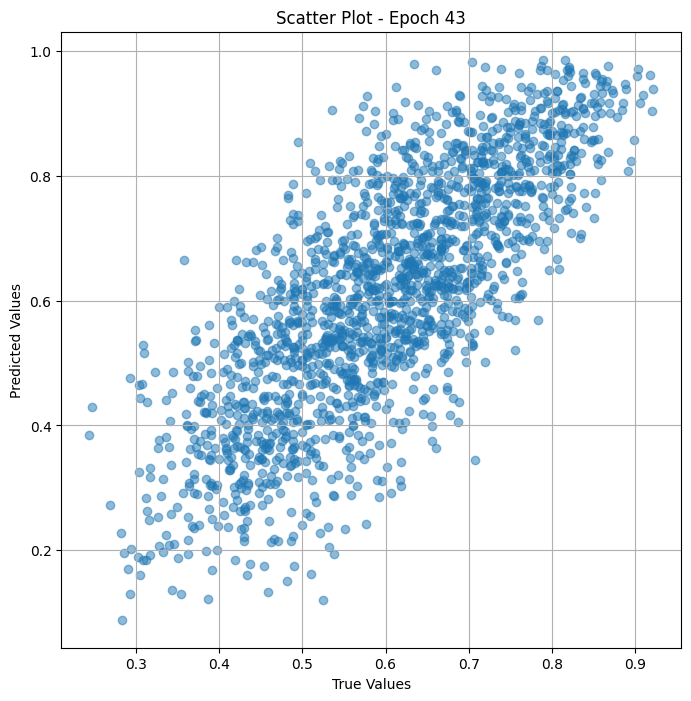


 Epoch: (44/50) Loss = 0.003694591810926795

 Epoch: (44/50) Loss_rmse = 0.060783155262470245

 Epoch: (44/50) R^2 = 0.7793161869049072

 Epoch: (44/50) MAE = 0.05628763511776924

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

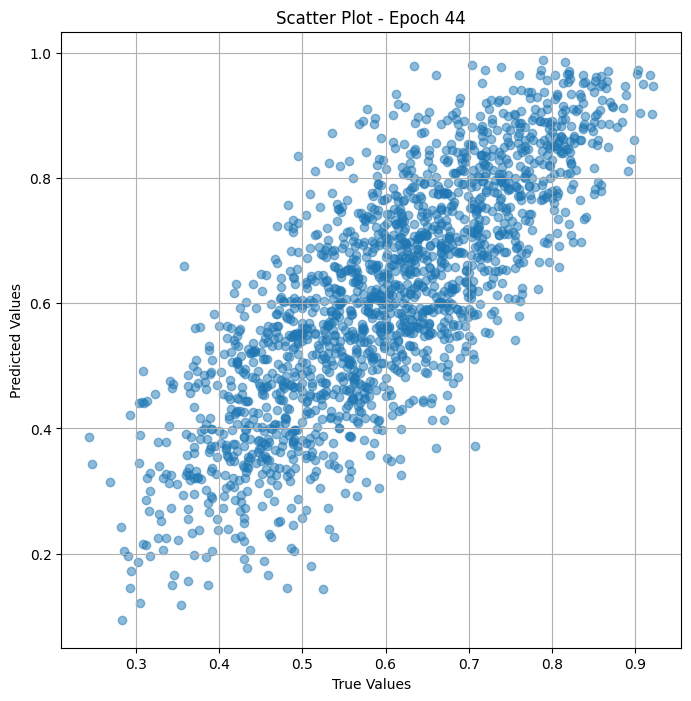


 Epoch: (45/50) Loss = 0.005628284998238087

 Epoch: (45/50) Loss_rmse = 0.0750219002366066

 Epoch: (45/50) R^2 = 0.6638136506080627

 Epoch: (45/50) MAE = 0.06812485307455063

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

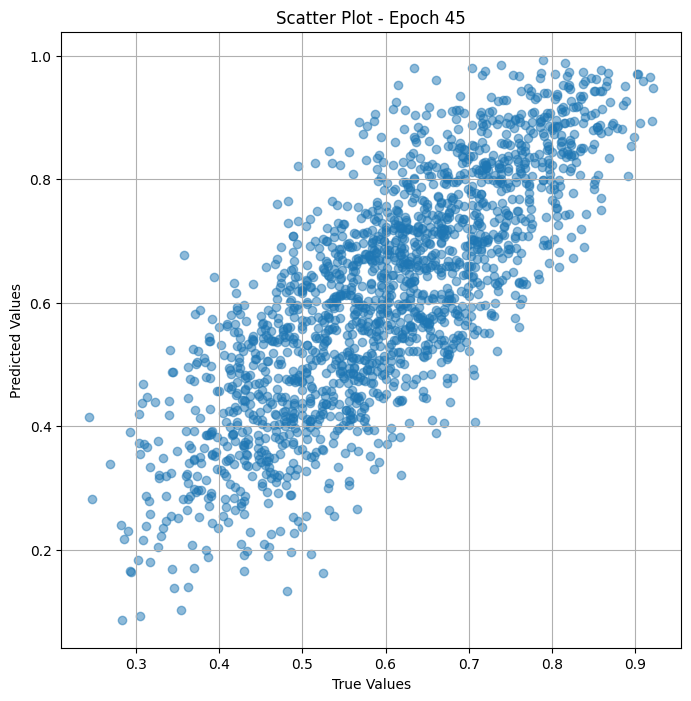


 Epoch: (46/50) Loss = 0.0071210963651537895

 Epoch: (46/50) Loss_rmse = 0.08438658714294434

 Epoch: (46/50) R^2 = 0.5746456384658813

 Epoch: (46/50) MAE = 0.07567163556814194

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

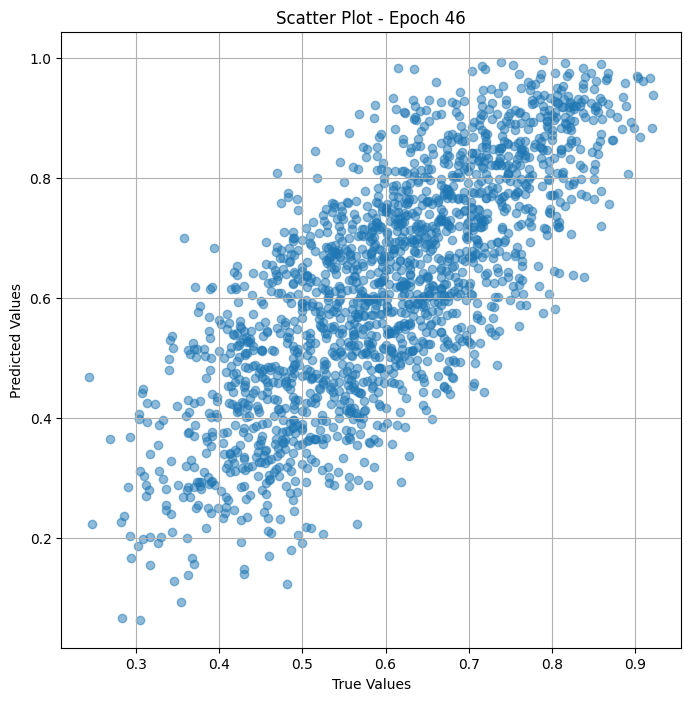


 Epoch: (47/50) Loss = 0.004575191996991634

 Epoch: (47/50) Loss_rmse = 0.06764016300439835

 Epoch: (47/50) R^2 = 0.7267165184020996

 Epoch: (47/50) MAE = 0.05491144210100174

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

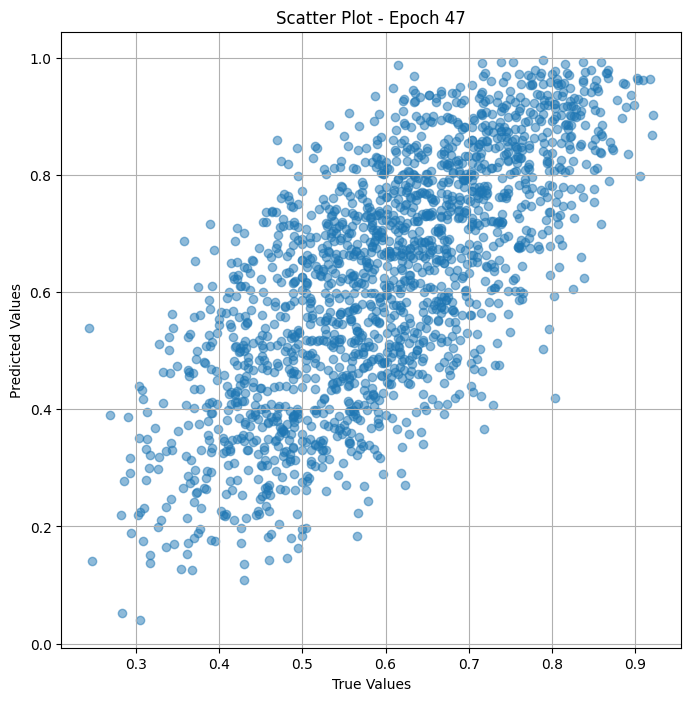


 Epoch: (48/50) Loss = 0.0019778145942837

 Epoch: (48/50) Loss_rmse = 0.044472627341747284

 Epoch: (48/50) R^2 = 0.8818619847297668

 Epoch: (48/50) MAE = 0.04042729735374451

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

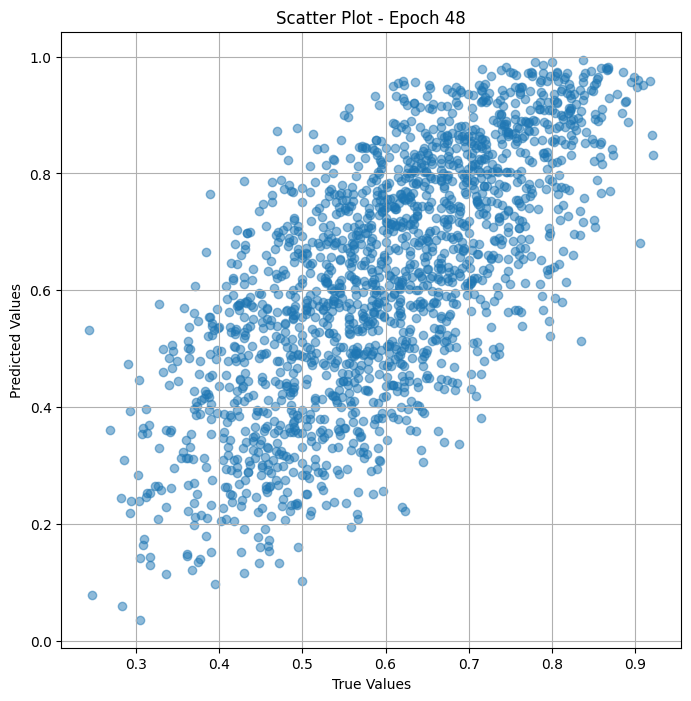


 Epoch: (49/50) Loss = 0.0051819817163050175

 Epoch: (49/50) Loss_rmse = 0.07198598235845566

 Epoch: (49/50) R^2 = 0.6904720067977905

 Epoch: (49/50) MAE = 0.06190072372555733

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

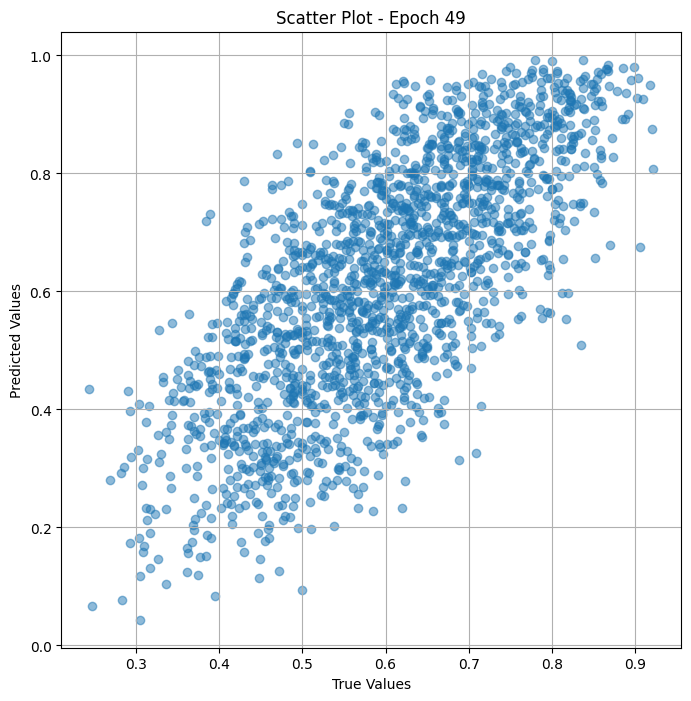


 Epoch: (50/50) Loss = 0.00840773619711399

 Epoch: (50/50) Loss_rmse = 0.0916937068104744

 Epoch: (50/50) R^2 = 0.4977926015853882

 Epoch: (50/50) MAE = 0.0800914317369461

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

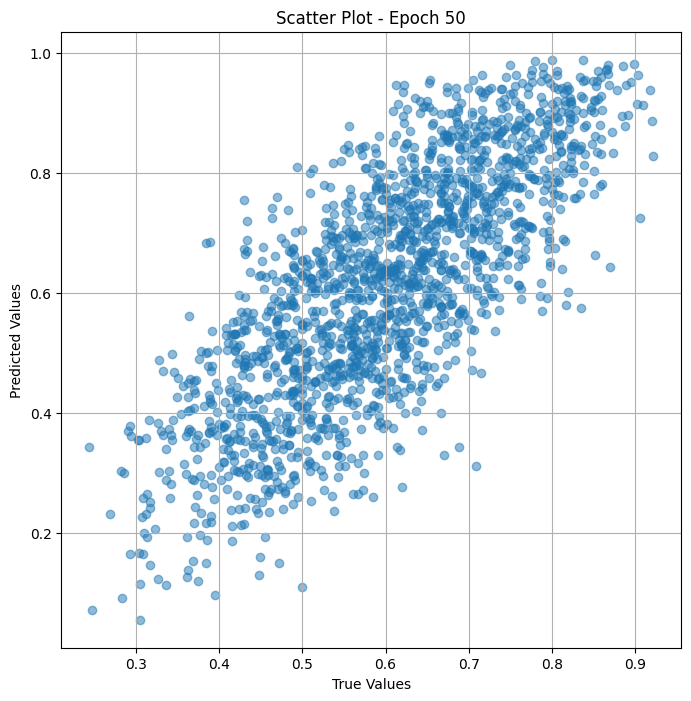

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S")

In [ ]:

import numpy as np
from scipy.stats import spearmanr

true_values = [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381]
predicted_values = [0.6218347, 0.53635603, 0.7811768, 0.6779465, 0.5892373, 0.780551, 0.40918115, 0.58747154]

spearman_corr, _ = spearmanr(true_values, predicted_values)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.7142857142857144 0.04652823228416724


## Valid

In [ ]:
class Dataset_val(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_val(df_val_landscape, trans_transform=trans_transform, res_transform=res_transform)
train_dl_val = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_val = model_merge_val(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
model_val = to_device(model_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/100) Loss = 0.09576846659183502

 Epoch: (1/100) Loss_rmse = 0.30946481227874756

 Epoch: (1/100) R^2 = -7.134769439697266

 Epoch: (1/100) MAE = 0.2964005768299103

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228813

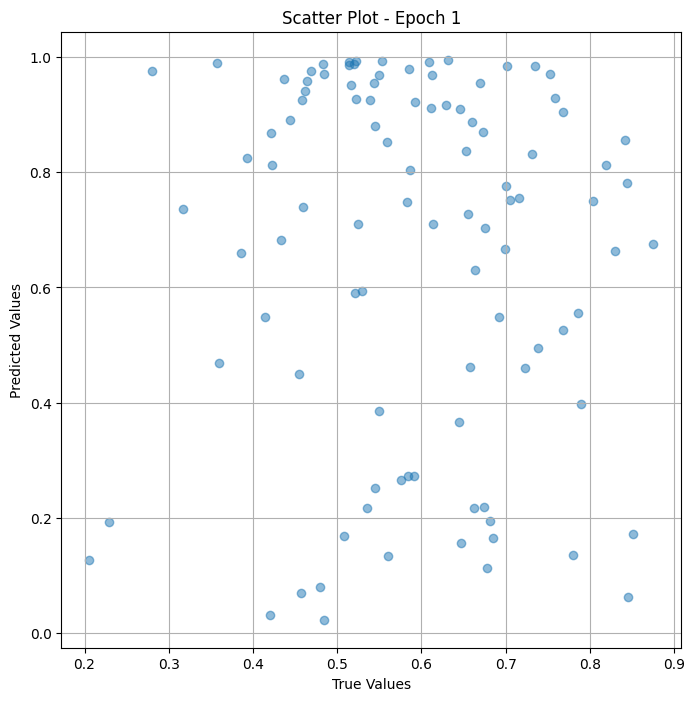


 Epoch: (2/100) Loss = 0.06353609263896942

 Epoch: (2/100) Loss_rmse = 0.25206366181373596

 Epoch: (2/100) R^2 = -4.396885871887207

 Epoch: (2/100) MAE = 0.20391476154327393

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881

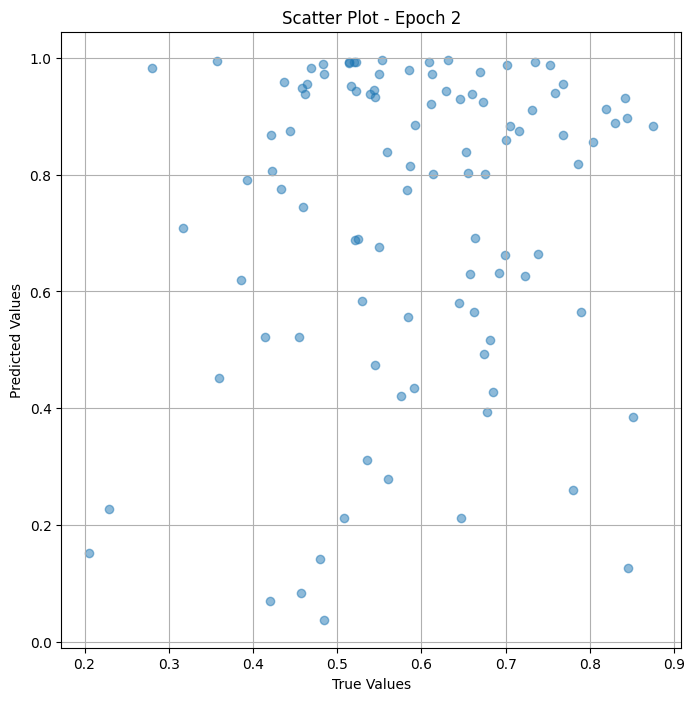


 Epoch: (3/100) Loss = 0.040304895490407944

 Epoch: (3/100) Loss_rmse = 0.20076079666614532

 Epoch: (3/100) R^2 = -2.4235804080963135

 Epoch: (3/100) MAE = 0.15400783717632294

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

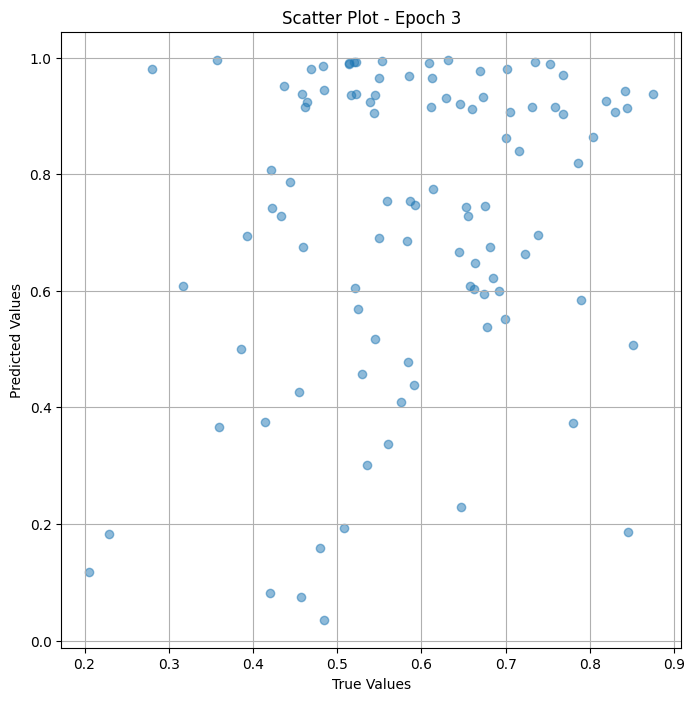


 Epoch: (4/100) Loss = 0.02194790355861187

 Epoch: (4/100) Loss_rmse = 0.14814825356006622

 Epoch: (4/100) R^2 = -0.8642998933792114

 Epoch: (4/100) MAE = 0.10435450077056885

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

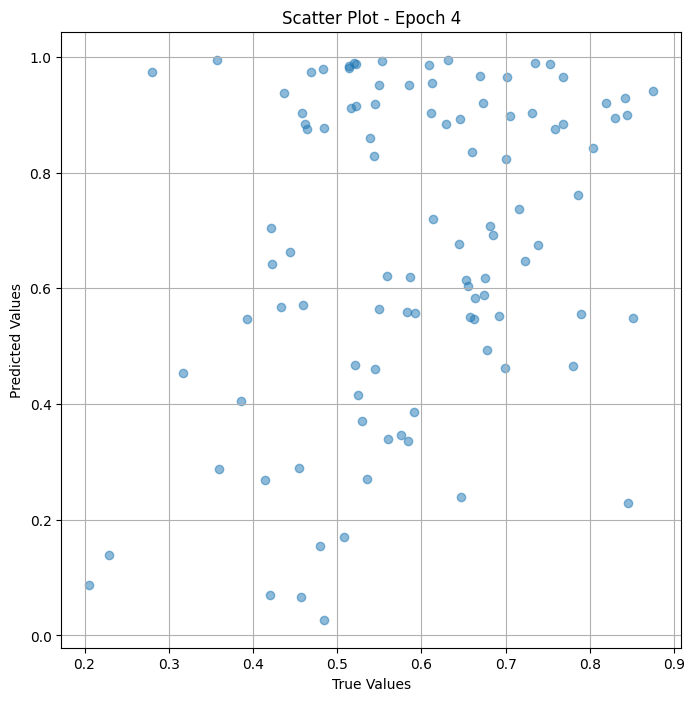


 Epoch: (5/100) Loss = 0.009683298878371716

 Epoch: (5/100) Loss_rmse = 0.09840375185012817

 Epoch: (5/100) R^2 = 0.1774807572364807

 Epoch: (5/100) MAE = 0.08204092085361481

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

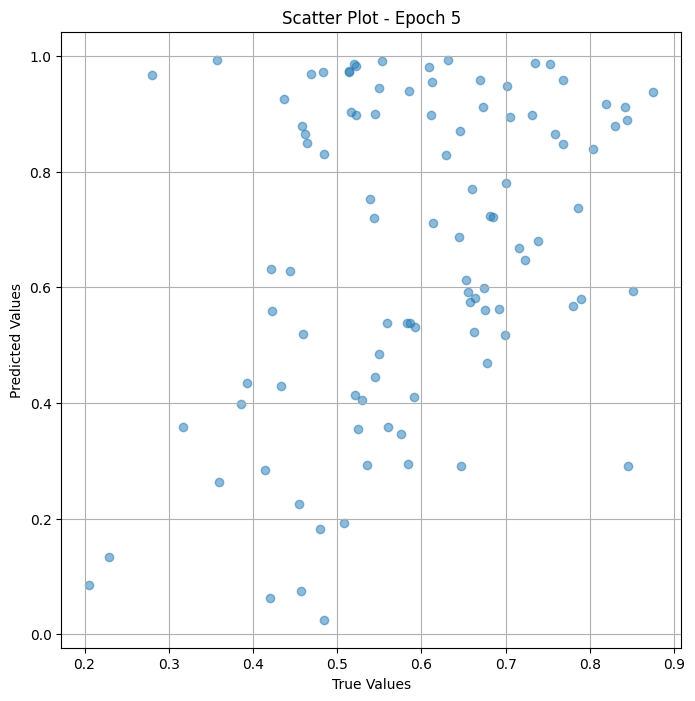


 Epoch: (6/100) Loss = 0.001293723238632083

 Epoch: (6/100) Loss_rmse = 0.0359683632850647

 Epoch: (6/100) R^2 = 0.8901084661483765

 Epoch: (6/100) MAE = 0.03495991230010986

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881

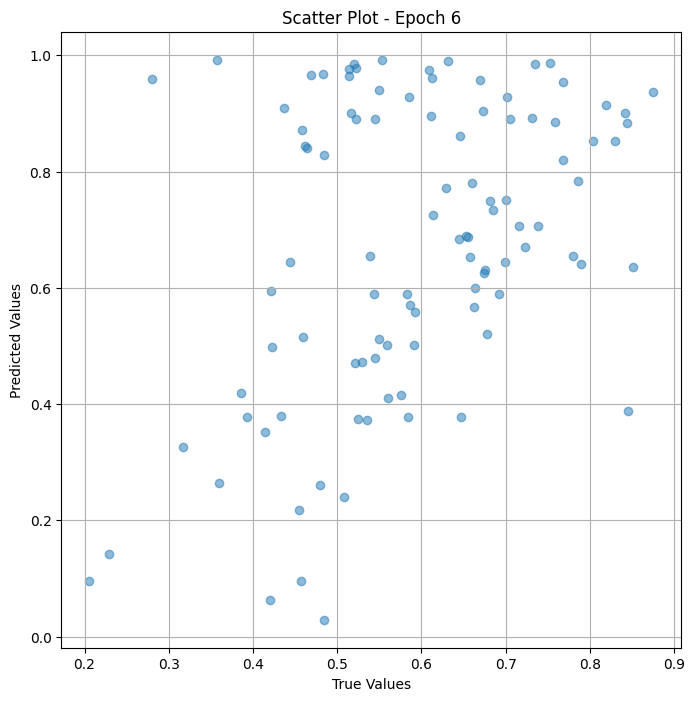


 Epoch: (7/100) Loss = 0.0017834303434938192

 Epoch: (7/100) Loss_rmse = 0.04223068058490753

 Epoch: (7/100) R^2 = 0.8485117554664612

 Epoch: (7/100) MAE = 0.036958999931812286

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

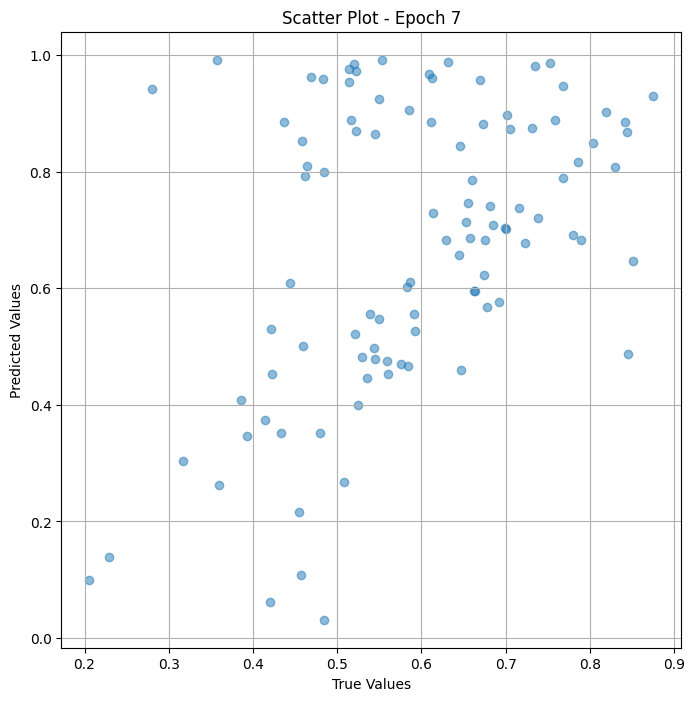


 Epoch: (8/100) Loss = 0.003078298643231392

 Epoch: (8/100) Loss_rmse = 0.055482417345047

 Epoch: (8/100) R^2 = 0.738523006439209

 Epoch: (8/100) MAE = 0.046064481139183044

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228813

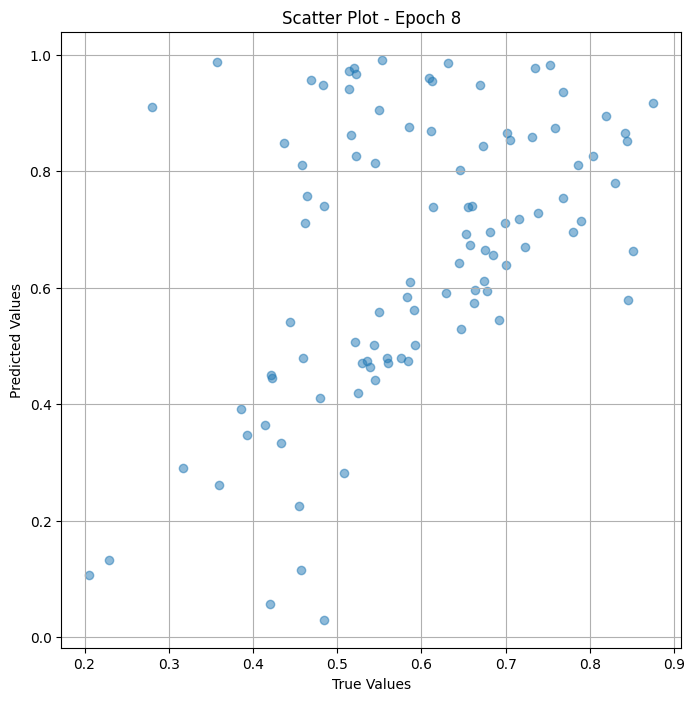


 Epoch: (9/100) Loss = 0.0015047108754515648

 Epoch: (9/100) Loss_rmse = 0.03879060223698616

 Epoch: (9/100) R^2 = 0.8721867799758911

 Epoch: (9/100) MAE = 0.028611168265342712

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

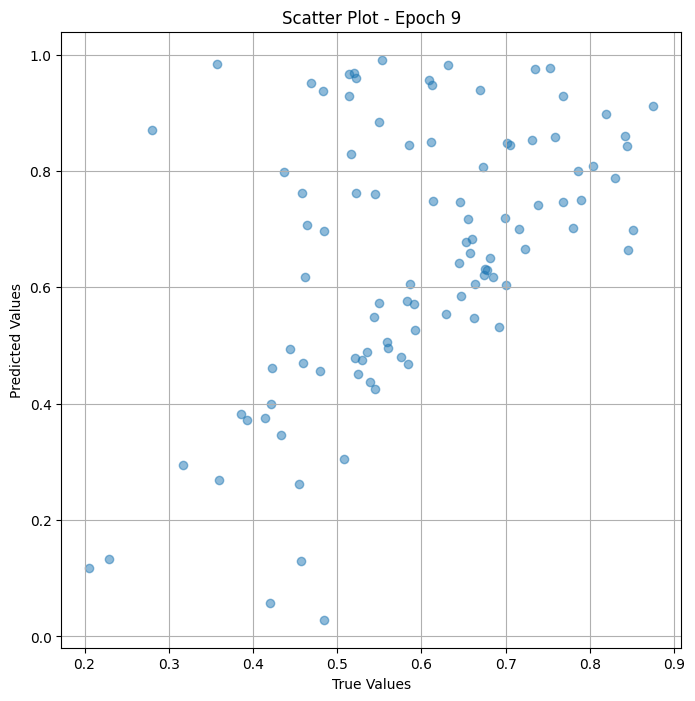


 Epoch: (10/100) Loss = 0.0009273402392864227

 Epoch: (10/100) Loss_rmse = 0.030452260747551918

 Epoch: (10/100) R^2 = 0.9212298393249512

 Epoch: (10/100) MAE = 0.027410253882408142

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

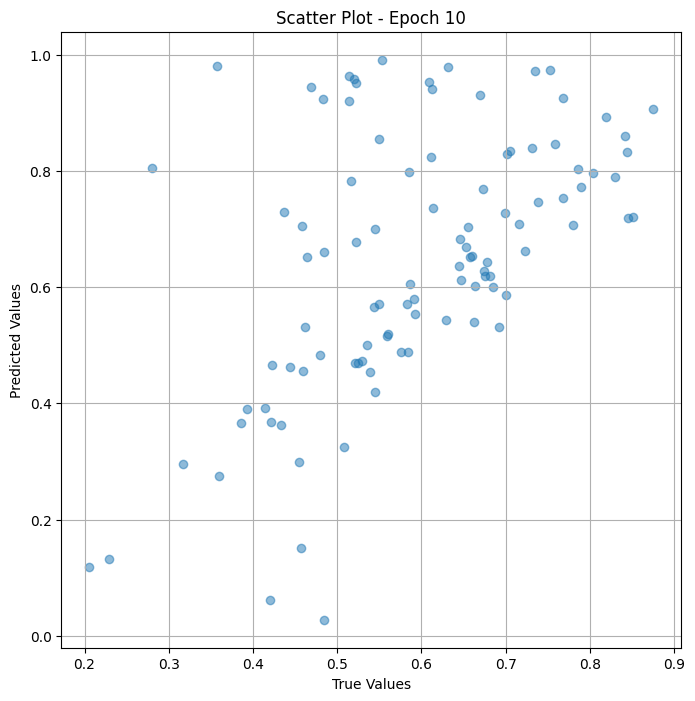


 Epoch: (11/100) Loss = 0.0006471590022556484

 Epoch: (11/100) Loss_rmse = 0.025439320132136345

 Epoch: (11/100) R^2 = 0.9450289607048035

 Epoch: (11/100) MAE = 0.022017285227775574

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

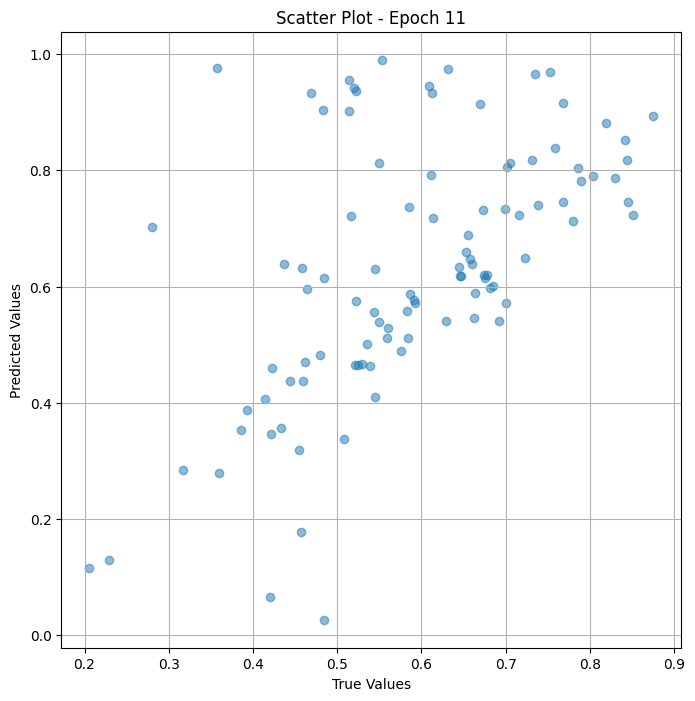


 Epoch: (12/100) Loss = 0.00042731603025458753

 Epoch: (12/100) Loss_rmse = 0.020671624690294266

 Epoch: (12/100) R^2 = 0.963702917098999

 Epoch: (12/100) MAE = 0.014494180679321289

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

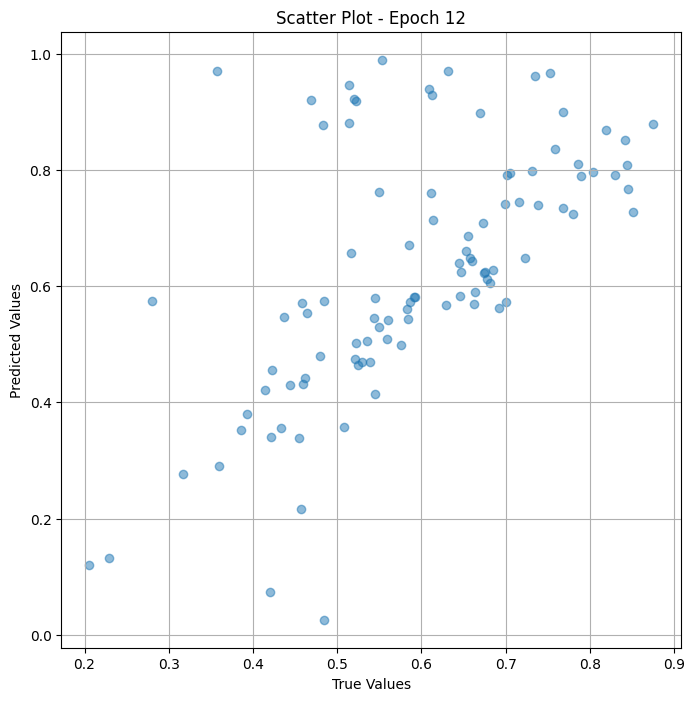


 Epoch: (13/100) Loss = 0.0004440633929334581

 Epoch: (13/100) Loss_rmse = 0.021072812378406525

 Epoch: (13/100) R^2 = 0.9622803330421448

 Epoch: (13/100) MAE = 0.016264259815216064

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

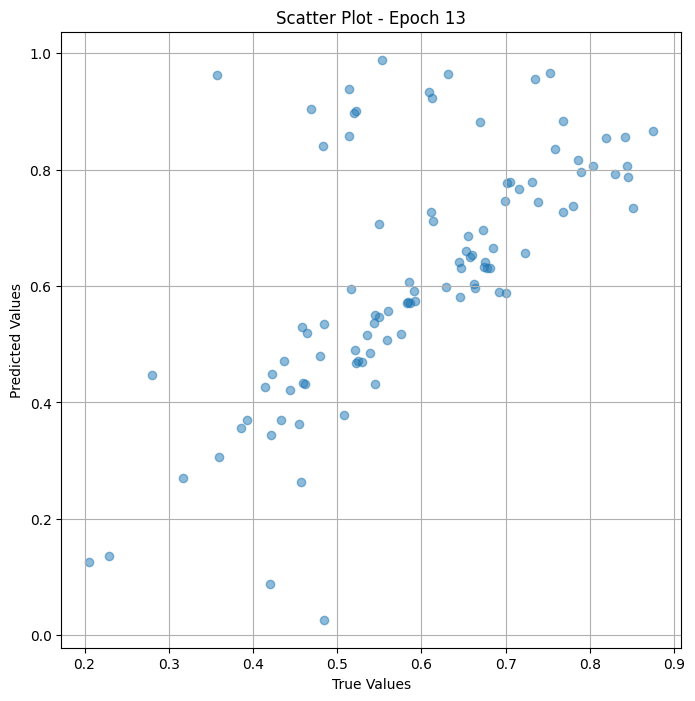


 Epoch: (14/100) Loss = 0.0005169245996512473

 Epoch: (14/100) Loss_rmse = 0.022735975682735443

 Epoch: (14/100) R^2 = 0.9560913443565369

 Epoch: (14/100) MAE = 0.01883476972579956

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 

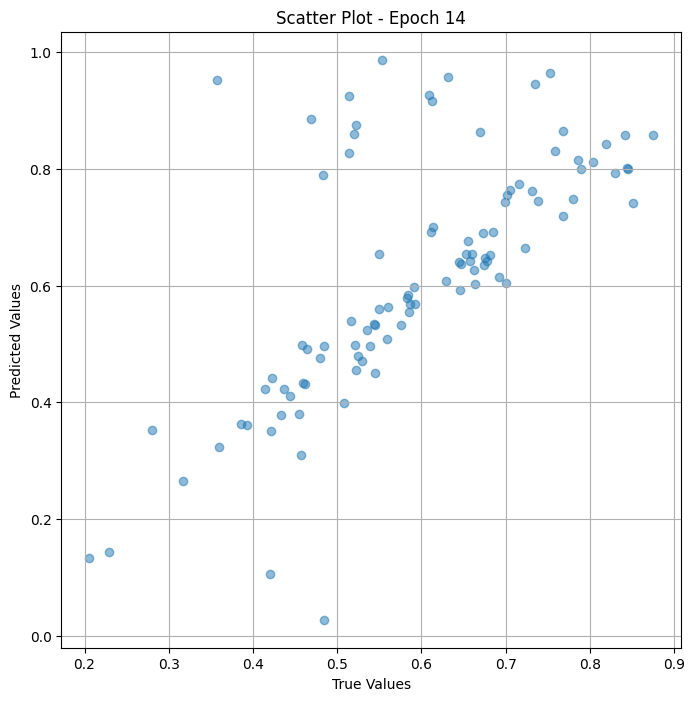


 Epoch: (15/100) Loss = 0.0005101533606648445

 Epoch: (15/100) Loss_rmse = 0.022586574777960777

 Epoch: (15/100) R^2 = 0.9566665291786194

 Epoch: (15/100) MAE = 0.018669113516807556

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

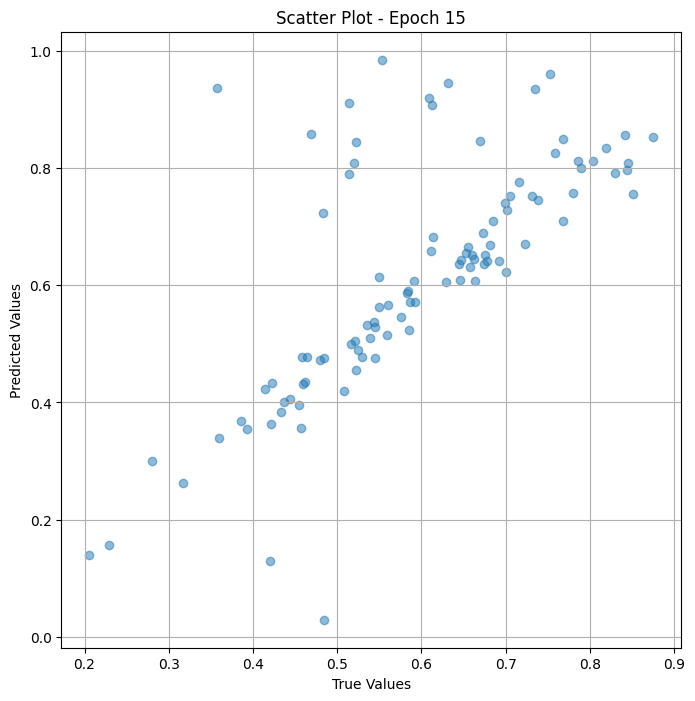


 Epoch: (16/100) Loss = 0.0005880093667656183

 Epoch: (16/100) Loss_rmse = 0.02424890361726284

 Epoch: (16/100) R^2 = 0.9500532746315002

 Epoch: (16/100) MAE = 0.019018888473510742

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 

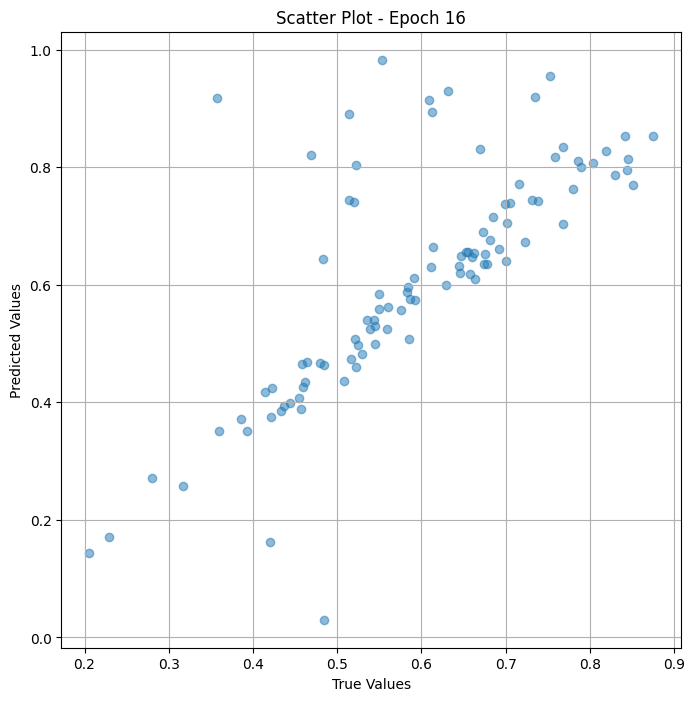


 Epoch: (17/100) Loss = 0.0006988868117332458

 Epoch: (17/100) Loss_rmse = 0.026436466723680496

 Epoch: (17/100) R^2 = 0.9406351447105408

 Epoch: (17/100) MAE = 0.01949550211429596

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 

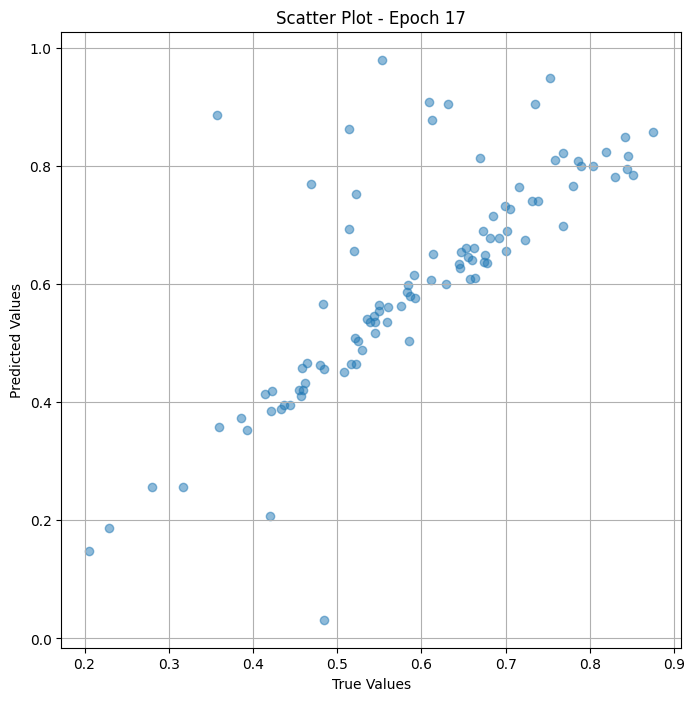


 Epoch: (18/100) Loss = 0.0008627954521216452

 Epoch: (18/100) Loss_rmse = 0.029373379424214363

 Epoch: (18/100) R^2 = 0.9267123937606812

 Epoch: (18/100) MAE = 0.02061586081981659

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 

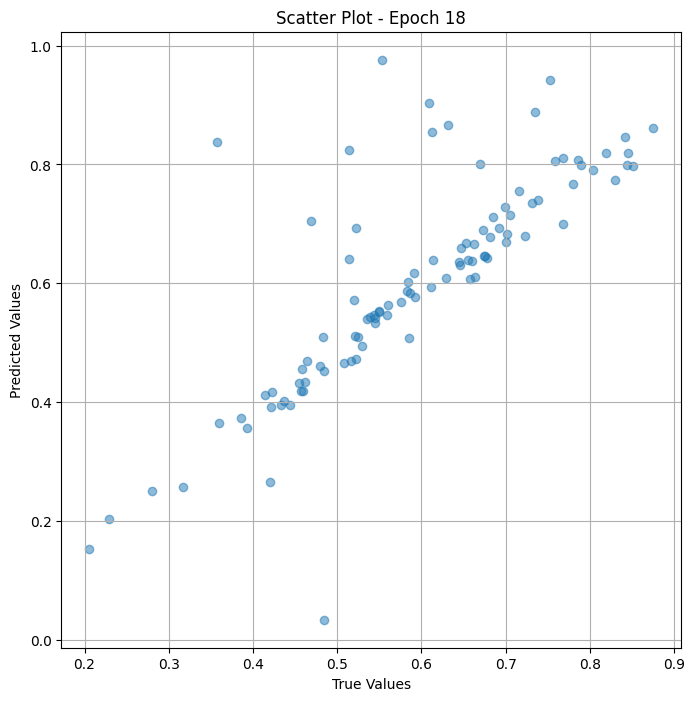


 Epoch: (19/100) Loss = 0.0009361796546727419

 Epoch: (19/100) Loss_rmse = 0.030597053468227386

 Epoch: (19/100) R^2 = 0.9204789996147156

 Epoch: (19/100) MAE = 0.02030158042907715

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 

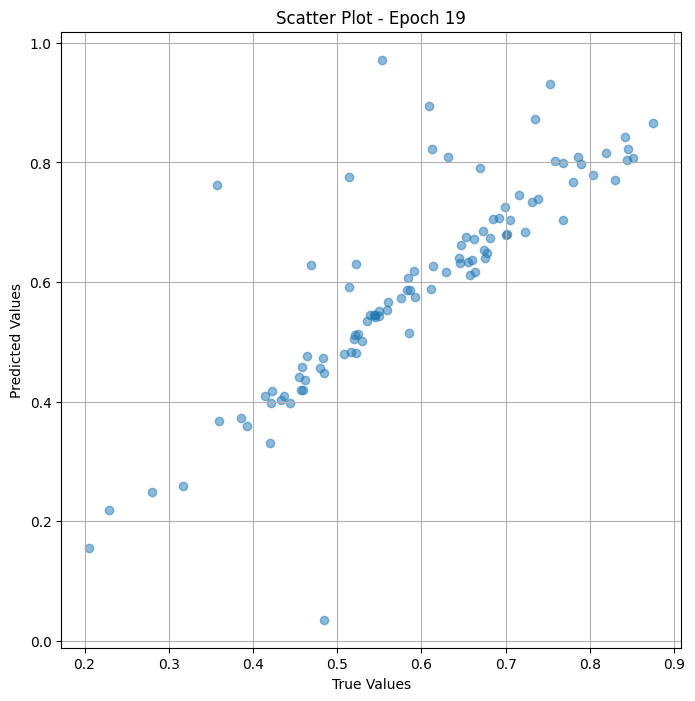


 Epoch: (20/100) Loss = 0.0006794330547563732

 Epoch: (20/100) Loss_rmse = 0.02606593631207943

 Epoch: (20/100) R^2 = 0.9422875642776489

 Epoch: (20/100) MAE = 0.01667533814907074

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0

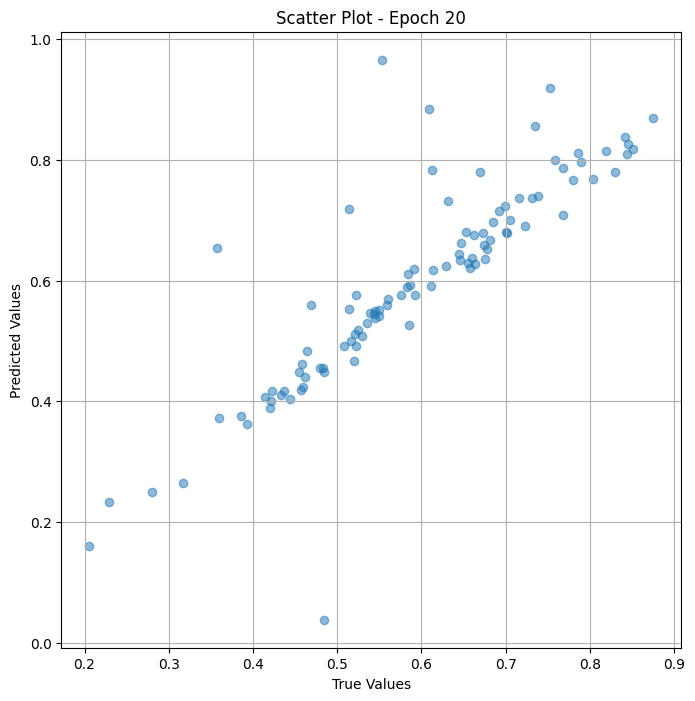


 Epoch: (21/100) Loss = 0.00028387177735567093

 Epoch: (21/100) Loss_rmse = 0.016848495230078697

 Epoch: (21/100) R^2 = 0.9758873581886292

 Epoch: (21/100) MAE = 0.011384934186935425

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28

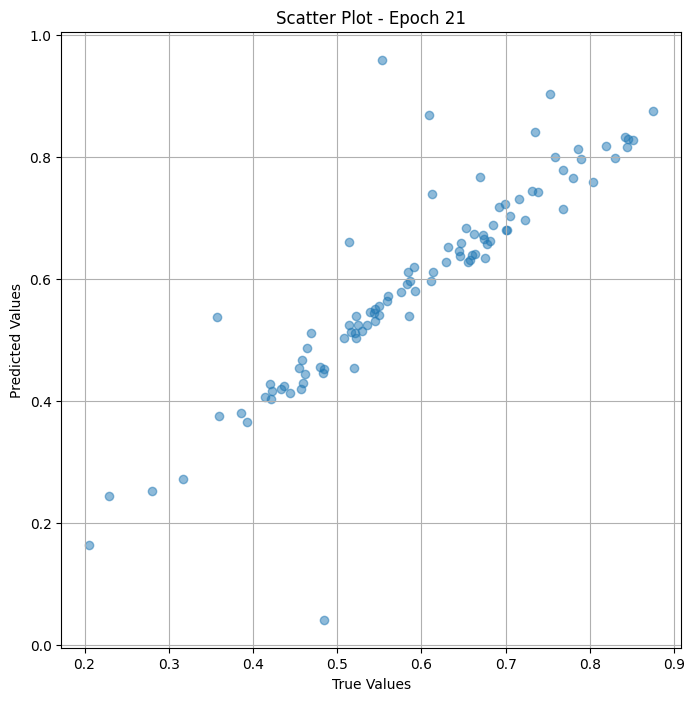


 Epoch: (22/100) Loss = 6.645054236287251e-05

 Epoch: (22/100) Loss_rmse = 0.008151720277965069

 Epoch: (22/100) R^2 = 0.9943555593490601

 Epoch: (22/100) MAE = 0.005883827805519104

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

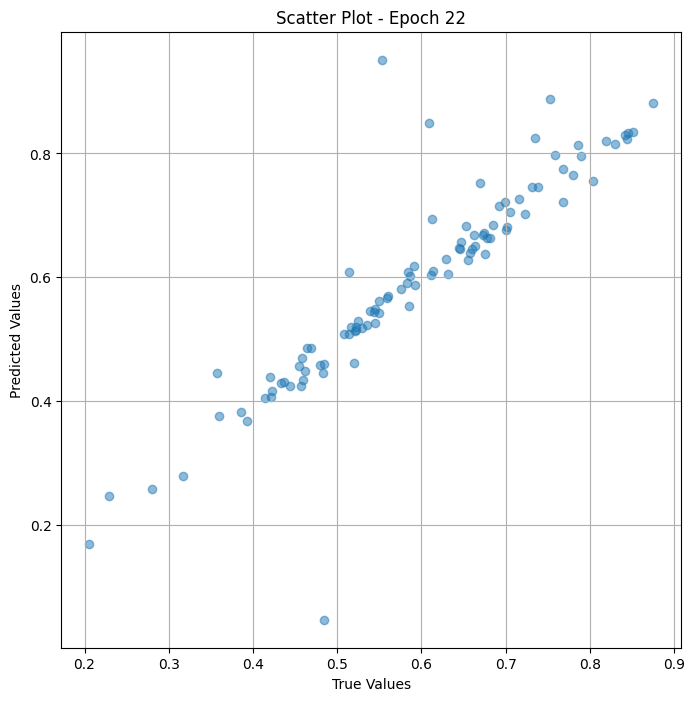


 Epoch: (23/100) Loss = 9.798458449949976e-06

 Epoch: (23/100) Loss_rmse = 0.0031302489805966616

 Epoch: (23/100) R^2 = 0.9991676807403564

 Epoch: (23/100) MAE = 0.002487286925315857

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28

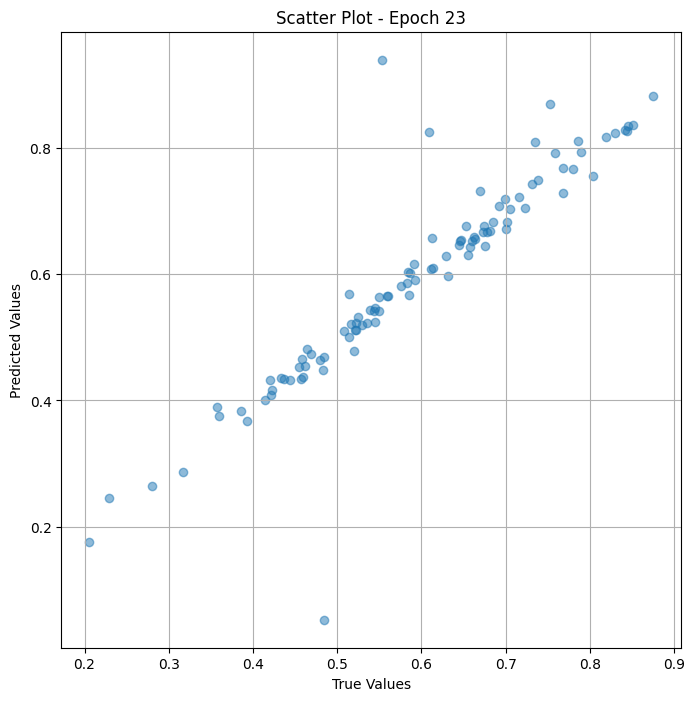


 Epoch: (24/100) Loss = 9.063276138476795e-07

 Epoch: (24/100) Loss_rmse = 0.0009520124294795096

 Epoch: (24/100) R^2 = 0.9999229907989502

 Epoch: (24/100) MAE = 0.0007460266351699829

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

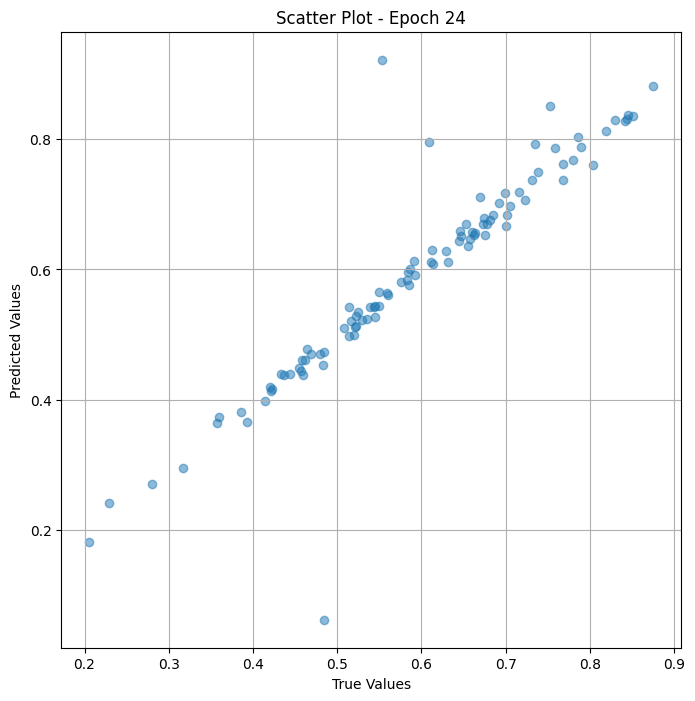


 Epoch: (25/100) Loss = 2.178607019232004e-06

 Epoch: (25/100) Loss_rmse = 0.0014760105405002832

 Epoch: (25/100) R^2 = 0.9998149275779724

 Epoch: (25/100) MAE = 0.001324668526649475

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28

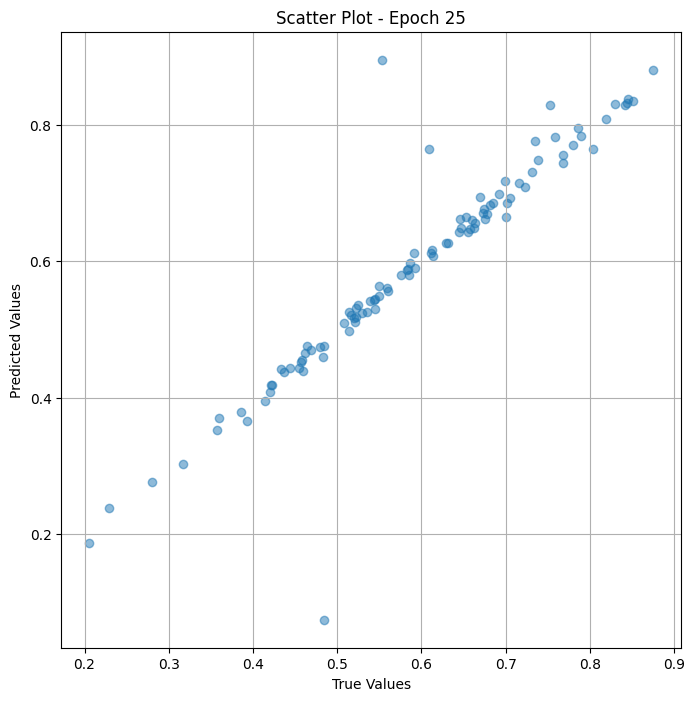


 Epoch: (26/100) Loss = 5.8322780205344316e-06

 Epoch: (26/100) Loss_rmse = 0.0024150109384208918

 Epoch: (26/100) R^2 = 0.999504566192627

 Epoch: (26/100) MAE = 0.0019347965717315674

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

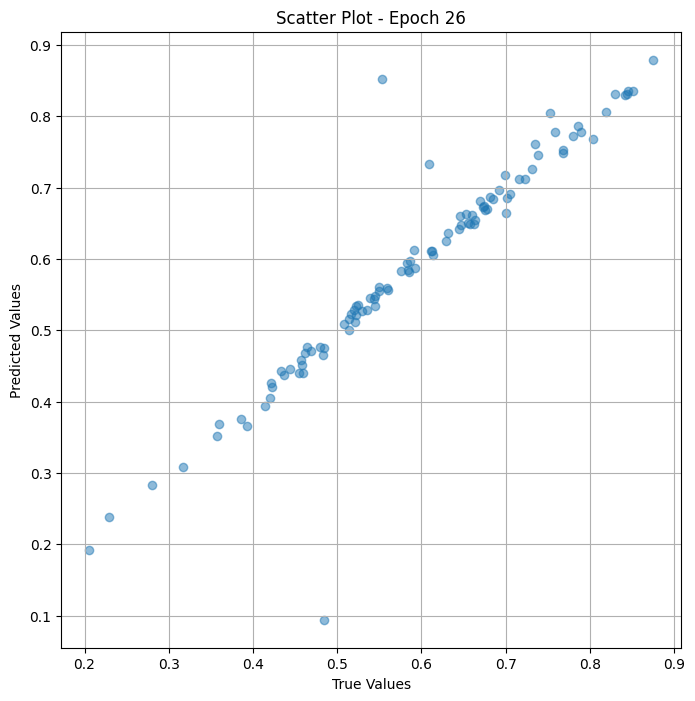


 Epoch: (27/100) Loss = 6.243663847271819e-06

 Epoch: (27/100) Loss_rmse = 0.002498732414096594

 Epoch: (27/100) R^2 = 0.9994696378707886

 Epoch: (27/100) MAE = 0.0019308775663375854

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28

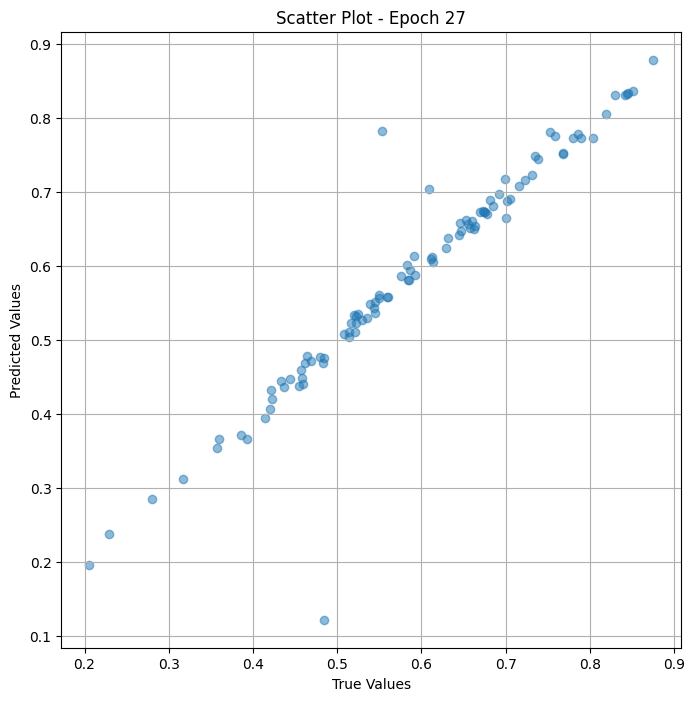


 Epoch: (28/100) Loss = 3.992765414295718e-06

 Epoch: (28/100) Loss_rmse = 0.0019981905352324247

 Epoch: (28/100) R^2 = 0.999660849571228

 Epoch: (28/100) MAE = 0.0018415451049804688

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28

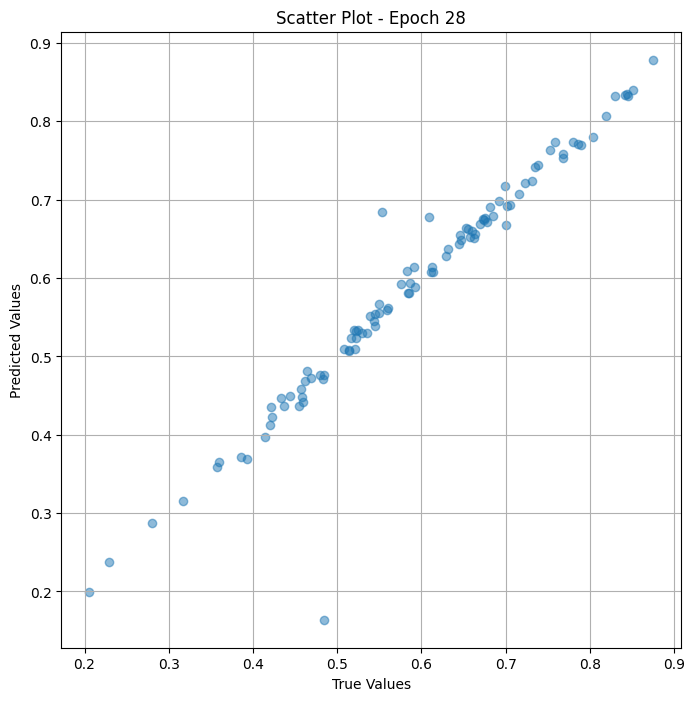


 Epoch: (29/100) Loss = 5.869405413250206e-06

 Epoch: (29/100) Loss_rmse = 0.0024226855020970106

 Epoch: (29/100) R^2 = 0.9995014667510986

 Epoch: (29/100) MAE = 0.00231972336769104

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

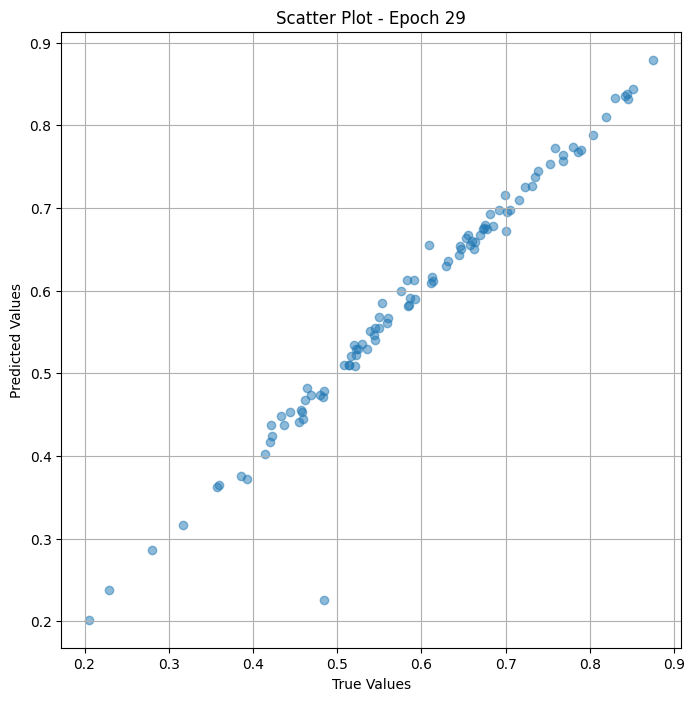


 Epoch: (30/100) Loss = 7.471941444237018e-06

 Epoch: (30/100) Loss_rmse = 0.00273348530754447

 Epoch: (30/100) R^2 = 0.9993653297424316

 Epoch: (30/100) MAE = 0.002687007188796997

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 

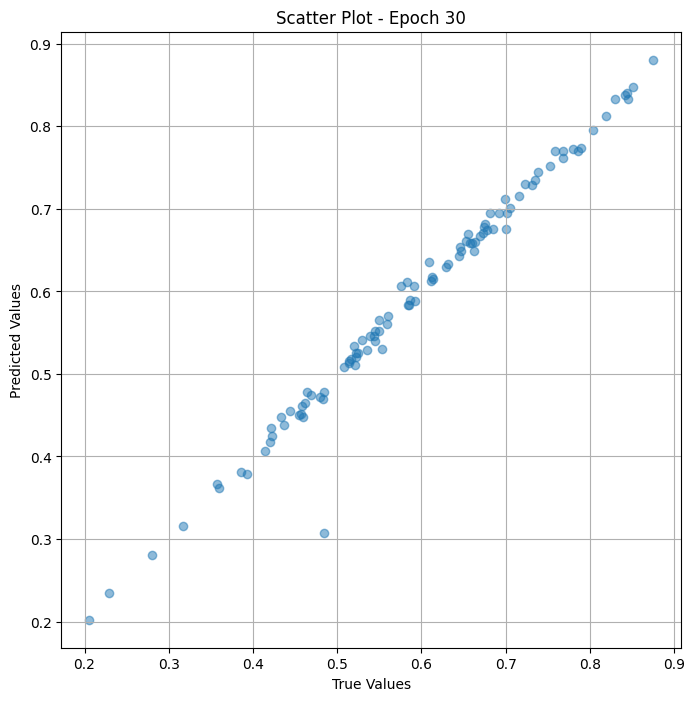


 Epoch: (31/100) Loss = 3.3233154681511223e-06

 Epoch: (31/100) Loss_rmse = 0.0018229963025078177

 Epoch: (31/100) R^2 = 0.9997177124023438

 Epoch: (31/100) MAE = 0.001624777913093567

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

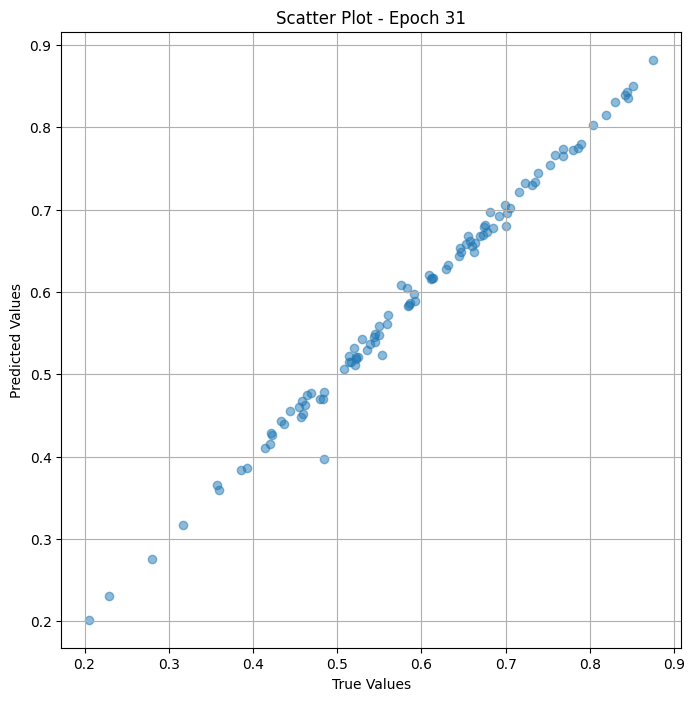


 Epoch: (32/100) Loss = 2.4826607614159e-07

 Epoch: (32/100) Loss_rmse = 0.0004982630489394069

 Epoch: (32/100) R^2 = 0.9999788999557495

 Epoch: (32/100) MAE = 0.00044849514961242676

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28

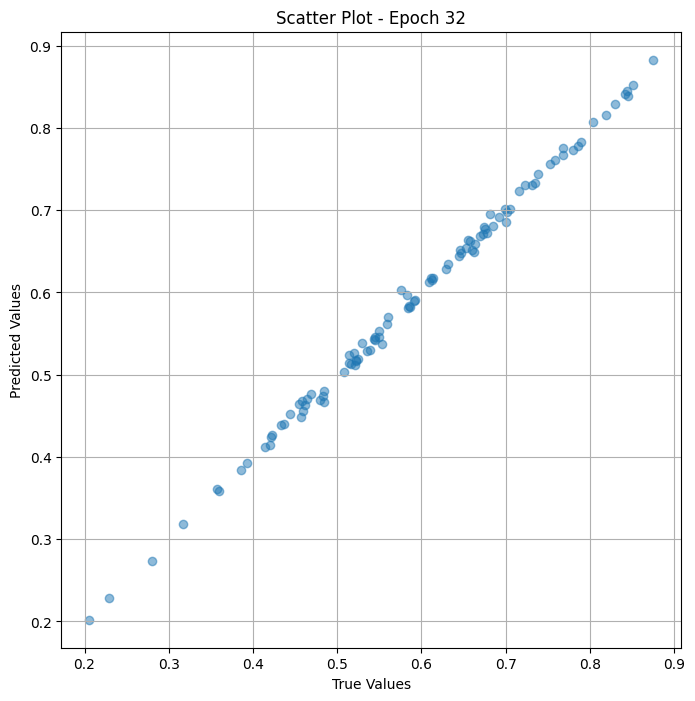


 Epoch: (33/100) Loss = 1.5705855958003667e-06

 Epoch: (33/100) Loss_rmse = 0.001253230031579733

 Epoch: (33/100) R^2 = 0.9998666048049927

 Epoch: (33/100) MAE = 0.0011326521635055542

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

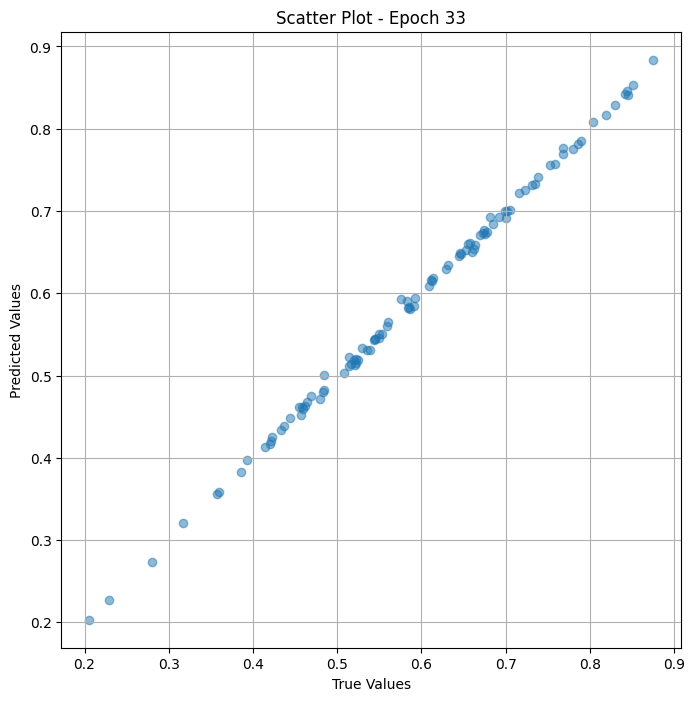


 Epoch: (34/100) Loss = 1.163591718977841e-06

 Epoch: (34/100) Loss_rmse = 0.0010786991333588958

 Epoch: (34/100) R^2 = 0.9999011754989624

 Epoch: (34/100) MAE = 0.0008174777030944824

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

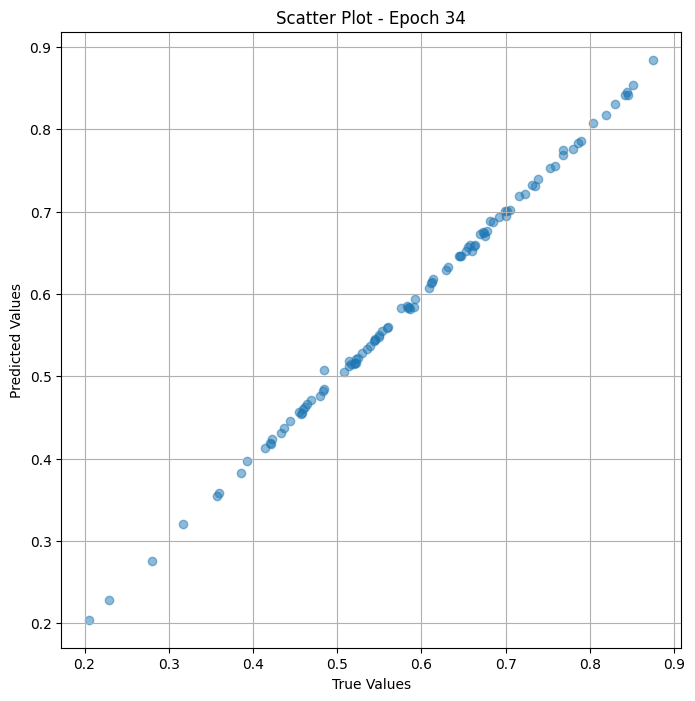


 Epoch: (35/100) Loss = 1.5777959561091848e-07

 Epoch: (35/100) Loss_rmse = 0.00039721481152810156

 Epoch: (35/100) R^2 = 0.9999865889549255

 Epoch: (35/100) MAE = 0.0003686249256134033

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

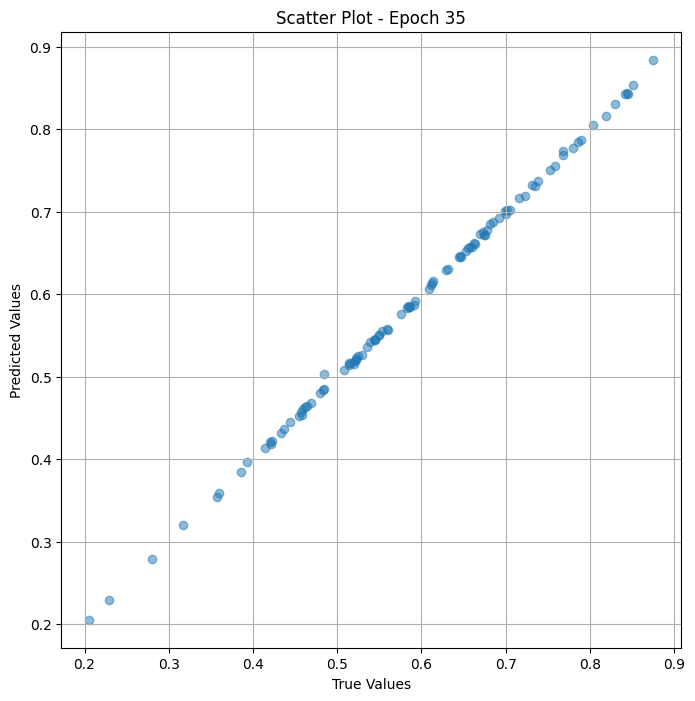


 Epoch: (36/100) Loss = 2.429565029160585e-07

 Epoch: (36/100) Loss_rmse = 0.0004929061979055405

 Epoch: (36/100) R^2 = 0.9999793767929077

 Epoch: (36/100) MAE = 0.0004359334707260132

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

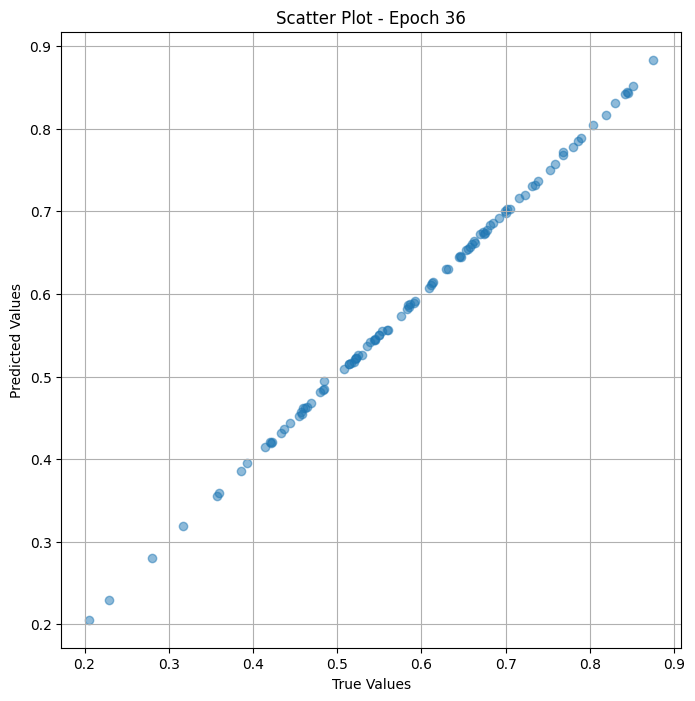


 Epoch: (37/100) Loss = 1.5170562051025627e-07

 Epoch: (37/100) Loss_rmse = 0.0003894940600730479

 Epoch: (37/100) R^2 = 0.9999871253967285

 Epoch: (37/100) MAE = 0.00033442676067352295

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

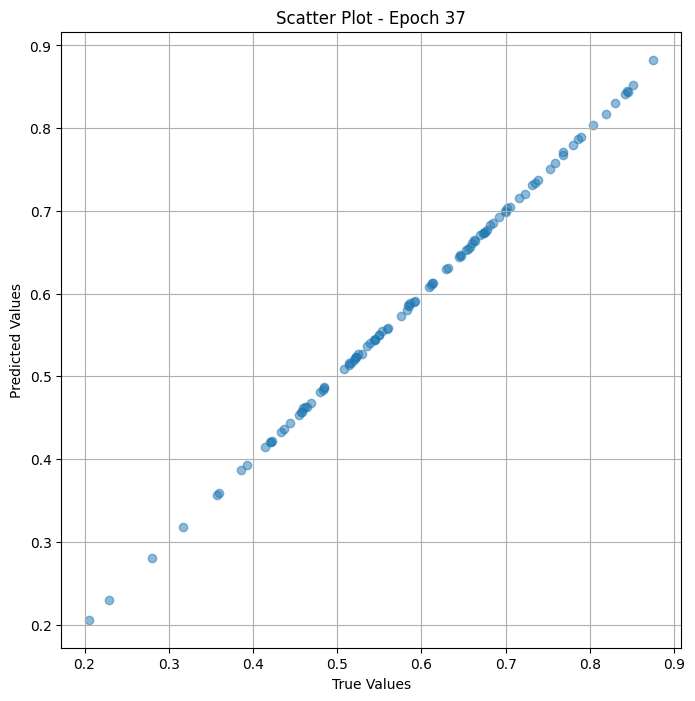


 Epoch: (38/100) Loss = 1.8314795013907315e-08

 Epoch: (38/100) Loss_rmse = 0.00013533217133954167

 Epoch: (38/100) R^2 = 0.9999984502792358

 Epoch: (38/100) MAE = 0.00012302398681640625

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 

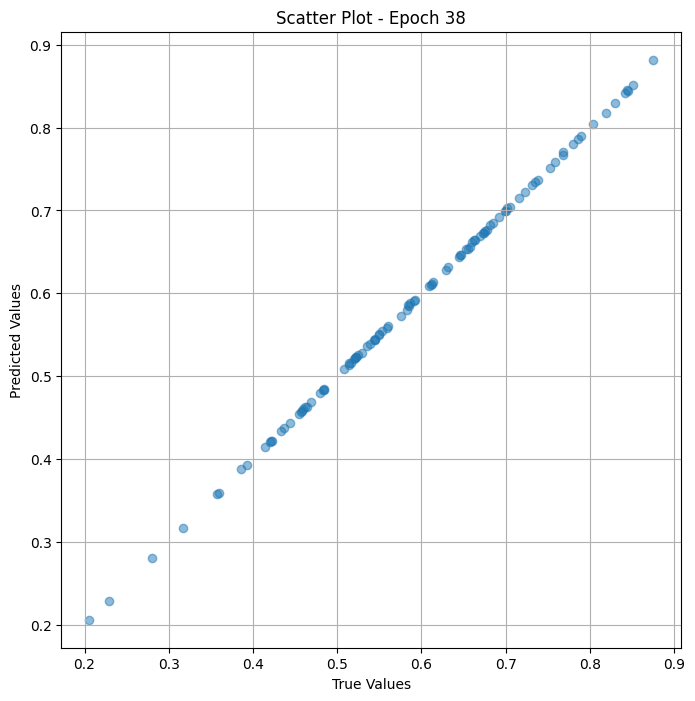


 Epoch: (39/100) Loss = 2.0471357942142276e-08

 Epoch: (39/100) Loss_rmse = 0.00014307815581560135

 Epoch: (39/100) R^2 = 0.9999982714653015

 Epoch: (39/100) MAE = 0.00013300776481628418

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 

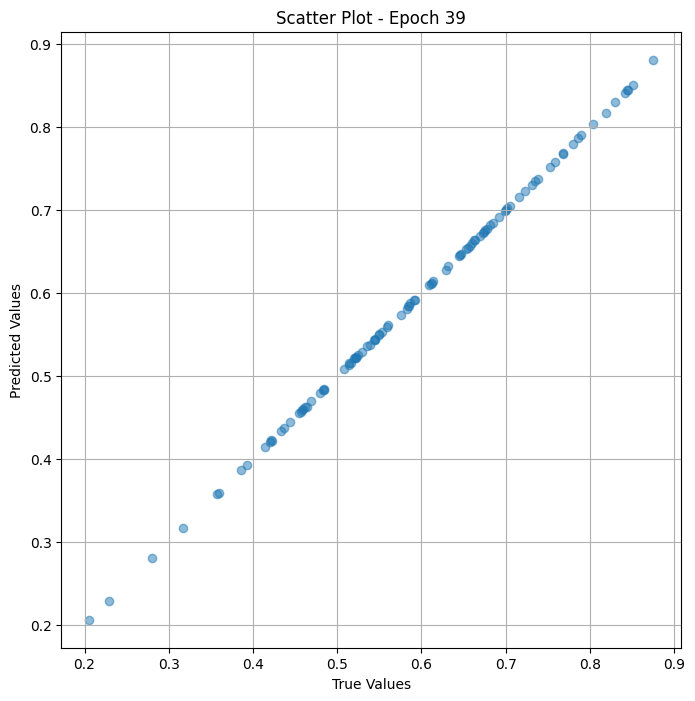


 Epoch: (40/100) Loss = 3.912449031417964e-08

 Epoch: (40/100) Loss_rmse = 0.00019779911963269114

 Epoch: (40/100) R^2 = 0.9999966621398926

 Epoch: (40/100) MAE = 0.00014451146125793457

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

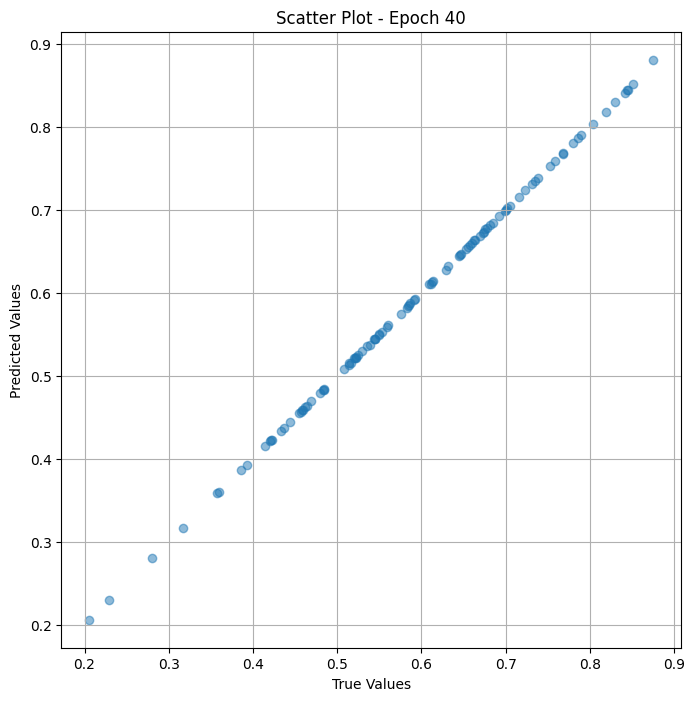


 Epoch: (41/100) Loss = 2.5683704052426037e-08

 Epoch: (41/100) Loss_rmse = 0.00016026136290747672

 Epoch: (41/100) R^2 = 0.9999977946281433

 Epoch: (41/100) MAE = 0.00011277198791503906

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 

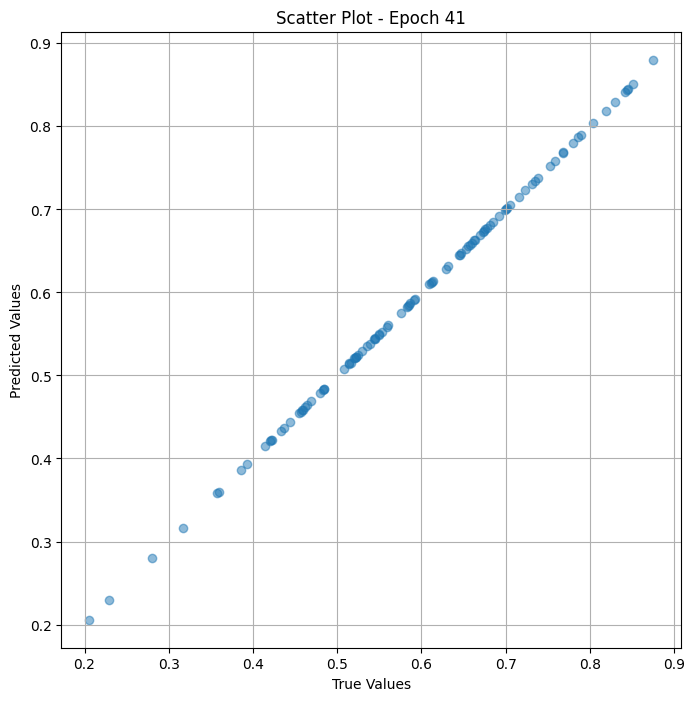


 Epoch: (42/100) Loss = 1.0294600727434045e-08

 Epoch: (42/100) Loss_rmse = 0.00010146231215912849

 Epoch: (42/100) R^2 = 0.9999991059303284

 Epoch: (42/100) MAE = 6.309151649475098e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

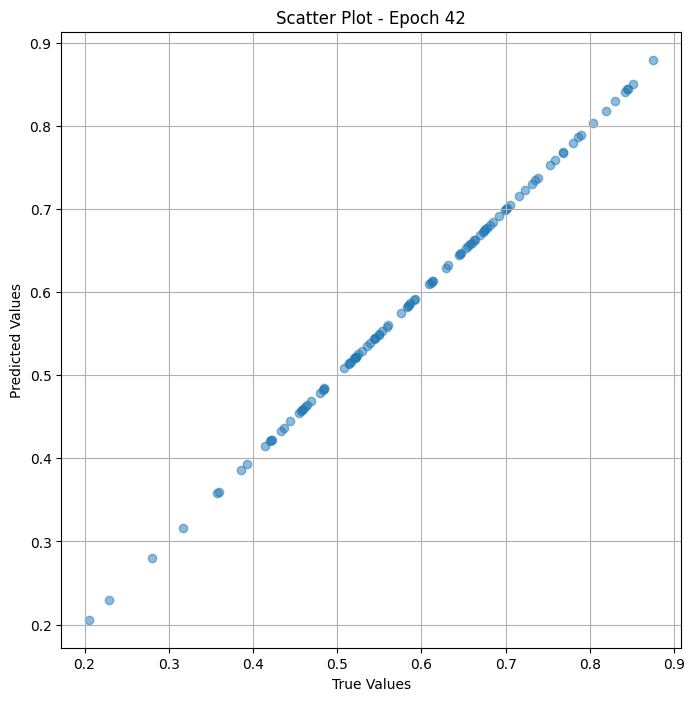


 Epoch: (43/100) Loss = 5.384647394635067e-09

 Epoch: (43/100) Loss_rmse = 7.338015711866319e-05

 Epoch: (43/100) R^2 = 0.9999995231628418

 Epoch: (43/100) MAE = 4.425644874572754e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

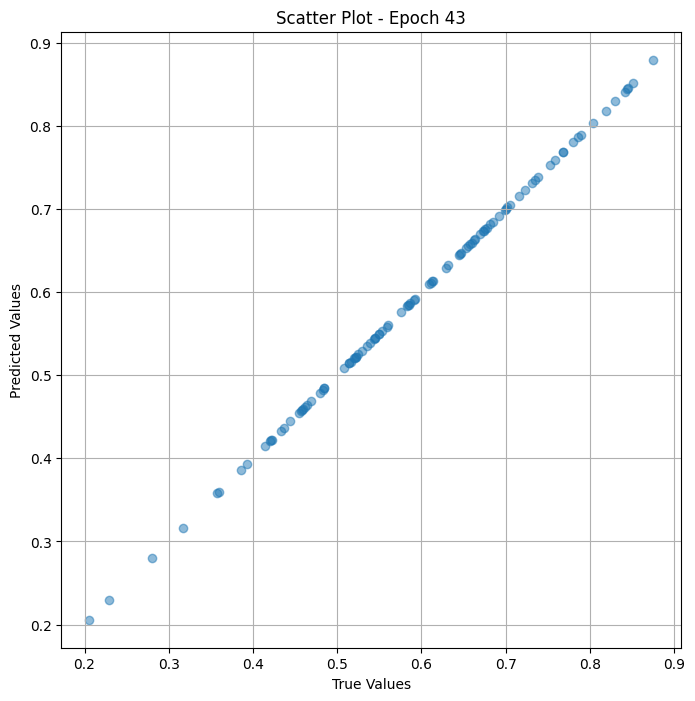


 Epoch: (44/100) Loss = 3.054423380888238e-09

 Epoch: (44/100) Loss_rmse = 5.52668388991151e-05

 Epoch: (44/100) R^2 = 0.9999997615814209

 Epoch: (44/100) MAE = 3.78340482711792e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28,

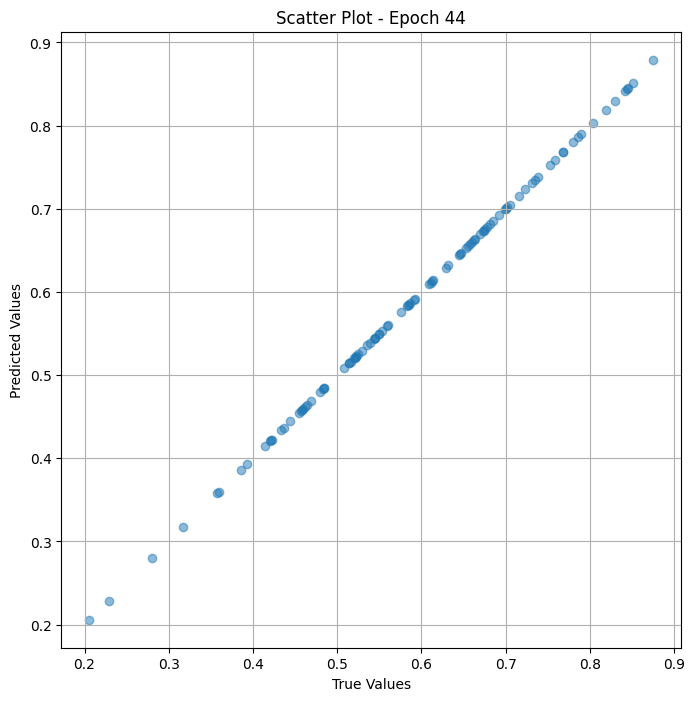


 Epoch: (45/100) Loss = 1.9351737989836693e-09

 Epoch: (45/100) Loss_rmse = 4.3990610720356926e-05

 Epoch: (45/100) R^2 = 0.9999998211860657

 Epoch: (45/100) MAE = 3.534555435180664e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

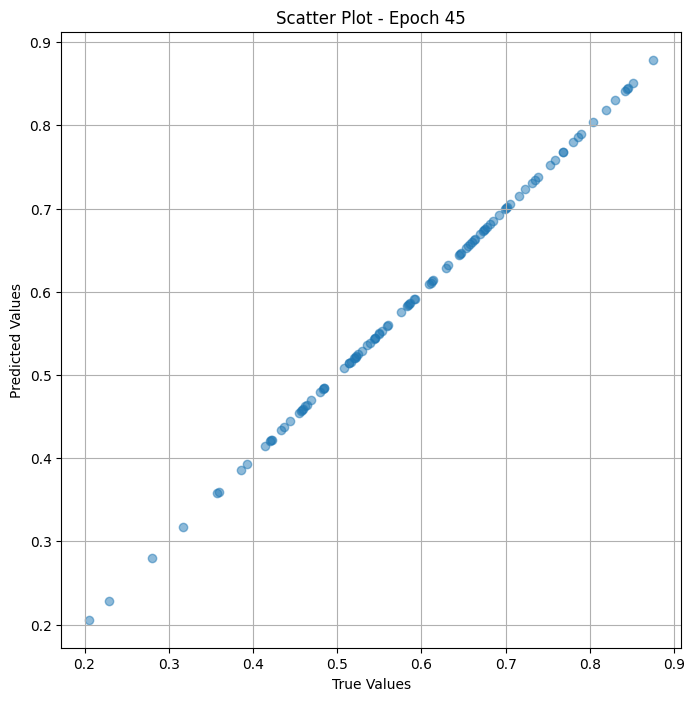


 Epoch: (46/100) Loss = 1.1654313070152966e-09

 Epoch: (46/100) Loss_rmse = 3.41384147759527e-05

 Epoch: (46/100) R^2 = 0.9999998807907104

 Epoch: (46/100) MAE = 2.7939677238464355e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

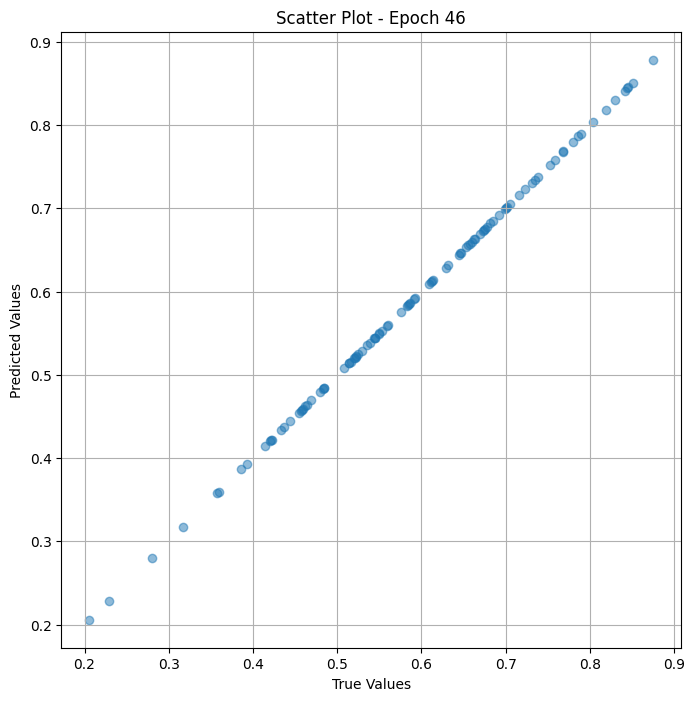


 Epoch: (47/100) Loss = 9.563709824078614e-10

 Epoch: (47/100) Loss_rmse = 3.09252500301227e-05

 Epoch: (47/100) R^2 = 0.9999999403953552

 Epoch: (47/100) MAE = 2.6911497116088867e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

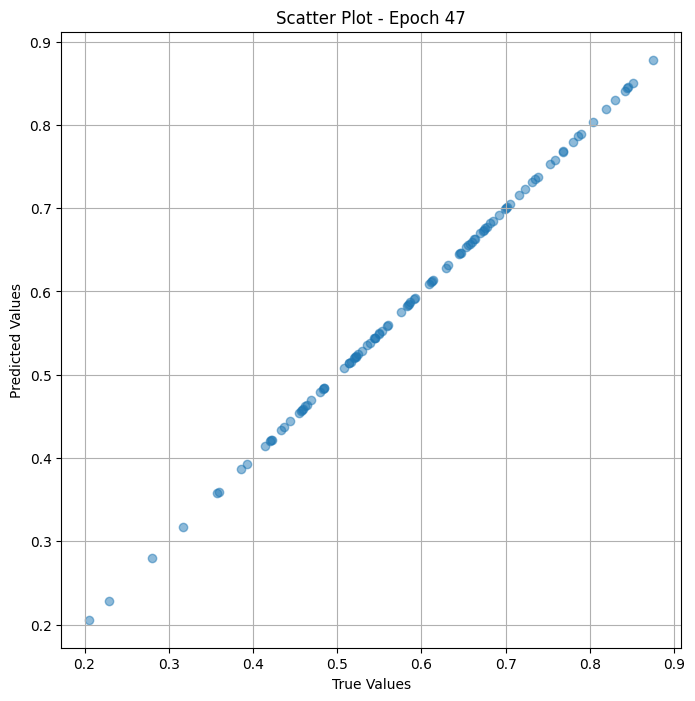


 Epoch: (48/100) Loss = 4.872067194128249e-10

 Epoch: (48/100) Loss_rmse = 2.207275974797085e-05

 Epoch: (48/100) R^2 = 0.9999999403953552

 Epoch: (48/100) MAE = 1.6391277313232422e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

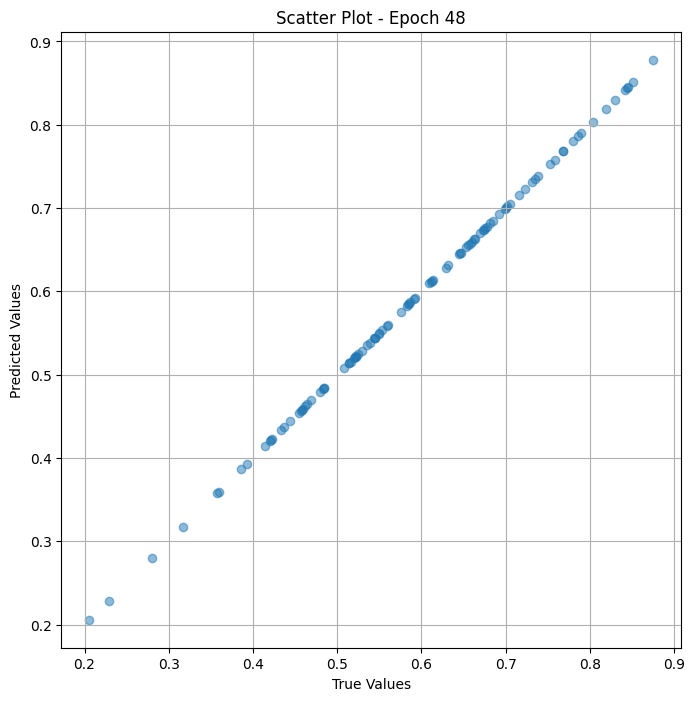


 Epoch: (49/100) Loss = 7.775708965596095e-10

 Epoch: (49/100) Loss_rmse = 2.788495839922689e-05

 Epoch: (49/100) R^2 = 0.9999999403953552

 Epoch: (49/100) MAE = 1.8611550331115723e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

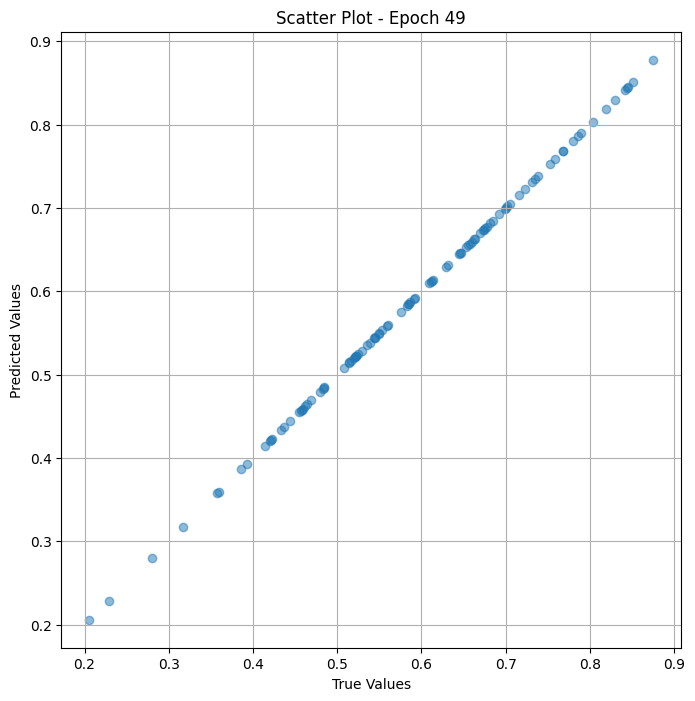


 Epoch: (50/100) Loss = 9.684226753847724e-10

 Epoch: (50/100) Loss_rmse = 3.111948899459094e-05

 Epoch: (50/100) R^2 = 0.9999999403953552

 Epoch: (50/100) MAE = 2.1055340766906738e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

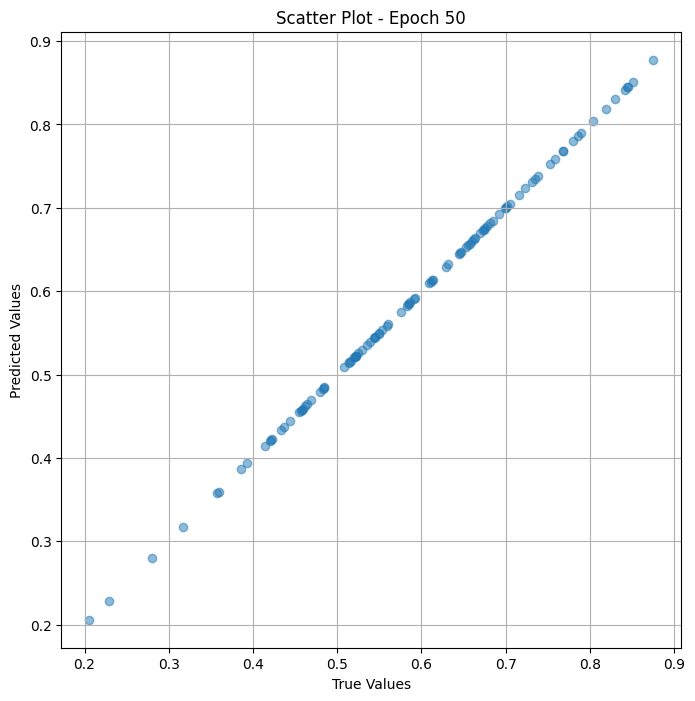


 Epoch: (51/100) Loss = 8.287370789616944e-10

 Epoch: (51/100) Loss_rmse = 2.8787793780793436e-05

 Epoch: (51/100) R^2 = 0.9999999403953552

 Epoch: (51/100) MAE = 1.893937587738037e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

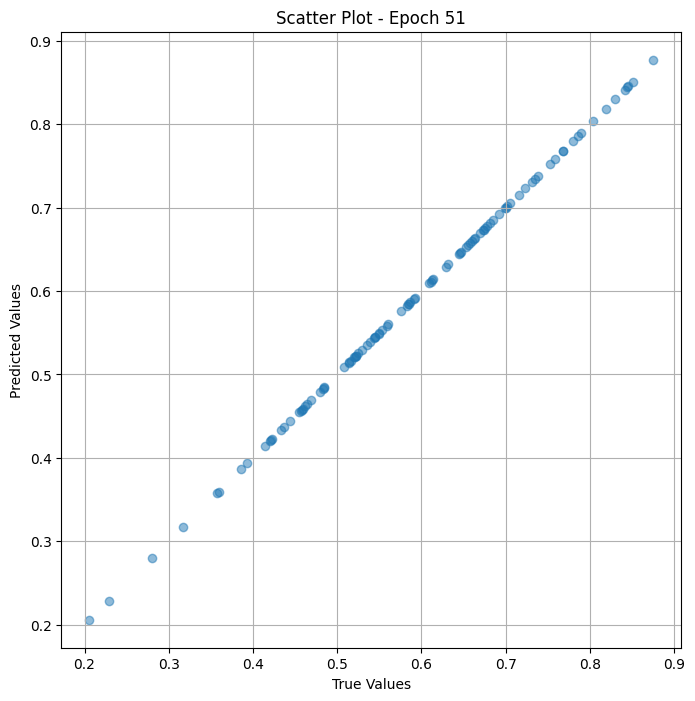


 Epoch: (52/100) Loss = 8.167422294036442e-10

 Epoch: (52/100) Loss_rmse = 2.8578702767845243e-05

 Epoch: (52/100) R^2 = 0.9999999403953552

 Epoch: (52/100) MAE = 1.9729137420654297e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

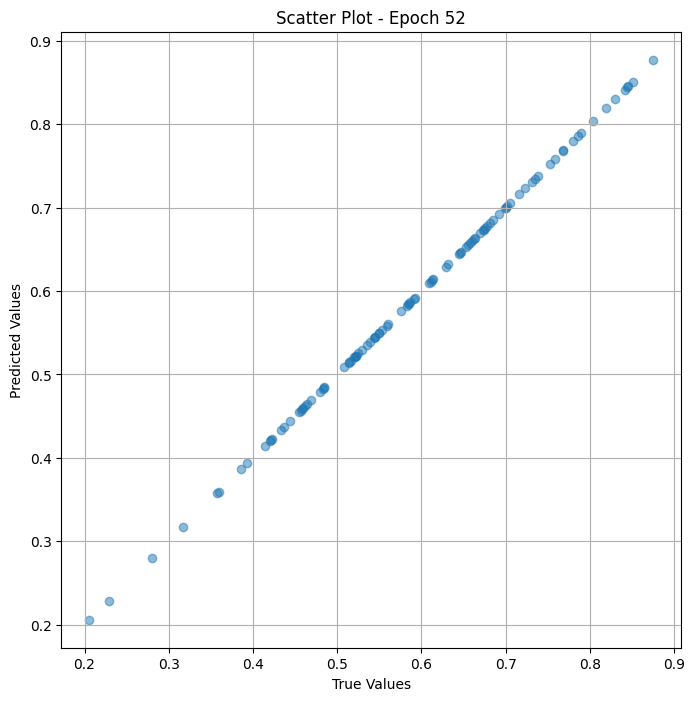


 Epoch: (53/100) Loss = 6.676357244828068e-10

 Epoch: (53/100) Loss_rmse = 2.5838648070930503e-05

 Epoch: (53/100) R^2 = 0.9999999403953552

 Epoch: (53/100) MAE = 1.6704201698303223e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

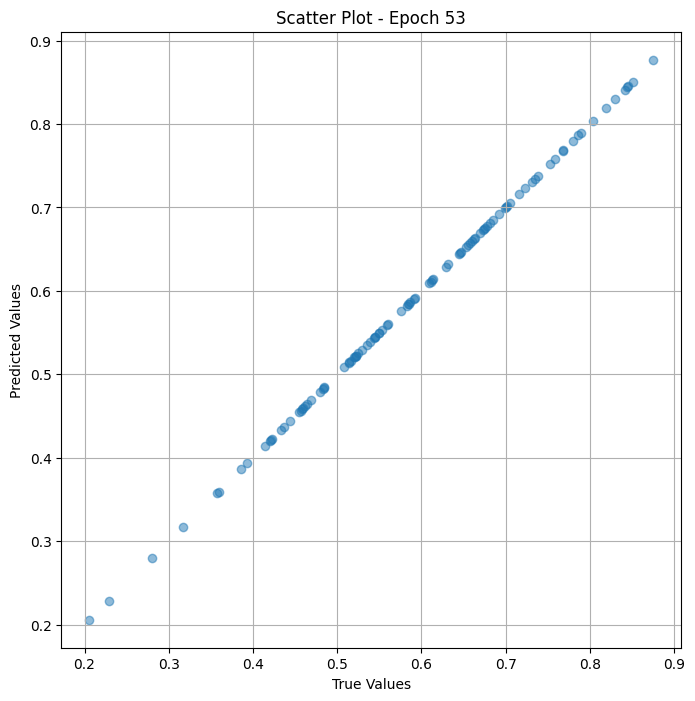


 Epoch: (54/100) Loss = 5.937339508932382e-10

 Epoch: (54/100) Loss_rmse = 2.436665636196267e-05

 Epoch: (54/100) R^2 = 0.9999999403953552

 Epoch: (54/100) MAE = 1.551210880279541e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.2

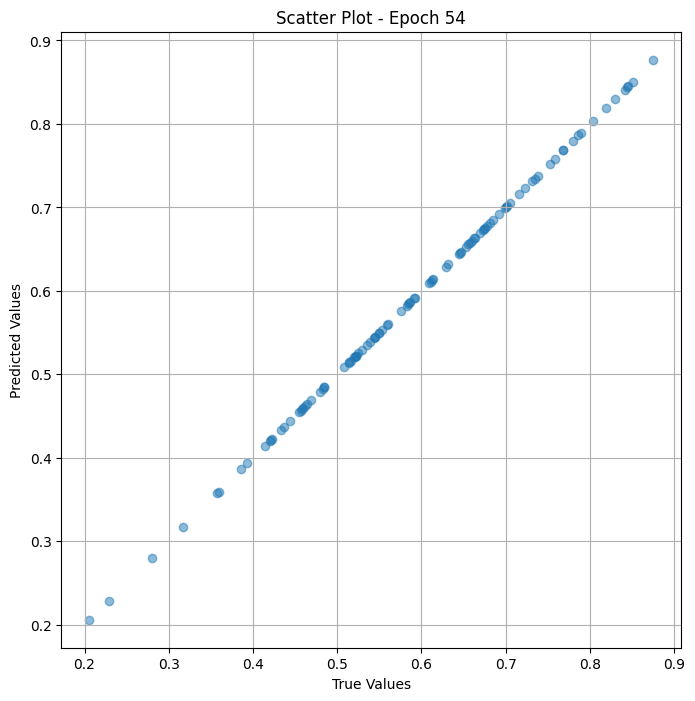


 Epoch: (55/100) Loss = 4.333760017516397e-10

 Epoch: (55/100) Loss_rmse = 2.081768434436526e-05

 Epoch: (55/100) R^2 = 0.9999999403953552

 Epoch: (55/100) MAE = 1.3381242752075195e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

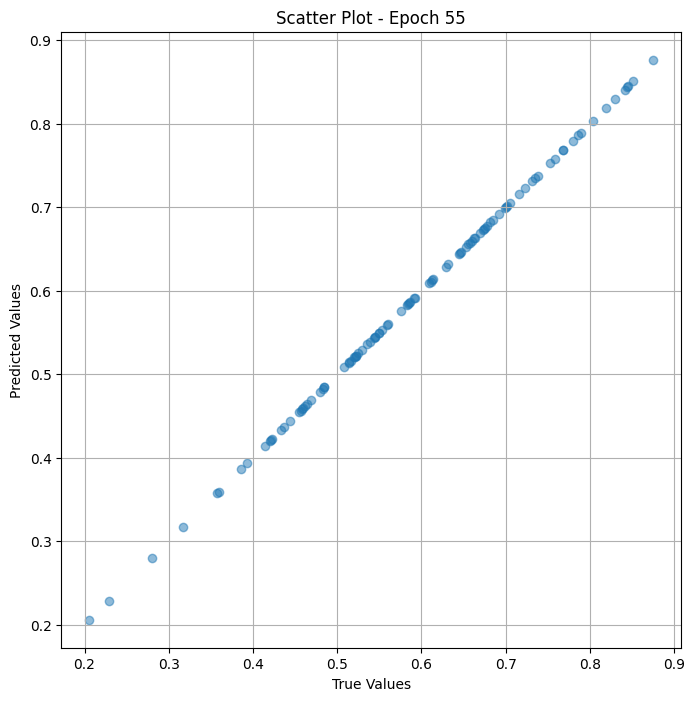


 Epoch: (56/100) Loss = 5.081179921262446e-10

 Epoch: (56/100) Loss_rmse = 2.254147329949774e-05

 Epoch: (56/100) R^2 = 0.9999999403953552

 Epoch: (56/100) MAE = 1.5676021575927734e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

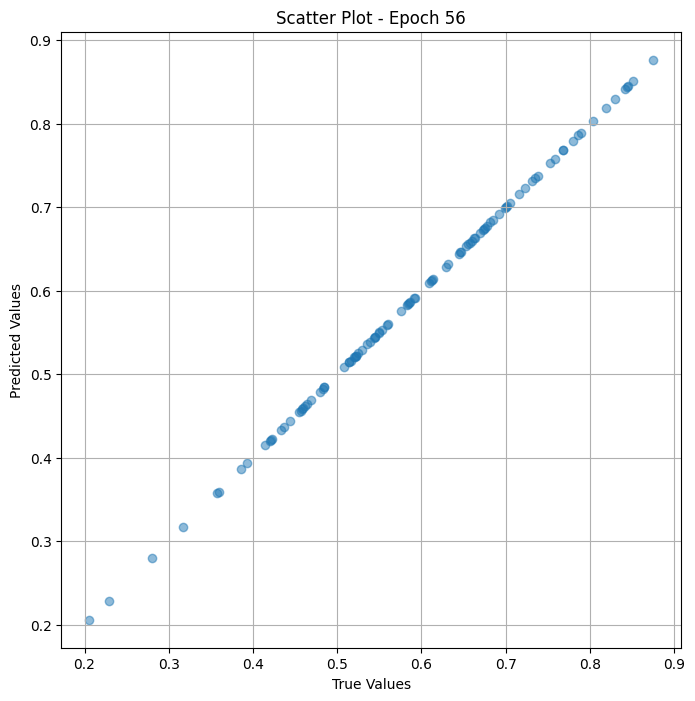


 Epoch: (57/100) Loss = 4.3931525084417444e-10

 Epoch: (57/100) Loss_rmse = 2.095984928018879e-05

 Epoch: (57/100) R^2 = 0.9999999403953552

 Epoch: (57/100) MAE = 1.3515353202819824e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0

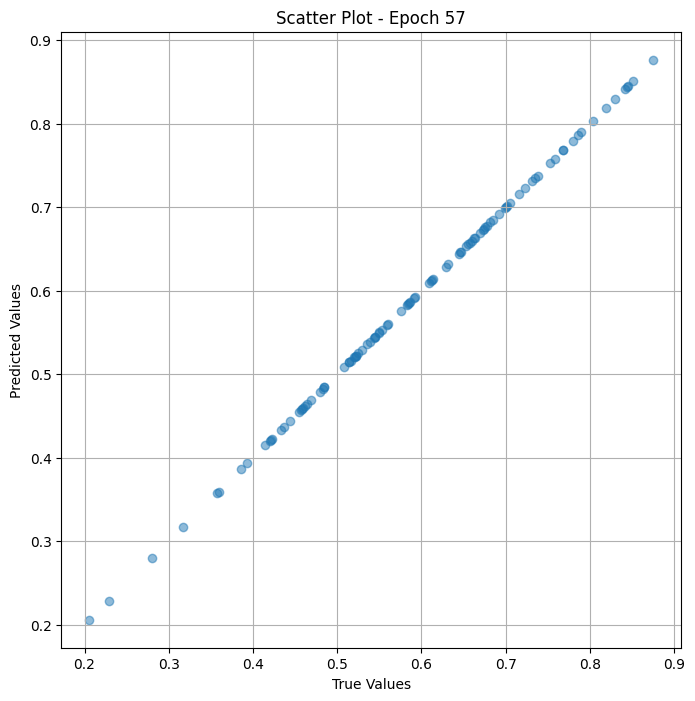


 Epoch: (58/100) Loss = 3.640074908162205e-10

 Epoch: (58/100) Loss_rmse = 1.907897967612371e-05

 Epoch: (58/100) R^2 = 0.9999999403953552

 Epoch: (58/100) MAE = 1.2964010238647461e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.

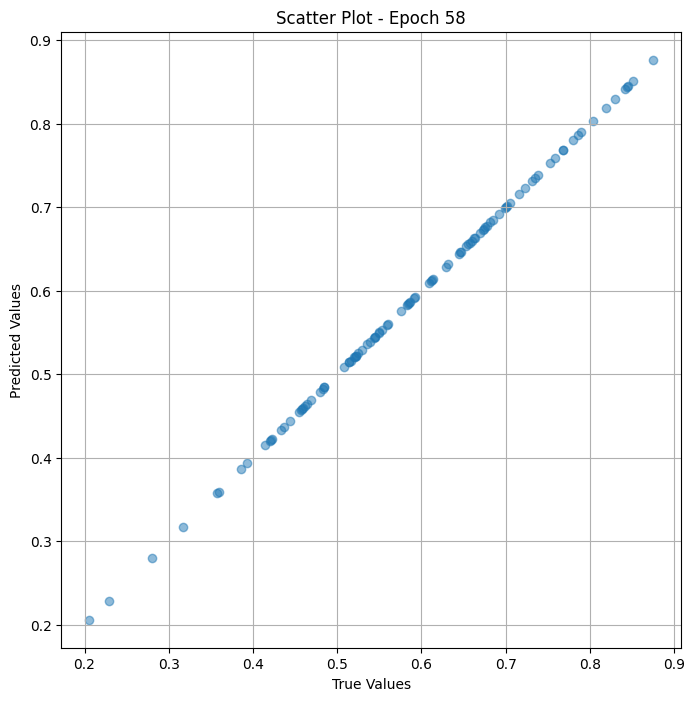


 Epoch: (59/100) Loss = 4.1650682902627523e-10

 Epoch: (59/100) Loss_rmse = 2.0408499040058814e-05

 Epoch: (59/100) R^2 = 0.9999999403953552

 Epoch: (59/100) MAE = 1.2323260307312012e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 

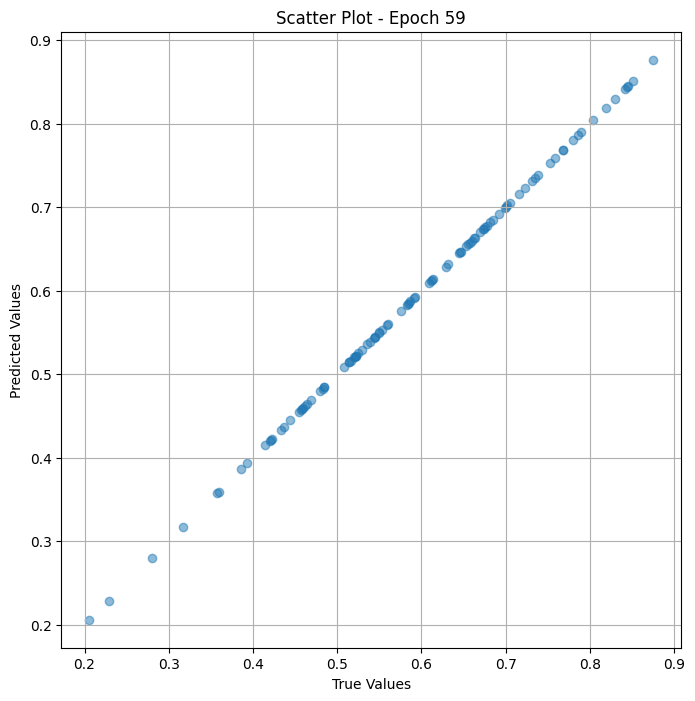


 Epoch: (60/100) Loss = 2.639088947375967e-10

 Epoch: (60/100) Loss_rmse = 1.6245272490778007e-05

 Epoch: (60/100) R^2 = 1.0

 Epoch: (60/100) MAE = 1.0445713996887207e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

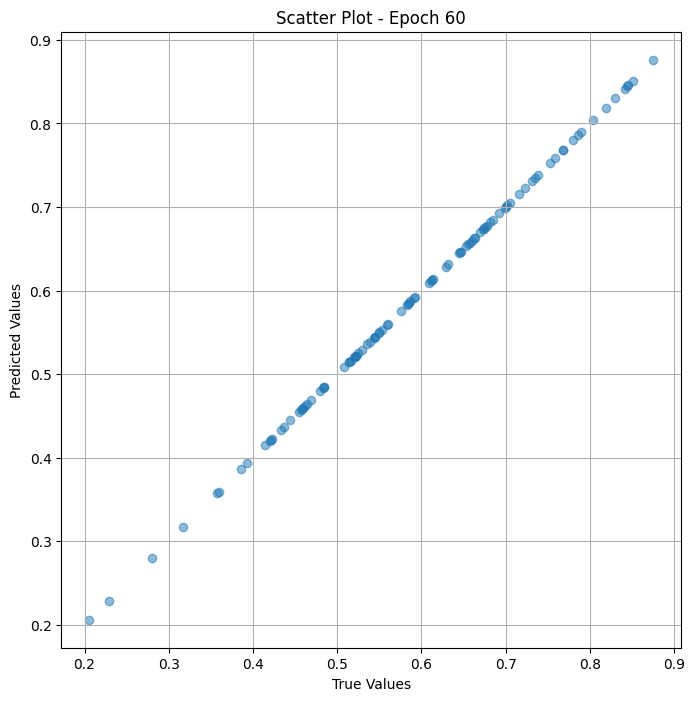


 Epoch: (61/100) Loss = 2.3932322790187754e-10

 Epoch: (61/100) Loss_rmse = 1.5470075595658273e-05

 Epoch: (61/100) R^2 = 1.0

 Epoch: (61/100) MAE = 9.953975677490234e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

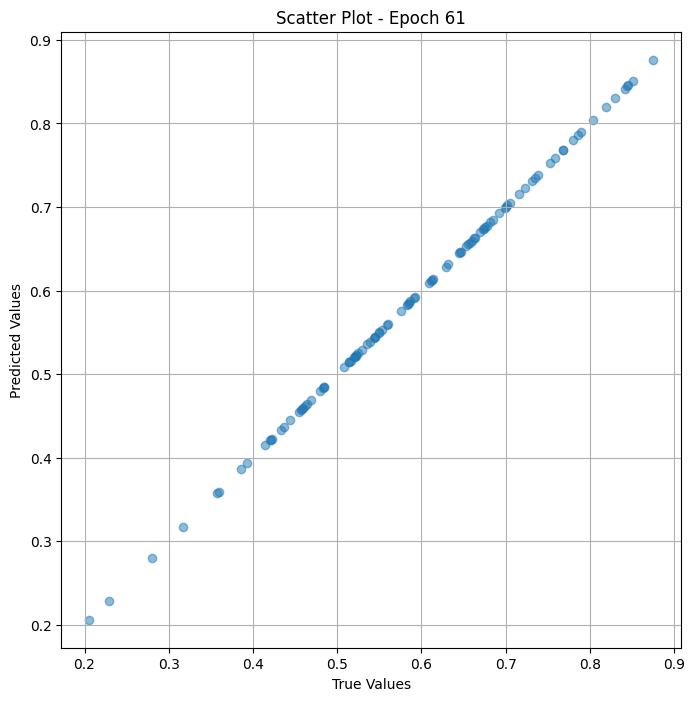


 Epoch: (62/100) Loss = 2.488445005610629e-10

 Epoch: (62/100) Loss_rmse = 1.57748054334661e-05

 Epoch: (62/100) R^2 = 1.0

 Epoch: (62/100) MAE = 1.1116266250610352e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

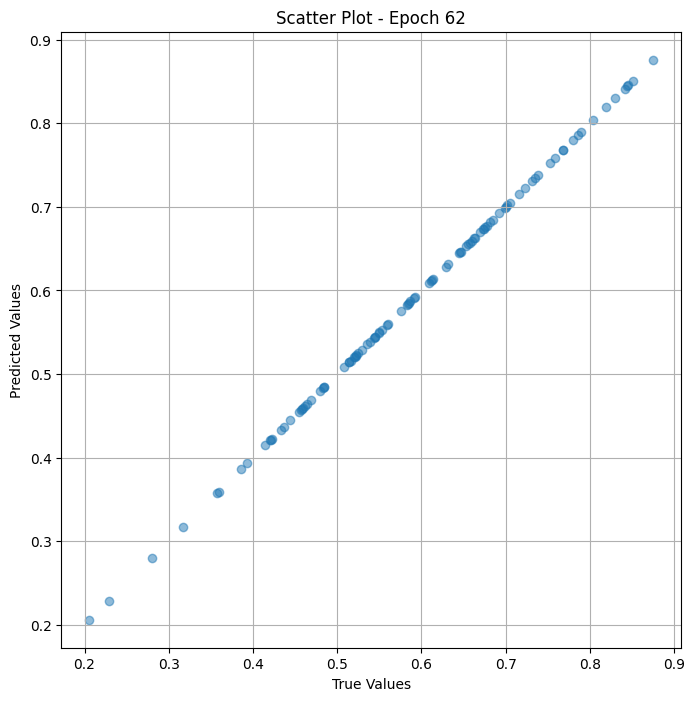


 Epoch: (63/100) Loss = 2.0970780667539657e-10

 Epoch: (63/100) Loss_rmse = 1.4481292055279482e-05

 Epoch: (63/100) R^2 = 1.0

 Epoch: (63/100) MAE = 9.953975677490234e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

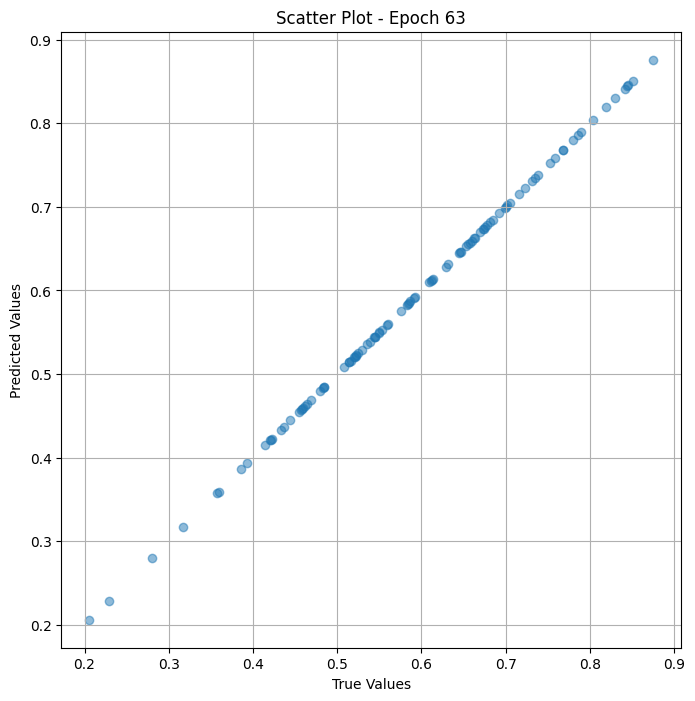


 Epoch: (64/100) Loss = 2.1240342817918645e-10

 Epoch: (64/100) Loss_rmse = 1.4574066881323233e-05

 Epoch: (64/100) R^2 = 1.0

 Epoch: (64/100) MAE = 1.0028481483459473e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288135

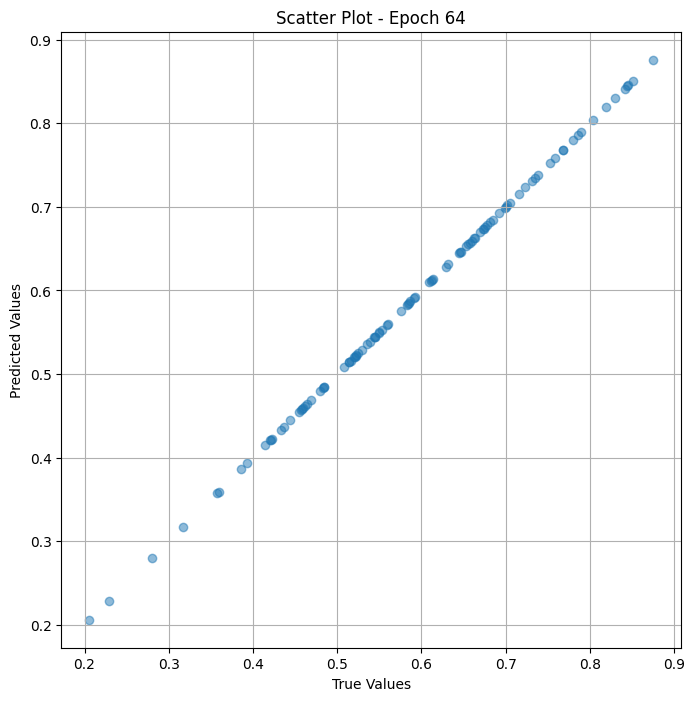


 Epoch: (65/100) Loss = 2.3455370978808787e-10

 Epoch: (65/100) Loss_rmse = 1.531514681119006e-05

 Epoch: (65/100) R^2 = 1.0

 Epoch: (65/100) MAE = 1.0639429092407227e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

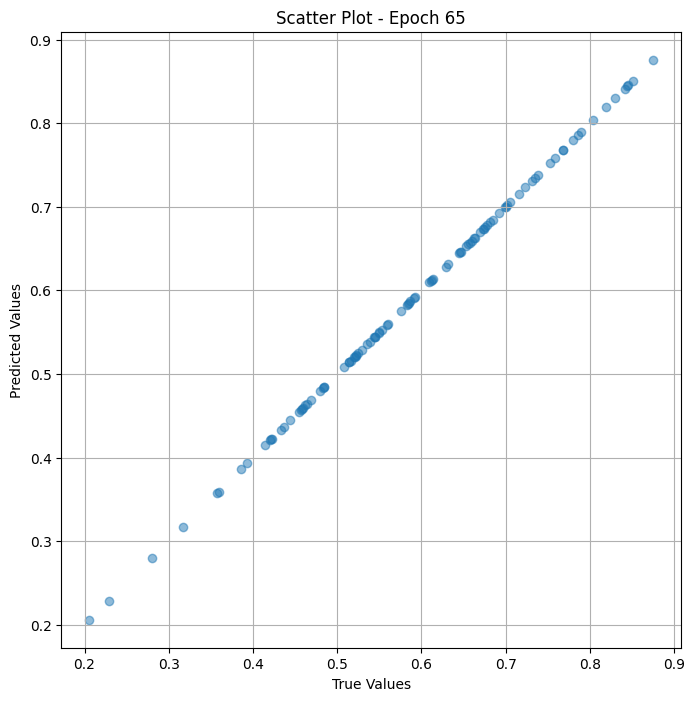


 Epoch: (66/100) Loss = 1.9102053272490593e-10

 Epoch: (66/100) Loss_rmse = 1.3821018001181073e-05

 Epoch: (66/100) R^2 = 1.0

 Epoch: (66/100) MAE = 9.864568710327148e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

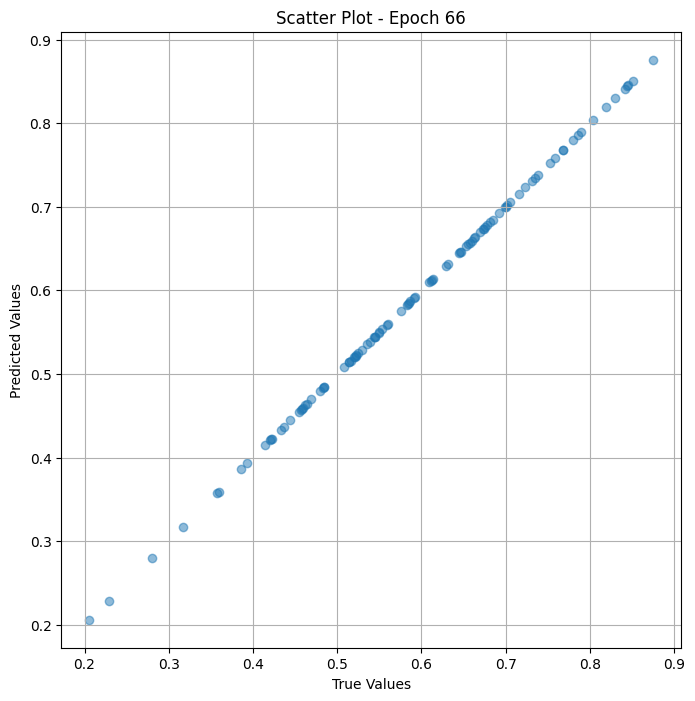


 Epoch: (67/100) Loss = 1.4221335220554465e-10

 Epoch: (67/100) Loss_rmse = 1.1925323633477092e-05

 Epoch: (67/100) R^2 = 1.0

 Epoch: (67/100) MAE = 8.046627044677734e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

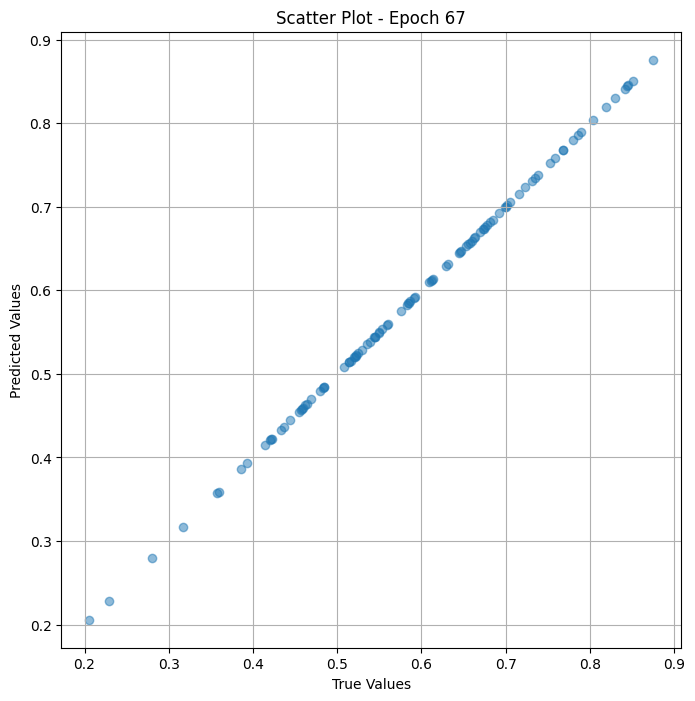


 Epoch: (68/100) Loss = 1.6554668746948664e-10

 Epoch: (68/100) Loss_rmse = 1.286649512621807e-05

 Epoch: (68/100) R^2 = 1.0

 Epoch: (68/100) MAE = 9.939074516296387e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

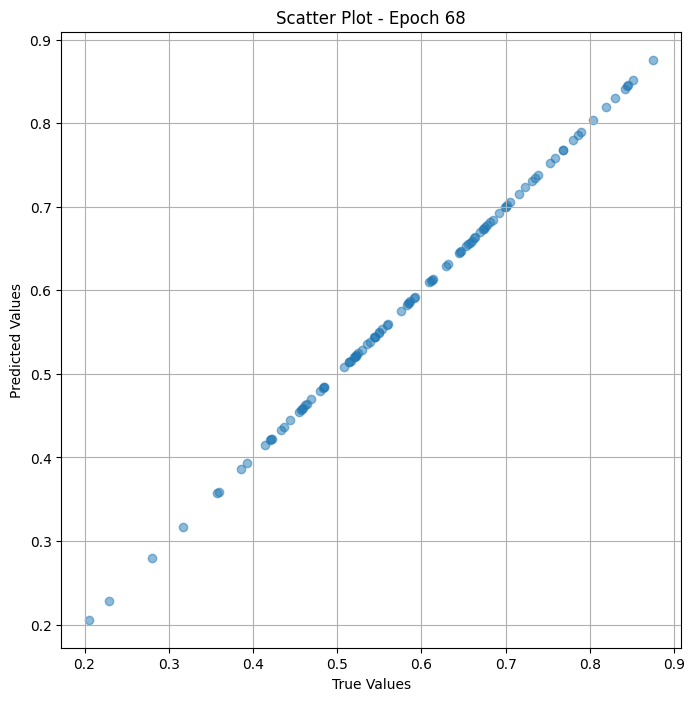


 Epoch: (69/100) Loss = 1.0393375049488895e-10

 Epoch: (69/100) Loss_rmse = 1.0194790775130969e-05

 Epoch: (69/100) R^2 = 1.0

 Epoch: (69/100) MAE = 7.4356794357299805e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288135

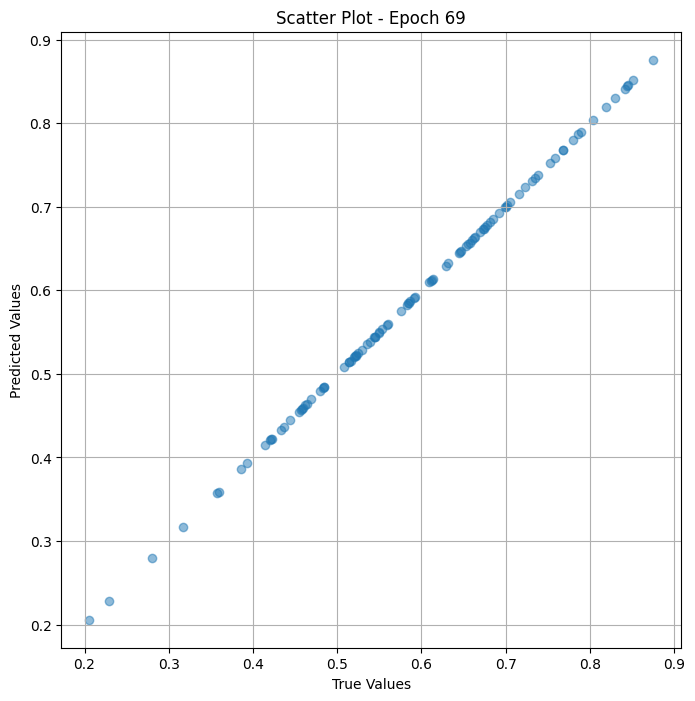


 Epoch: (70/100) Loss = 1.1124789978111949e-10

 Epoch: (70/100) Loss_rmse = 1.0547411875450052e-05

 Epoch: (70/100) R^2 = 1.0

 Epoch: (70/100) MAE = 7.092952728271484e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

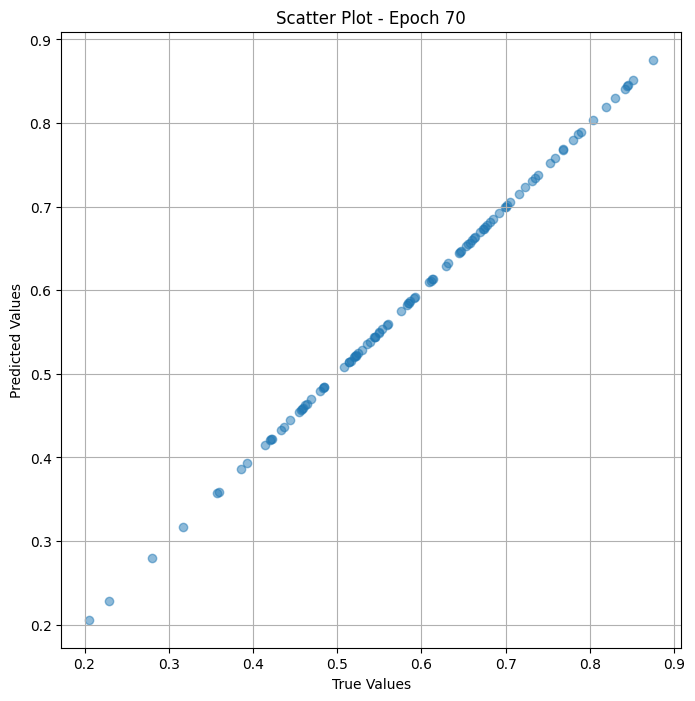


 Epoch: (71/100) Loss = 1.1097789354153065e-10

 Epoch: (71/100) Loss_rmse = 1.0534604371059686e-05

 Epoch: (71/100) R^2 = 1.0

 Epoch: (71/100) MAE = 6.616115570068359e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

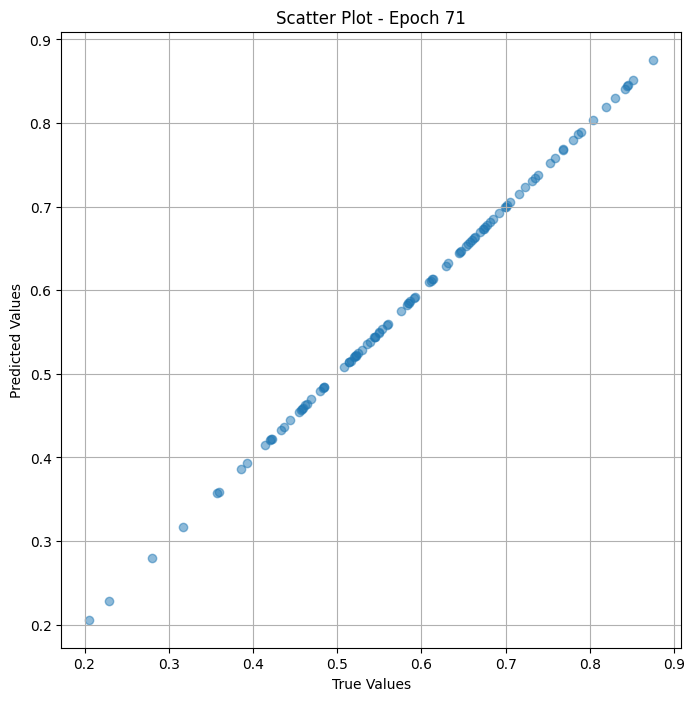


 Epoch: (72/100) Loss = 8.146638919015459e-11

 Epoch: (72/100) Loss_rmse = 9.025873623613734e-06

 Epoch: (72/100) R^2 = 1.0

 Epoch: (72/100) MAE = 6.8694353103637695e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

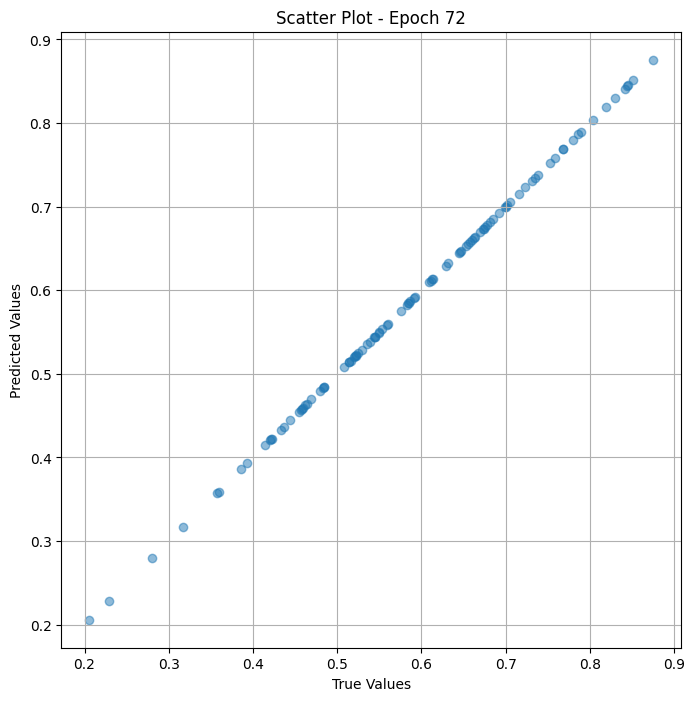


 Epoch: (73/100) Loss = 1.028359619681396e-10

 Epoch: (73/100) Loss_rmse = 1.0140806807612535e-05

 Epoch: (73/100) R^2 = 1.0

 Epoch: (73/100) MAE = 7.137656211853027e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

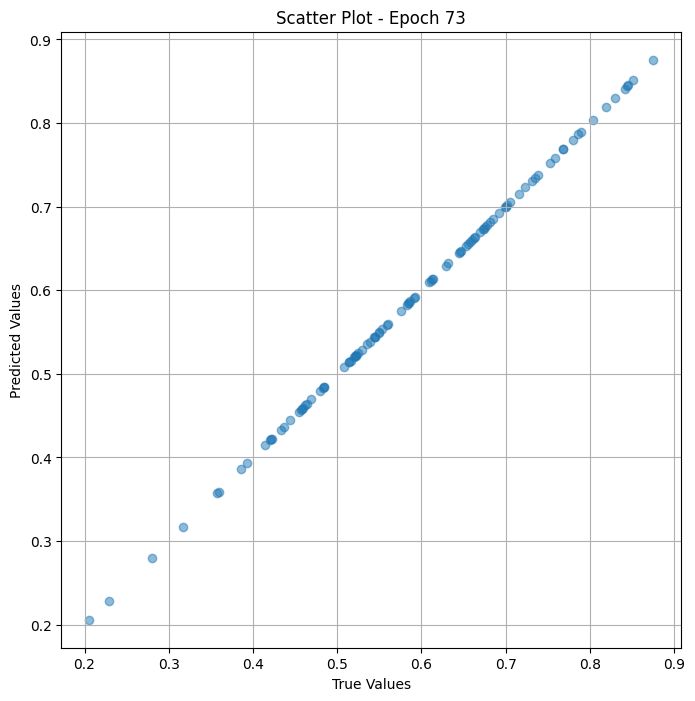


 Epoch: (74/100) Loss = 9.132516964882598e-11

 Epoch: (74/100) Loss_rmse = 9.556420081935357e-06

 Epoch: (74/100) R^2 = 1.0

 Epoch: (74/100) MAE = 6.601214408874512e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

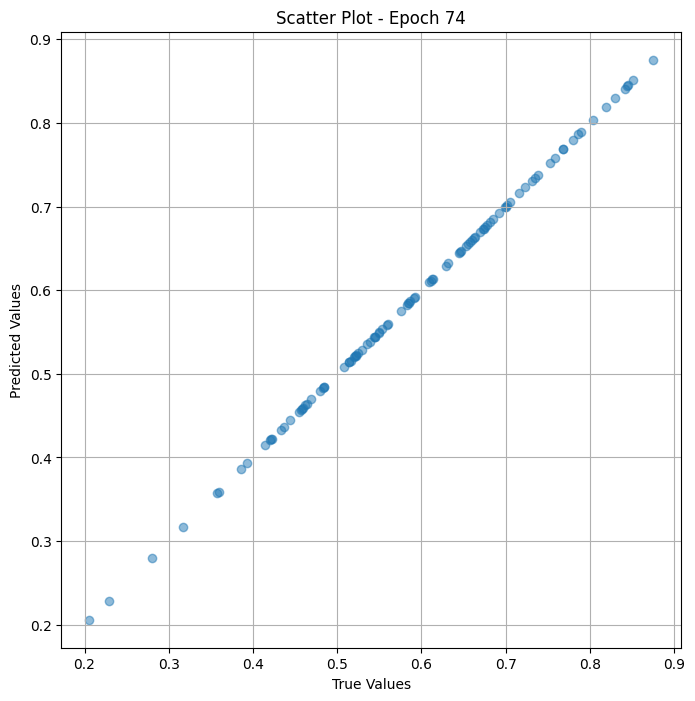


 Epoch: (75/100) Loss = 1.0188294652380137e-10

 Epoch: (75/100) Loss_rmse = 1.0093708624481224e-05

 Epoch: (75/100) R^2 = 1.0

 Epoch: (75/100) MAE = 7.420778274536133e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

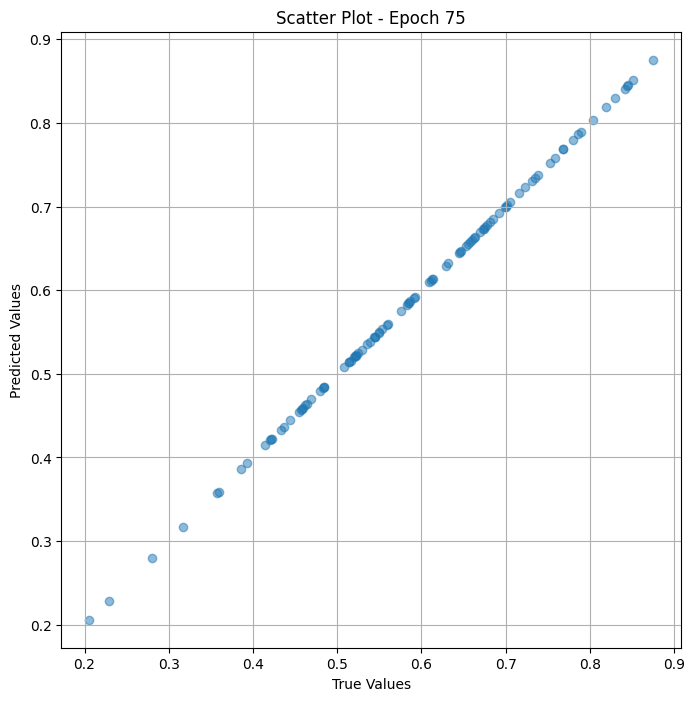


 Epoch: (76/100) Loss = 7.918021793784646e-11

 Epoch: (76/100) Loss_rmse = 8.8983269961318e-06

 Epoch: (76/100) R^2 = 1.0

 Epoch: (76/100) MAE = 6.809830665588379e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 0.

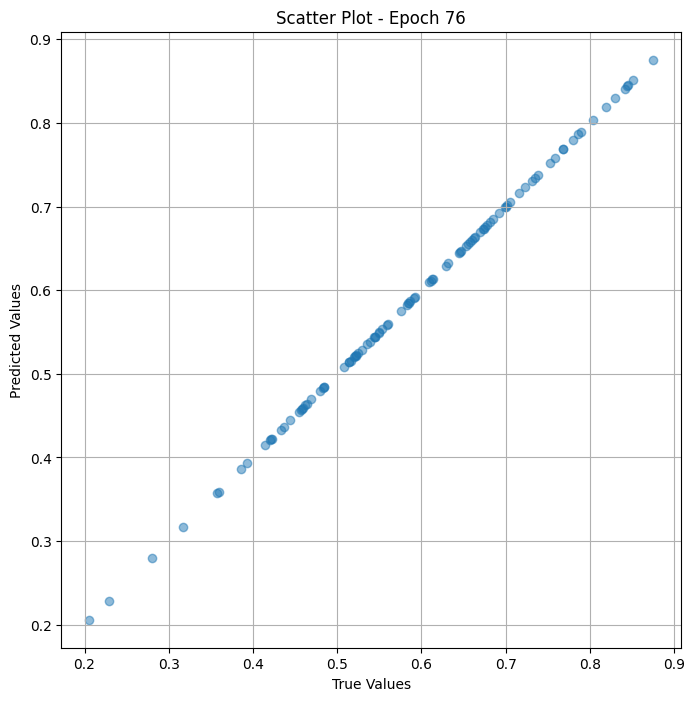


 Epoch: (77/100) Loss = 8.519496219605571e-11

 Epoch: (77/100) Loss_rmse = 9.230111572833266e-06

 Epoch: (77/100) R^2 = 1.0

 Epoch: (77/100) MAE = 6.660819053649902e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

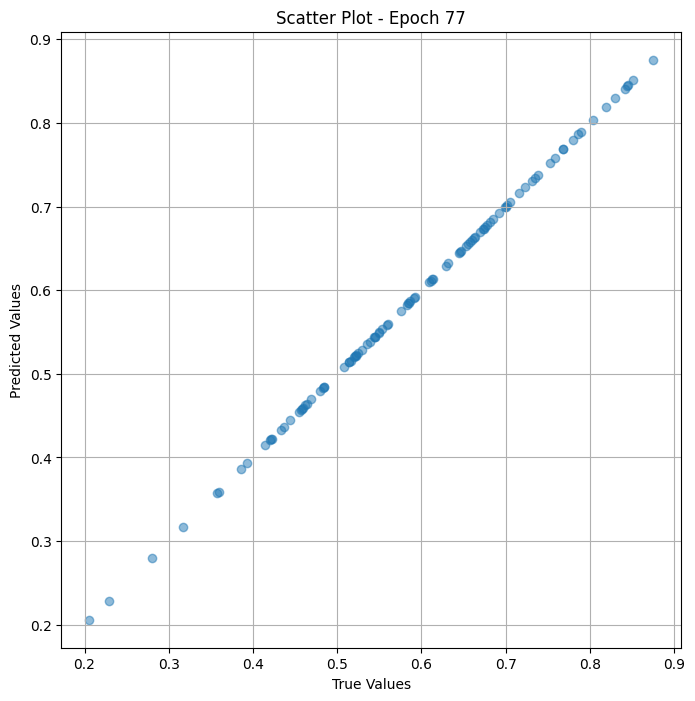


 Epoch: (78/100) Loss = 7.625988729387245e-11

 Epoch: (78/100) Loss_rmse = 8.732690730539616e-06

 Epoch: (78/100) R^2 = 1.0

 Epoch: (78/100) MAE = 6.541609764099121e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

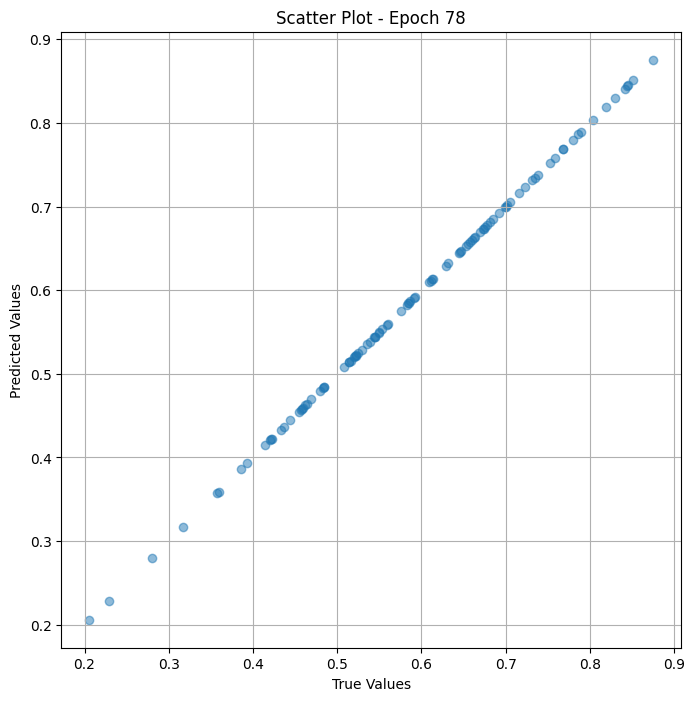


 Epoch: (79/100) Loss = 6.436184918356957e-11

 Epoch: (79/100) Loss_rmse = 8.022583642741665e-06

 Epoch: (79/100) R^2 = 1.0

 Epoch: (79/100) MAE = 5.200505256652832e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

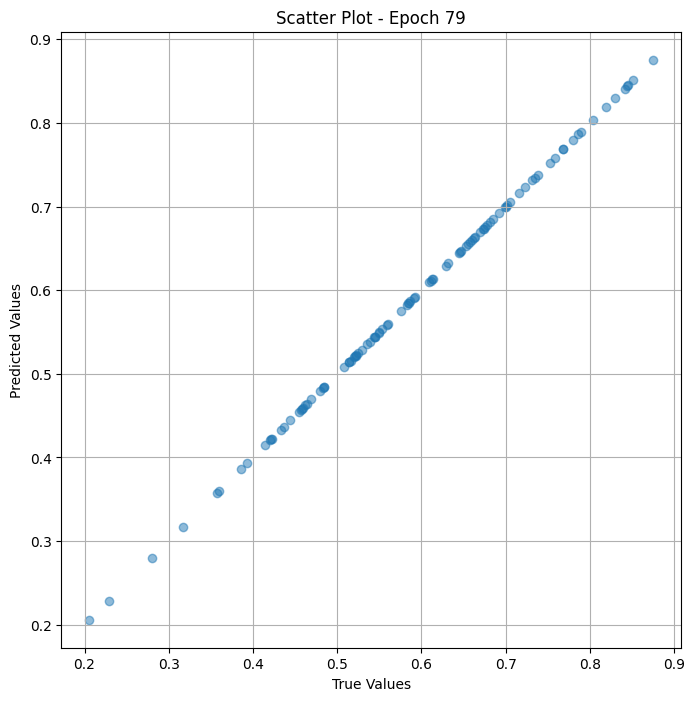


 Epoch: (80/100) Loss = 4.729550084903167e-11

 Epoch: (80/100) Loss_rmse = 6.877172381791752e-06

 Epoch: (80/100) R^2 = 1.0

 Epoch: (80/100) MAE = 4.202127456665039e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

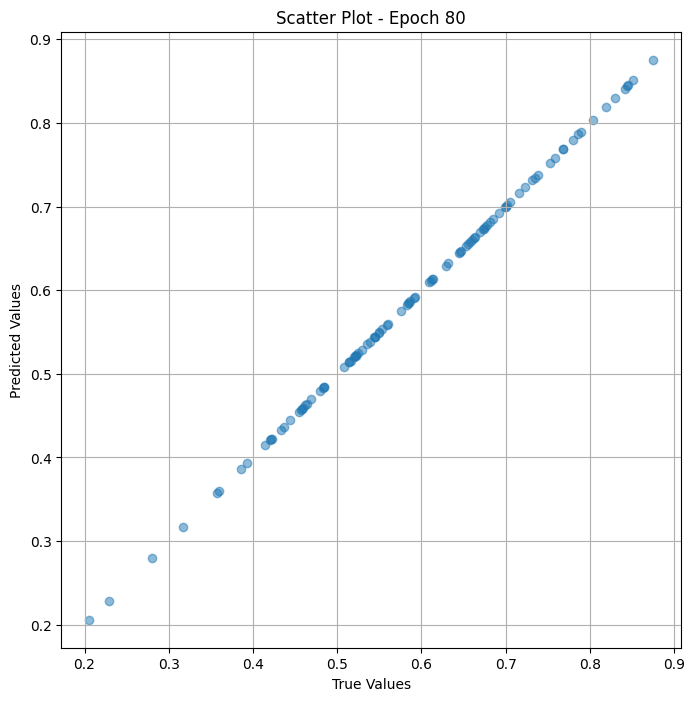


 Epoch: (81/100) Loss = 4.6427750532984646e-11

 Epoch: (81/100) Loss_rmse = 6.813791060267249e-06

 Epoch: (81/100) R^2 = 1.0

 Epoch: (81/100) MAE = 5.260109901428223e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

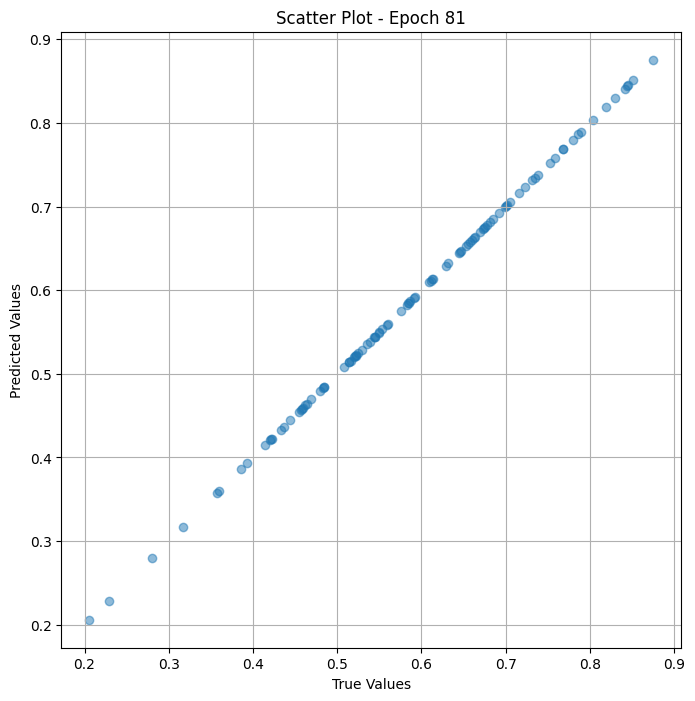


 Epoch: (82/100) Loss = 5.553779658384883e-11

 Epoch: (82/100) Loss_rmse = 7.452368663507514e-06

 Epoch: (82/100) R^2 = 1.0

 Epoch: (82/100) MAE = 5.453824996948242e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

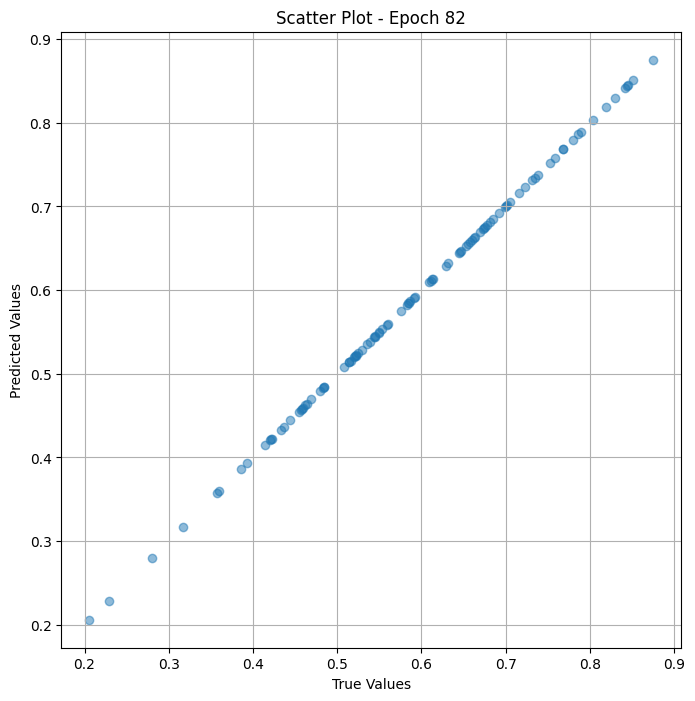


 Epoch: (83/100) Loss = 4.872280356948977e-11

 Epoch: (83/100) Loss_rmse = 6.980172202020185e-06

 Epoch: (83/100) R^2 = 1.0

 Epoch: (83/100) MAE = 5.498528480529785e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

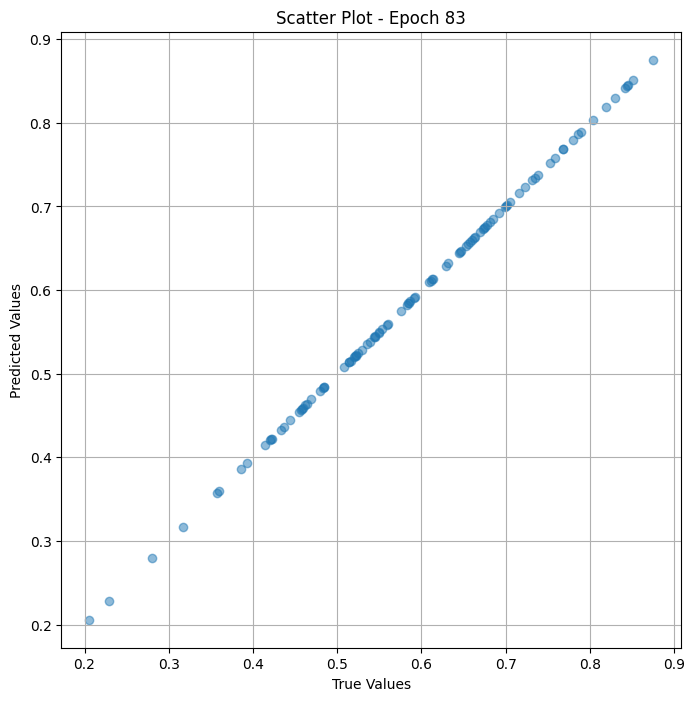


 Epoch: (84/100) Loss = 4.411671028492492e-11

 Epoch: (84/100) Loss_rmse = 6.642041171289748e-06

 Epoch: (84/100) R^2 = 1.0

 Epoch: (84/100) MAE = 5.289912223815918e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

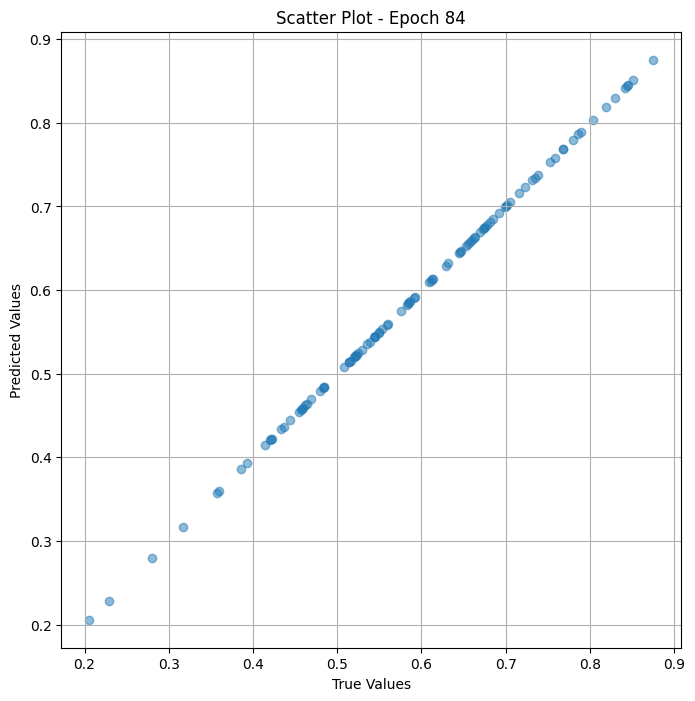


 Epoch: (85/100) Loss = 4.1806558215284895e-11

 Epoch: (85/100) Loss_rmse = 6.4657992879801895e-06

 Epoch: (85/100) R^2 = 1.0

 Epoch: (85/100) MAE = 4.76837158203125e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

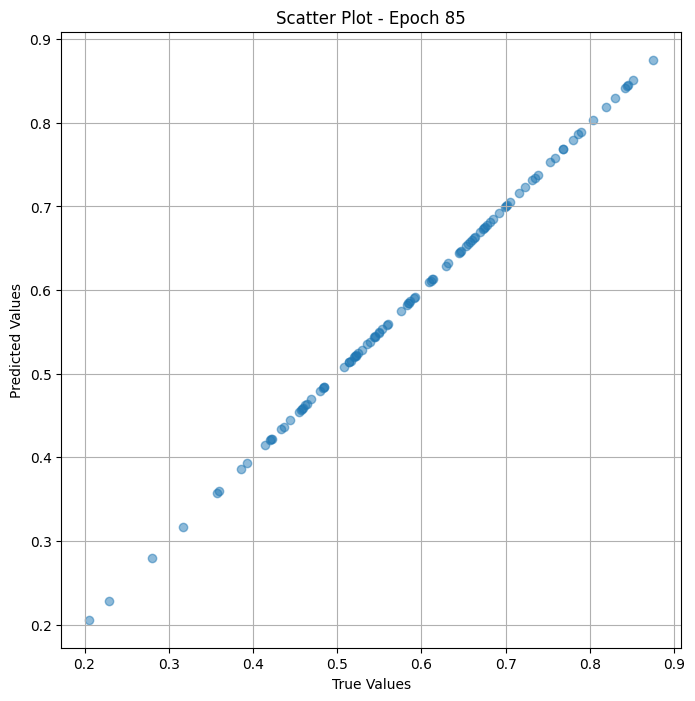


 Epoch: (86/100) Loss = 4.660094532482617e-11

 Epoch: (86/100) Loss_rmse = 6.826488515798701e-06

 Epoch: (86/100) R^2 = 1.0

 Epoch: (86/100) MAE = 5.0067901611328125e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

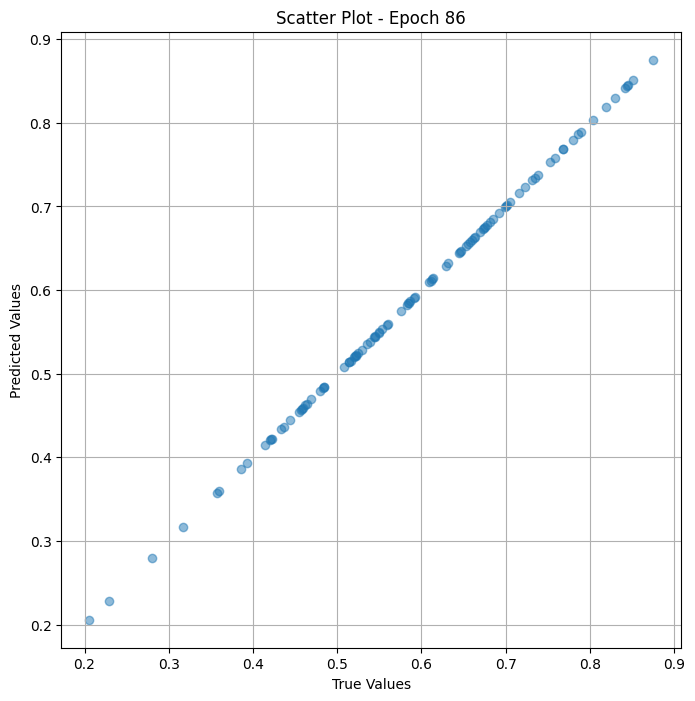


 Epoch: (87/100) Loss = 2.8686386599474645e-11

 Epoch: (87/100) Loss_rmse = 5.355967459763633e-06

 Epoch: (87/100) R^2 = 1.0

 Epoch: (87/100) MAE = 3.904104232788086e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

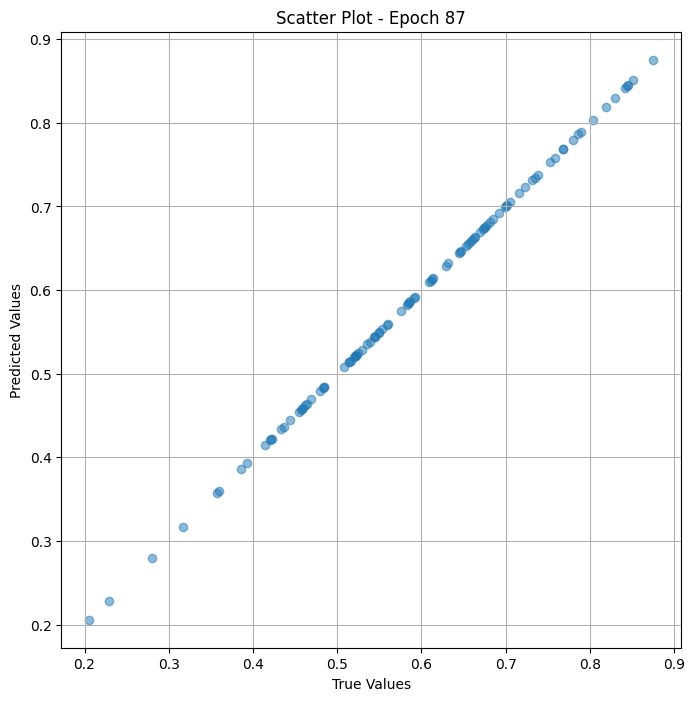


 Epoch: (88/100) Loss = 4.075939585845845e-11

 Epoch: (88/100) Loss_rmse = 6.384308562701335e-06

 Epoch: (88/100) R^2 = 1.0

 Epoch: (88/100) MAE = 4.813075065612793e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

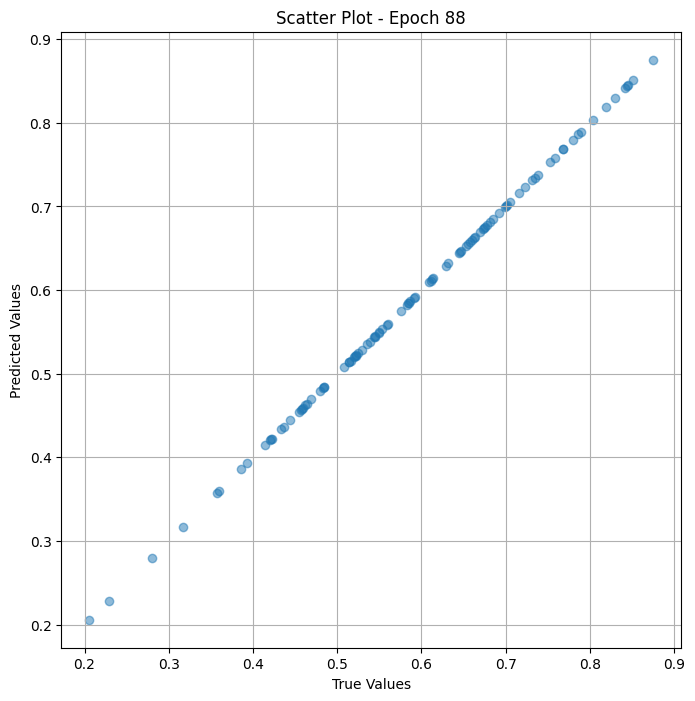


 Epoch: (89/100) Loss = 2.6914470652172895e-11

 Epoch: (89/100) Loss_rmse = 5.187916030990891e-06

 Epoch: (89/100) R^2 = 1.0

 Epoch: (89/100) MAE = 4.276633262634277e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

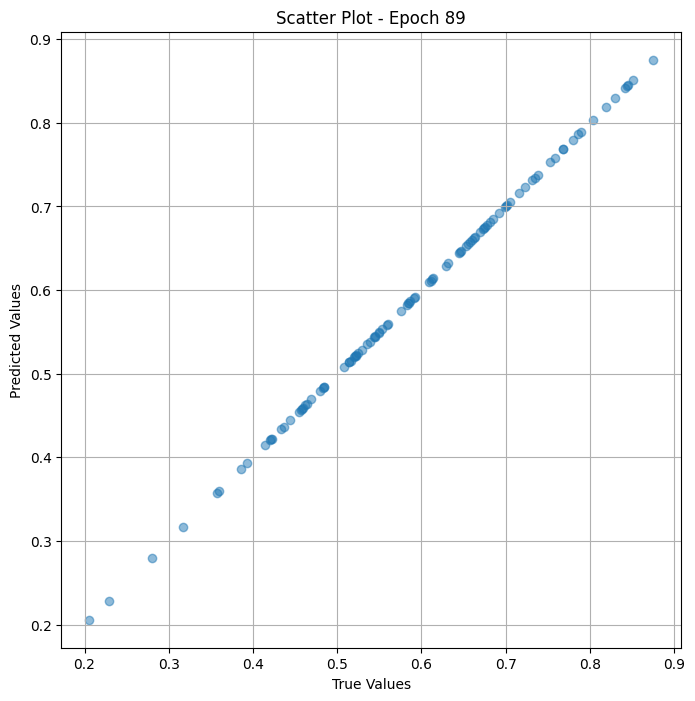


 Epoch: (90/100) Loss = 2.6298963007320708e-11

 Epoch: (90/100) Loss_rmse = 5.1282513595651835e-06

 Epoch: (90/100) R^2 = 1.0

 Epoch: (90/100) MAE = 3.4570693969726562e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288135

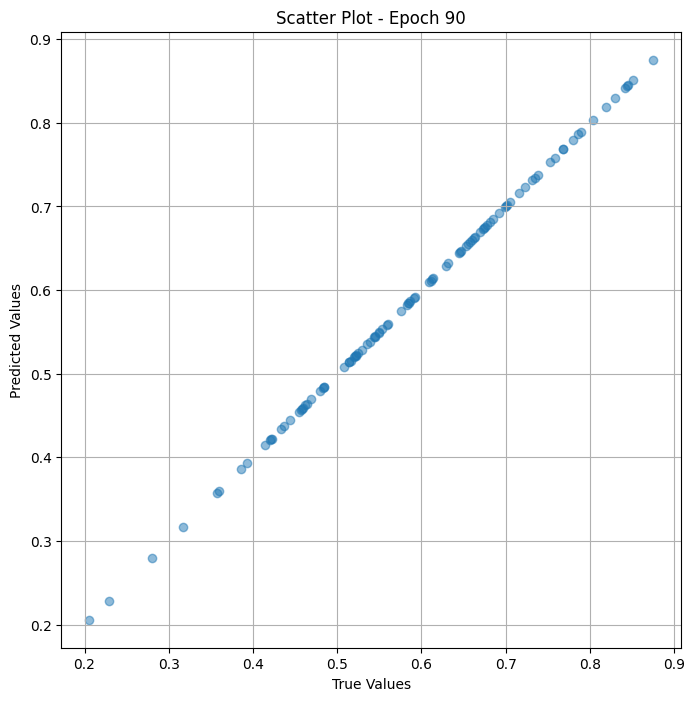


 Epoch: (91/100) Loss = 2.6007640485659067e-11

 Epoch: (91/100) Loss_rmse = 5.099768713989761e-06

 Epoch: (91/100) R^2 = 1.0

 Epoch: (91/100) MAE = 3.904104232788086e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

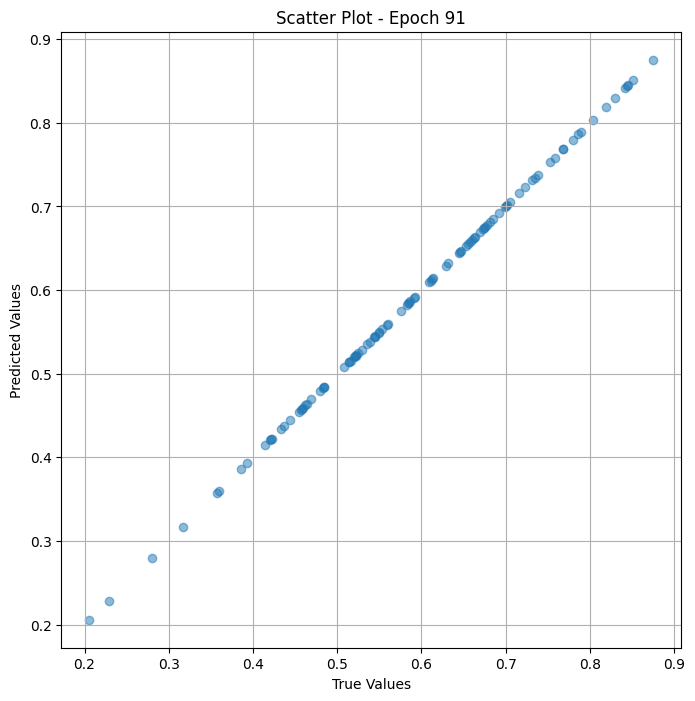


 Epoch: (92/100) Loss = 3.569589068774803e-11

 Epoch: (92/100) Loss_rmse = 5.974603936920175e-06

 Epoch: (92/100) R^2 = 1.0

 Epoch: (92/100) MAE = 4.023313522338867e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

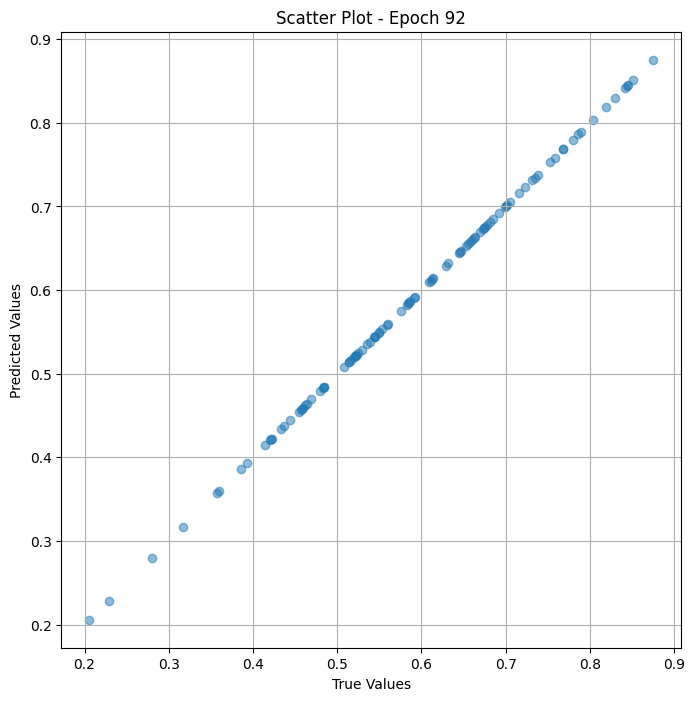


 Epoch: (93/100) Loss = 2.8551383479680226e-11

 Epoch: (93/100) Loss_rmse = 5.343349585018586e-06

 Epoch: (93/100) R^2 = 1.0

 Epoch: (93/100) MAE = 3.546476364135742e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

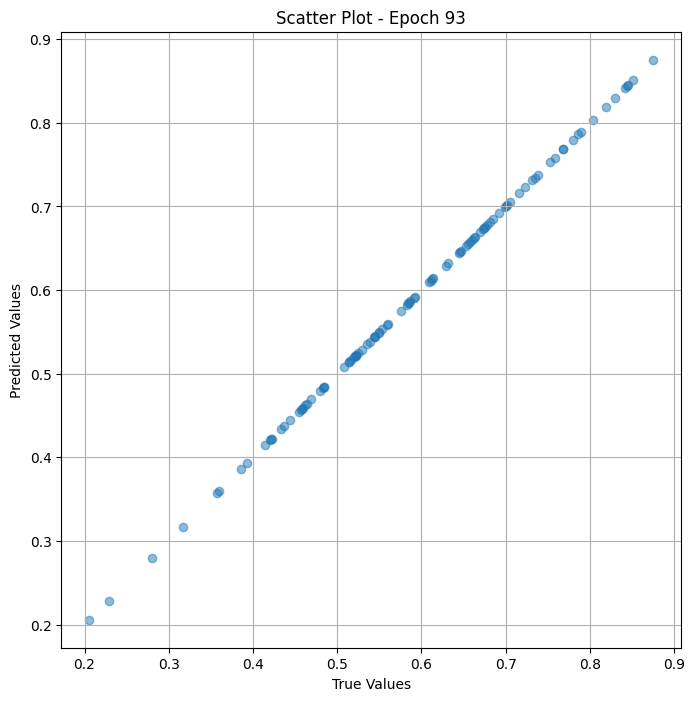


 Epoch: (94/100) Loss = 3.1191049743029e-11

 Epoch: (94/100) Loss_rmse = 5.584895006904844e-06

 Epoch: (94/100) R^2 = 1.0

 Epoch: (94/100) MAE = 4.291534423828125e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 0.

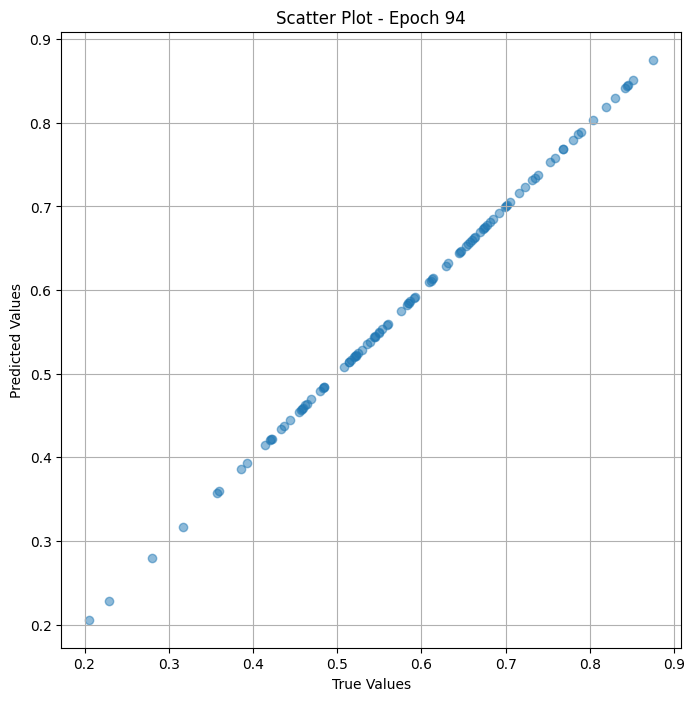


 Epoch: (95/100) Loss = 1.9842794074520498e-11

 Epoch: (95/100) Loss_rmse = 4.4545249693328515e-06

 Epoch: (95/100) R^2 = 1.0

 Epoch: (95/100) MAE = 3.0547380447387695e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288135

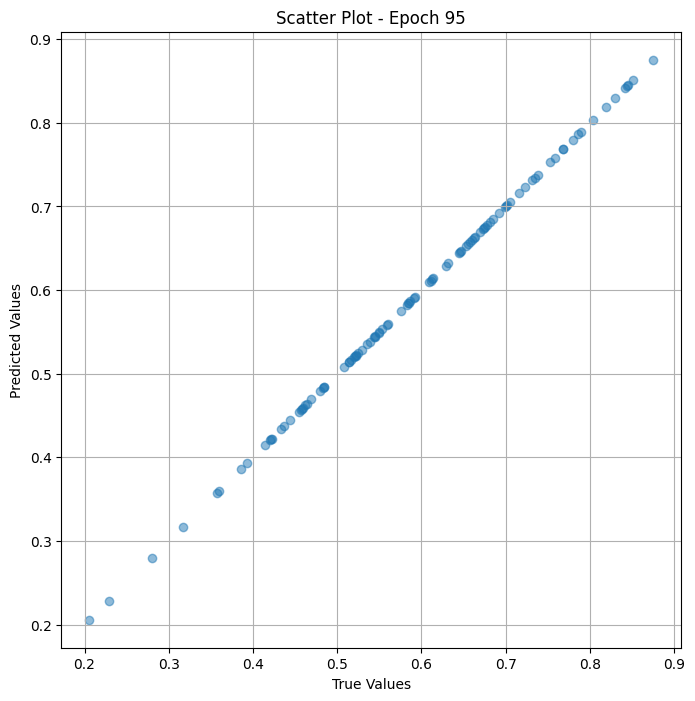


 Epoch: (96/100) Loss = 2.7503332944434078e-11

 Epoch: (96/100) Loss_rmse = 5.244362000667024e-06

 Epoch: (96/100) R^2 = 1.0

 Epoch: (96/100) MAE = 4.172325134277344e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

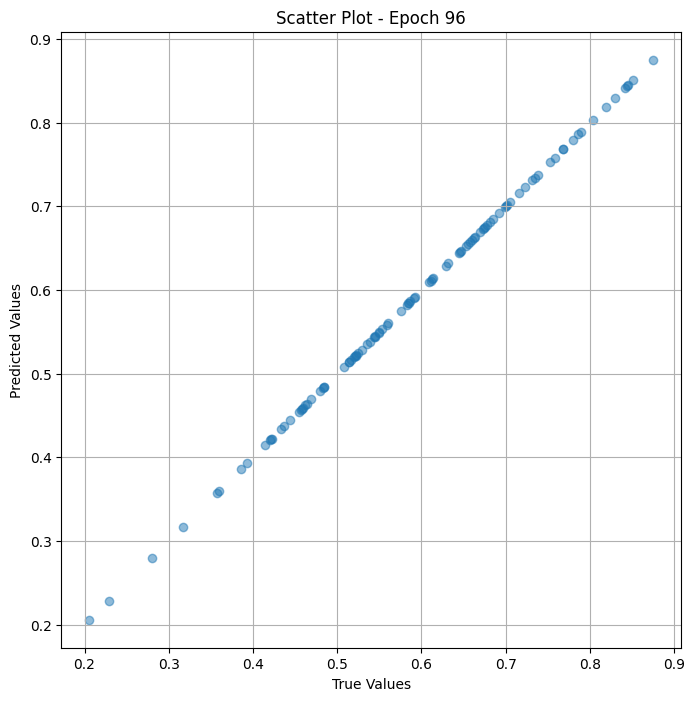


 Epoch: (97/100) Loss = 1.3081979943763145e-11

 Epoch: (97/100) Loss_rmse = 3.6169019494991517e-06

 Epoch: (97/100) R^2 = 1.0

 Epoch: (97/100) MAE = 2.726912498474121e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

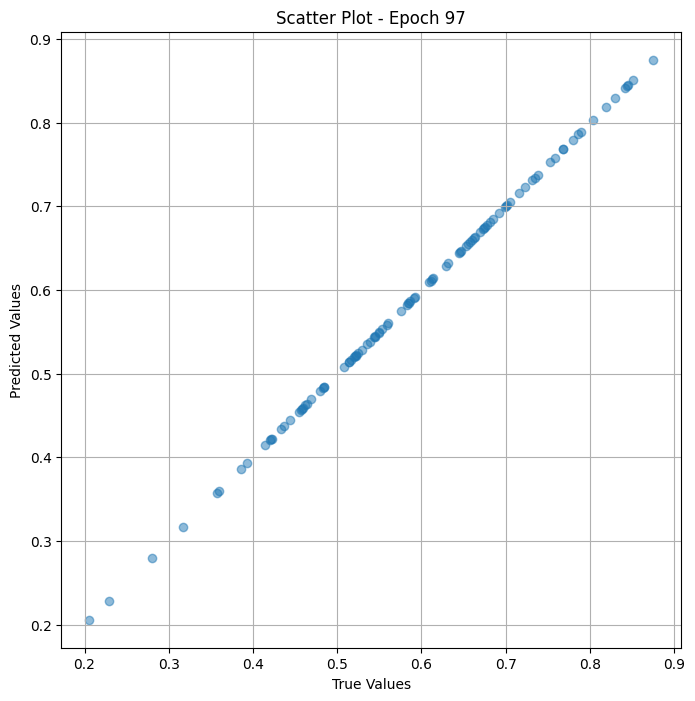


 Epoch: (98/100) Loss = 1.4944490089874307e-11

 Epoch: (98/100) Loss_rmse = 3.865810413117288e-06

 Epoch: (98/100) R^2 = 1.0

 Epoch: (98/100) MAE = 2.86102294921875e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

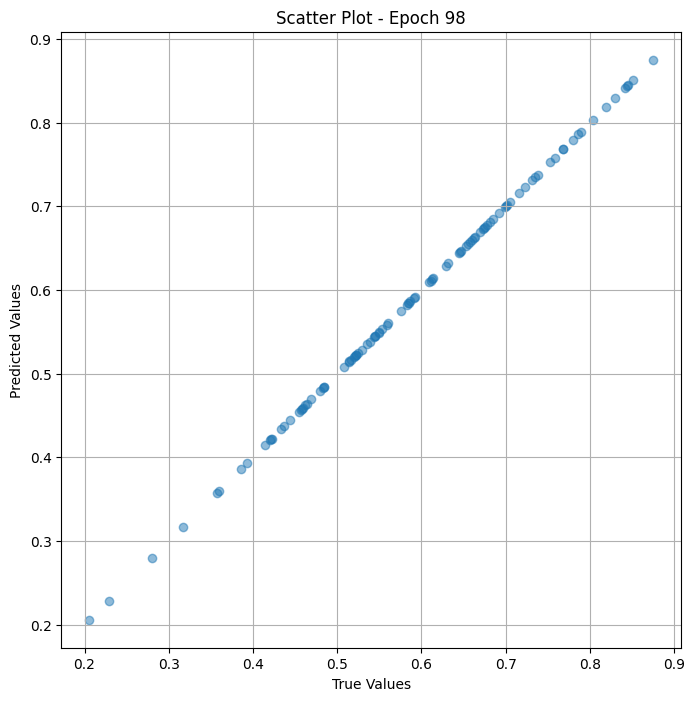


 Epoch: (99/100) Loss = 2.0743406992096425e-11

 Epoch: (99/100) Loss_rmse = 4.554492988972925e-06

 Epoch: (99/100) R^2 = 1.0

 Epoch: (99/100) MAE = 3.382563591003418e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

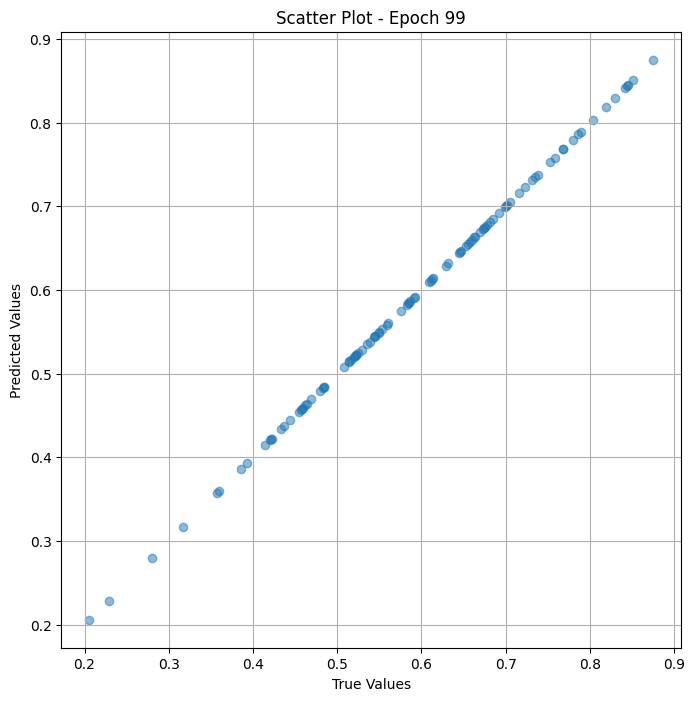


 Epoch: (100/100) Loss = 1.5590195800996298e-11

 Epoch: (100/100) Loss_rmse = 3.948442099499516e-06

 Epoch: (100/100) R^2 = 1.0

 Epoch: (100/100) MAE = 3.084540367126465e-06

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881

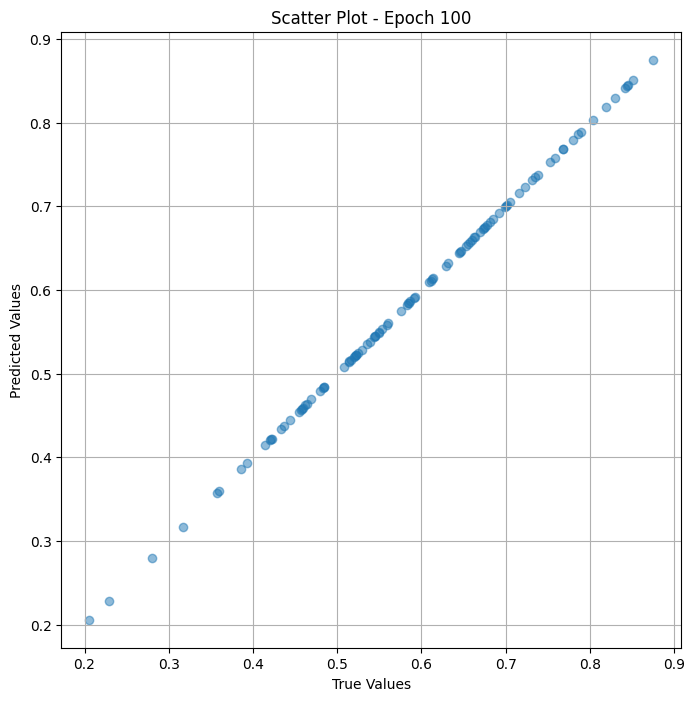

In [ ]:
# Training the model and save weights
fit(100, model_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_vr_val")

In [ ]:

import numpy as np
from scipy.stats import spearmanr

true_values = [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815]

predicted_values = [0.521735, 0.6810148, 0.71162146, 0.5113087, 0.7483966, 0.6619805, 0.59650654, 0.52898717]

spearman_corr, _ = spearmanr(true_values, predicted_values)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.9285714285714287 0.0008629681828999769


## Test

In [ ]:
class Dataset_test_landscape(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_test_landscape(df_test_landscape, trans_transform=trans_transform, res_transform=res_transform)
train_dl_test = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_test = model_merge_test(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_test = to_device(model_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_test.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_test, train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_test(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

           # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.07372500002384186

 Epoch: (1/50) Loss_rmse = 0.27152347564697266

 Epoch: (1/50) R^2 = -7.555005073547363

 Epoch: (1/50) MAE = 0.22309085726737976

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620688

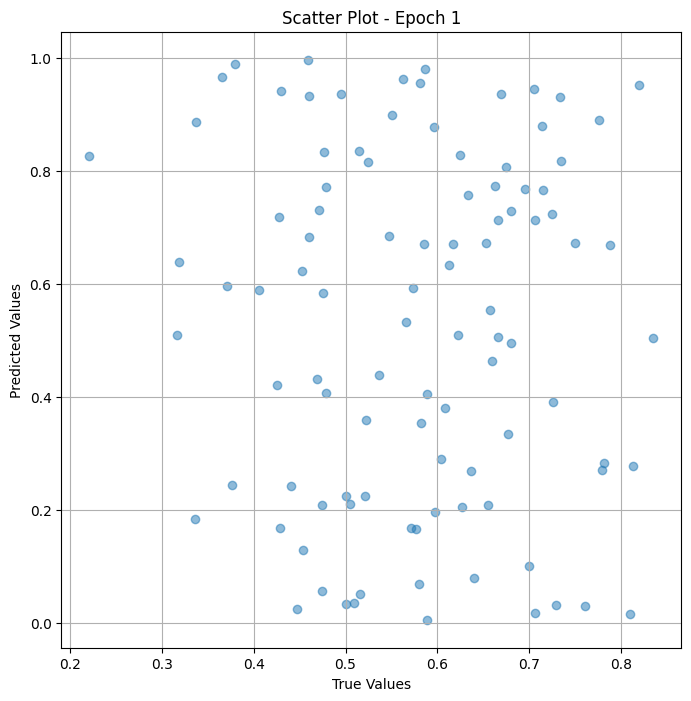


 Epoch: (2/50) Loss = 0.05187991261482239

 Epoch: (2/50) Loss_rmse = 0.22777162492275238

 Epoch: (2/50) R^2 = -5.020113945007324

 Epoch: (2/50) MAE = 0.17007538676261902

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620688

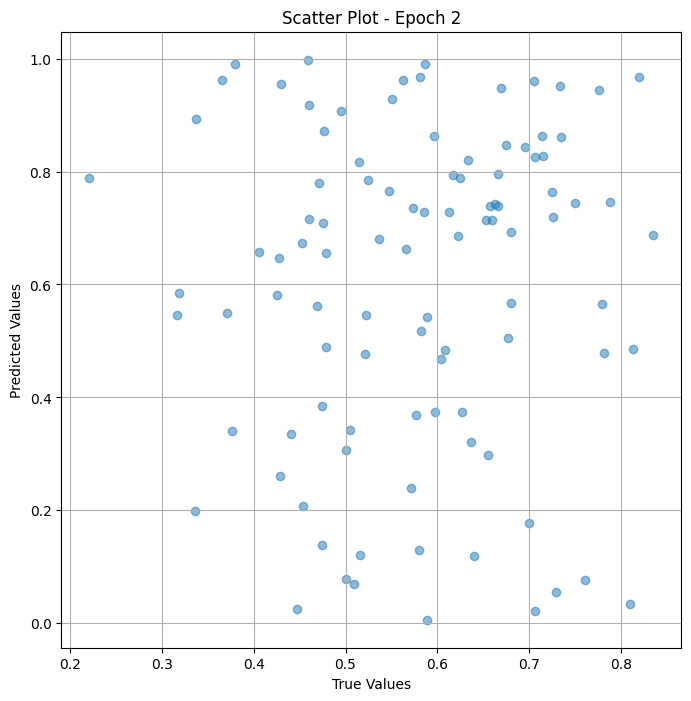


 Epoch: (3/50) Loss = 0.026284461840987206

 Epoch: (3/50) Loss_rmse = 0.16212482750415802

 Epoch: (3/50) R^2 = -2.0500333309173584

 Epoch: (3/50) MAE = 0.09099026024341583

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.336206

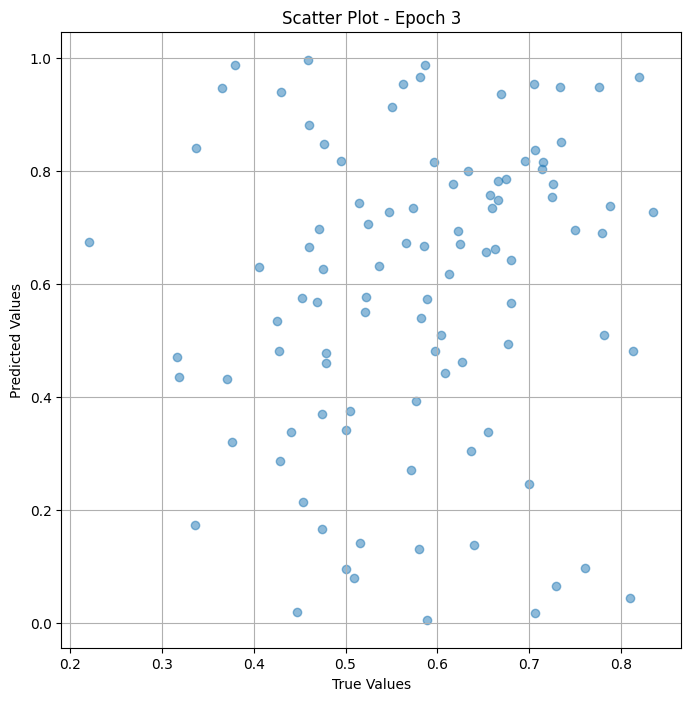


 Epoch: (4/50) Loss = 0.005932156927883625

 Epoch: (4/50) Loss_rmse = 0.07702049612998962

 Epoch: (4/50) R^2 = 0.3116360902786255

 Epoch: (4/50) MAE = 0.05543230473995209

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362068

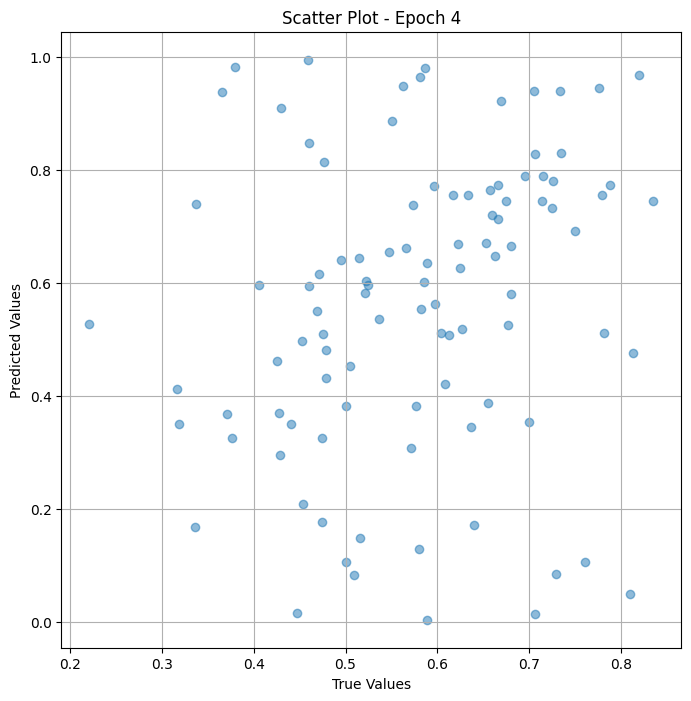


 Epoch: (5/50) Loss = 0.0007291351212188601

 Epoch: (5/50) Loss_rmse = 0.027002502232789993

 Epoch: (5/50) R^2 = 0.9153915643692017

 Epoch: (5/50) MAE = 0.024570174515247345

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362

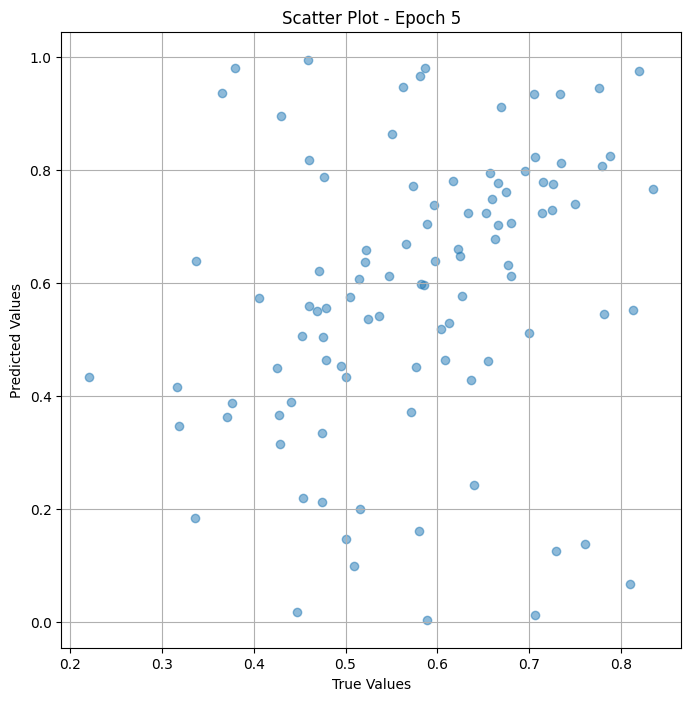


 Epoch: (6/50) Loss = 0.0021594236604869366

 Epoch: (6/50) Loss_rmse = 0.04646959900856018

 Epoch: (6/50) R^2 = 0.7494217753410339

 Epoch: (6/50) MAE = 0.03575022518634796

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.336206

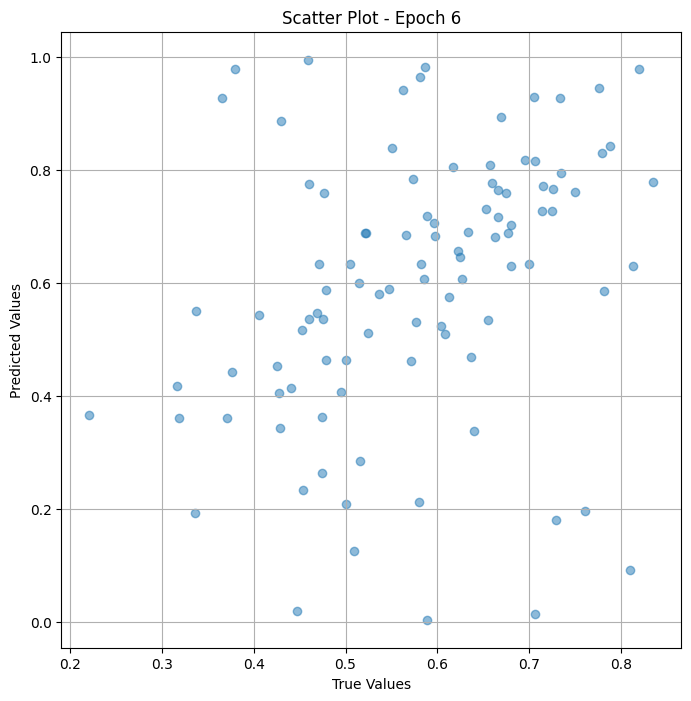


 Epoch: (7/50) Loss = 0.0005380806978791952

 Epoch: (7/50) Loss_rmse = 0.023196566849946976

 Epoch: (7/50) R^2 = 0.9375614523887634

 Epoch: (7/50) MAE = 0.018151231110095978

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362

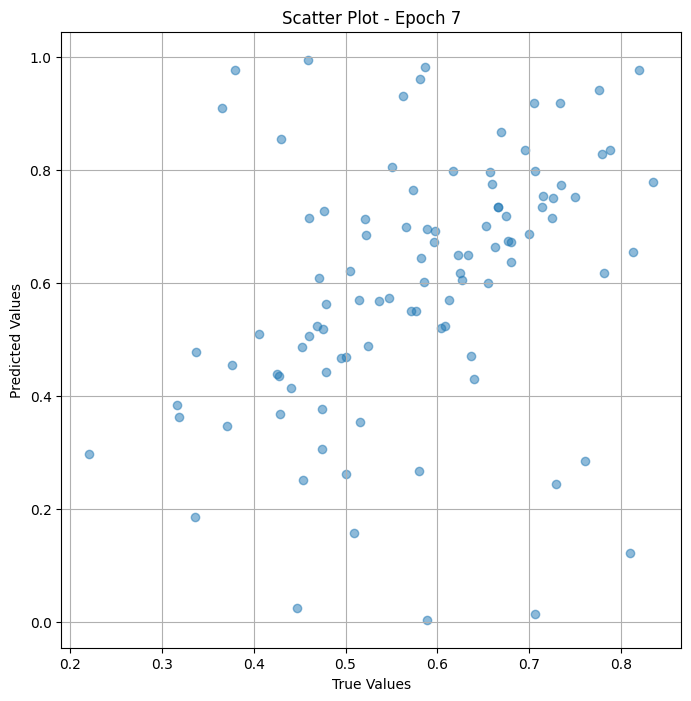


 Epoch: (8/50) Loss = 0.0007658650865778327

 Epoch: (8/50) Loss_rmse = 0.027674267068505287

 Epoch: (8/50) R^2 = 0.9111294746398926

 Epoch: (8/50) MAE = 0.025203846395015717

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362

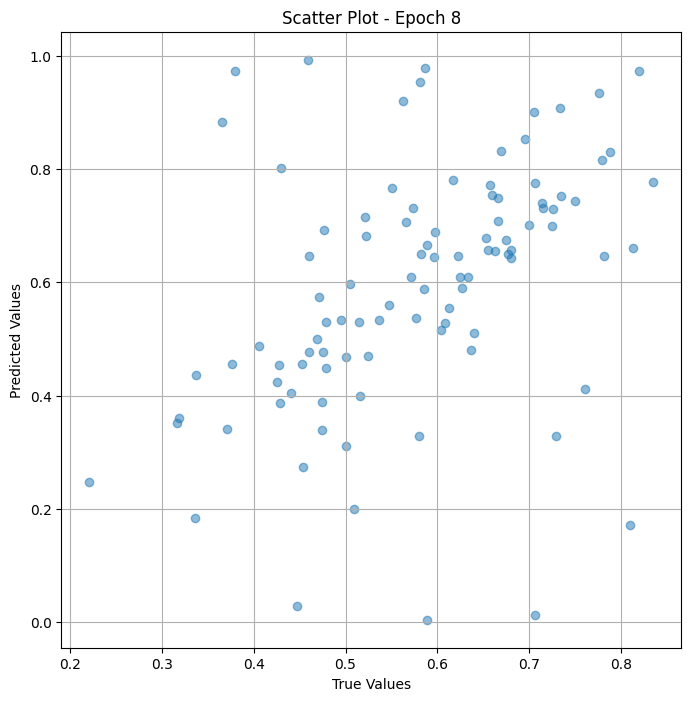


 Epoch: (9/50) Loss = 0.0005426432471722364

 Epoch: (9/50) Loss_rmse = 0.023294704034924507

 Epoch: (9/50) R^2 = 0.9370319843292236

 Epoch: (9/50) MAE = 0.021091006696224213

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362

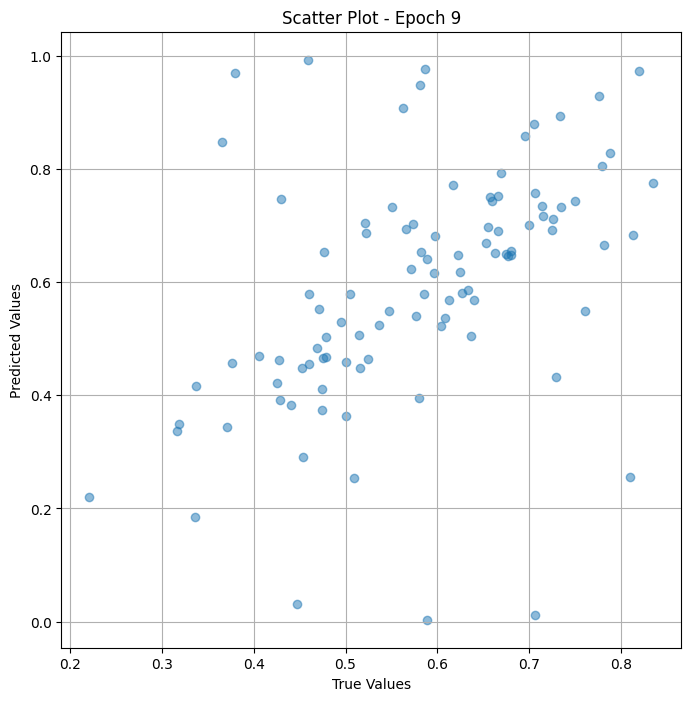


 Epoch: (10/50) Loss = 0.00021141763136256486

 Epoch: (10/50) Loss_rmse = 0.01454020757228136

 Epoch: (10/50) R^2 = 0.9754672050476074

 Epoch: (10/50) MAE = 0.01130860298871994

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3

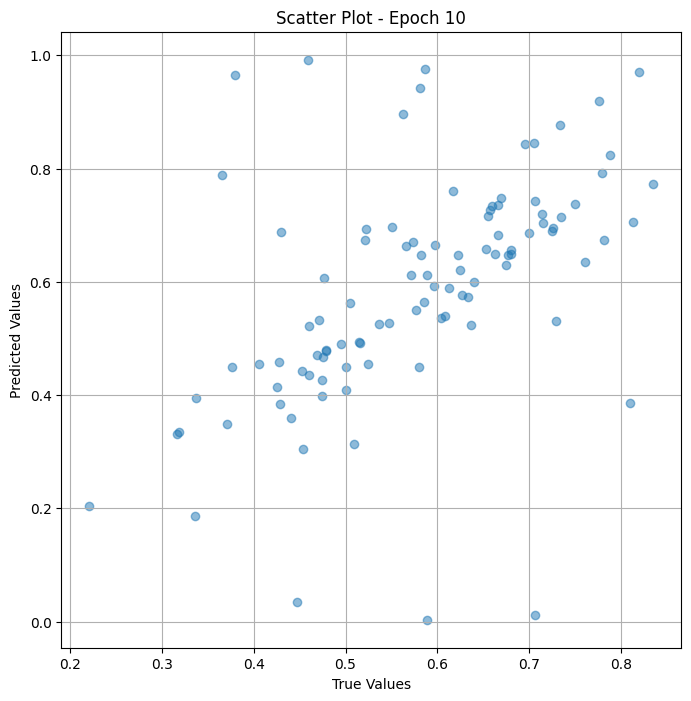


 Epoch: (11/50) Loss = 0.00025104210362769663

 Epoch: (11/50) Loss_rmse = 0.015844307839870453

 Epoch: (11/50) R^2 = 0.970869243144989

 Epoch: (11/50) MAE = 0.013973109424114227

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

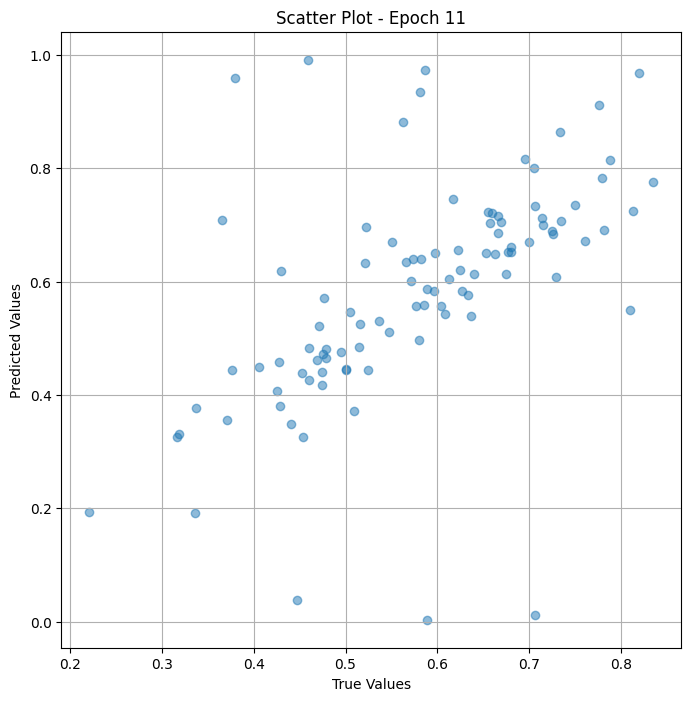


 Epoch: (12/50) Loss = 0.00015624897787347436

 Epoch: (12/50) Loss_rmse = 0.012499959208071232

 Epoch: (12/50) R^2 = 0.9818689823150635

 Epoch: (12/50) MAE = 0.011194869875907898

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

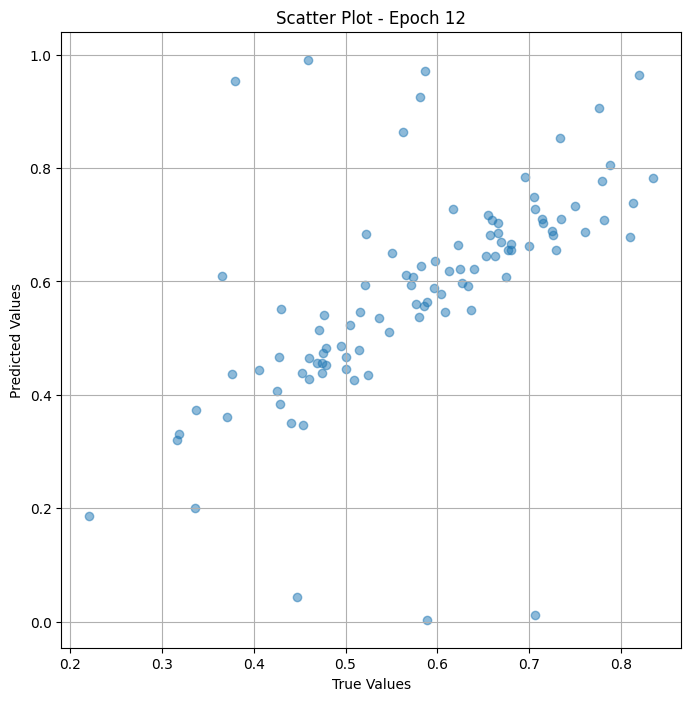


 Epoch: (13/50) Loss = 0.0001222098944708705

 Epoch: (13/50) Loss_rmse = 0.011054858565330505

 Epoch: (13/50) R^2 = 0.9858188629150391

 Epoch: (13/50) MAE = 0.009142562747001648

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

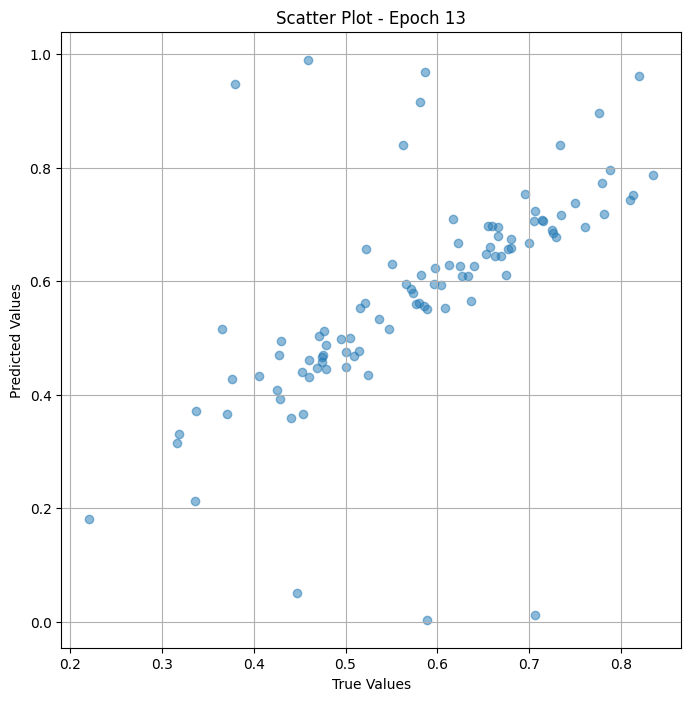


 Epoch: (14/50) Loss = 0.00010275046952301636

 Epoch: (14/50) Loss_rmse = 0.010136590339243412

 Epoch: (14/50) R^2 = 0.98807692527771

 Epoch: (14/50) MAE = 0.007567793130874634

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3

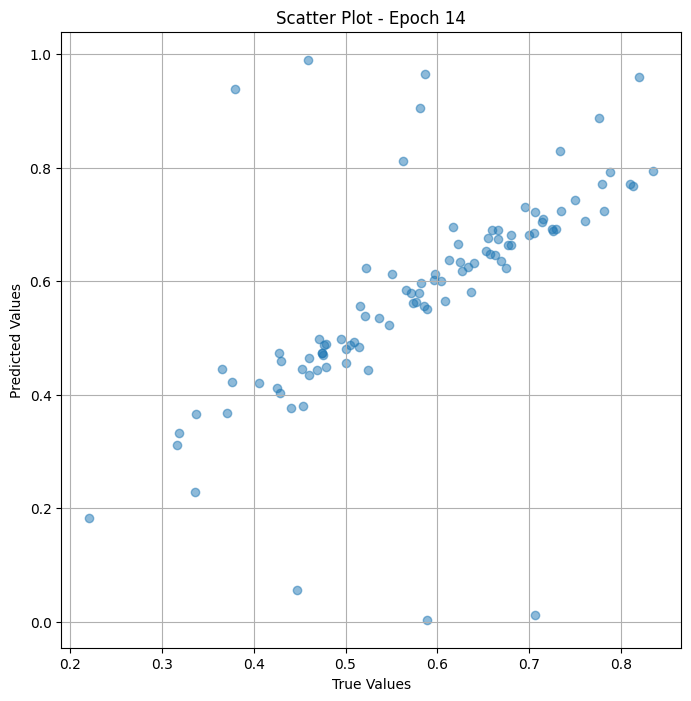


 Epoch: (15/50) Loss = 6.434127863030881e-05

 Epoch: (15/50) Loss_rmse = 0.008021301589906216

 Epoch: (15/50) R^2 = 0.9925338625907898

 Epoch: (15/50) MAE = 0.005918338894844055

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

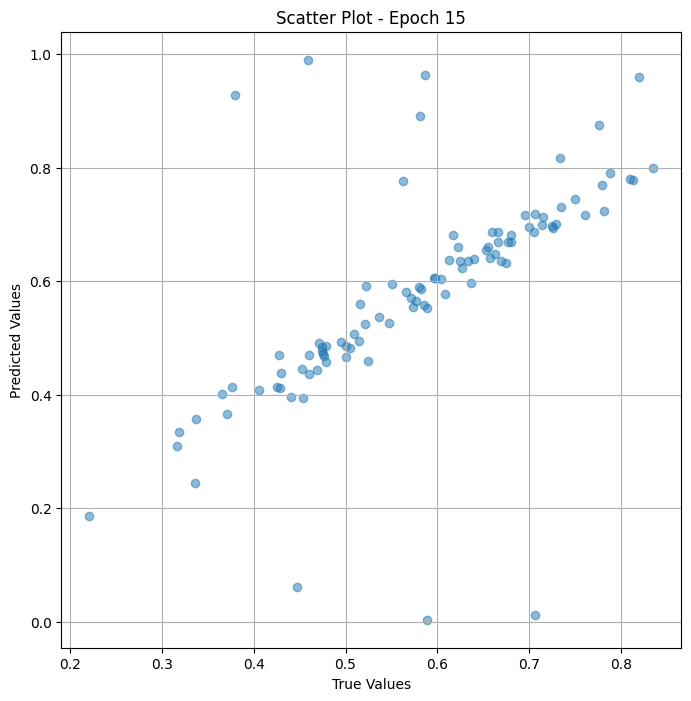


 Epoch: (16/50) Loss = 4.815146530745551e-05

 Epoch: (16/50) Loss_rmse = 0.0069391257129609585

 Epoch: (16/50) R^2 = 0.9944125413894653

 Epoch: (16/50) MAE = 0.004845842719078064

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

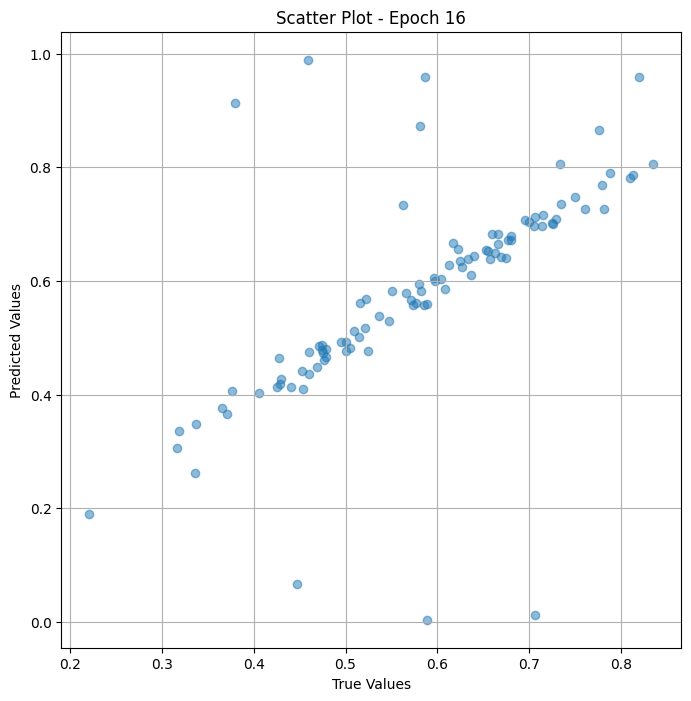


 Epoch: (17/50) Loss = 5.010789027437568e-05

 Epoch: (17/50) Loss_rmse = 0.0070786927826702595

 Epoch: (17/50) R^2 = 0.9941855072975159

 Epoch: (17/50) MAE = 0.004419513046741486

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

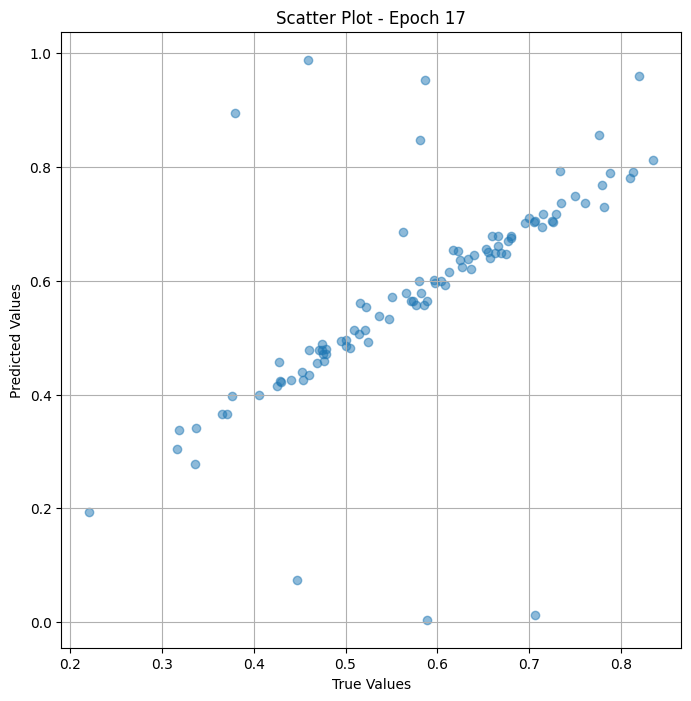


 Epoch: (18/50) Loss = 4.572439138428308e-05

 Epoch: (18/50) Loss_rmse = 0.006761981174349785

 Epoch: (18/50) R^2 = 0.994694173336029

 Epoch: (18/50) MAE = 0.004121668636798859

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3

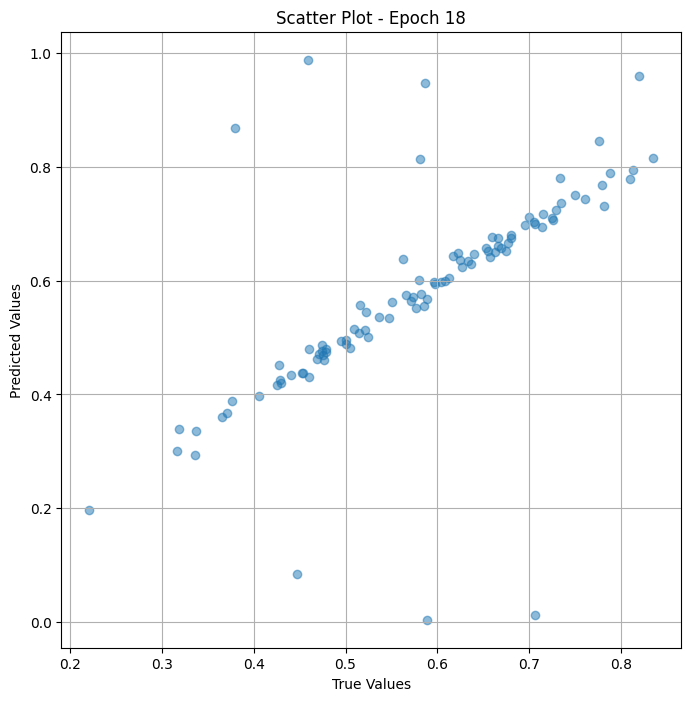


 Epoch: (19/50) Loss = 3.9383481635013595e-05

 Epoch: (19/50) Loss_rmse = 0.00627562589943409

 Epoch: (19/50) R^2 = 0.9954299926757812

 Epoch: (19/50) MAE = 0.004361018538475037

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

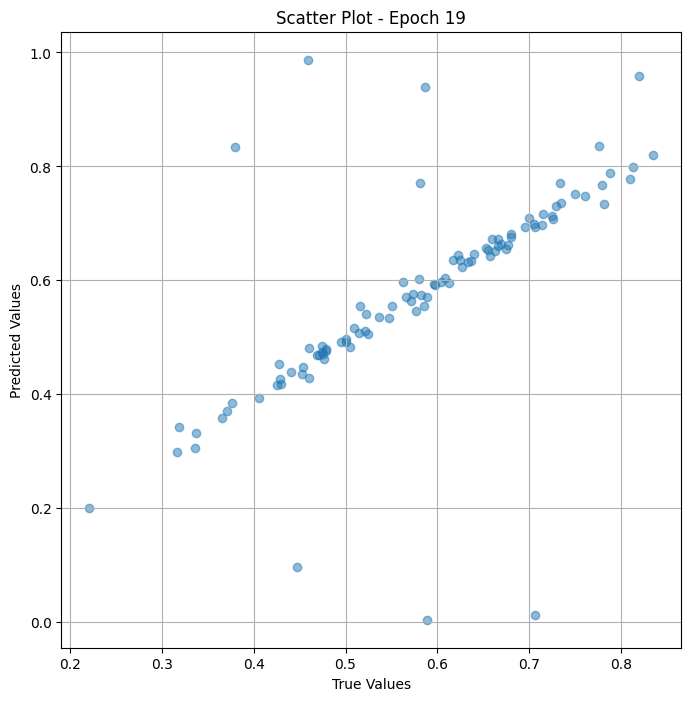


 Epoch: (20/50) Loss = 3.662268863990903e-05

 Epoch: (20/50) Loss_rmse = 0.006051668431609869

 Epoch: (20/50) R^2 = 0.9957503080368042

 Epoch: (20/50) MAE = 0.004534639418125153

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

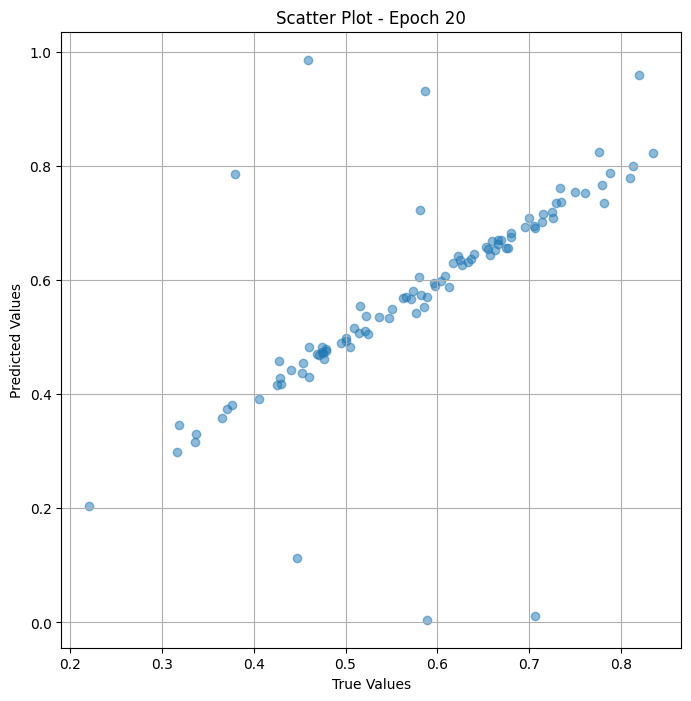


 Epoch: (21/50) Loss = 3.175934398313984e-05

 Epoch: (21/50) Loss_rmse = 0.005635542795062065

 Epoch: (21/50) R^2 = 0.9963146448135376

 Epoch: (21/50) MAE = 0.004490546882152557

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

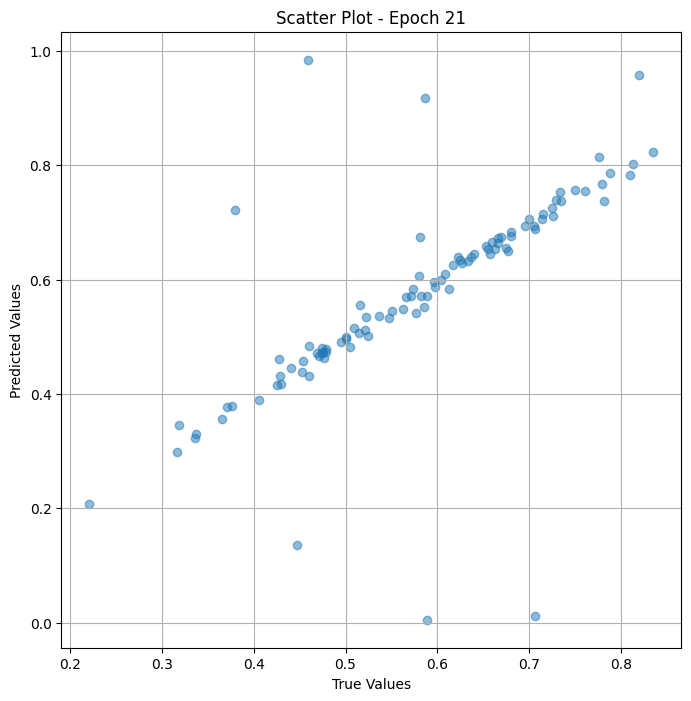


 Epoch: (22/50) Loss = 1.9642804545583203e-05

 Epoch: (22/50) Loss_rmse = 0.004432020243257284

 Epoch: (22/50) R^2 = 0.9977206587791443

 Epoch: (22/50) MAE = 0.003803141415119171

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

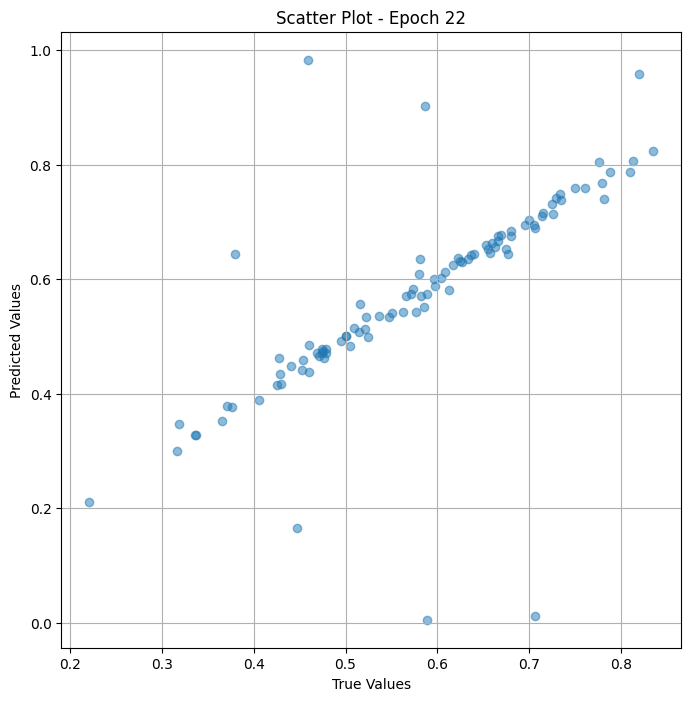


 Epoch: (23/50) Loss = 7.725258910795674e-06

 Epoch: (23/50) Loss_rmse = 0.0027794349007308483

 Epoch: (23/50) R^2 = 0.9991035461425781

 Epoch: (23/50) MAE = 0.0026366710662841797

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

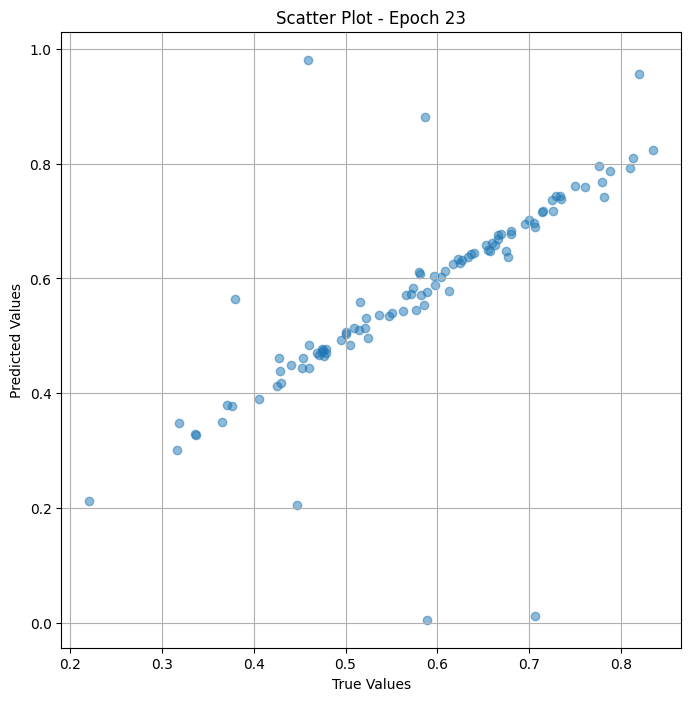


 Epoch: (24/50) Loss = 2.9125396849849494e-06

 Epoch: (24/50) Loss_rmse = 0.0017066164873540401

 Epoch: (24/50) R^2 = 0.9996620416641235

 Epoch: (24/50) MAE = 0.0015166550874710083

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

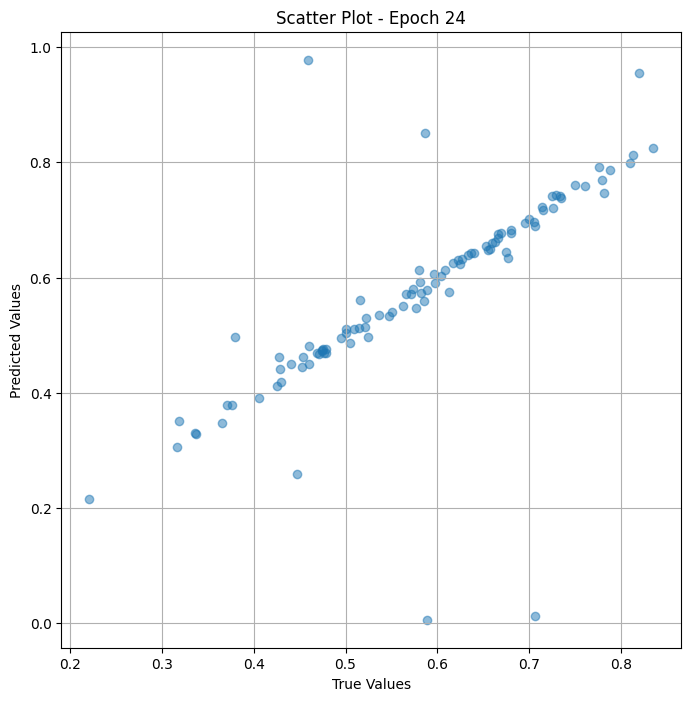


 Epoch: (25/50) Loss = 1.4465301774180261e-06

 Epoch: (25/50) Loss_rmse = 0.0012027177726849914

 Epoch: (25/50) R^2 = 0.9998321533203125

 Epoch: (25/50) MAE = 0.0010448768734931946

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

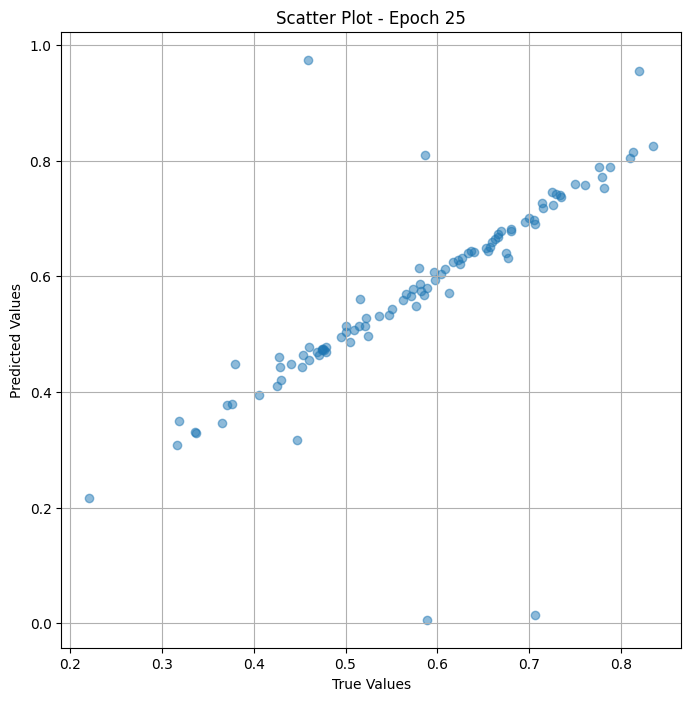


 Epoch: (26/50) Loss = 1.1946717677346896e-06

 Epoch: (26/50) Loss_rmse = 0.0010930104181170464

 Epoch: (26/50) R^2 = 0.9998613595962524

 Epoch: (26/50) MAE = 0.0008950009942054749

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

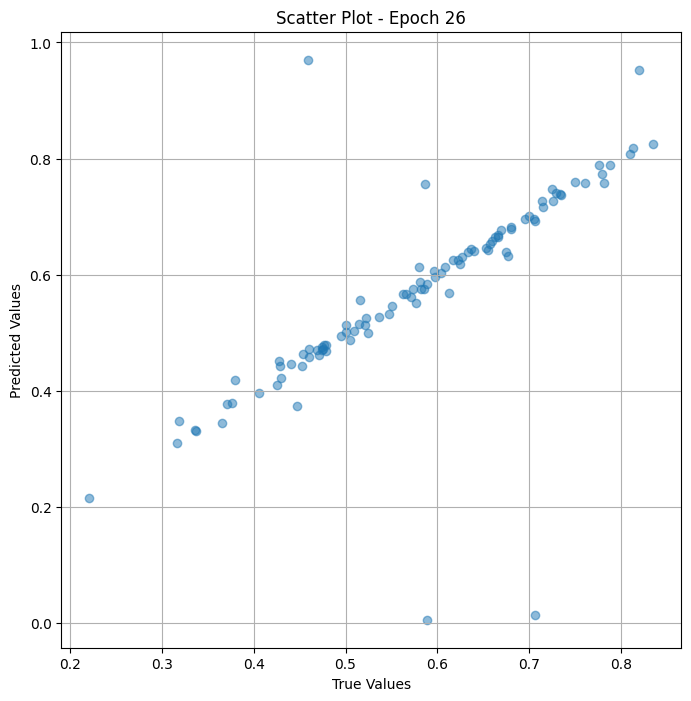


 Epoch: (27/50) Loss = 1.34742504087626e-06

 Epoch: (27/50) Loss_rmse = 0.0011607863707467914

 Epoch: (27/50) R^2 = 0.9998436570167542

 Epoch: (27/50) MAE = 0.001069866120815277

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

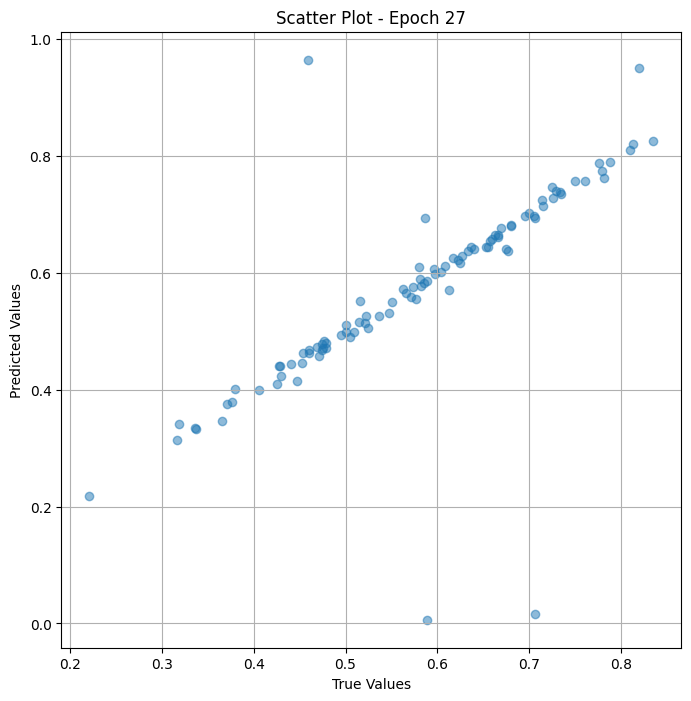


 Epoch: (28/50) Loss = 1.0576702607068e-06

 Epoch: (28/50) Loss_rmse = 0.0010284309973940253

 Epoch: (28/50) R^2 = 0.9998772740364075

 Epoch: (28/50) MAE = 0.0007855966687202454

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

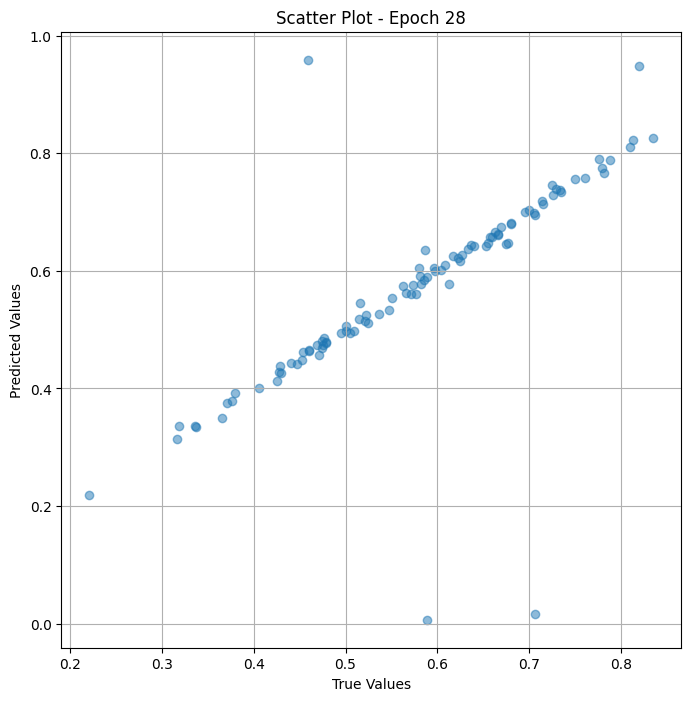


 Epoch: (29/50) Loss = 1.2342603668002994e-06

 Epoch: (29/50) Loss_rmse = 0.0011109727201983333

 Epoch: (29/50) R^2 = 0.9998567700386047

 Epoch: (29/50) MAE = 0.0007690191268920898

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

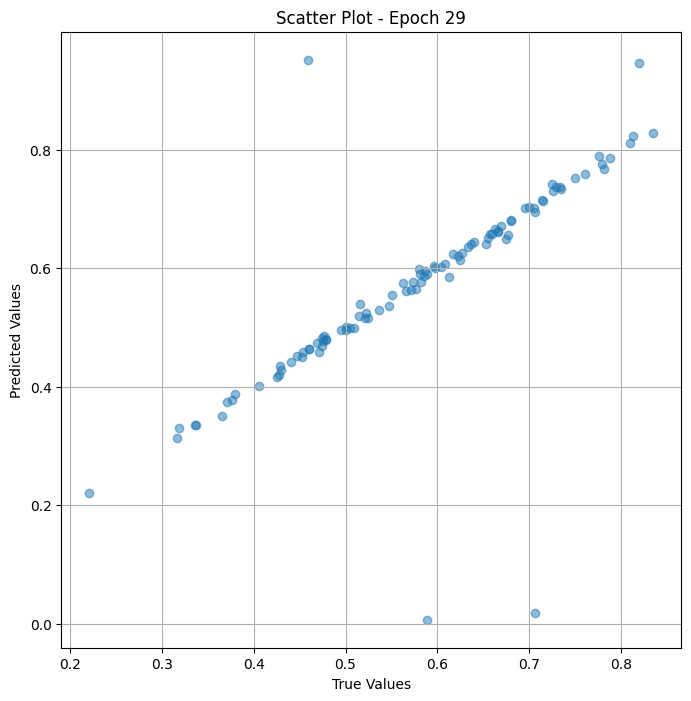


 Epoch: (30/50) Loss = 1.7218129642060376e-06

 Epoch: (30/50) Loss_rmse = 0.0013121786760166287

 Epoch: (30/50) R^2 = 0.9998002052307129

 Epoch: (30/50) MAE = 0.0010116621851921082

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

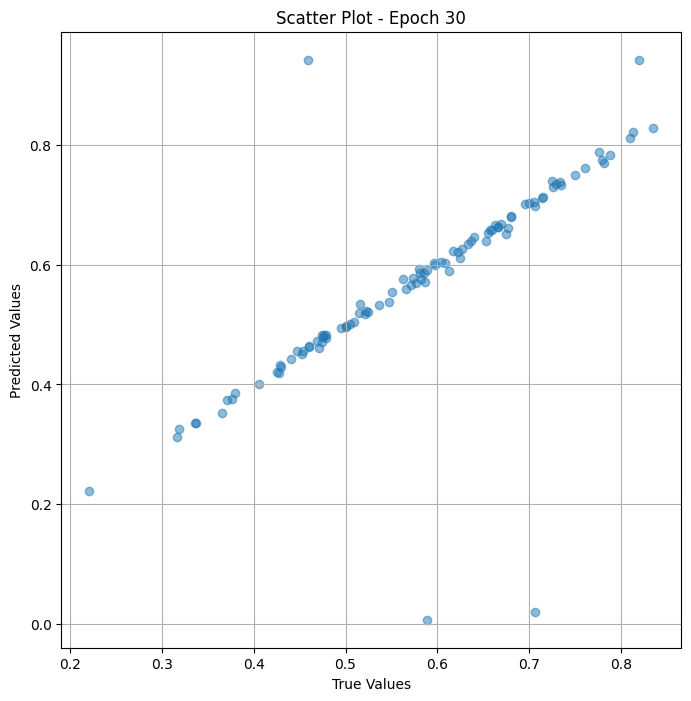


 Epoch: (31/50) Loss = 2.0123436570429476e-06

 Epoch: (31/50) Loss_rmse = 0.00141857098788023

 Epoch: (31/50) R^2 = 0.99976646900177

 Epoch: (31/50) MAE = 0.001044049859046936

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33

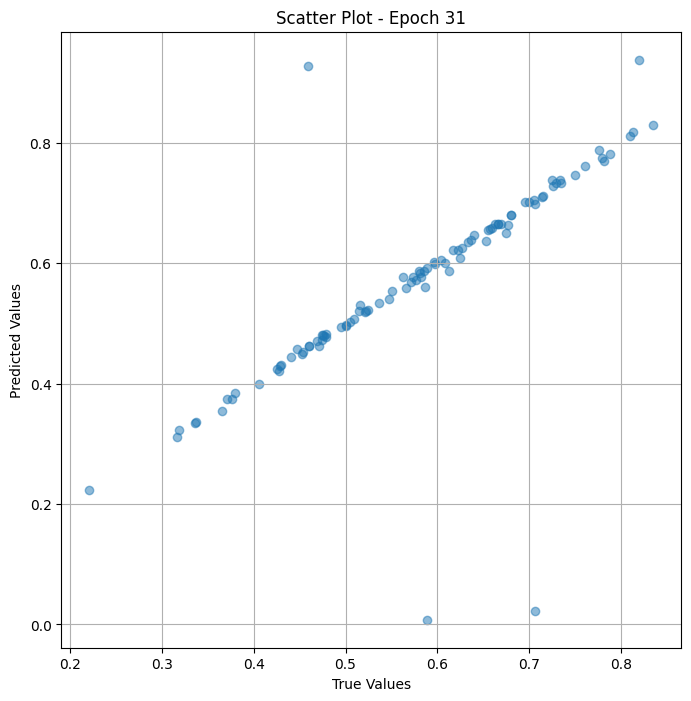


 Epoch: (32/50) Loss = 2.6334839731134707e-06

 Epoch: (32/50) Loss_rmse = 0.0016228012973442674

 Epoch: (32/50) R^2 = 0.9996944069862366

 Epoch: (32/50) MAE = 0.0010829567909240723

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

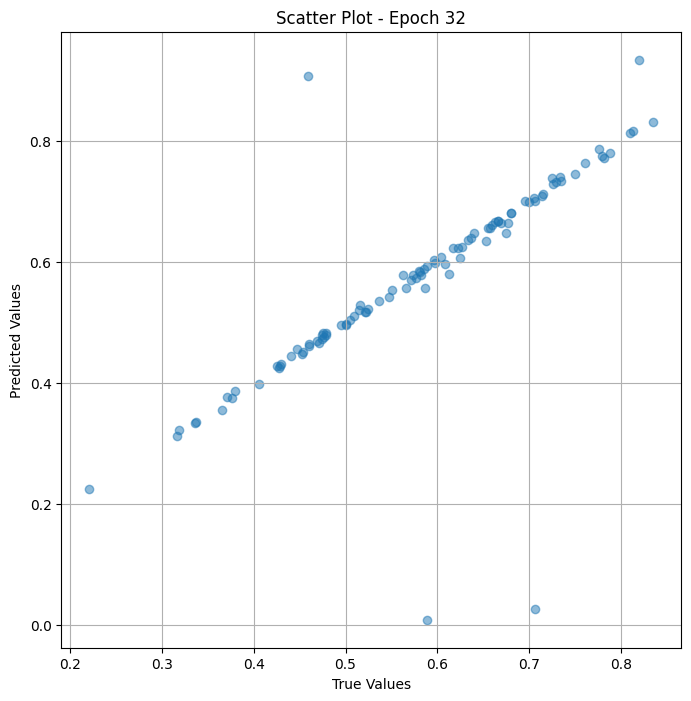


 Epoch: (33/50) Loss = 3.653778321677237e-06

 Epoch: (33/50) Loss_rmse = 0.0019114859169349074

 Epoch: (33/50) R^2 = 0.9995760321617126

 Epoch: (33/50) MAE = 0.0012238845229148865

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

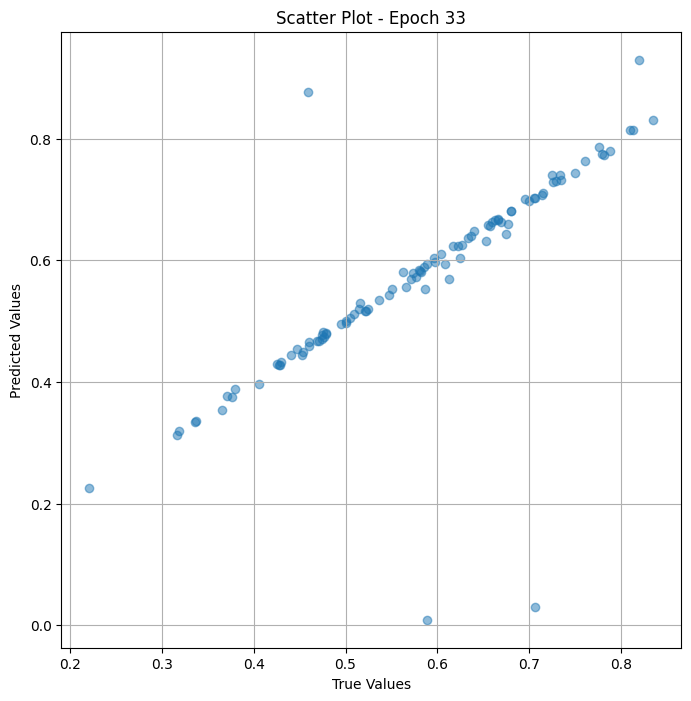


 Epoch: (34/50) Loss = 4.667511348088738e-06

 Epoch: (34/50) Loss_rmse = 0.0021604422945529222

 Epoch: (34/50) R^2 = 0.999458372592926

 Epoch: (34/50) MAE = 0.001390218734741211

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

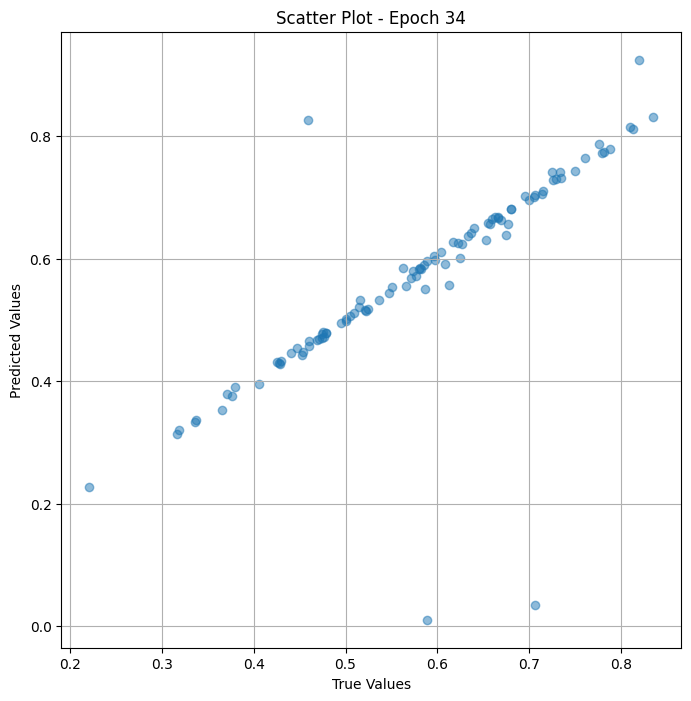


 Epoch: (35/50) Loss = 5.88325838180026e-06

 Epoch: (35/50) Loss_rmse = 0.002425542799755931

 Epoch: (35/50) R^2 = 0.9993172883987427

 Epoch: (35/50) MAE = 0.0015820041298866272

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

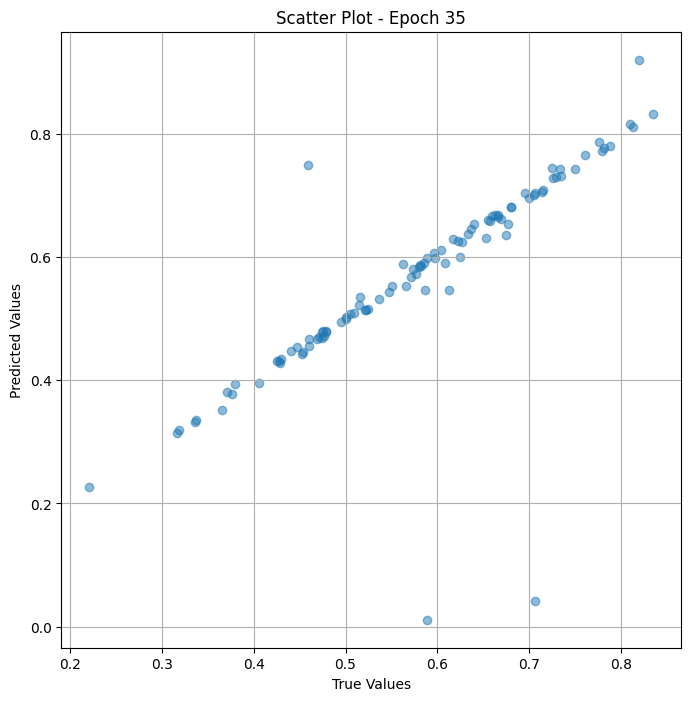


 Epoch: (36/50) Loss = 1.2319231245783158e-05

 Epoch: (36/50) Loss_rmse = 0.0035098763182759285

 Epoch: (36/50) R^2 = 0.9985705018043518

 Epoch: (36/50) MAE = 0.0026175454258918762

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

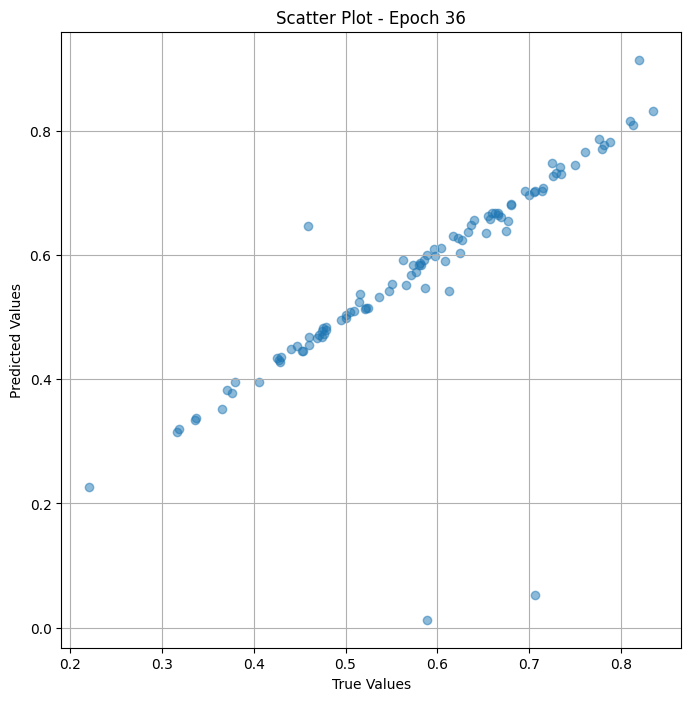


 Epoch: (37/50) Loss = 1.7362923244945705e-05

 Epoch: (37/50) Loss_rmse = 0.00416688434779644

 Epoch: (37/50) R^2 = 0.9979852437973022

 Epoch: (37/50) MAE = 0.003470316529273987

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

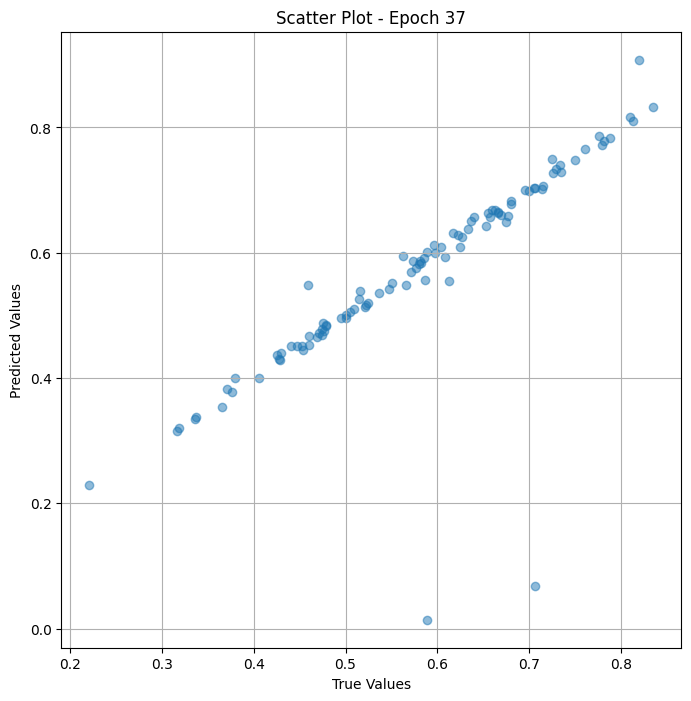


 Epoch: (38/50) Loss = 1.7551195924170315e-05

 Epoch: (38/50) Loss_rmse = 0.004189414903521538

 Epoch: (38/50) R^2 = 0.9979633688926697

 Epoch: (38/50) MAE = 0.0036178231239318848

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

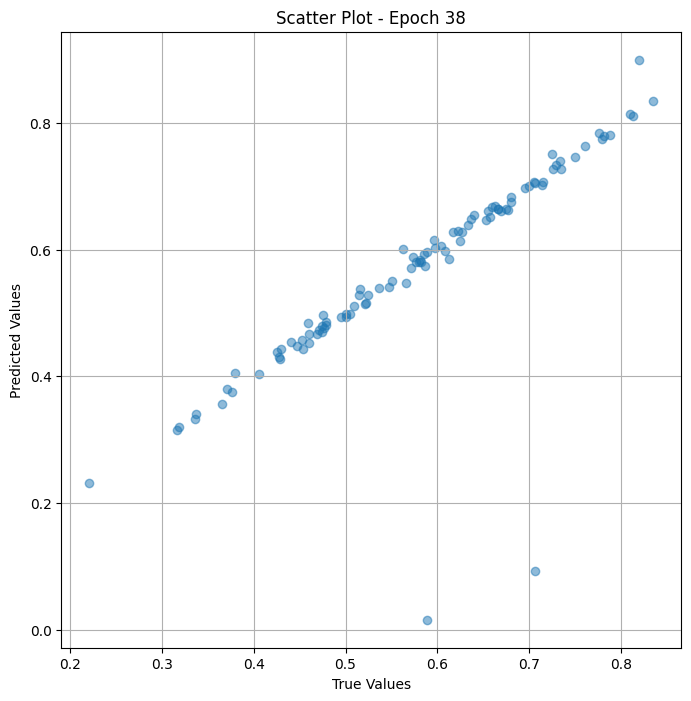


 Epoch: (39/50) Loss = 2.5738292606547475e-05

 Epoch: (39/50) Loss_rmse = 0.005073292180895805

 Epoch: (39/50) R^2 = 0.9970133304595947

 Epoch: (39/50) MAE = 0.004003509879112244

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

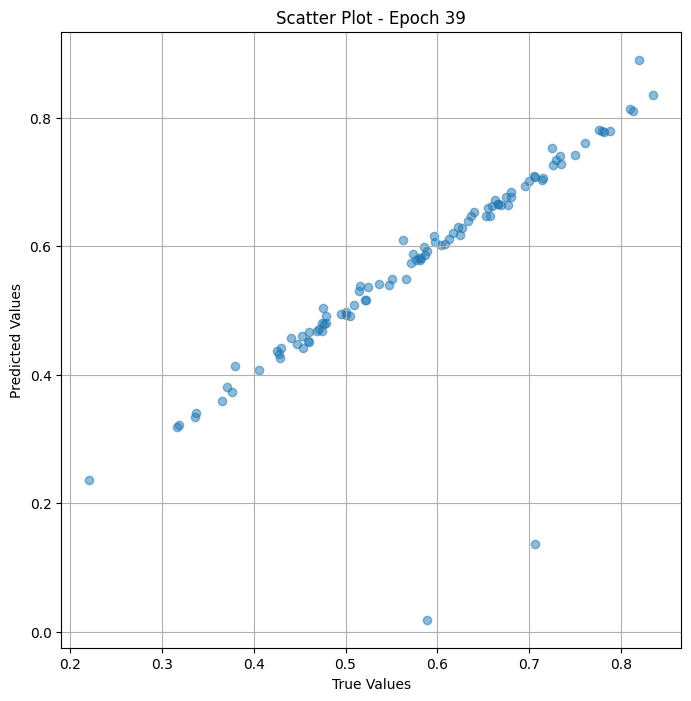


 Epoch: (40/50) Loss = 4.278395135770552e-05

 Epoch: (40/50) Loss_rmse = 0.006540944334119558

 Epoch: (40/50) R^2 = 0.9950353503227234

 Epoch: (40/50) MAE = 0.004940912127494812

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

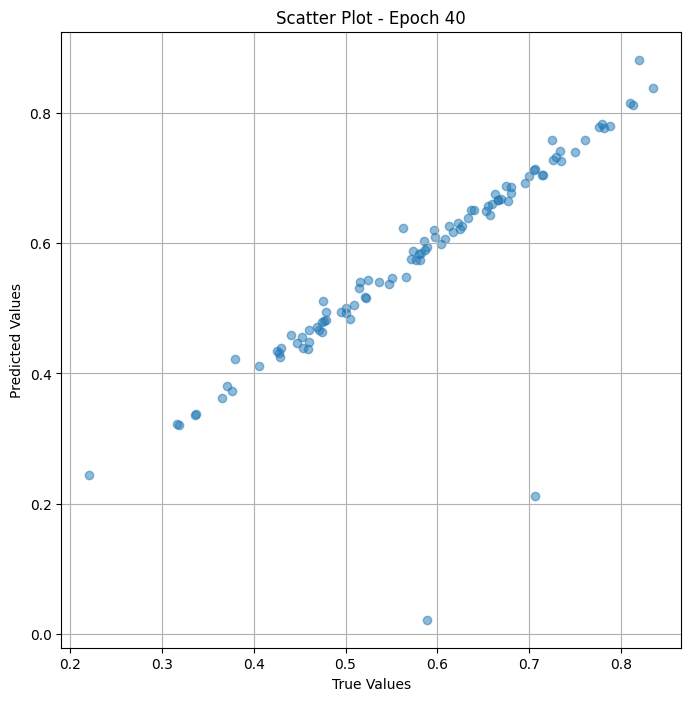


 Epoch: (41/50) Loss = 3.238475619582459e-05

 Epoch: (41/50) Loss_rmse = 0.0056907604448497295

 Epoch: (41/50) R^2 = 0.996242105960846

 Epoch: (41/50) MAE = 0.004452988505363464

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

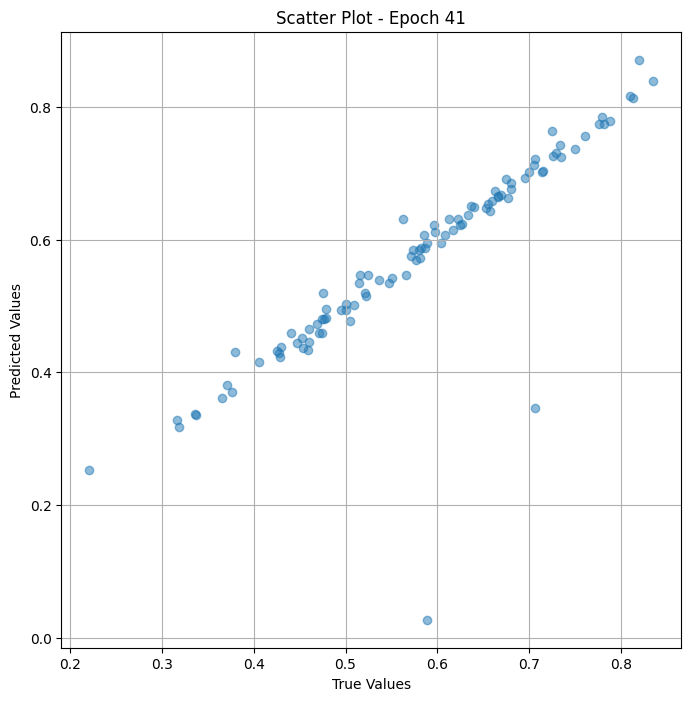


 Epoch: (42/50) Loss = 1.804996031751216e-06

 Epoch: (42/50) Loss_rmse = 0.0013435013825073838

 Epoch: (42/50) R^2 = 0.9997905492782593

 Epoch: (42/50) MAE = 0.0010167062282562256

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

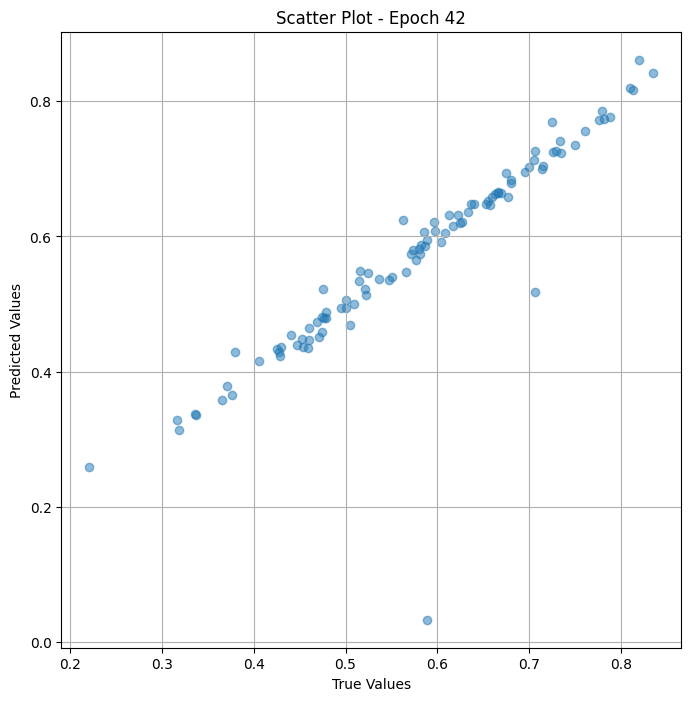


 Epoch: (43/50) Loss = 1.1277577868895605e-05

 Epoch: (43/50) Loss_rmse = 0.003358210436999798

 Epoch: (43/50) R^2 = 0.9986913800239563

 Epoch: (43/50) MAE = 0.0022228285670280457

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

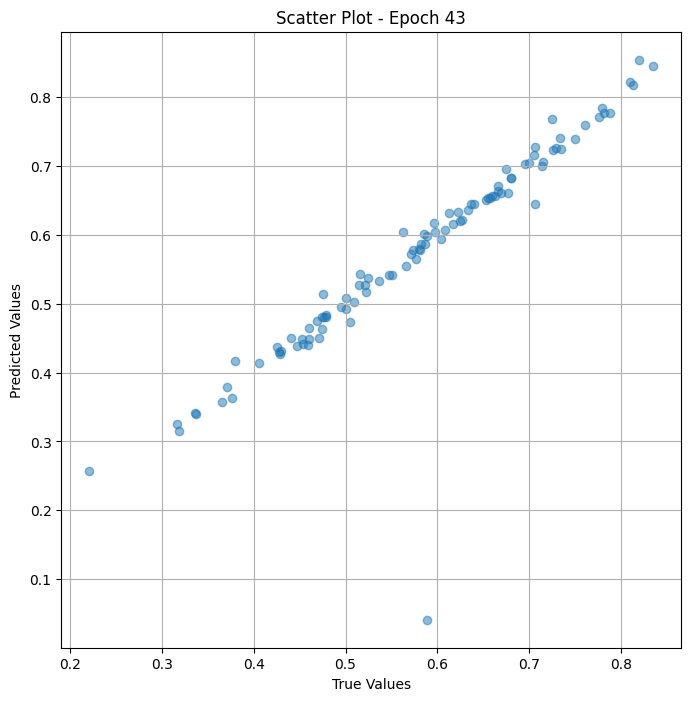


 Epoch: (44/50) Loss = 7.870460649428423e-06

 Epoch: (44/50) Loss_rmse = 0.0028054341673851013

 Epoch: (44/50) R^2 = 0.9990867376327515

 Epoch: (44/50) MAE = 0.0022731348872184753

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

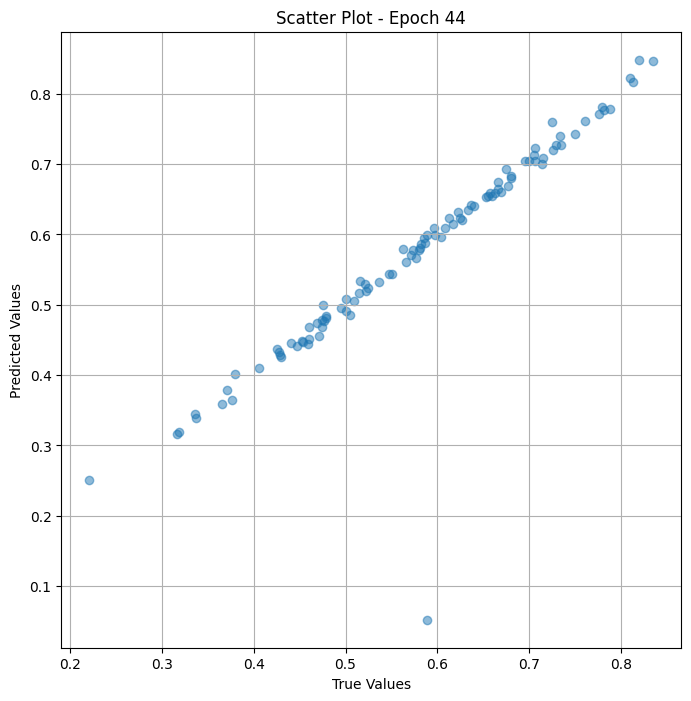


 Epoch: (45/50) Loss = 5.236306606093422e-06

 Epoch: (45/50) Loss_rmse = 0.00228829775005579

 Epoch: (45/50) R^2 = 0.9993923902511597

 Epoch: (45/50) MAE = 0.0020536258816719055

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

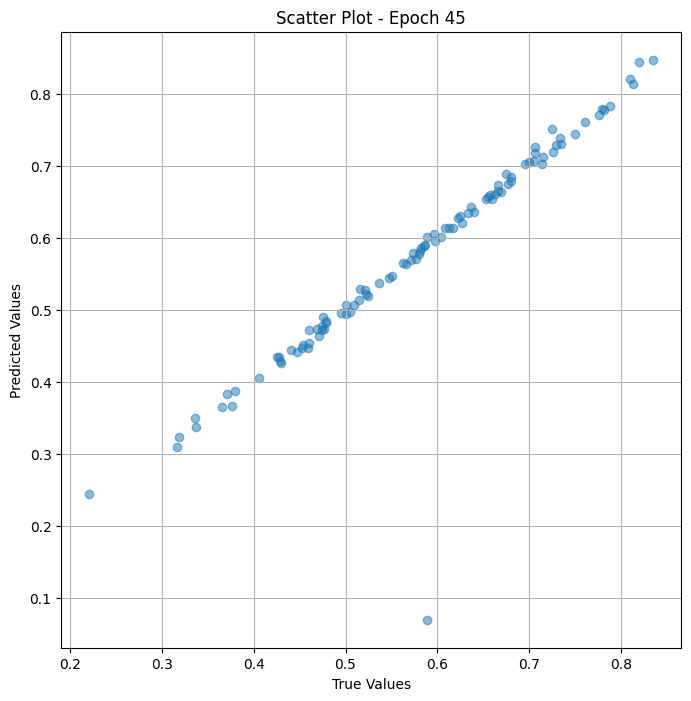


 Epoch: (46/50) Loss = 6.154104539746186e-06

 Epoch: (46/50) Loss_rmse = 0.0024807467125356197

 Epoch: (46/50) R^2 = 0.999285876750946

 Epoch: (46/50) MAE = 0.0022067055106163025

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

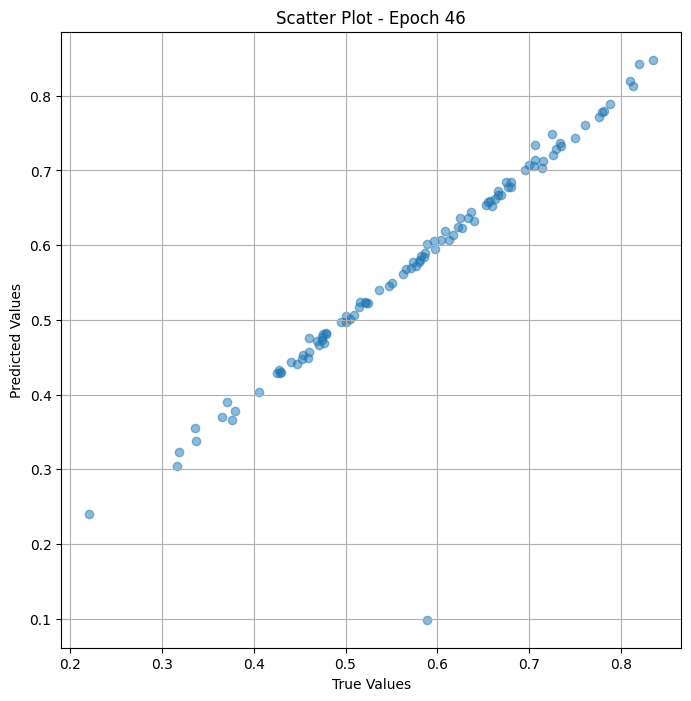


 Epoch: (47/50) Loss = 6.03208172833547e-06

 Epoch: (47/50) Loss_rmse = 0.0024560296442359686

 Epoch: (47/50) R^2 = 0.9993000626564026

 Epoch: (47/50) MAE = 0.001724332571029663

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

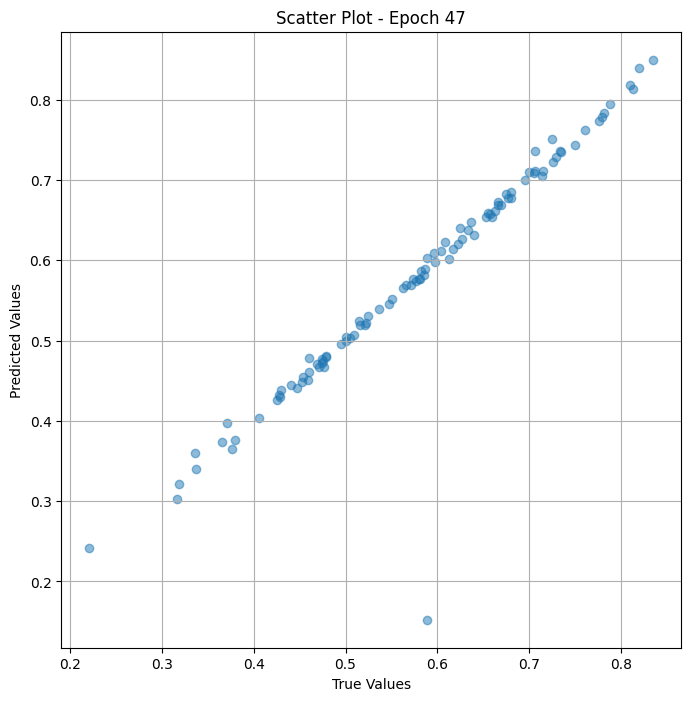


 Epoch: (48/50) Loss = 7.738585736660752e-06

 Epoch: (48/50) Loss_rmse = 0.0027818314265459776

 Epoch: (48/50) R^2 = 0.999101996421814

 Epoch: (48/50) MAE = 0.002179056406021118

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

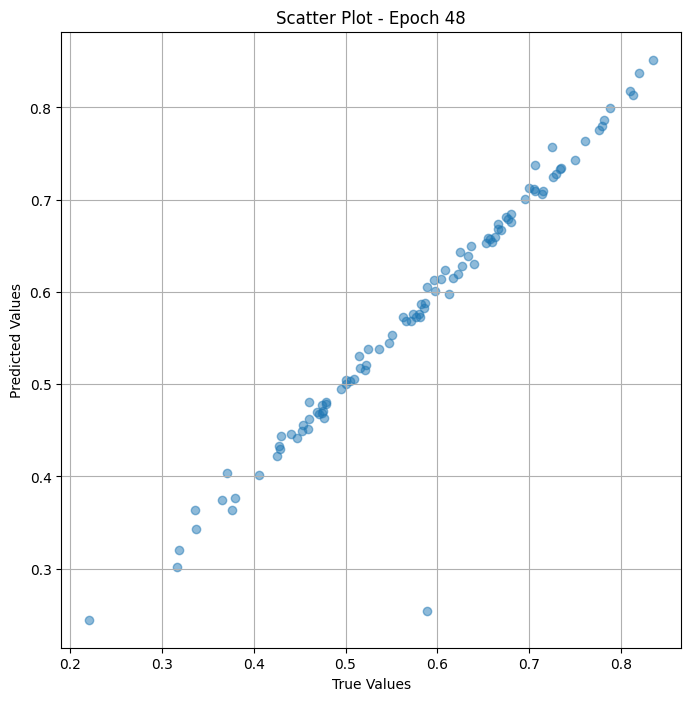


 Epoch: (49/50) Loss = 1.0627305528032593e-05

 Epoch: (49/50) Loss_rmse = 0.0032599547412246466

 Epoch: (49/50) R^2 = 0.9987668395042419

 Epoch: (49/50) MAE = 0.002554774284362793

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

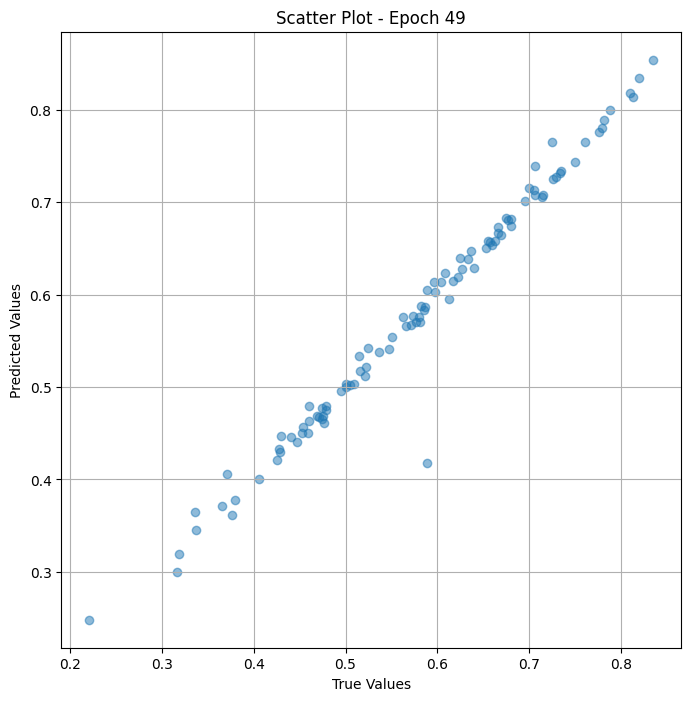


 Epoch: (50/50) Loss = 1.248662101716036e-05

 Epoch: (50/50) Loss_rmse = 0.003533641342073679

 Epoch: (50/50) R^2 = 0.998551070690155

 Epoch: (50/50) MAE = 0.0031368061900138855

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

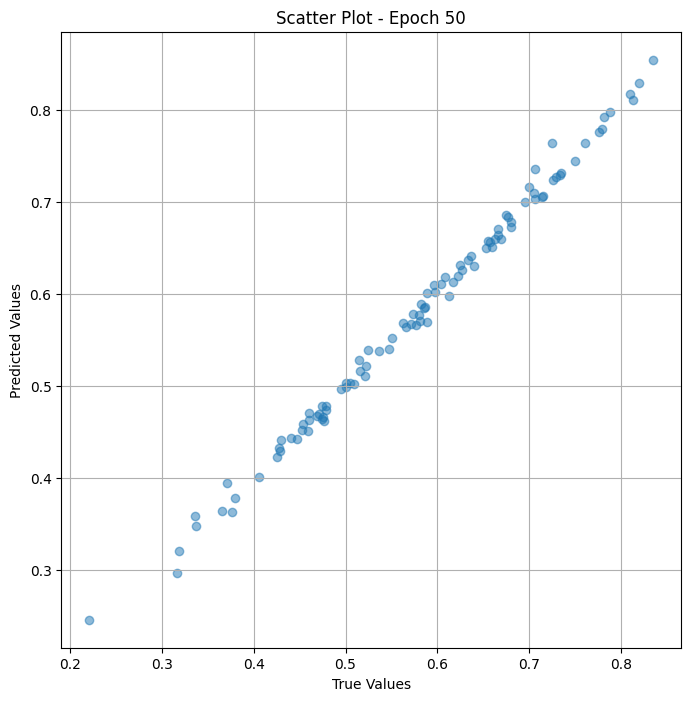

In [ ]:
# Training the model and save weights
fit(50, model_test, train_dl_test)
torch.save(model.state_dict(), "model_weights_vr_test")

In [ ]:
 true_values_list = [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639]

 predicted_values_list= [0.5329304, 0.5713239, 0.6970961, 0.50349224, 0.7289853, 0.65796536, 0.5341751]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )


Spearman correlation: 0.9642857142857145 0.0004541491691941689


# Finetune


## Train

In [ ]:
# Load the pre-trained ResNet model
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
for param in model_Res.parameters():
    param.requires_grad = True

# Add your custom layers for fine-tuning
#num_features = model_Res[0][-1].in_features  # Get the number of features in the last layer of ResNet

custom_layers = [
    nn.Flatten(),
    nn.Linear(2048, 512),  # Example: add a fully connected layer with 512 units
    nn.ReLU(),
    nn.Dropout(0.5),  # Example: add dropout for regularization
    nn.Linear(512, 1)  # Example: add the output layer with your desired number of classes
]

# Create a new model by combining ResNet and custom layers
fine_tuned_model = nn.Sequential(
    model_Res,
    *custom_layers
)

# Optionally, you can print the fine-tuned model architecture
print(fine_tuned_model)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [ ]:
# Load the pre-trained ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')

# Freeze some of the layers
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = True

# Extract the feature extractor
feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')

# Remove the classification head (top layers) from the model
model_trans_top = nn.Sequential(*list(model_trans.children())[:-2])

# Access the last linear layer and adjust its bias
last_linear_layer = list(model_trans.children())[-1]
# Assuming the last layer is a Linear layer
if isinstance(last_linear_layer, nn.Linear):
    # Adjust the bias as needed
    new_bias = torch.tensor([2.0])
    last_linear_layer.bias.data = new_bias

# Add Sigmoid activation
mymodel = nn.Sequential(last_linear_layer, nn.Sigmoid())

# Optionally, you can print the modified model architecture
print(mymodel)


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Sequential(
  (0): ViTPooler(
    (dense): Linear(in_features=768, out_features=768, bias=True)
    (activation): Tanh()
  )
  (1): Sigmoid()
)


In [ ]:
# Merge the two models
class model_merge_fine(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_fine(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.07630468904972076

 Epoch: (1/50) Loss_rmse = 0.276233047246933

 Epoch: (1/50) R^2 = -3.557799816131592

 Epoch: (1/50) MAE = 0.2420029193162918

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.464285

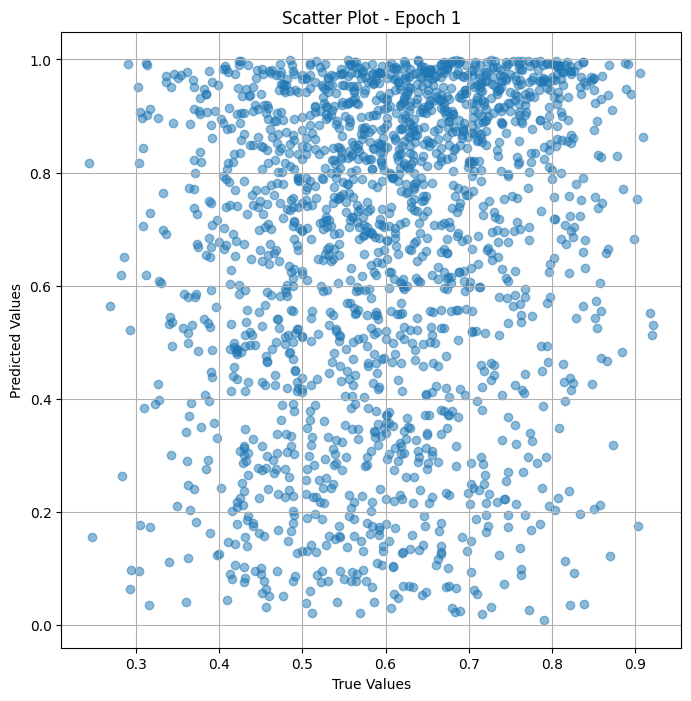


 Epoch: (2/50) Loss = 0.07134091109037399

 Epoch: (2/50) Loss_rmse = 0.26709720492362976

 Epoch: (2/50) R^2 = -3.261305332183838

 Epoch: (2/50) MAE = 0.22732482850551605

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.464

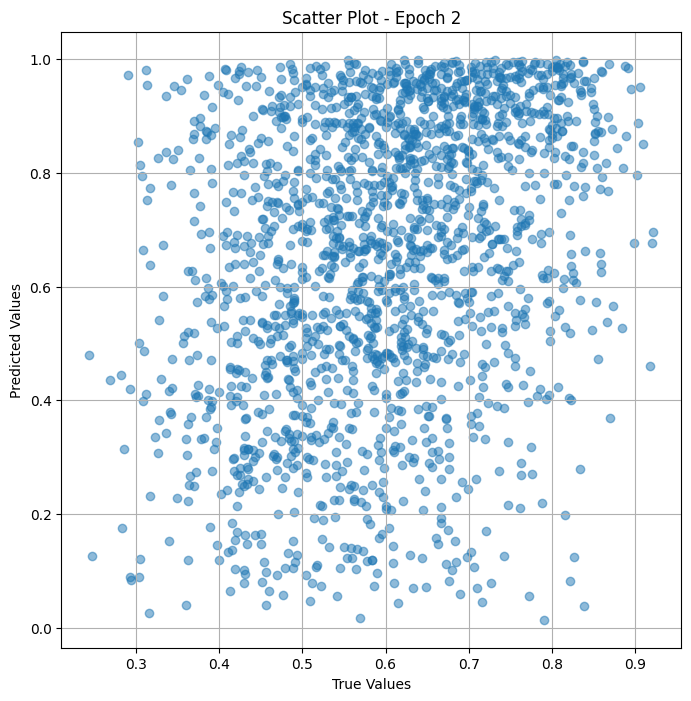


 Epoch: (3/50) Loss = 0.06110546737909317

 Epoch: (3/50) Loss_rmse = 0.24719519913196564

 Epoch: (3/50) R^2 = -2.64992618560791

 Epoch: (3/50) MAE = 0.19696156680583954

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4642

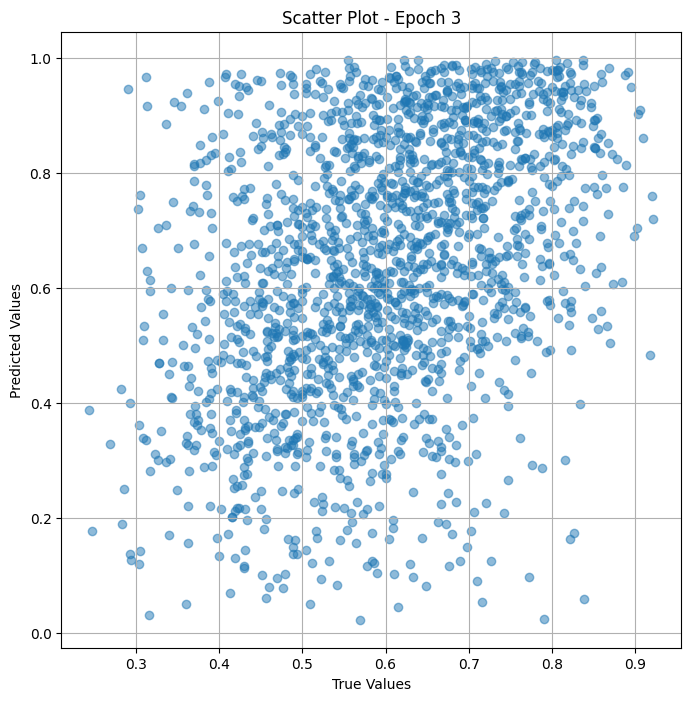


 Epoch: (4/50) Loss = 0.05271517485380173

 Epoch: (4/50) Loss_rmse = 0.22959785163402557

 Epoch: (4/50) R^2 = -2.1487607955932617

 Epoch: (4/50) MAE = 0.18620938062667847

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.46

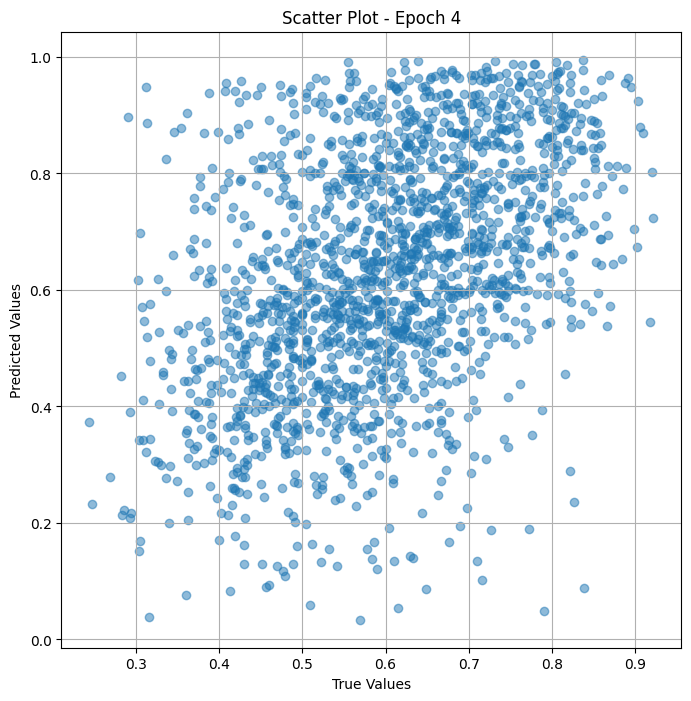


 Epoch: (5/50) Loss = 0.04280409961938858

 Epoch: (5/50) Loss_rmse = 0.2068915218114853

 Epoch: (5/50) R^2 = -1.5567564964294434

 Epoch: (5/50) MAE = 0.16426101326942444

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.464

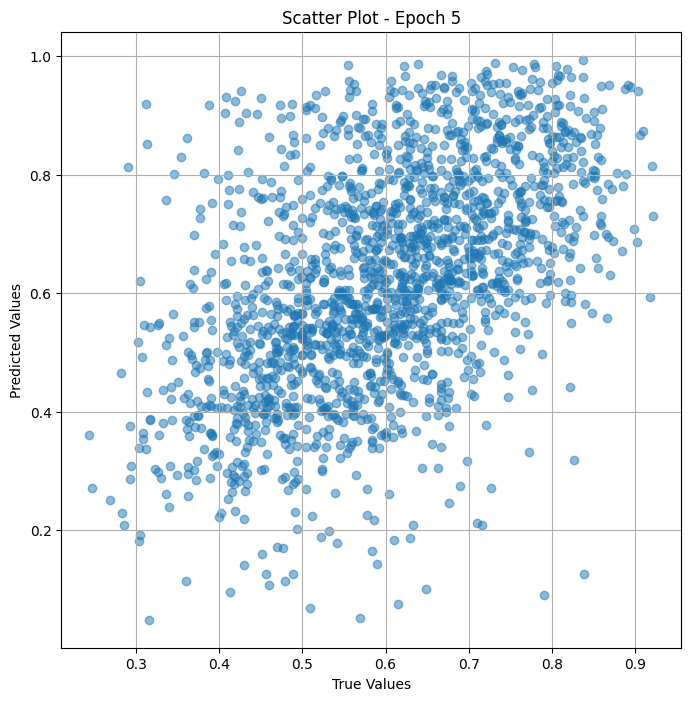


 Epoch: (6/50) Loss = 0.03388373181223869

 Epoch: (6/50) Loss_rmse = 0.18407534062862396

 Epoch: (6/50) R^2 = -1.0239288806915283

 Epoch: (6/50) MAE = 0.13585354387760162

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.46

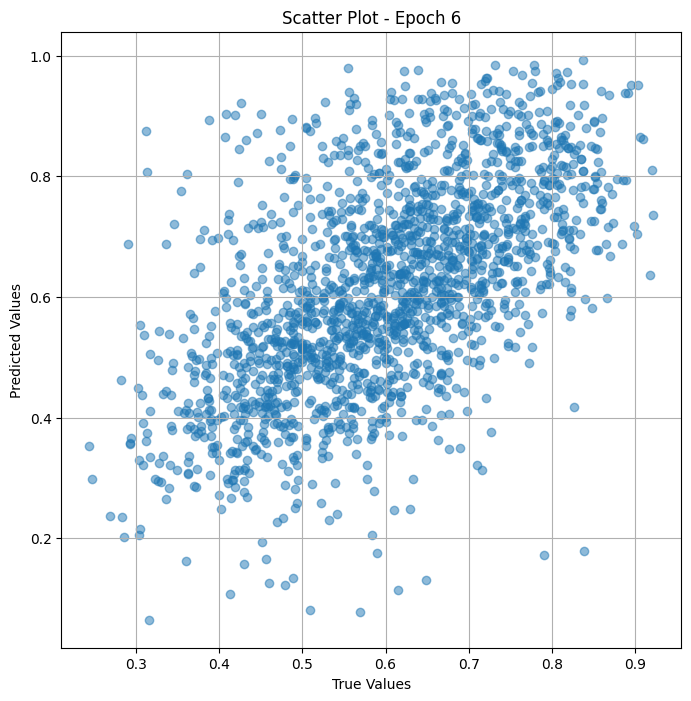


 Epoch: (7/50) Loss = 0.027481665834784508

 Epoch: (7/50) Loss_rmse = 0.16577595472335815

 Epoch: (7/50) R^2 = -0.6415233612060547

 Epoch: (7/50) MAE = 0.11040446162223816

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

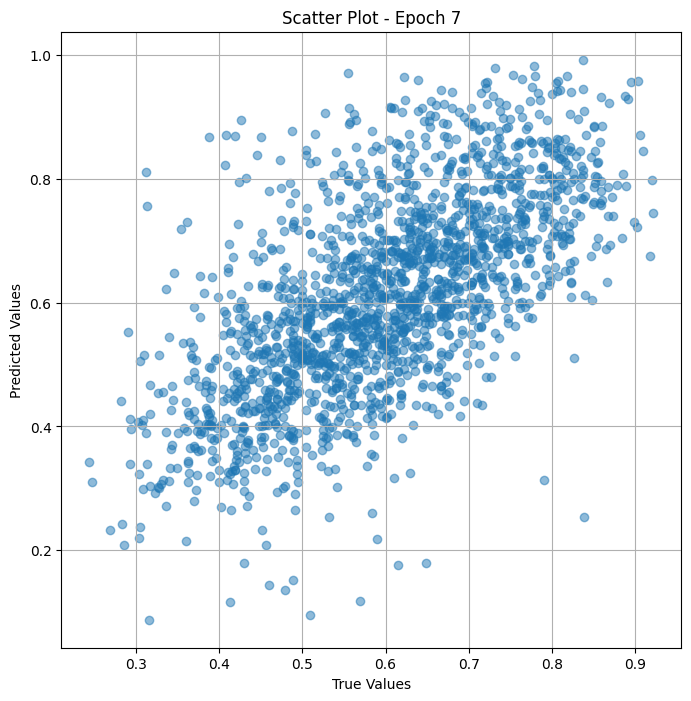


 Epoch: (8/50) Loss = 0.022885343059897423

 Epoch: (8/50) Loss_rmse = 0.151279017329216

 Epoch: (8/50) R^2 = -0.3669776916503906

 Epoch: (8/50) MAE = 0.09412229061126709

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.464

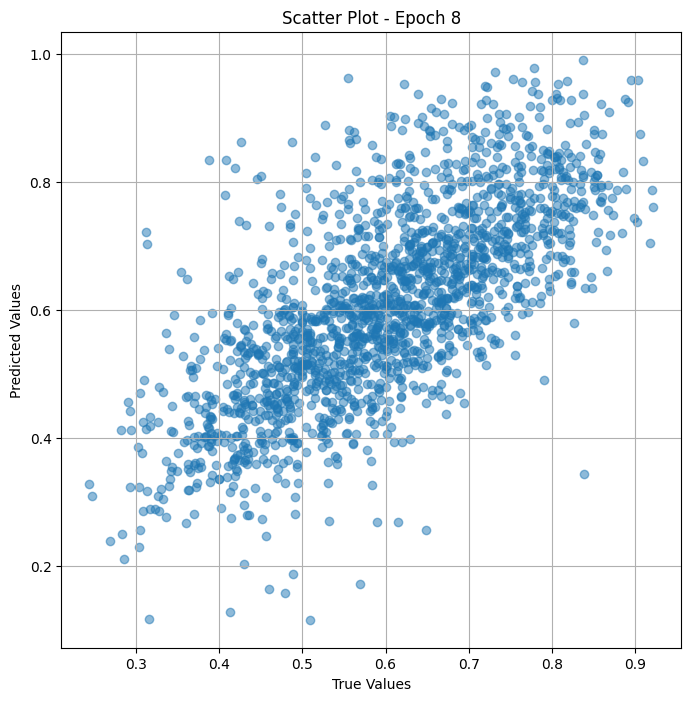


 Epoch: (9/50) Loss = 0.018795602023601532

 Epoch: (9/50) Loss_rmse = 0.1370970606803894

 Epoch: (9/50) R^2 = -0.12269103527069092

 Epoch: (9/50) MAE = 0.08326035737991333

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

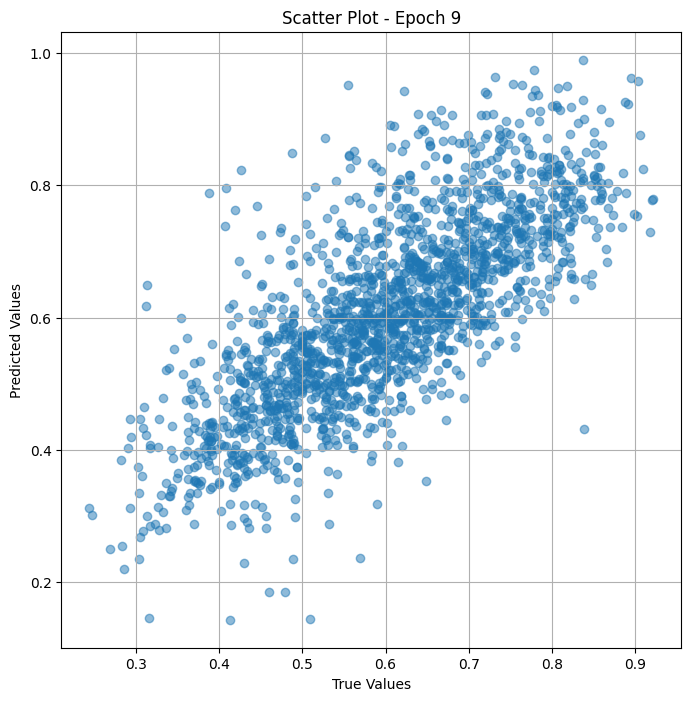


 Epoch: (10/50) Loss = 0.014587534591555595

 Epoch: (10/50) Loss_rmse = 0.12077886611223221

 Epoch: (10/50) R^2 = 0.12866348028182983

 Epoch: (10/50) MAE = 0.07363481819629669

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

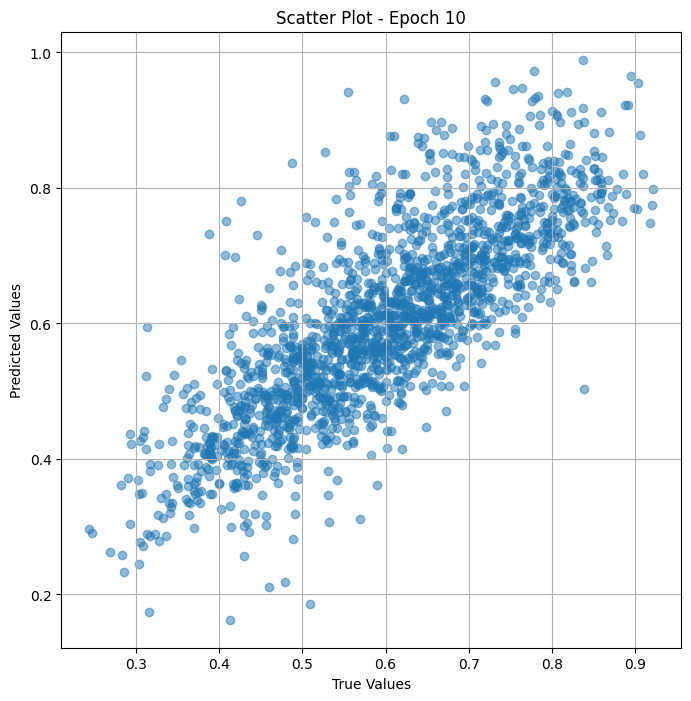


 Epoch: (11/50) Loss = 0.009909032844007015

 Epoch: (11/50) Loss_rmse = 0.09954412281513214

 Epoch: (11/50) R^2 = 0.4081178307533264

 Epoch: (11/50) MAE = 0.061598896980285645

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

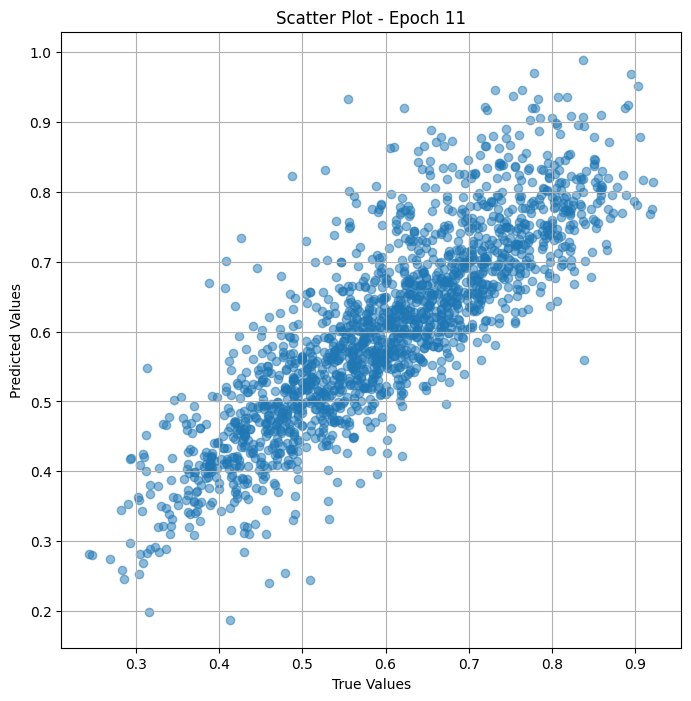


 Epoch: (12/50) Loss = 0.005584553815424442

 Epoch: (12/50) Loss_rmse = 0.07472987473011017

 Epoch: (12/50) R^2 = 0.6664257645606995

 Epoch: (12/50) MAE = 0.04818255454301834

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

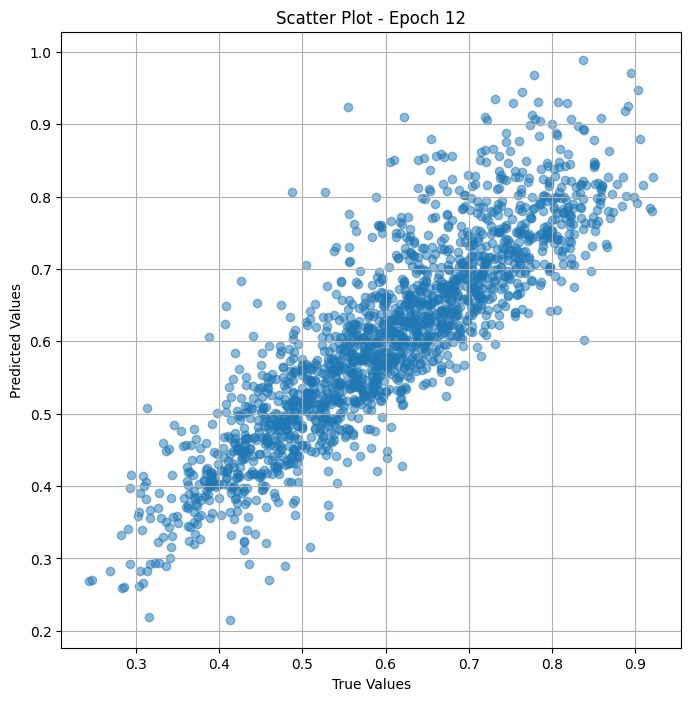


 Epoch: (13/50) Loss = 0.0026705714408308268

 Epoch: (13/50) Loss_rmse = 0.05167757347226143

 Epoch: (13/50) R^2 = 0.8404825329780579

 Epoch: (13/50) MAE = 0.035984382033348083

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

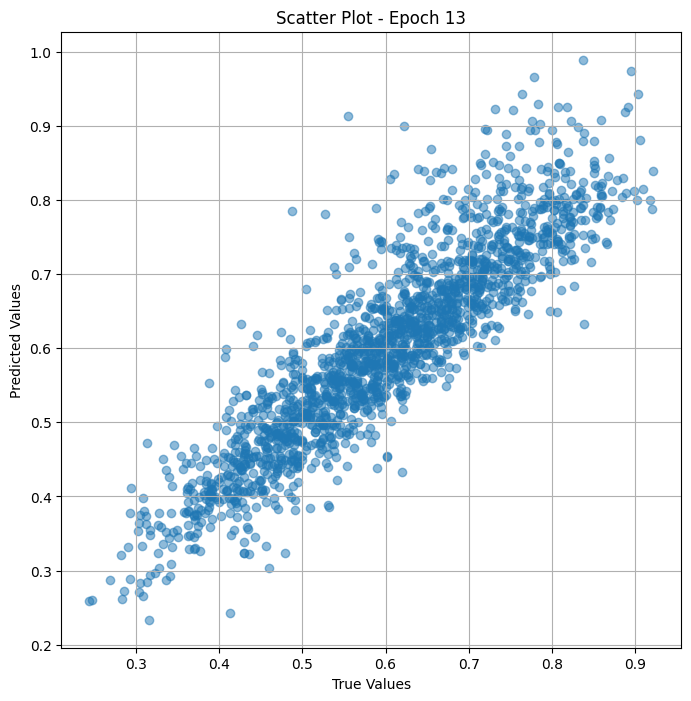


 Epoch: (14/50) Loss = 0.0012686625123023987

 Epoch: (14/50) Loss_rmse = 0.035618290305137634

 Epoch: (14/50) R^2 = 0.9242208003997803

 Epoch: (14/50) MAE = 0.026801709085702896

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

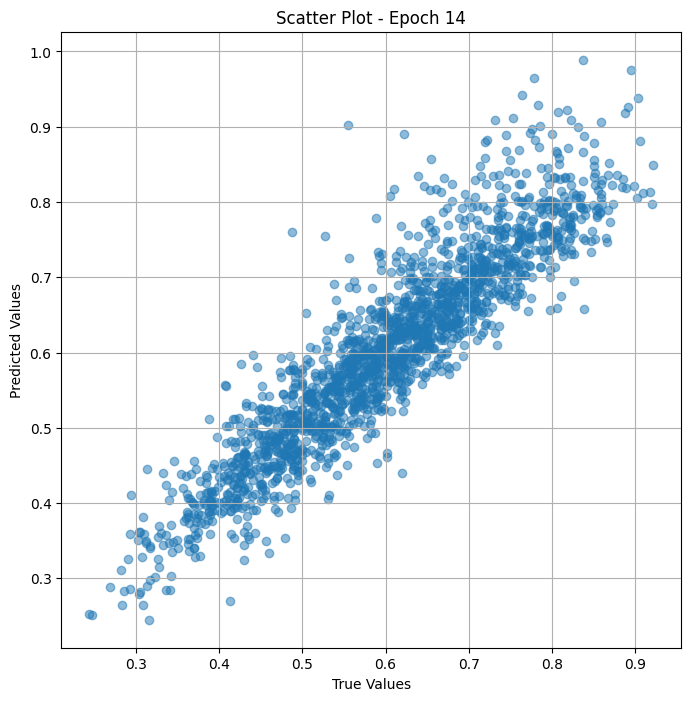


 Epoch: (15/50) Loss = 0.0006584036163985729

 Epoch: (15/50) Loss_rmse = 0.02565937675535679

 Epoch: (15/50) R^2 = 0.9606724977493286

 Epoch: (15/50) MAE = 0.01969768851995468

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

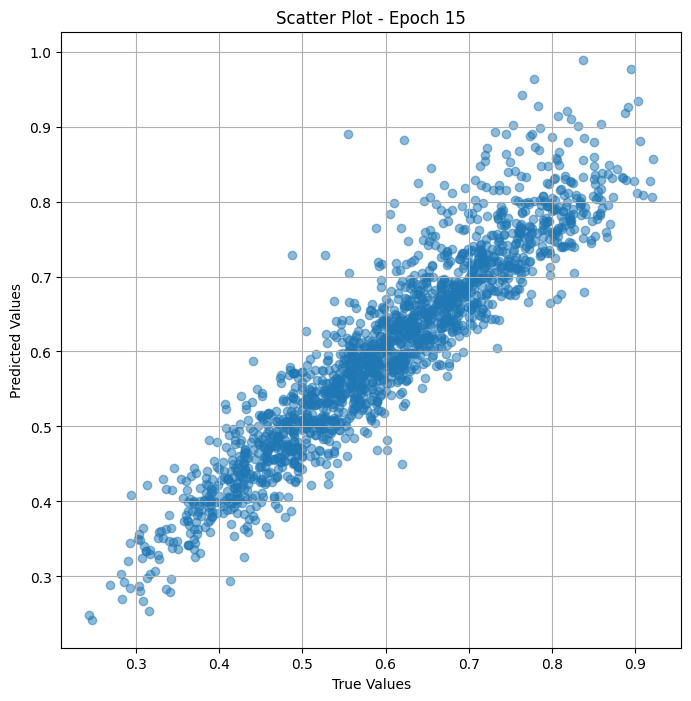


 Epoch: (16/50) Loss = 0.00034377980045974255

 Epoch: (16/50) Loss_rmse = 0.018541300669312477

 Epoch: (16/50) R^2 = 0.9794654846191406

 Epoch: (16/50) MAE = 0.01374342292547226

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

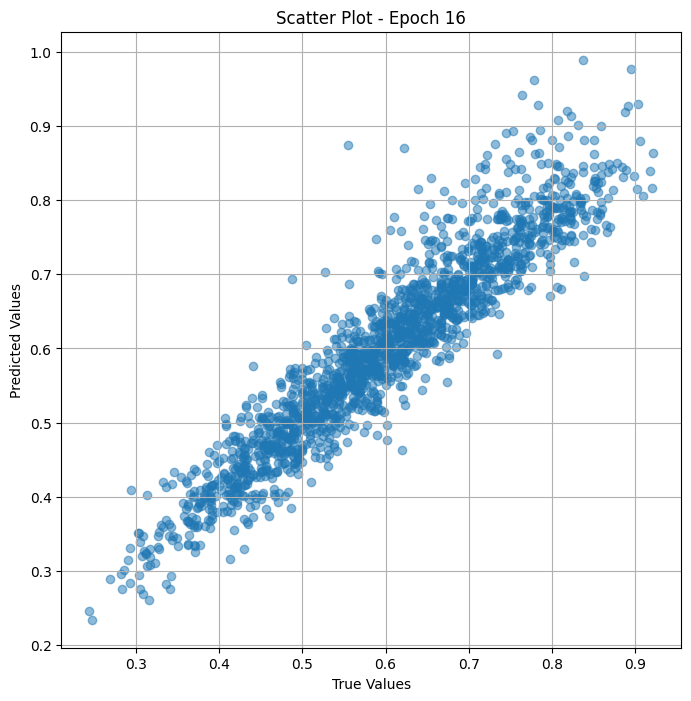


 Epoch: (17/50) Loss = 0.00017483648844063282

 Epoch: (17/50) Loss_rmse = 0.013222575187683105

 Epoch: (17/50) R^2 = 0.9895567297935486

 Epoch: (17/50) MAE = 0.010321937501430511

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.620253

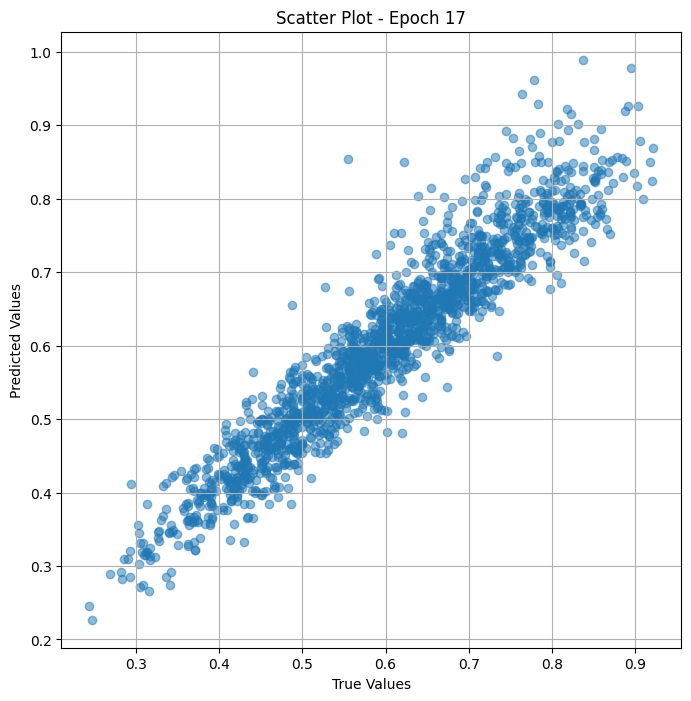


 Epoch: (18/50) Loss = 0.00010878054308705032

 Epoch: (18/50) Loss_rmse = 0.010429791174829006

 Epoch: (18/50) R^2 = 0.9935023784637451

 Epoch: (18/50) MAE = 0.00910549983382225

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

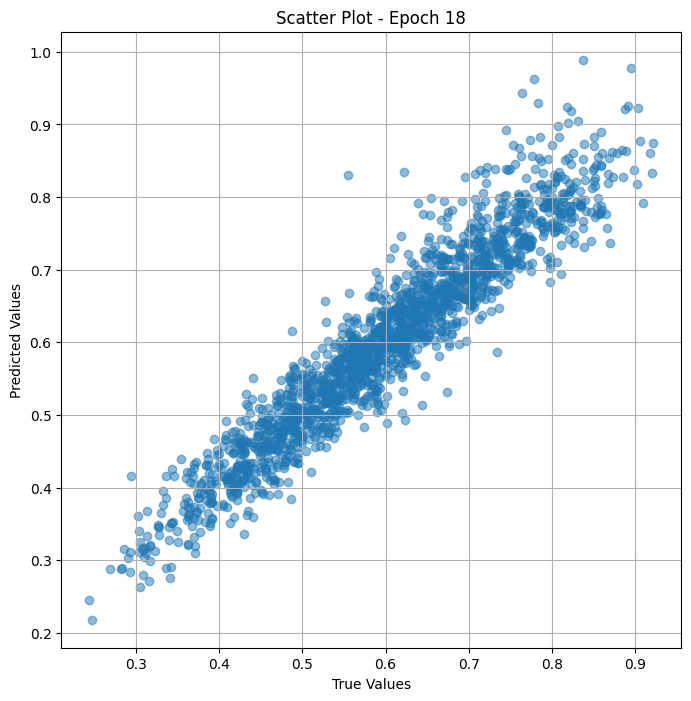


 Epoch: (19/50) Loss = 0.0001517777272965759

 Epoch: (19/50) Loss_rmse = 0.012319810688495636

 Epoch: (19/50) R^2 = 0.9909340739250183

 Epoch: (19/50) MAE = 0.008753947913646698

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

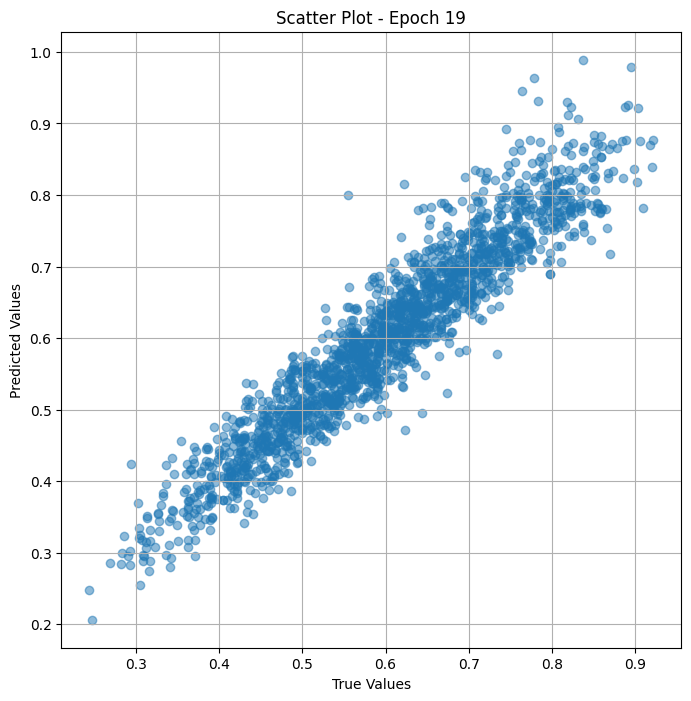


 Epoch: (20/50) Loss = 0.00040465989150106907

 Epoch: (20/50) Loss_rmse = 0.020116159692406654

 Epoch: (20/50) R^2 = 0.975829005241394

 Epoch: (20/50) MAE = 0.014570210129022598

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

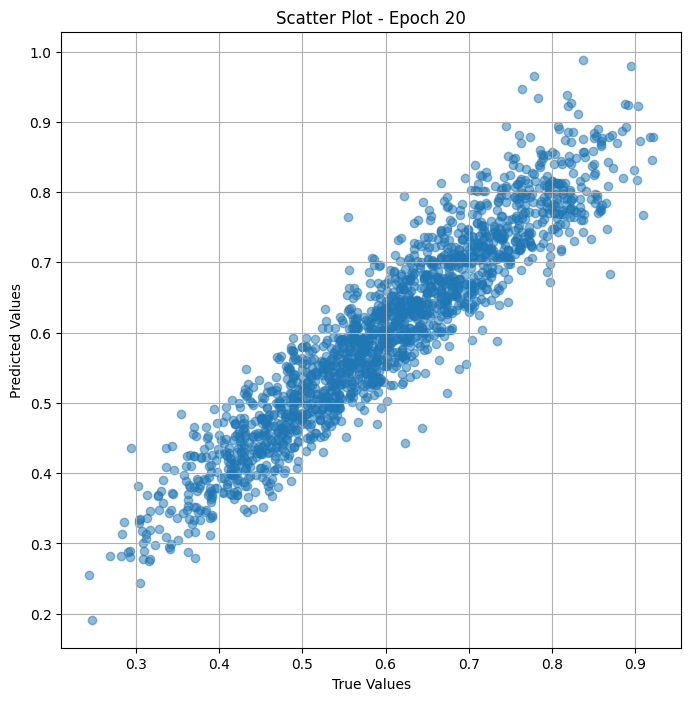


 Epoch: (21/50) Loss = 0.0014104301808401942

 Epoch: (21/50) Loss_rmse = 0.037555694580078125

 Epoch: (21/50) R^2 = 0.9157527685165405

 Epoch: (21/50) MAE = 0.031008724123239517

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

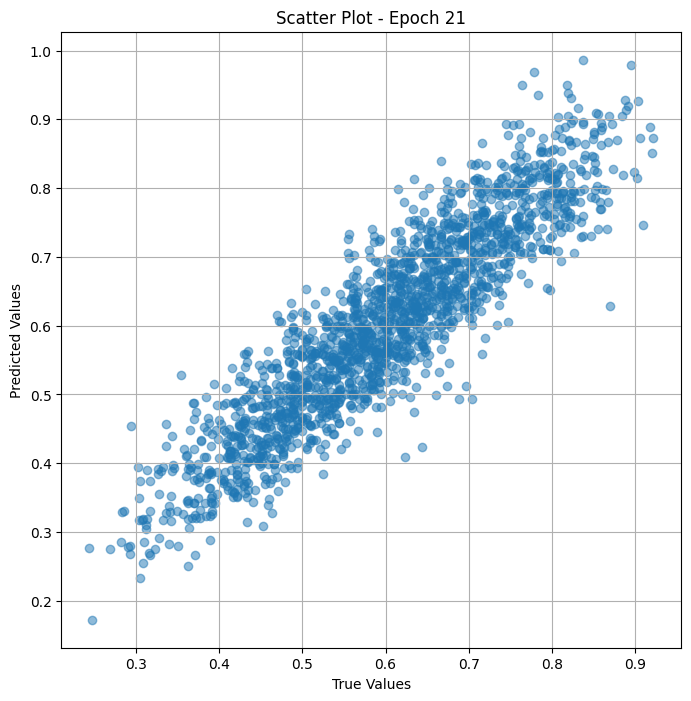


 Epoch: (22/50) Loss = 0.009552662260830402

 Epoch: (22/50) Loss_rmse = 0.09773772209882736

 Epoch: (22/50) R^2 = 0.4294043779373169

 Epoch: (22/50) MAE = 0.09083244204521179

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

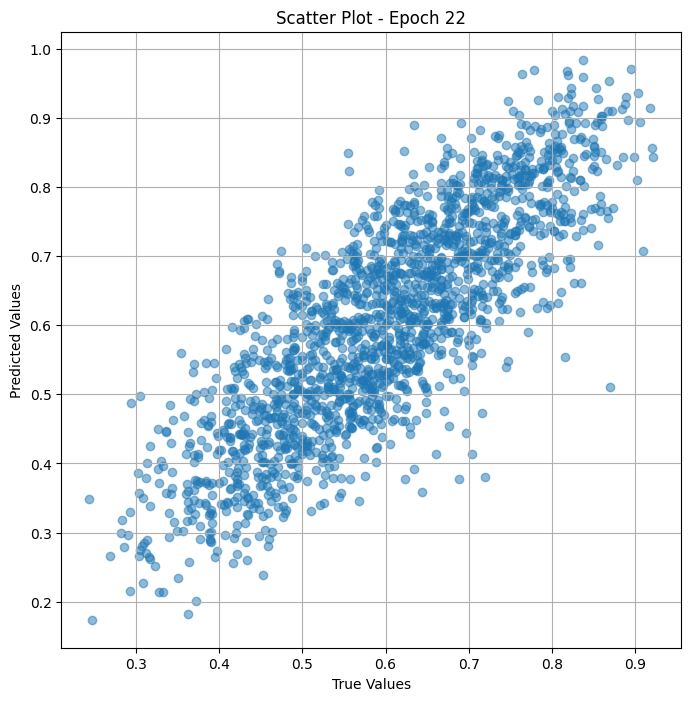


 Epoch: (23/50) Loss = 0.004153997637331486

 Epoch: (23/50) Loss_rmse = 0.06445151567459106

 Epoch: (23/50) R^2 = 0.7518751621246338

 Epoch: (23/50) MAE = 0.05938549339771271

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

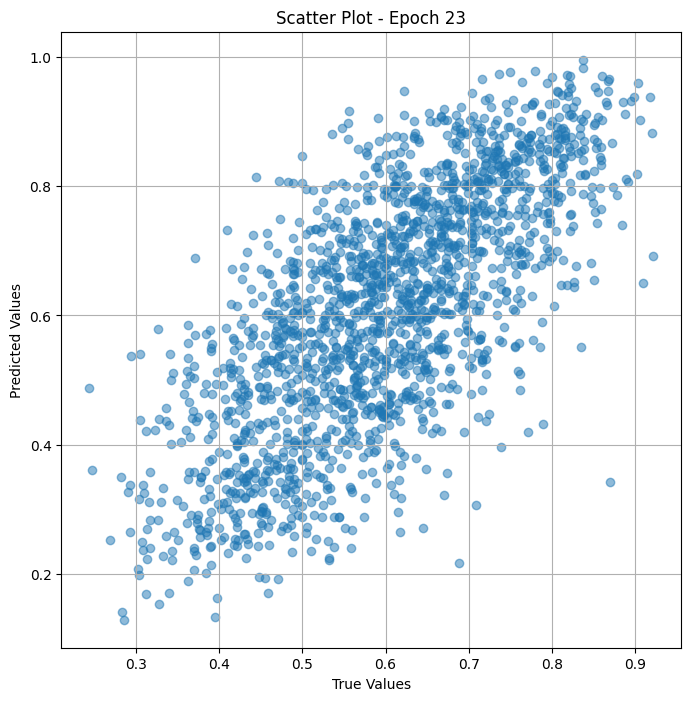


 Epoch: (24/50) Loss = 0.0041531468741595745

 Epoch: (24/50) Loss_rmse = 0.06444491446018219

 Epoch: (24/50) R^2 = 0.7519259452819824

 Epoch: (24/50) MAE = 0.058112408965826035

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

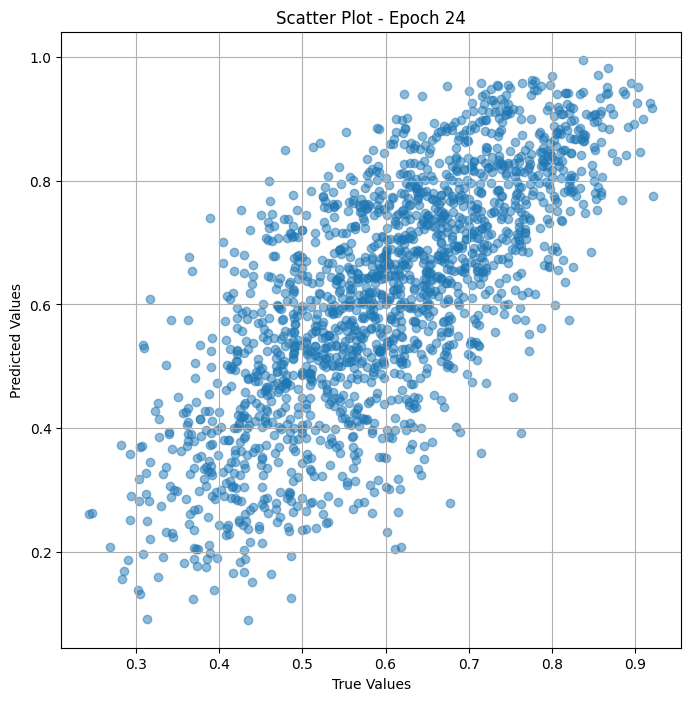


 Epoch: (25/50) Loss = 0.0020204861648380756

 Epoch: (25/50) Loss_rmse = 0.04494981840252876

 Epoch: (25/50) R^2 = 0.8793131709098816

 Epoch: (25/50) MAE = 0.038946956396102905

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

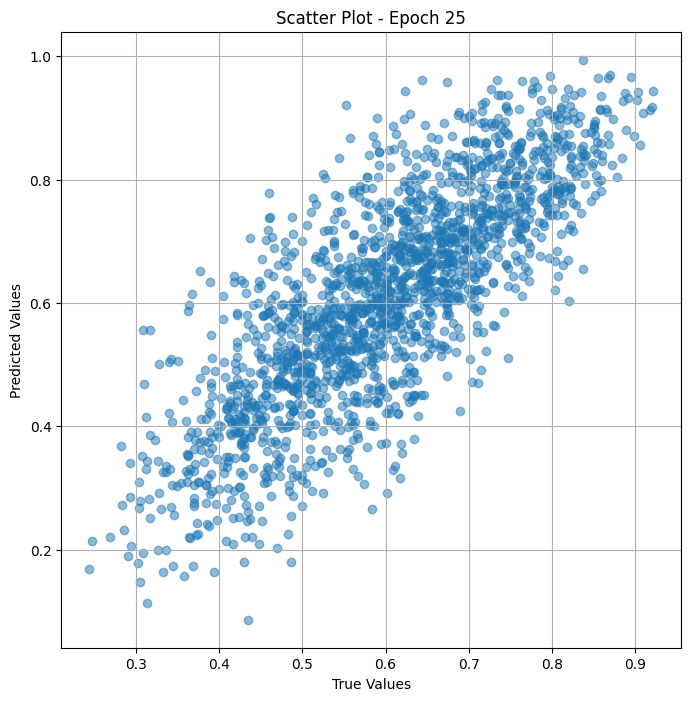


 Epoch: (26/50) Loss = 0.0011965903686359525

 Epoch: (26/50) Loss_rmse = 0.03459176793694496

 Epoch: (26/50) R^2 = 0.9285257458686829

 Epoch: (26/50) MAE = 0.03175721690058708

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

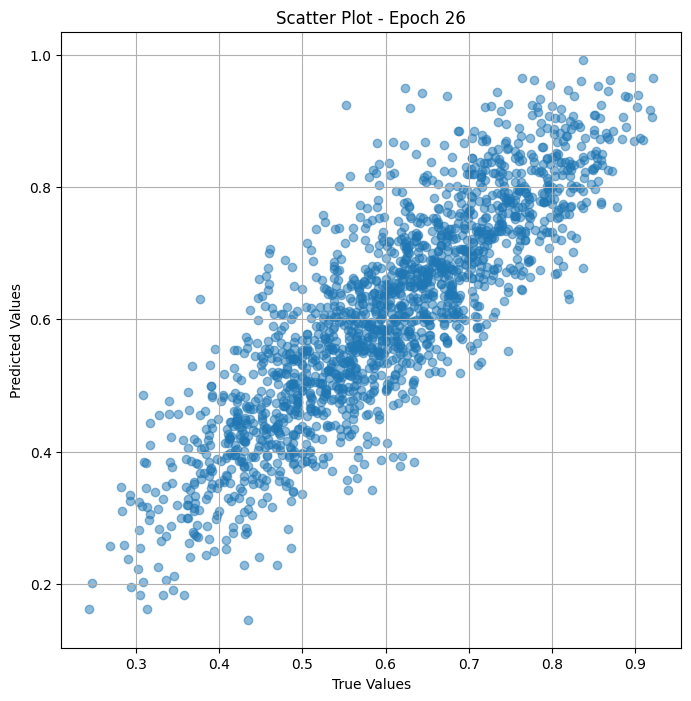


 Epoch: (27/50) Loss = 0.0016990175936371088

 Epoch: (27/50) Loss_rmse = 0.04121914133429527

 Epoch: (27/50) R^2 = 0.898514986038208

 Epoch: (27/50) MAE = 0.039445146918296814

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

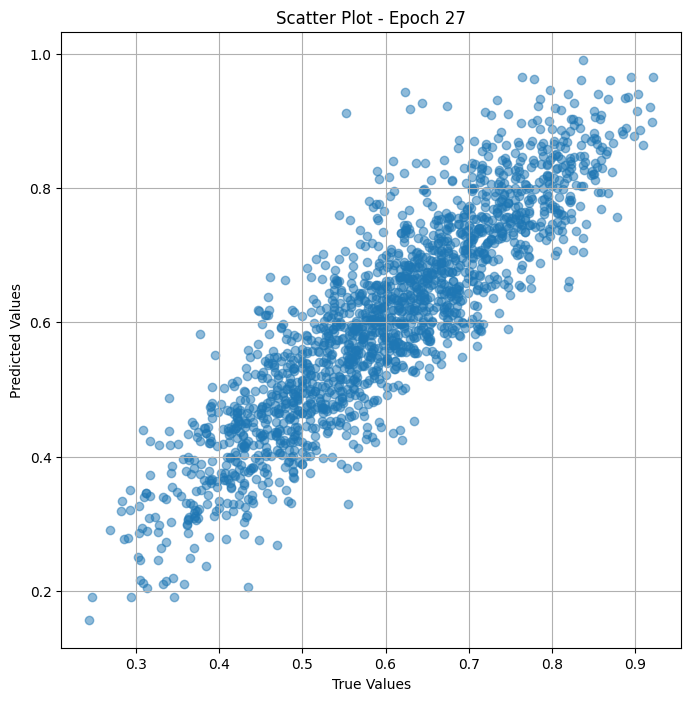


 Epoch: (28/50) Loss = 0.0023298547603189945

 Epoch: (28/50) Loss_rmse = 0.04826856777071953

 Epoch: (28/50) R^2 = 0.8608341217041016

 Epoch: (28/50) MAE = 0.04501324146986008

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

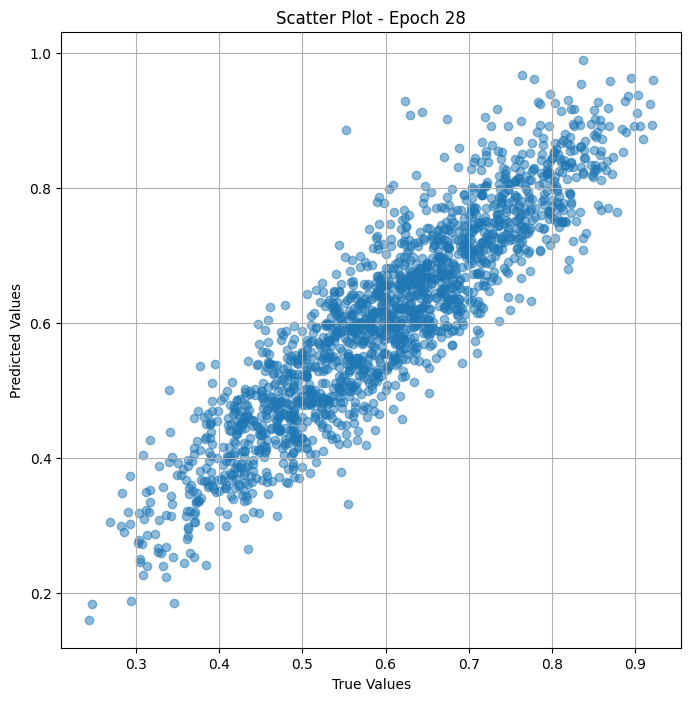


 Epoch: (29/50) Loss = 0.0029327659867703915

 Epoch: (29/50) Loss_rmse = 0.05415501818060875

 Epoch: (29/50) R^2 = 0.8248212337493896

 Epoch: (29/50) MAE = 0.049070876091718674

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

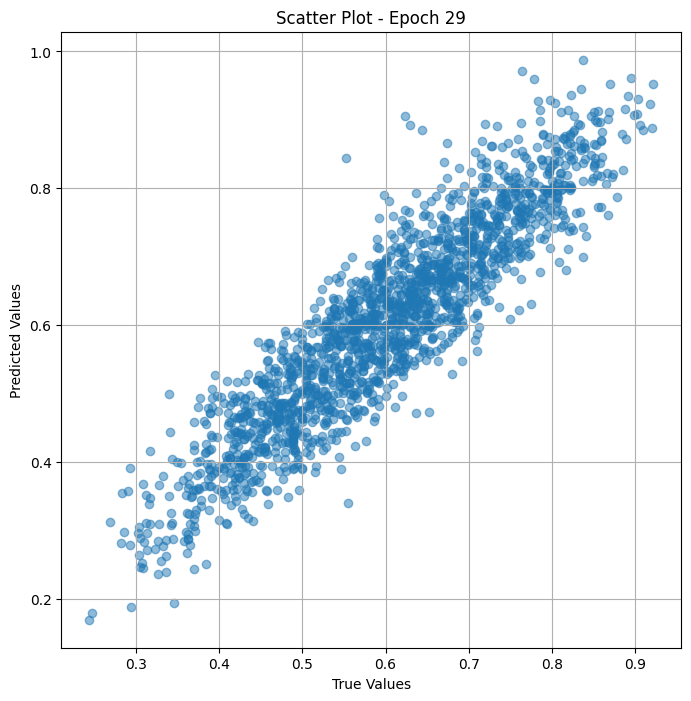


 Epoch: (30/50) Loss = 0.0033999690786004066

 Epoch: (30/50) Loss_rmse = 0.05830925330519676

 Epoch: (30/50) R^2 = 0.7969144582748413

 Epoch: (30/50) MAE = 0.05129946023225784

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

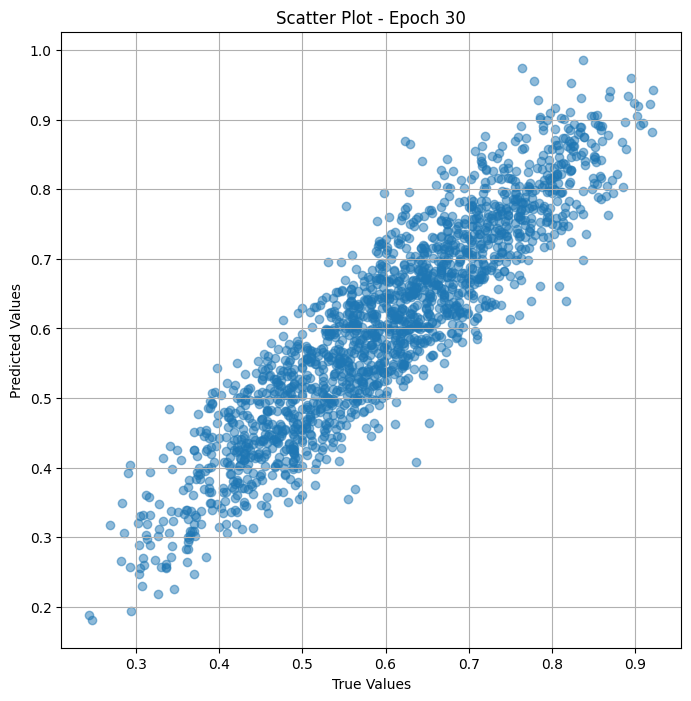


 Epoch: (31/50) Loss = 0.00314539996907115

 Epoch: (31/50) Loss_rmse = 0.05608386546373367

 Epoch: (31/50) R^2 = 0.8121203184127808

 Epoch: (31/50) MAE = 0.048269182443618774

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

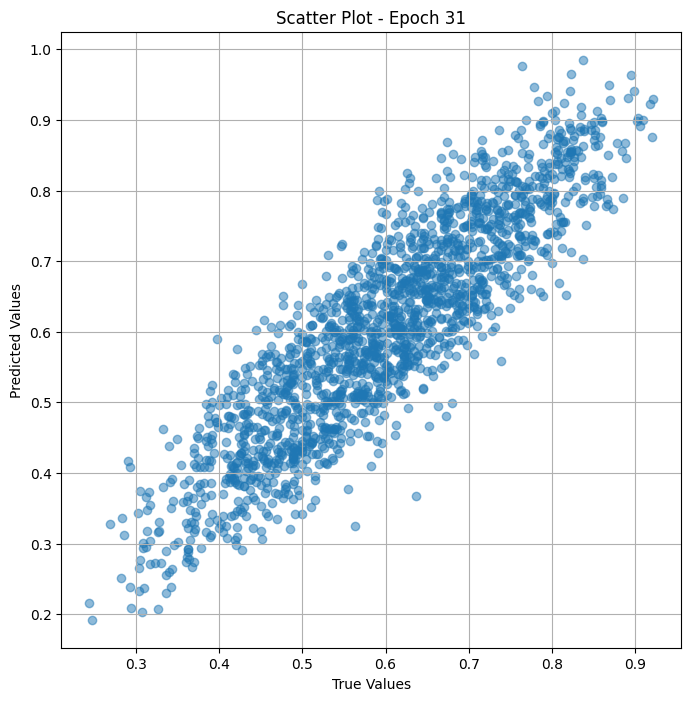


 Epoch: (32/50) Loss = 0.0009990318212658167

 Epoch: (32/50) Loss_rmse = 0.03160746395587921

 Epoch: (32/50) R^2 = 0.9403262734413147

 Epoch: (32/50) MAE = 0.026028964668512344

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

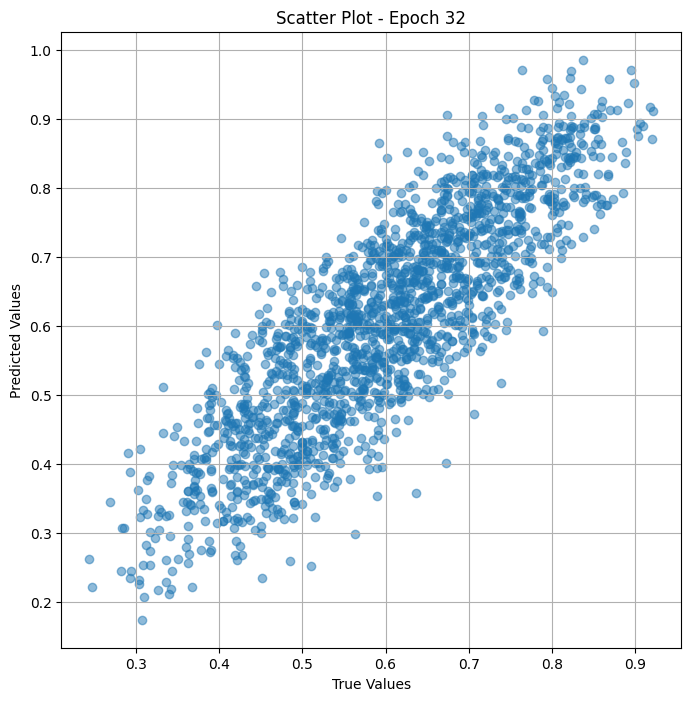


 Epoch: (33/50) Loss = 0.007258584722876549

 Epoch: (33/50) Loss_rmse = 0.0851973295211792

 Epoch: (33/50) R^2 = 0.5664332509040833

 Epoch: (33/50) MAE = 0.08106547594070435

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

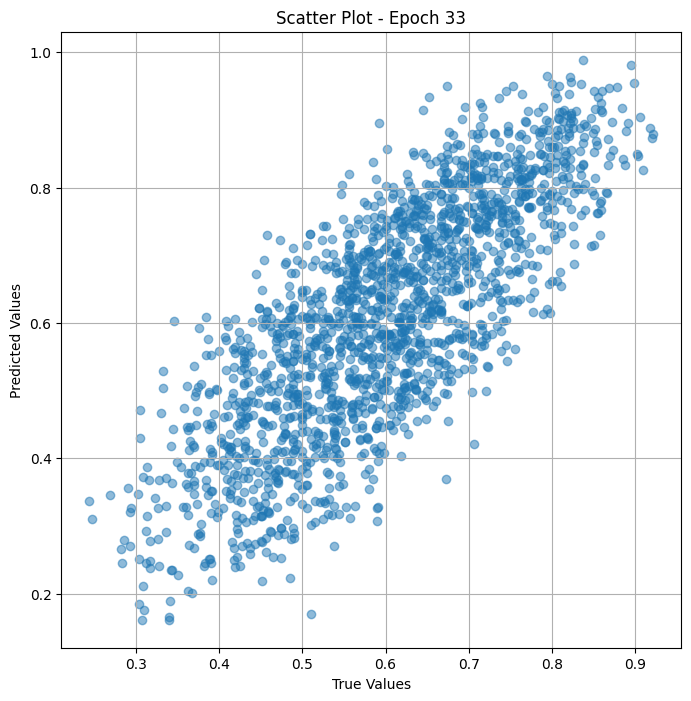


 Epoch: (34/50) Loss = 0.0211336612701416

 Epoch: (34/50) Loss_rmse = 0.14537420868873596

 Epoch: (34/50) R^2 = -0.2623469829559326

 Epoch: (34/50) MAE = 0.13944008946418762

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

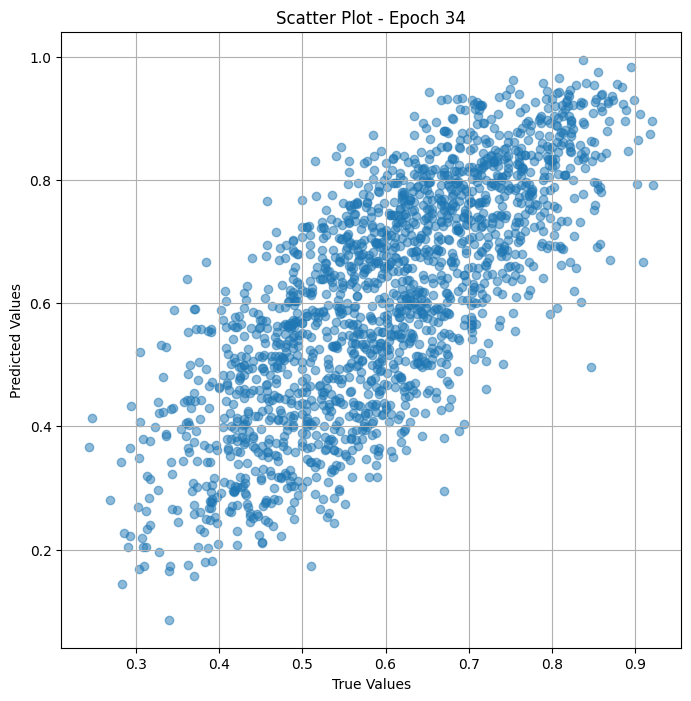


 Epoch: (35/50) Loss = 0.012081374414265156

 Epoch: (35/50) Loss_rmse = 0.10991530865430832

 Epoch: (35/50) R^2 = 0.27836042642593384

 Epoch: (35/50) MAE = 0.0976703092455864

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

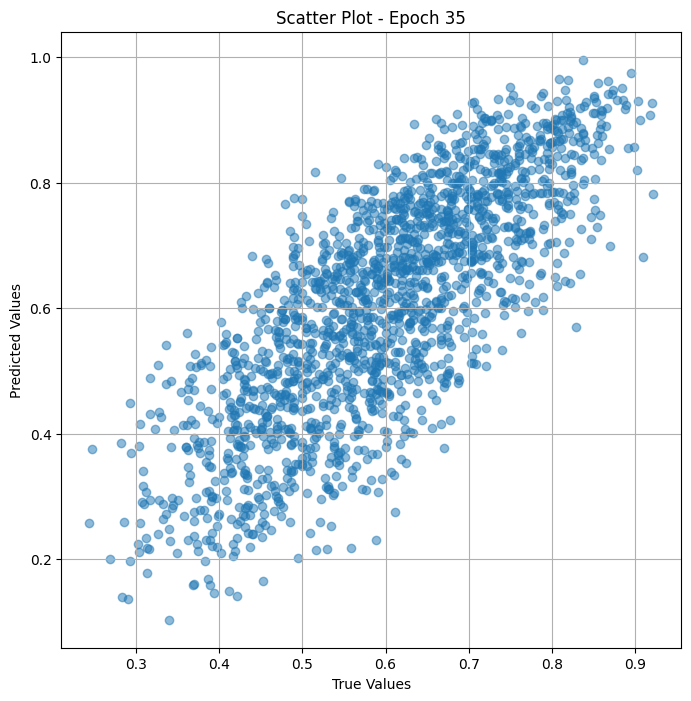


 Epoch: (36/50) Loss = 0.004575265571475029

 Epoch: (36/50) Loss_rmse = 0.06764070689678192

 Epoch: (36/50) R^2 = 0.726712167263031

 Epoch: (36/50) MAE = 0.05548282340168953

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0

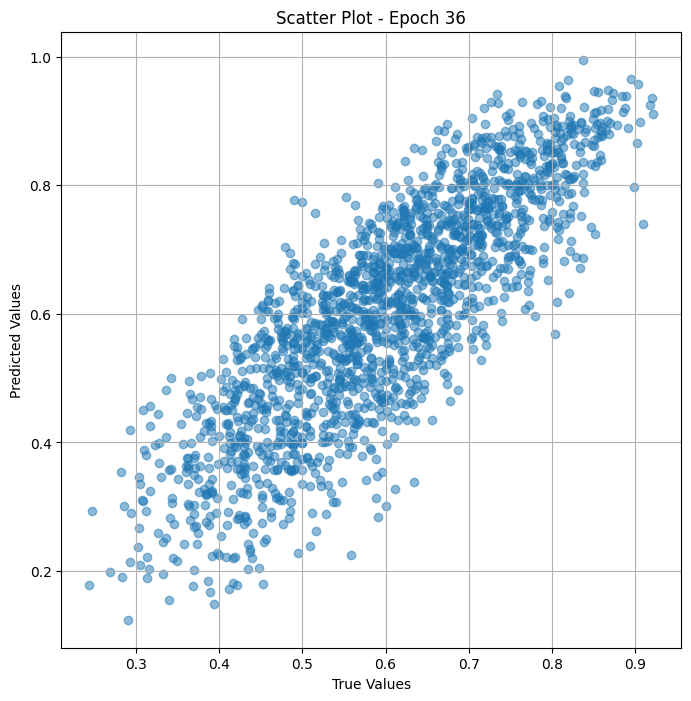


 Epoch: (37/50) Loss = 0.0010122836101800203

 Epoch: (37/50) Loss_rmse = 0.031816404312849045

 Epoch: (37/50) R^2 = 0.9395347237586975

 Epoch: (37/50) MAE = 0.026761364191770554

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

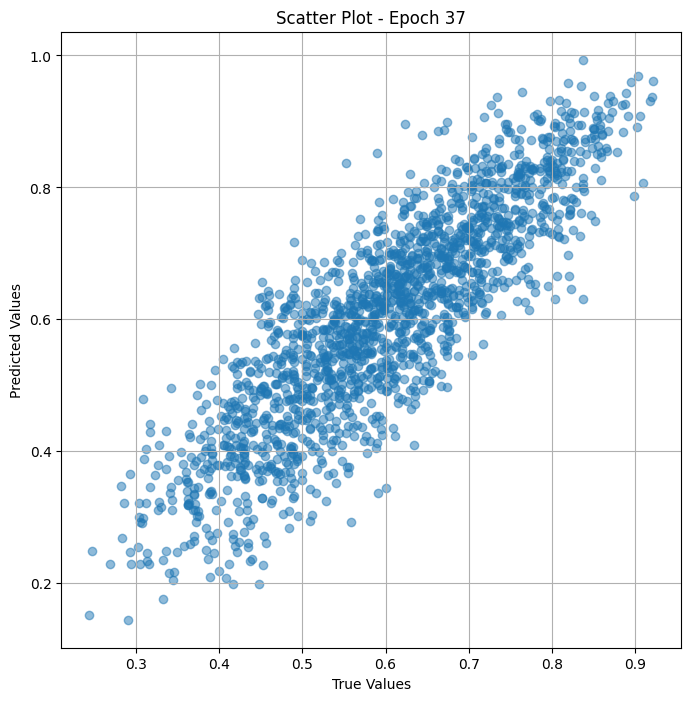


 Epoch: (38/50) Loss = 0.00048177962889894843

 Epoch: (38/50) Loss_rmse = 0.02194947935640812

 Epoch: (38/50) R^2 = 0.9712225198745728

 Epoch: (38/50) MAE = 0.0189213864505291

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

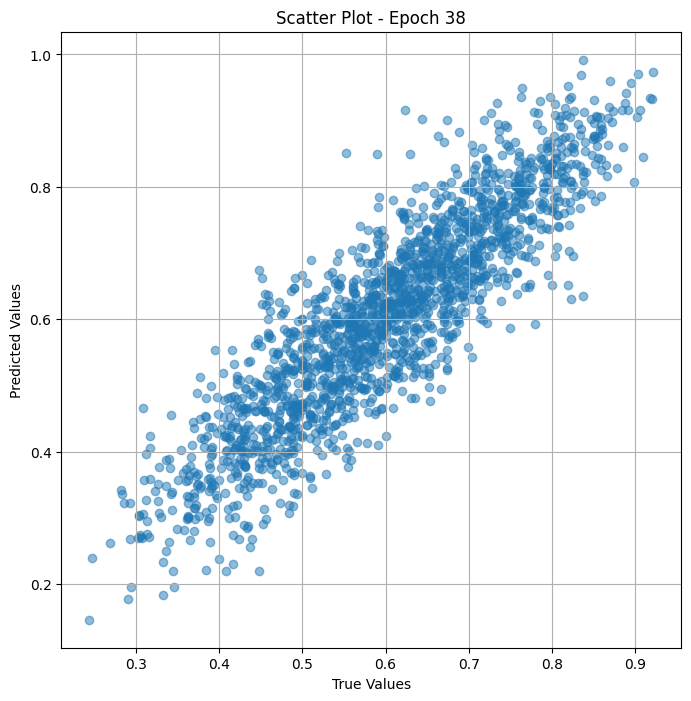


 Epoch: (39/50) Loss = 0.00129604316316545

 Epoch: (39/50) Loss_rmse = 0.03600059822201729

 Epoch: (39/50) R^2 = 0.9225853085517883

 Epoch: (39/50) MAE = 0.030482217669487

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 0.4

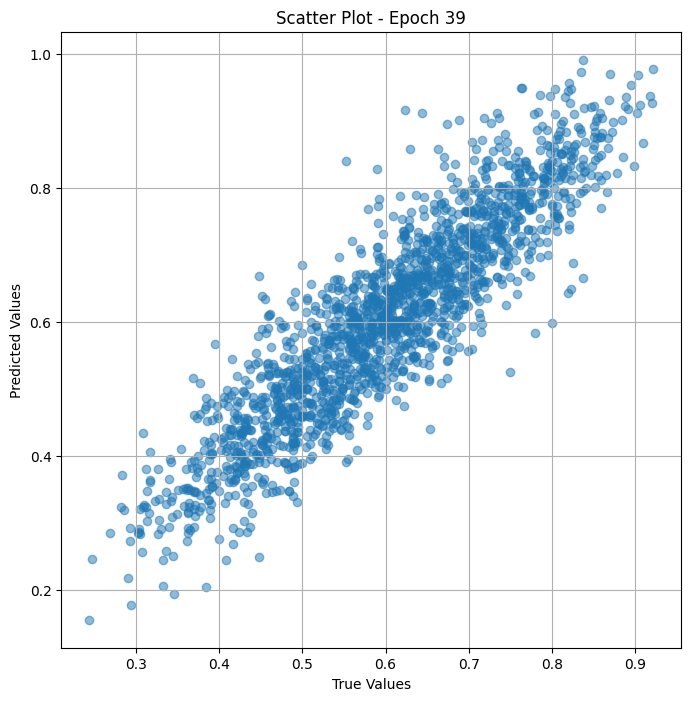


 Epoch: (40/50) Loss = 0.0019182190299034119

 Epoch: (40/50) Loss_rmse = 0.04379747807979584

 Epoch: (40/50) R^2 = 0.8854217529296875

 Epoch: (40/50) MAE = 0.03626110777258873

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

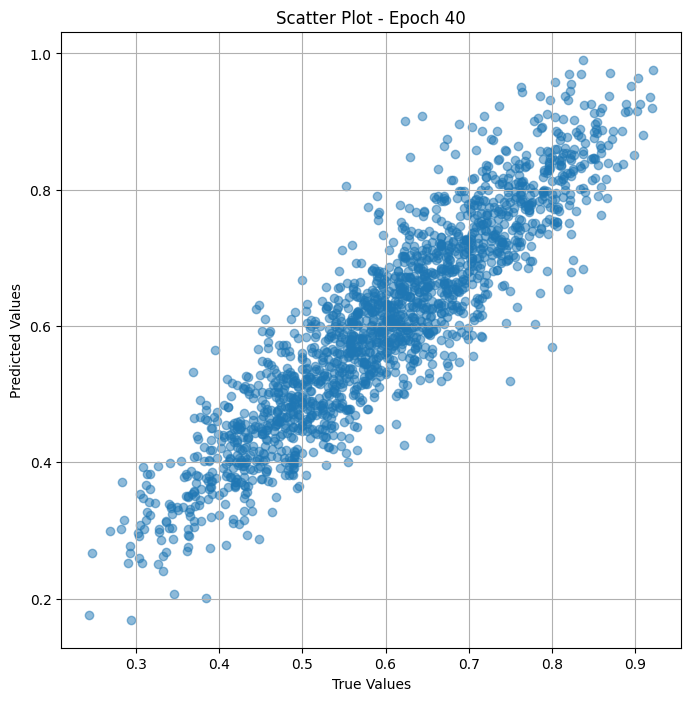


 Epoch: (41/50) Loss = 0.0020038816146552563

 Epoch: (41/50) Loss_rmse = 0.04476473480463028

 Epoch: (41/50) R^2 = 0.8803049921989441

 Epoch: (41/50) MAE = 0.035957928746938705

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315

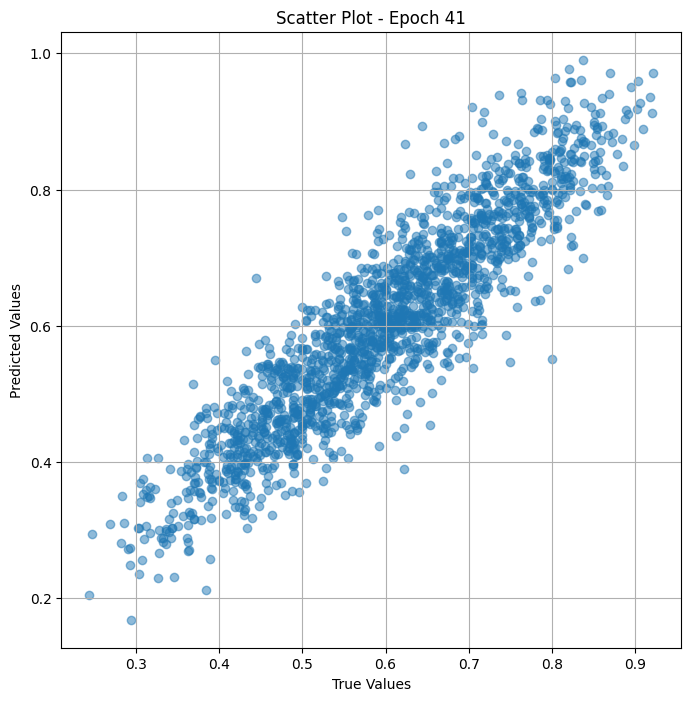


 Epoch: (42/50) Loss = 0.001640701899304986

 Epoch: (42/50) Loss_rmse = 0.04050557687878609

 Epoch: (42/50) R^2 = 0.9019982814788818

 Epoch: (42/50) MAE = 0.03202405944466591

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

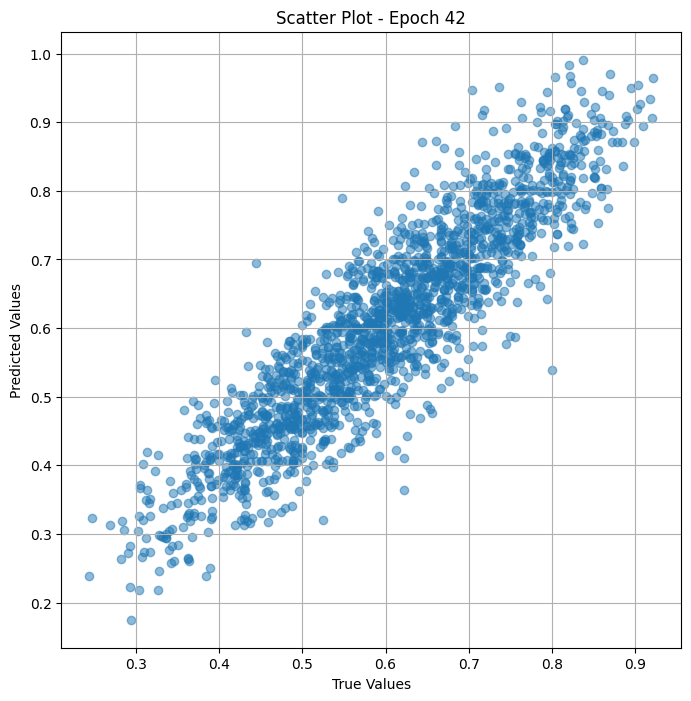


 Epoch: (43/50) Loss = 0.001066552009433508

 Epoch: (43/50) Loss_rmse = 0.032658107578754425

 Epoch: (43/50) R^2 = 0.9362931847572327

 Epoch: (43/50) MAE = 0.02596629410982132

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

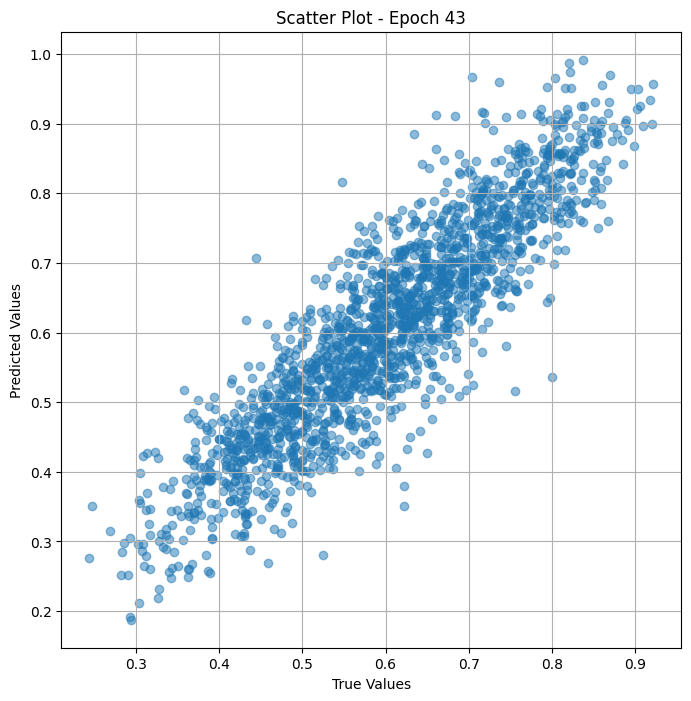


 Epoch: (44/50) Loss = 0.0007868368411436677

 Epoch: (44/50) Loss_rmse = 0.028050612658262253

 Epoch: (44/50) R^2 = 0.9530010223388672

 Epoch: (44/50) MAE = 0.023543626070022583

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.6202531

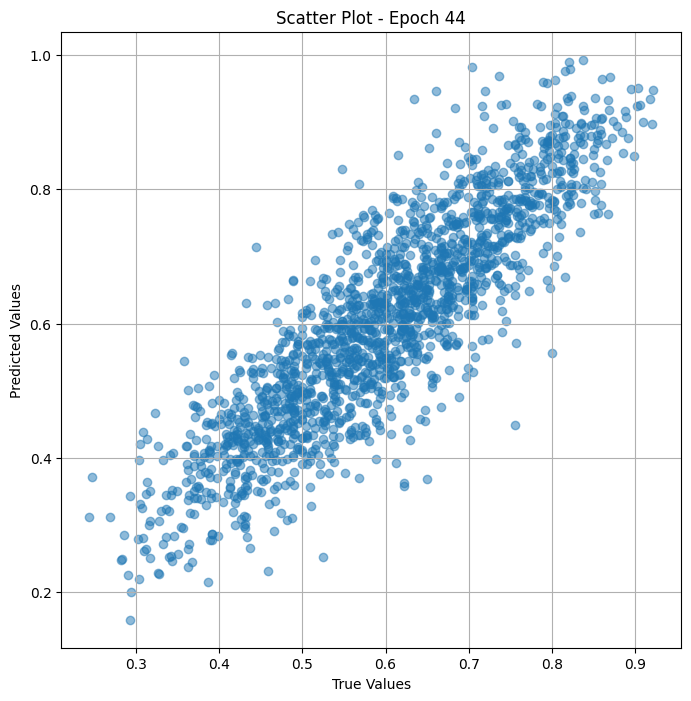


 Epoch: (45/50) Loss = 0.000703647849150002

 Epoch: (45/50) Loss_rmse = 0.02652636170387268

 Epoch: (45/50) R^2 = 0.9579700231552124

 Epoch: (45/50) MAE = 0.02264970913529396

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

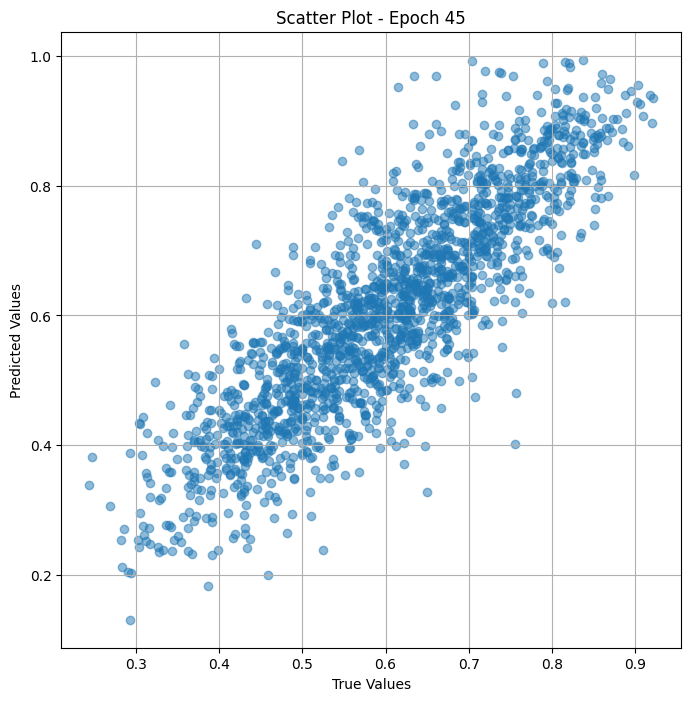


 Epoch: (46/50) Loss = 0.004071321338415146

 Epoch: (46/50) Loss_rmse = 0.06380690634250641

 Epoch: (46/50) R^2 = 0.7568135261535645

 Epoch: (46/50) MAE = 0.057016994804143906

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

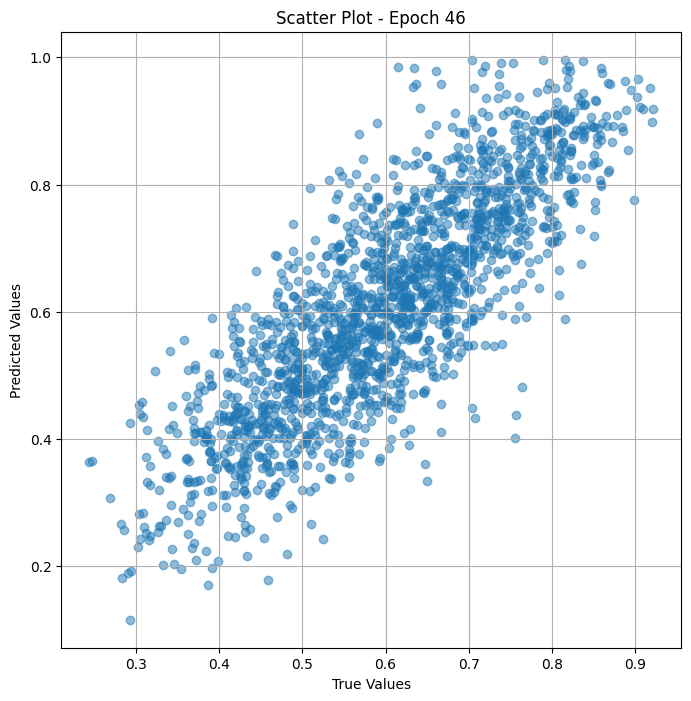


 Epoch: (47/50) Loss = 0.012798700481653214

 Epoch: (47/50) Loss_rmse = 0.11313134431838989

 Epoch: (47/50) R^2 = 0.23551338911056519

 Epoch: (47/50) MAE = 0.09245575964450836

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315,

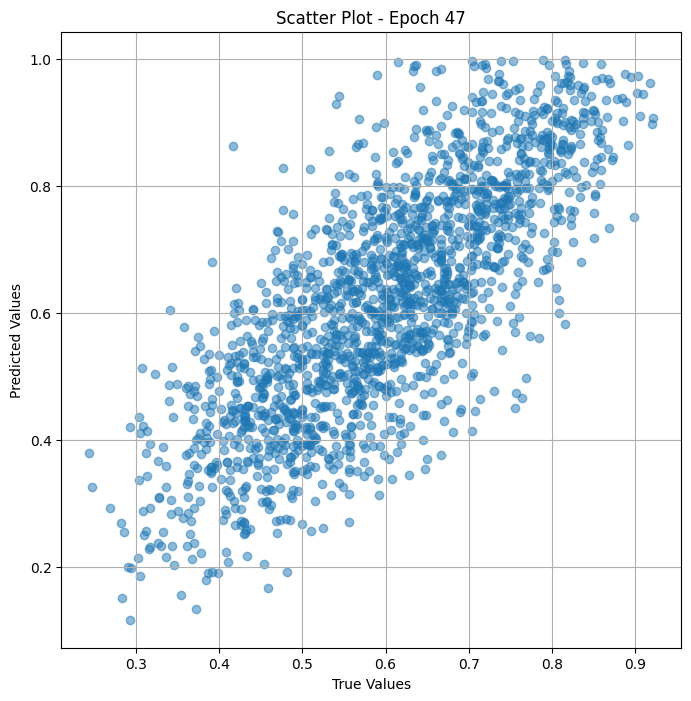


 Epoch: (48/50) Loss = 0.012364214286208153

 Epoch: (48/50) Loss_rmse = 0.11119449138641357

 Epoch: (48/50) R^2 = 0.2614659070968628

 Epoch: (48/50) MAE = 0.08436643332242966

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

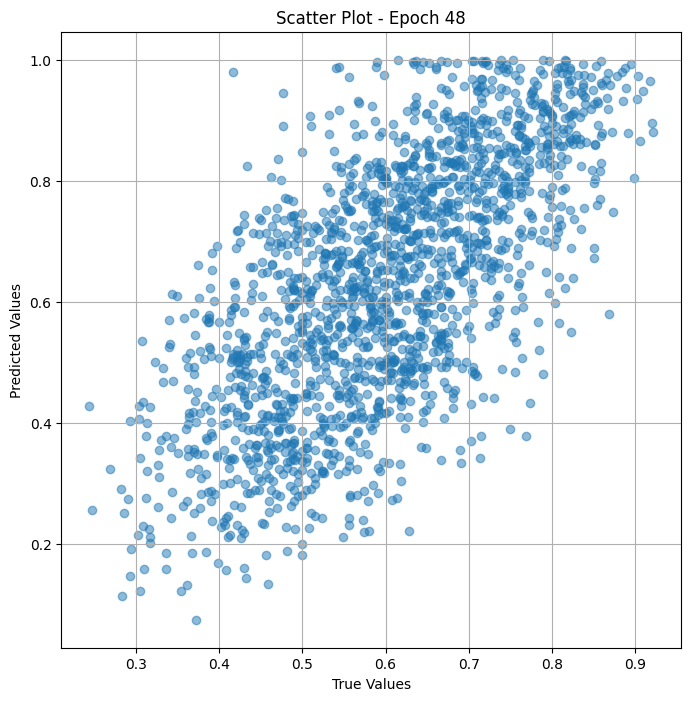


 Epoch: (49/50) Loss = 0.04660093039274216

 Epoch: (49/50) Loss_rmse = 0.21587248146533966

 Epoch: (49/50) R^2 = -1.7835471630096436

 Epoch: (49/50) MAE = 0.20368336141109467

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

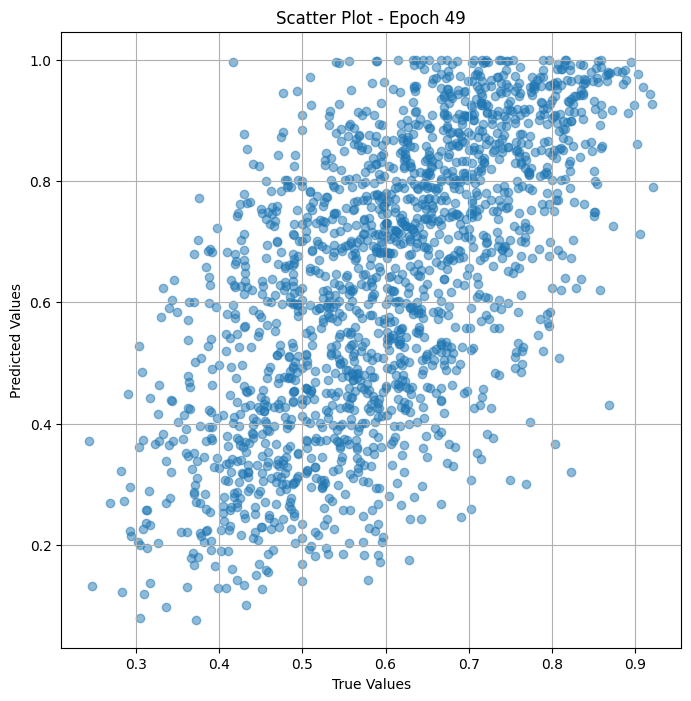


 Epoch: (50/50) Loss = 0.034864529967308044

 Epoch: (50/50) Loss_rmse = 0.18672046065330505

 Epoch: (50/50) R^2 = -1.0825135707855225

 Epoch: (50/50) MAE = 0.1655758172273636

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381, 0.9029126, 0.6632653, 0.6018519, 0.39805827, 0.61165047, 0.42727274, 0.44444445, 0.49056605, 0.5405405, 0.62068963, 0.40860215, 0.4945055, 0.85365856, 0.5154639, 0.63917524, 0.6846847, 0.6185567, 0.62650603, 0.4716981, 0.7358491, 0.44036698, 0.60194176, 0.6179775, 0.72115386, 0.6761905, 0.5670103, 0.6730769, 0.70212764, 0.6037736, 0.47115386, 0.48979592, 0.4375, 0.85046726, 0.85714287, 0.68367344, 0.5208333, 0.8108108, 0.57843137, 0.60714287, 0.4742268, 0.53061223, 0.6730769, 0.6296296, 0.54545456, 0.63829786, 0.52577317, 0.47107437, 0.6981132, 0.4864865, 0.5904762, 0.73636365, 0.42105263, 0.41284403, 0.6216216, 0.74766356, 0.62025315, 

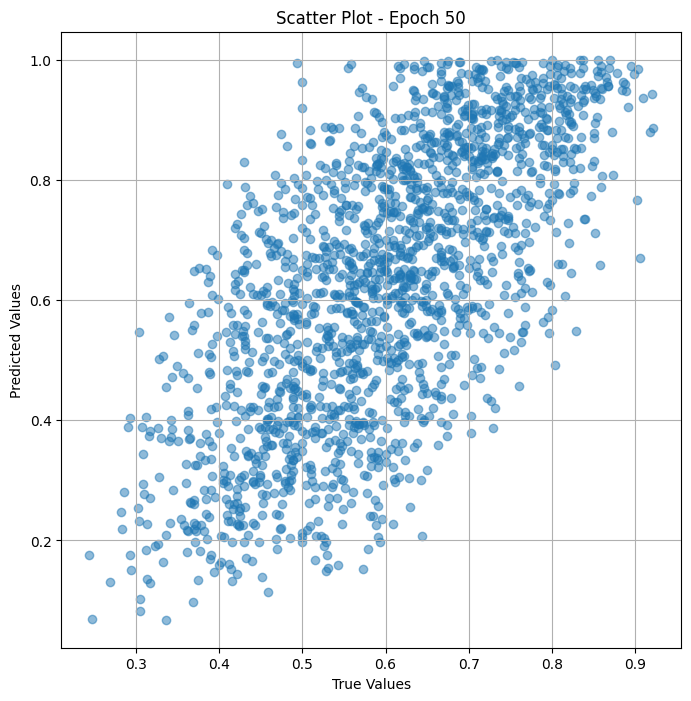

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S_")

In [ ]:
true_values_list = [0.62222224, 0.44642857, 0.56363636, 0.6454545, 0.5, 0.7717391, 0.33653846, 0.5979381]

predicted_values_list = [0.78833276, 0.4706381, 0.72643536, 0.55475897, 0.49622512, 0.33142036, 0.26192954, 0.45159537]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.261904761904762 0.530922861565801


## Valid

In [ ]:
# Merge the two models
class model_merge_fine_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


modelfine_val = model_merge_fine_val(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
modelfine_val = to_device(modelfine_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(modelfine_val.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,modelfine_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        modelfine_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = modelfine_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.13425135612487793

 Epoch: (1/50) Loss_rmse = 0.3664032816886902

 Epoch: (1/50) R^2 = -10.403585433959961

 Epoch: (1/50) MAE = 0.32906264066696167

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

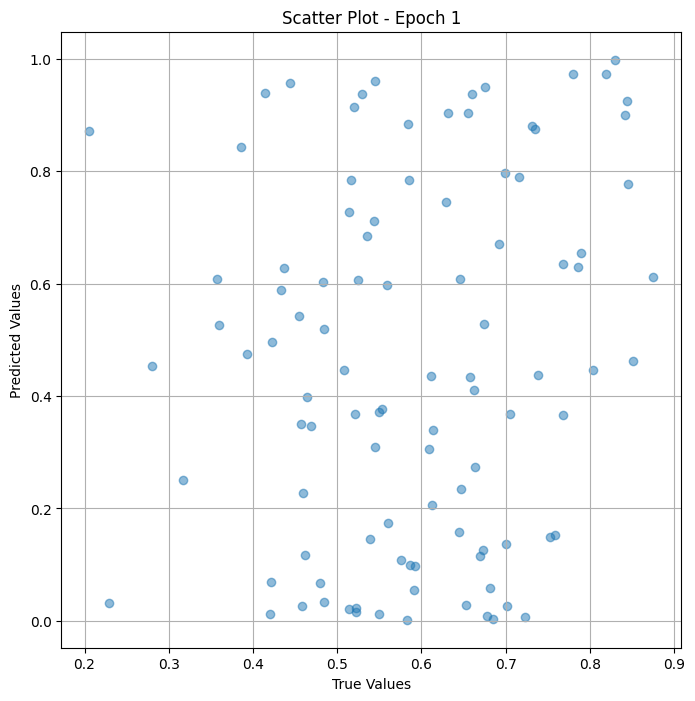


 Epoch: (2/50) Loss = 0.06174271181225777

 Epoch: (2/50) Loss_rmse = 0.24848081171512604

 Epoch: (2/50) R^2 = -4.2445526123046875

 Epoch: (2/50) MAE = 0.23527464270591736

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

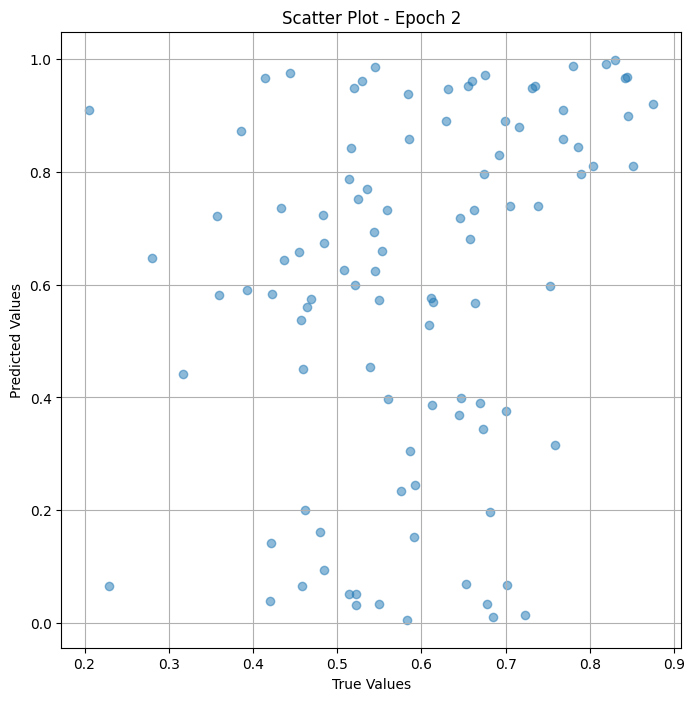


 Epoch: (3/50) Loss = 0.012973751872777939

 Epoch: (3/50) Loss_rmse = 0.11390237510204315

 Epoch: (3/50) R^2 = -0.10201704502105713

 Epoch: (3/50) MAE = 0.09969866275787354

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228813

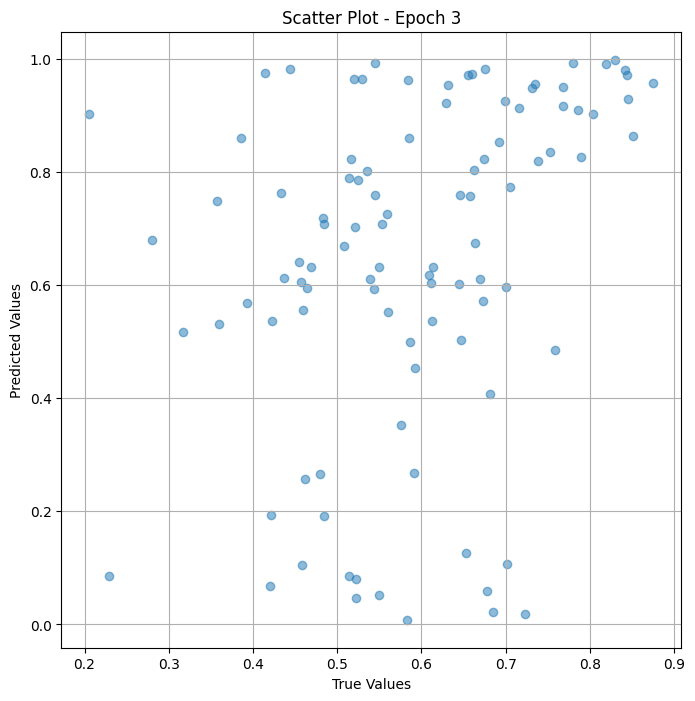


 Epoch: (4/50) Loss = 0.009559444151818752

 Epoch: (4/50) Loss_rmse = 0.09777241200208664

 Epoch: (4/50) R^2 = 0.18800121545791626

 Epoch: (4/50) MAE = 0.07857060432434082

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288135

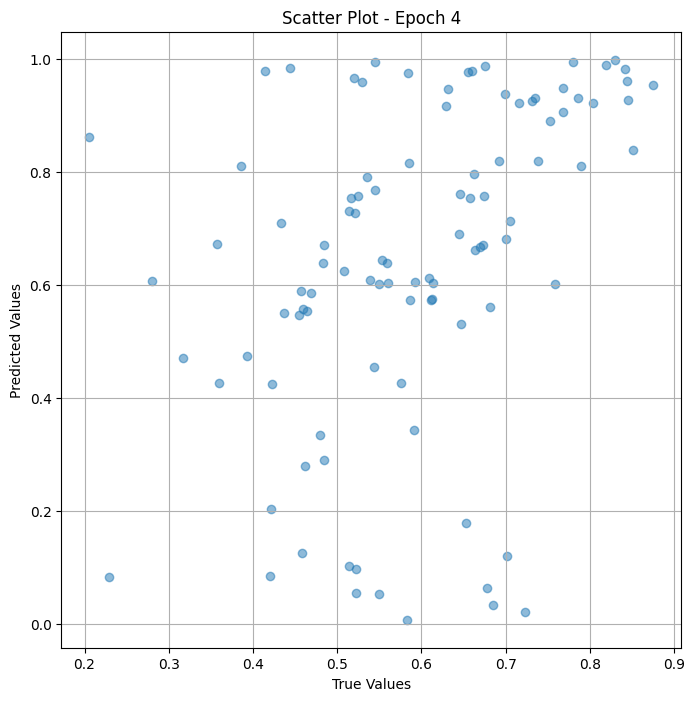


 Epoch: (5/50) Loss = 0.013294071890413761

 Epoch: (5/50) Loss_rmse = 0.11529991775751114

 Epoch: (5/50) R^2 = -0.1292257308959961

 Epoch: (5/50) MAE = 0.10502603650093079

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288135

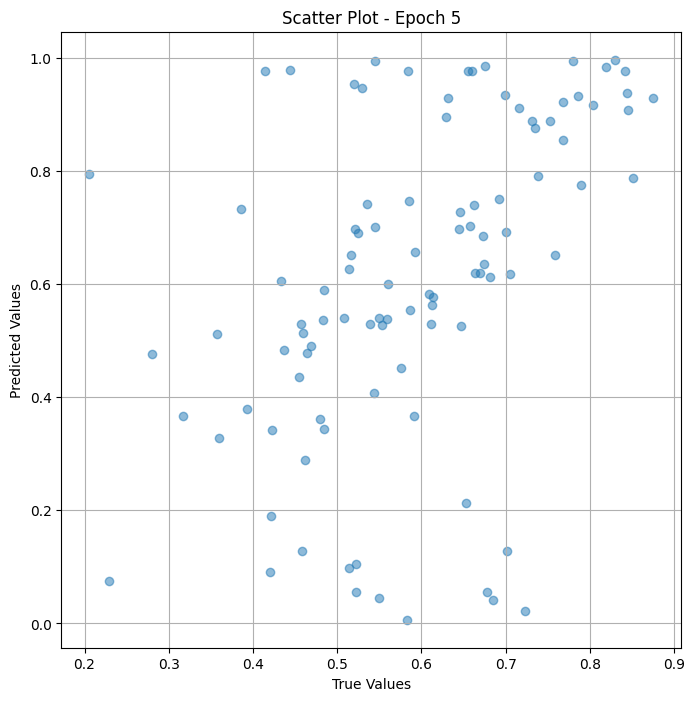


 Epoch: (6/50) Loss = 0.0105216633528471

 Epoch: (6/50) Loss_rmse = 0.1025751605629921

 Epoch: (6/50) R^2 = 0.10626834630966187

 Epoch: (6/50) MAE = 0.09263037890195847

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

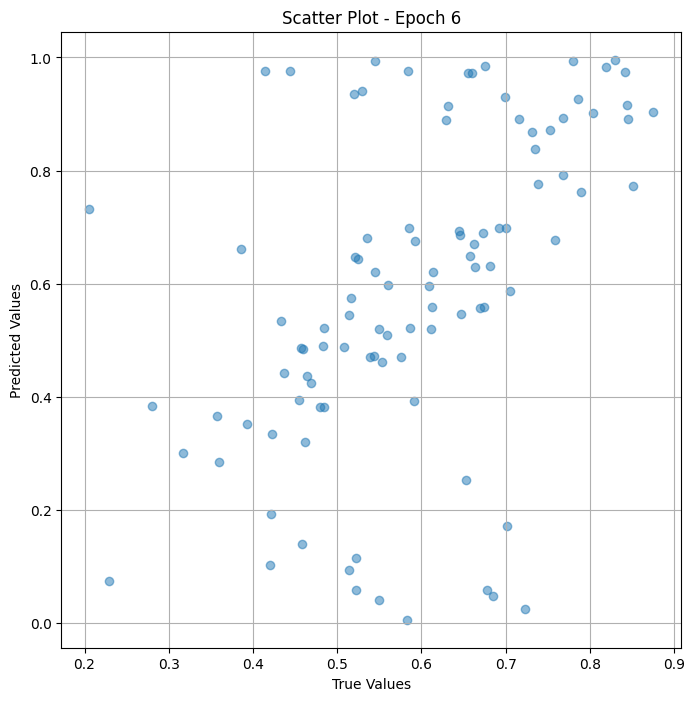


 Epoch: (7/50) Loss = 0.00917782448232174

 Epoch: (7/50) Loss_rmse = 0.0958009660243988

 Epoch: (7/50) R^2 = 0.22041678428649902

 Epoch: (7/50) MAE = 0.0782717615365982

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356, 

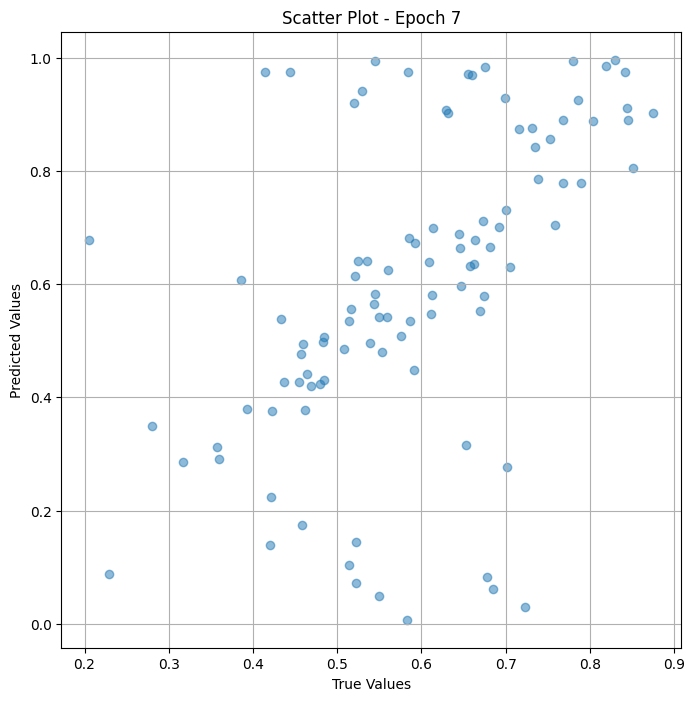


 Epoch: (8/50) Loss = 0.008072956465184689

 Epoch: (8/50) Loss_rmse = 0.08984963595867157

 Epoch: (8/50) R^2 = 0.314266562461853

 Epoch: (8/50) MAE = 0.07008495926856995

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356,

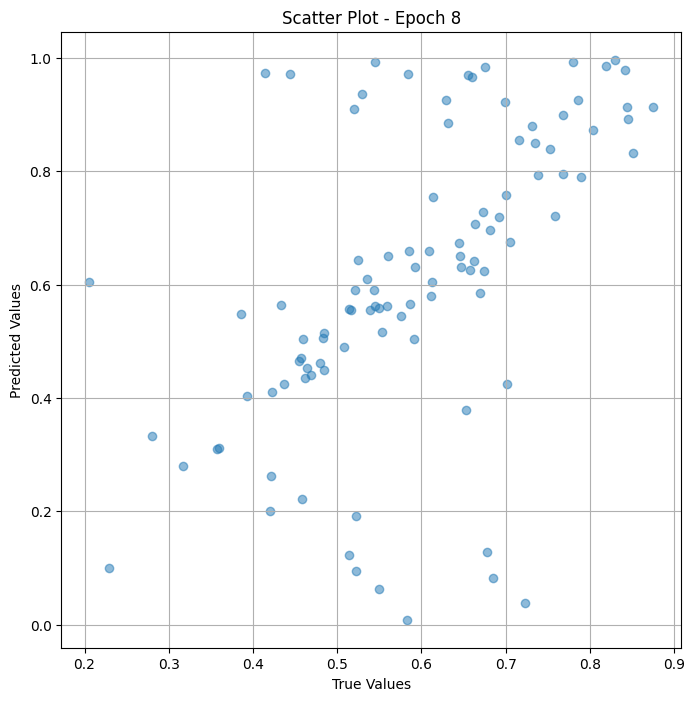


 Epoch: (9/50) Loss = 0.0071660117246210575

 Epoch: (9/50) Loss_rmse = 0.08465229719877243

 Epoch: (9/50) R^2 = 0.39130425453186035

 Epoch: (9/50) MAE = 0.053274005651474

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881356

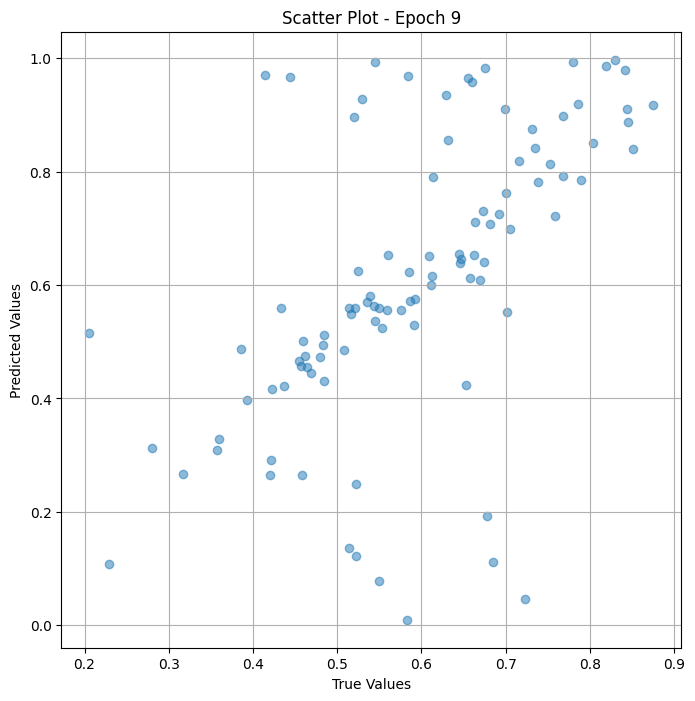


 Epoch: (10/50) Loss = 0.0073616341687738895

 Epoch: (10/50) Loss_rmse = 0.08579996973276138

 Epoch: (10/50) R^2 = 0.37468773126602173

 Epoch: (10/50) MAE = 0.05486676096916199

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

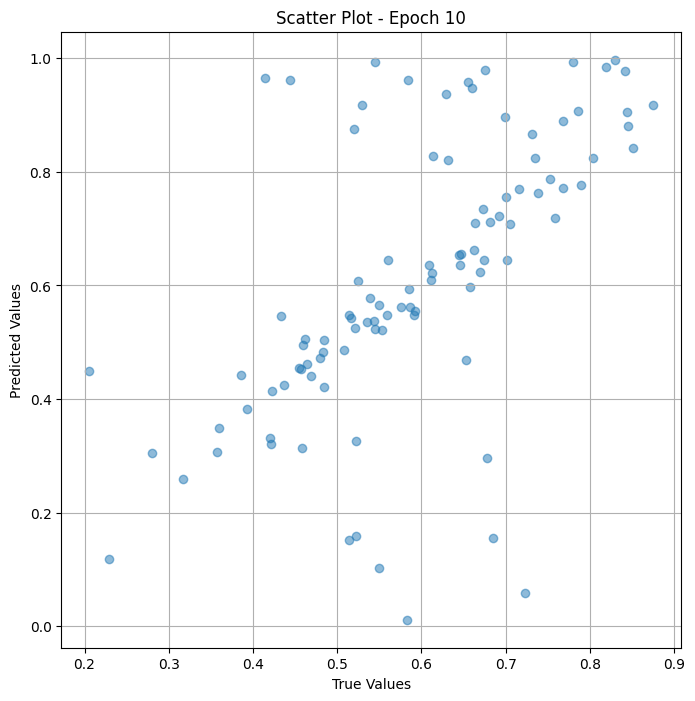


 Epoch: (11/50) Loss = 0.0073470864444971085

 Epoch: (11/50) Loss_rmse = 0.0857151448726654

 Epoch: (11/50) R^2 = 0.37592339515686035

 Epoch: (11/50) MAE = 0.05719563364982605

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

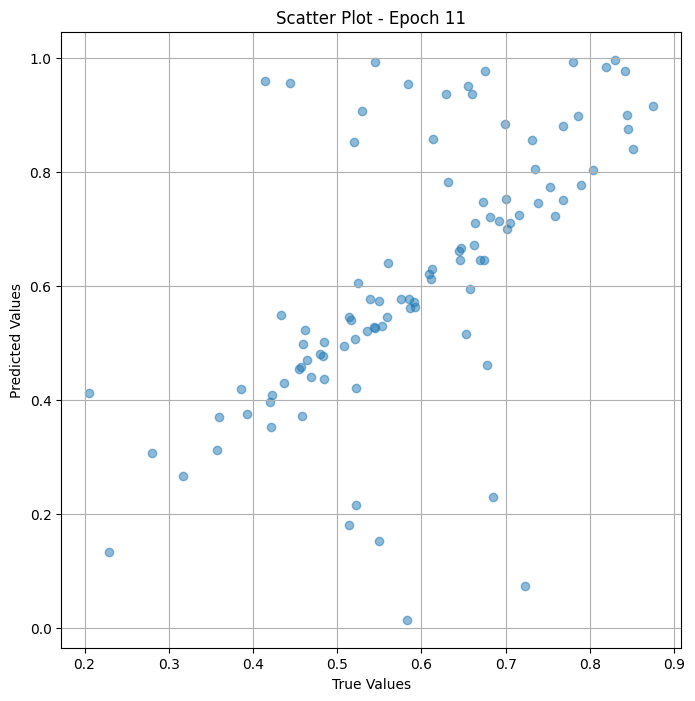


 Epoch: (12/50) Loss = 0.007335869129747152

 Epoch: (12/50) Loss_rmse = 0.08564969152212143

 Epoch: (12/50) R^2 = 0.37687623500823975

 Epoch: (12/50) MAE = 0.057538121938705444

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

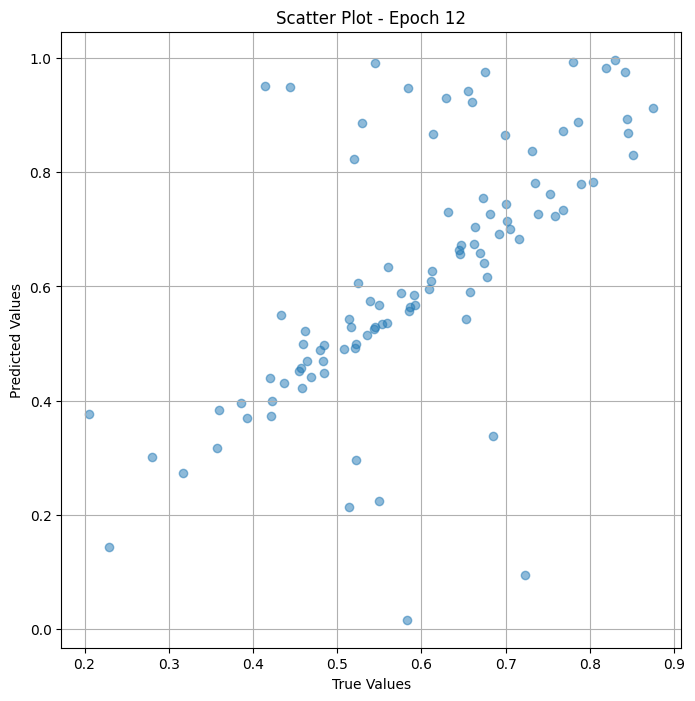


 Epoch: (13/50) Loss = 0.007240199483931065

 Epoch: (13/50) Loss_rmse = 0.08508936315774918

 Epoch: (13/50) R^2 = 0.38500261306762695

 Epoch: (13/50) MAE = 0.05516365170478821

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

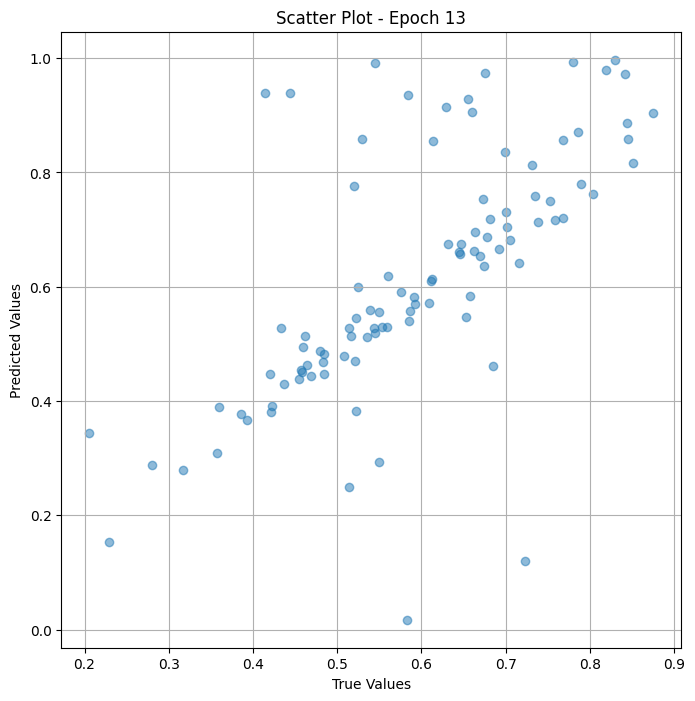


 Epoch: (14/50) Loss = 0.007110612001270056

 Epoch: (14/50) Loss_rmse = 0.0843244418501854

 Epoch: (14/50) R^2 = 0.39601004123687744

 Epoch: (14/50) MAE = 0.05007156729698181

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

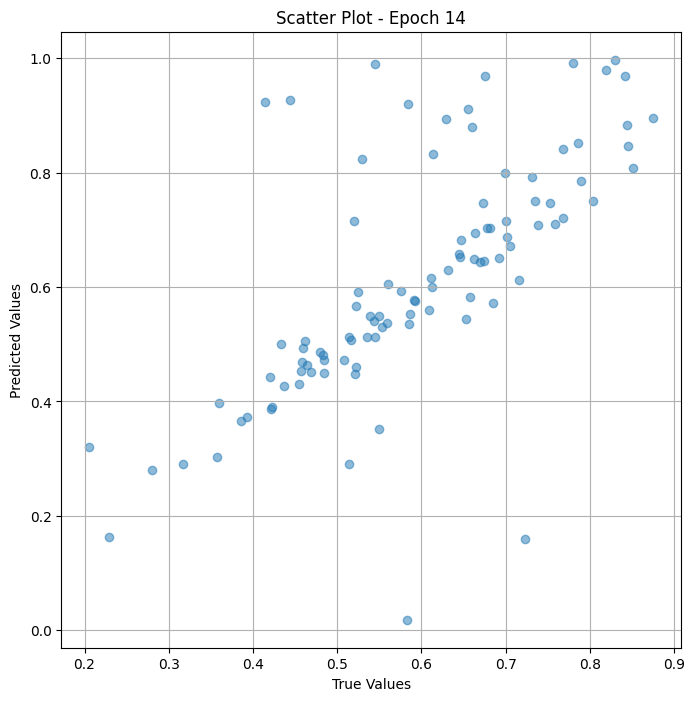


 Epoch: (15/50) Loss = 0.007094912230968475

 Epoch: (15/50) Loss_rmse = 0.08423130214214325

 Epoch: (15/50) R^2 = 0.39734363555908203

 Epoch: (15/50) MAE = 0.04884813725948334

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

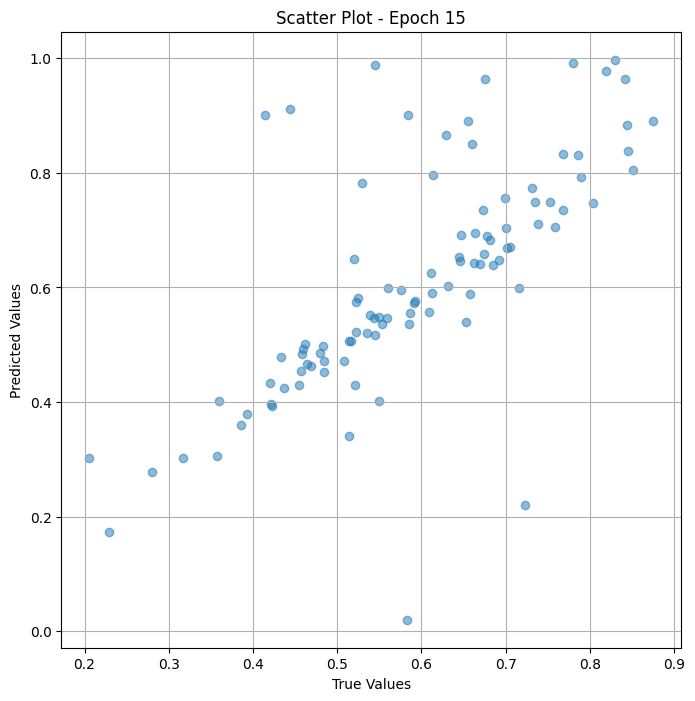


 Epoch: (16/50) Loss = 0.007141738198697567

 Epoch: (16/50) Loss_rmse = 0.08450880646705627

 Epoch: (16/50) R^2 = 0.39336609840393066

 Epoch: (16/50) MAE = 0.04930731654167175

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

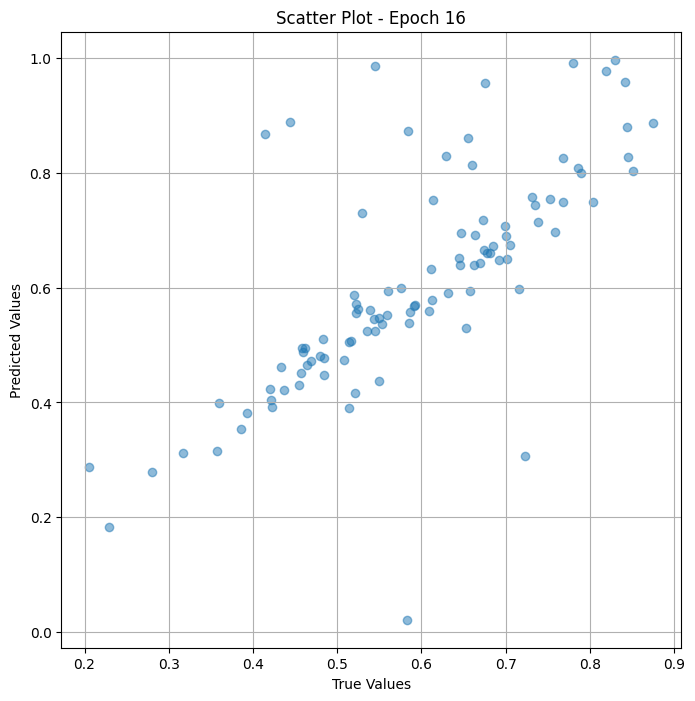


 Epoch: (17/50) Loss = 0.007181966677308083

 Epoch: (17/50) Loss_rmse = 0.08474648743867874

 Epoch: (17/50) R^2 = 0.3899490237236023

 Epoch: (17/50) MAE = 0.04957103729248047

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

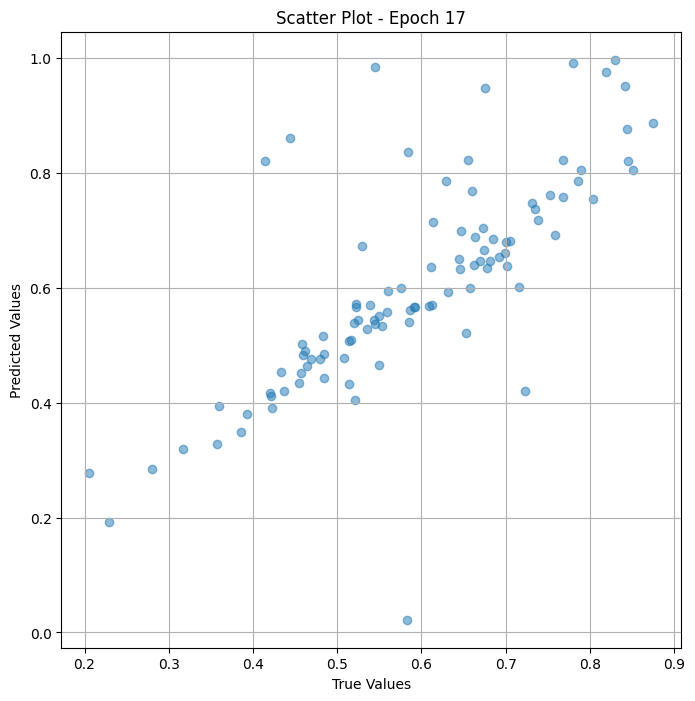


 Epoch: (18/50) Loss = 0.007181751076132059

 Epoch: (18/50) Loss_rmse = 0.08474521338939667

 Epoch: (18/50) R^2 = 0.38996732234954834

 Epoch: (18/50) MAE = 0.04957549273967743

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

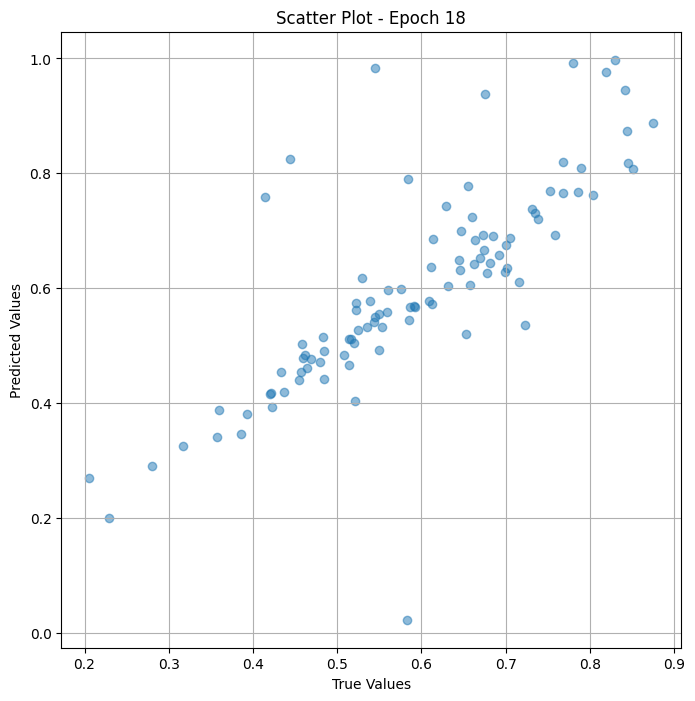


 Epoch: (19/50) Loss = 0.007125933188945055

 Epoch: (19/50) Loss_rmse = 0.0844152420759201

 Epoch: (19/50) R^2 = 0.39470863342285156

 Epoch: (19/50) MAE = 0.04764766991138458

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

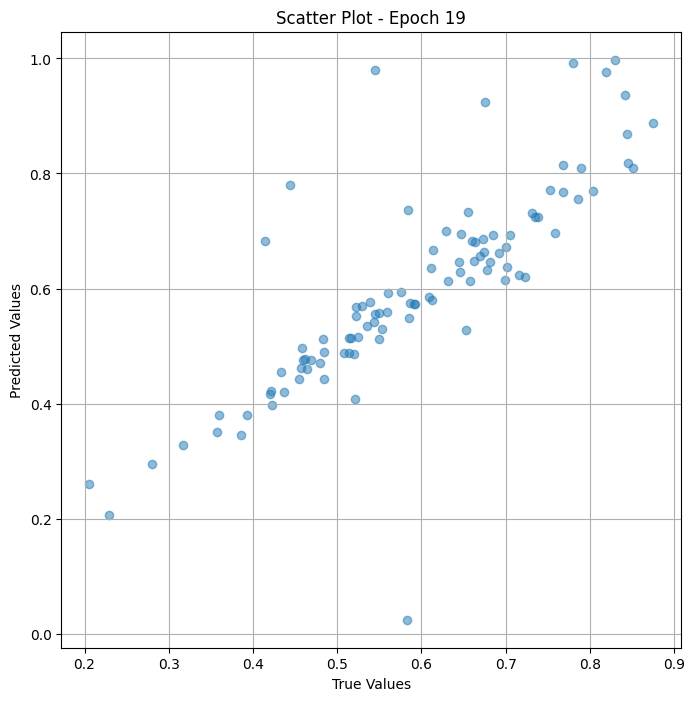


 Epoch: (20/50) Loss = 0.007062269374728203

 Epoch: (20/50) Loss_rmse = 0.08403731137514114

 Epoch: (20/50) R^2 = 0.4001163840293884

 Epoch: (20/50) MAE = 0.04499150812625885

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

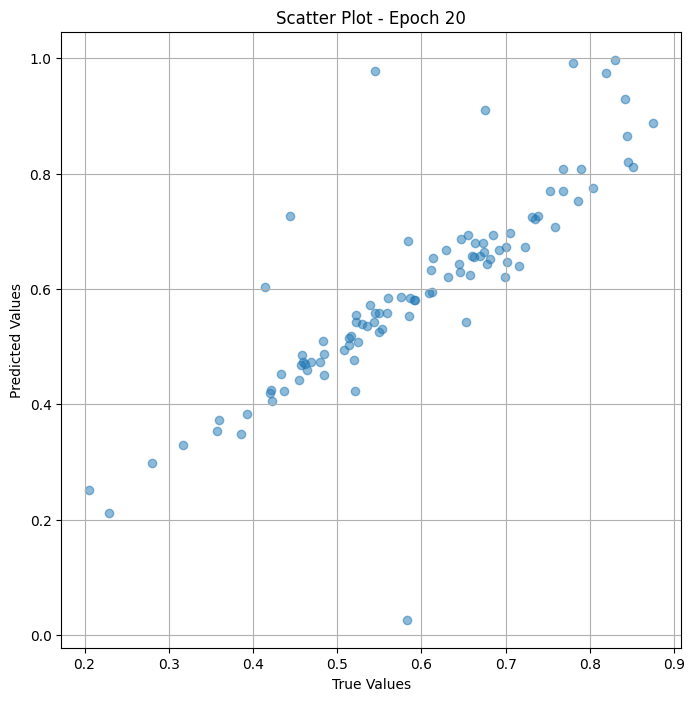


 Epoch: (21/50) Loss = 0.00703378114849329

 Epoch: (21/50) Loss_rmse = 0.0838676393032074

 Epoch: (21/50) R^2 = 0.40253621339797974

 Epoch: (21/50) MAE = 0.044110774993896484

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

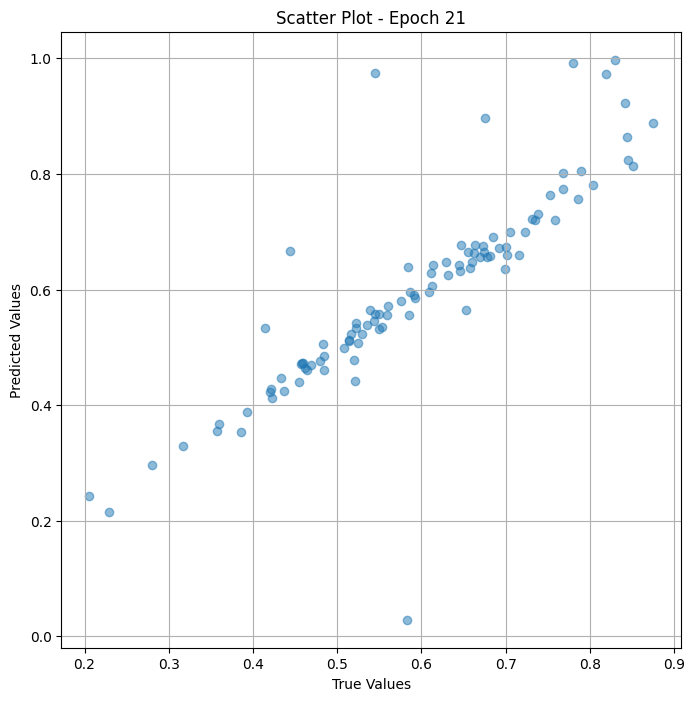


 Epoch: (22/50) Loss = 0.007021152414381504

 Epoch: (22/50) Loss_rmse = 0.0837923139333725

 Epoch: (22/50) R^2 = 0.40360891819000244

 Epoch: (22/50) MAE = 0.04350923001766205

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

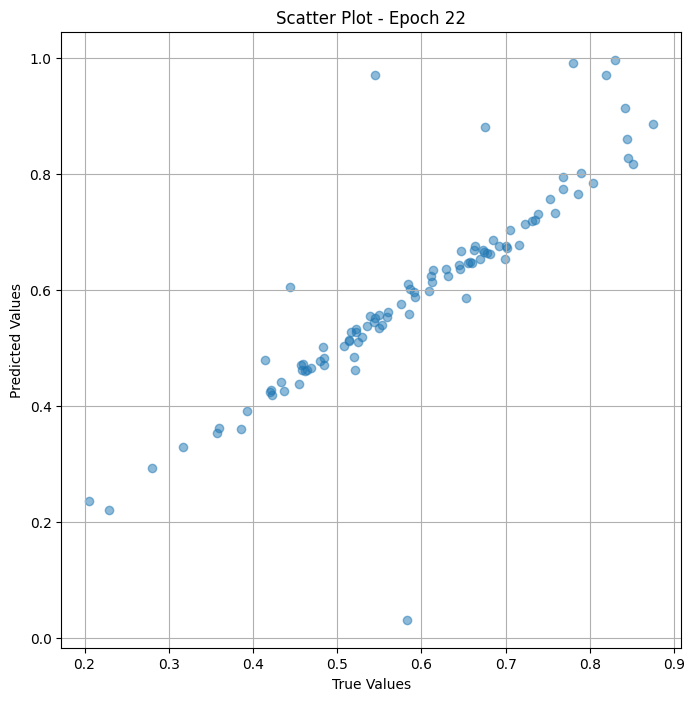


 Epoch: (23/50) Loss = 0.007012847810983658

 Epoch: (23/50) Loss_rmse = 0.08374274522066116

 Epoch: (23/50) R^2 = 0.4043143391609192

 Epoch: (23/50) MAE = 0.04307307302951813

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

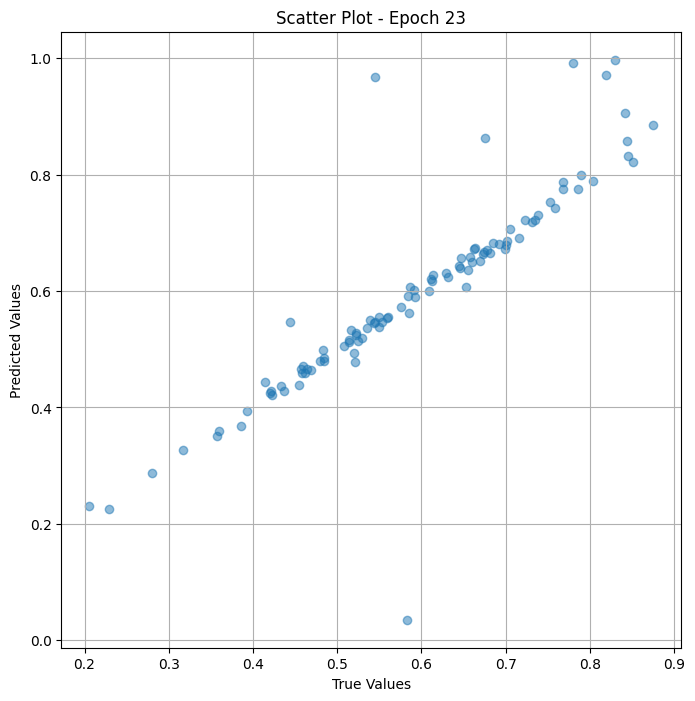


 Epoch: (24/50) Loss = 0.007005585823208094

 Epoch: (24/50) Loss_rmse = 0.08369937539100647

 Epoch: (24/50) R^2 = 0.4049311876296997

 Epoch: (24/50) MAE = 0.04267251491546631

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

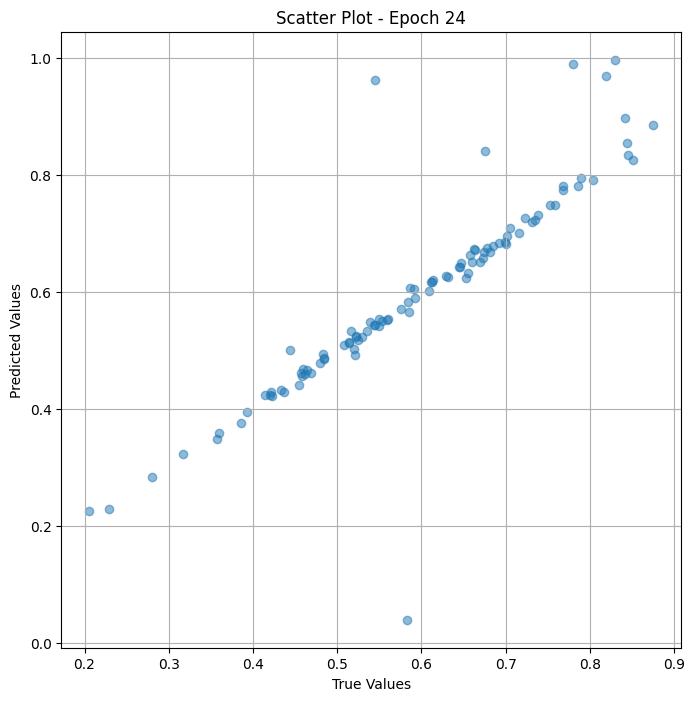


 Epoch: (25/50) Loss = 0.006998813711106777

 Epoch: (25/50) Loss_rmse = 0.08365891128778458

 Epoch: (25/50) R^2 = 0.405506432056427

 Epoch: (25/50) MAE = 0.04262275993824005

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881

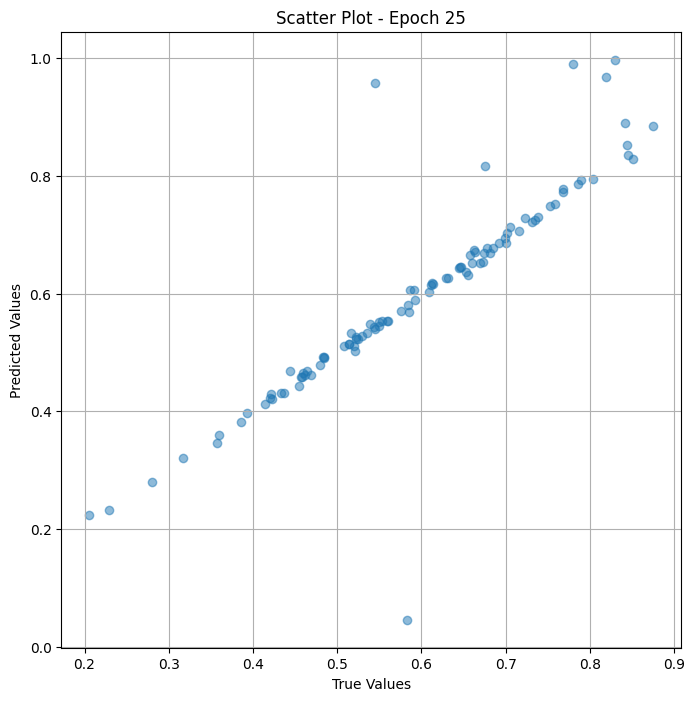


 Epoch: (26/50) Loss = 0.006992128677666187

 Epoch: (26/50) Loss_rmse = 0.08361894637346268

 Epoch: (26/50) R^2 = 0.40607428550720215

 Epoch: (26/50) MAE = 0.042363449931144714

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

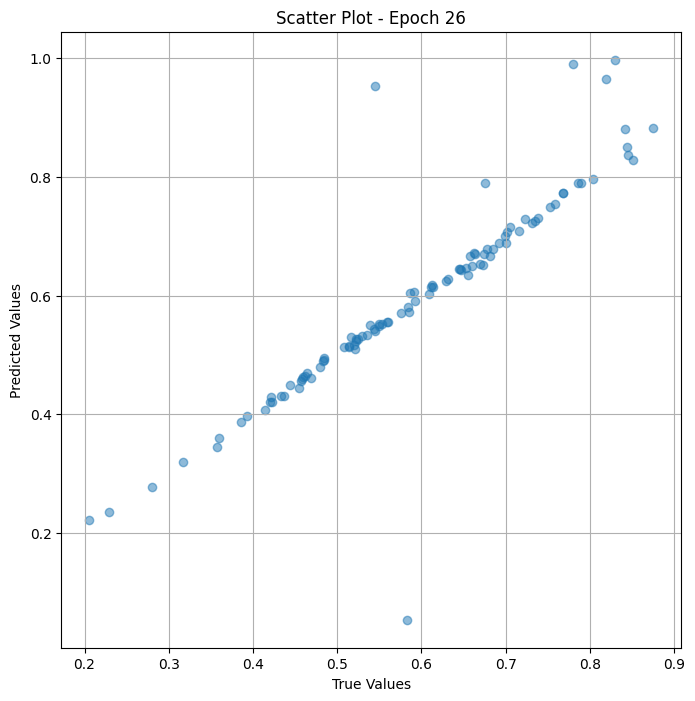


 Epoch: (27/50) Loss = 0.006986255291849375

 Epoch: (27/50) Loss_rmse = 0.08358382433652878

 Epoch: (27/50) R^2 = 0.40657317638397217

 Epoch: (27/50) MAE = 0.04225793480873108

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

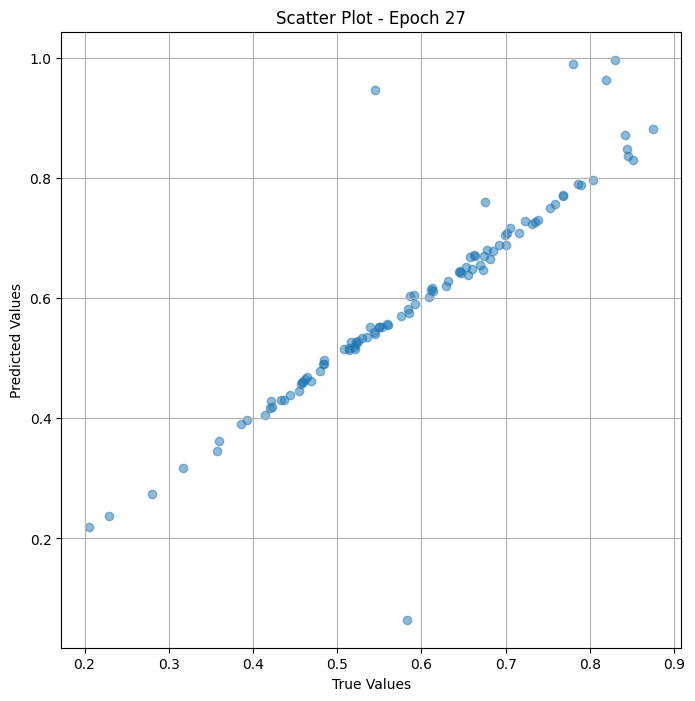


 Epoch: (28/50) Loss = 0.006980986800044775

 Epoch: (28/50) Loss_rmse = 0.0835523009300232

 Epoch: (28/50) R^2 = 0.4070206880569458

 Epoch: (28/50) MAE = 0.042277246713638306

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

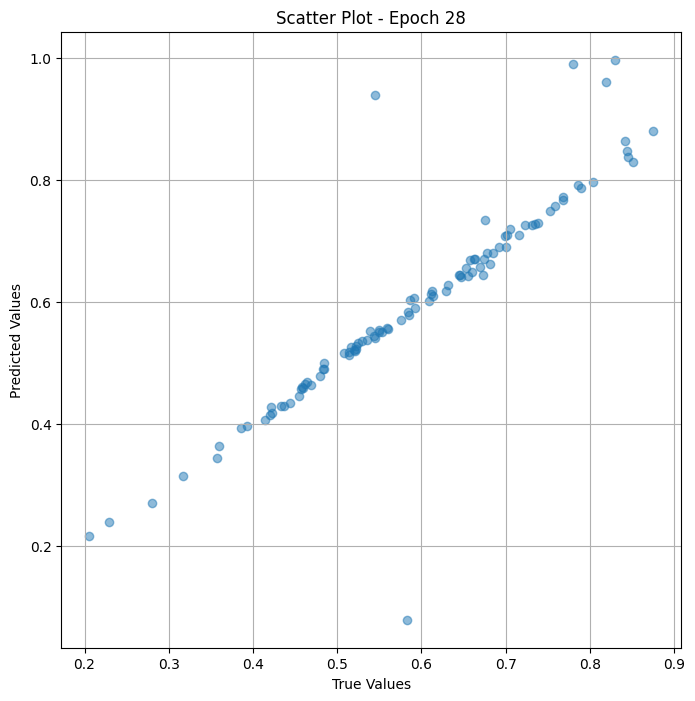


 Epoch: (29/50) Loss = 0.00697628827765584

 Epoch: (29/50) Loss_rmse = 0.0835241749882698

 Epoch: (29/50) R^2 = 0.4074198007583618

 Epoch: (29/50) MAE = 0.042344629764556885

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881

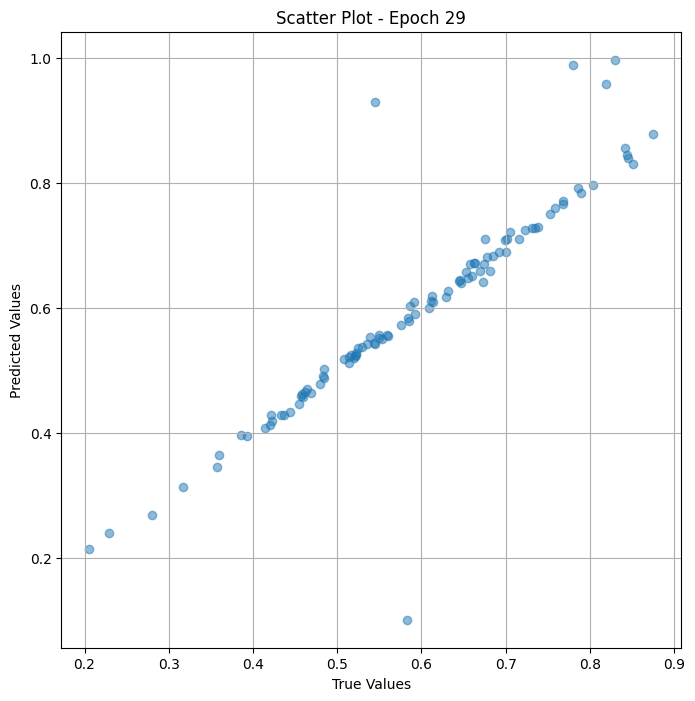


 Epoch: (30/50) Loss = 0.006971935275942087

 Epoch: (30/50) Loss_rmse = 0.08349811285734177

 Epoch: (30/50) R^2 = 0.40778952836990356

 Epoch: (30/50) MAE = 0.04243937134742737

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

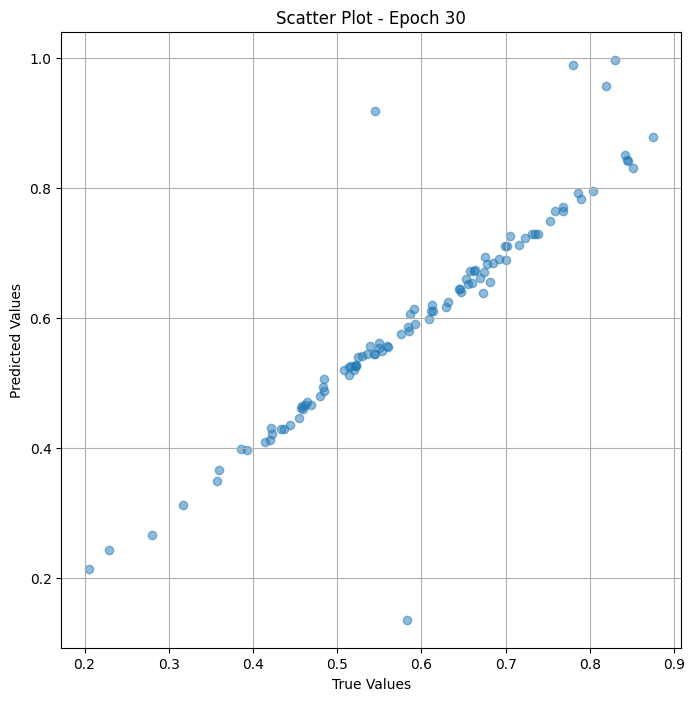


 Epoch: (31/50) Loss = 0.00696756225079298

 Epoch: (31/50) Loss_rmse = 0.08347192406654358

 Epoch: (31/50) R^2 = 0.4081609845161438

 Epoch: (31/50) MAE = 0.042595505714416504

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

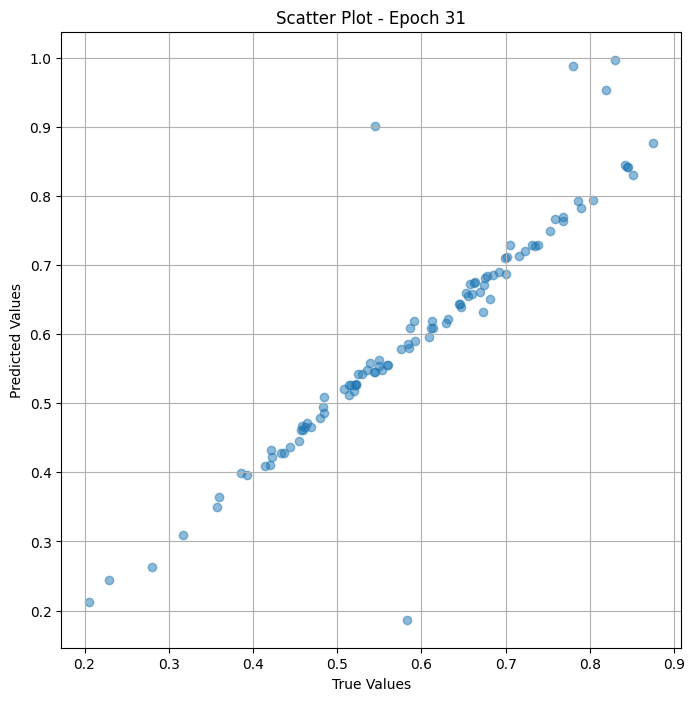


 Epoch: (32/50) Loss = 0.00696180434897542

 Epoch: (32/50) Loss_rmse = 0.08343742787837982

 Epoch: (32/50) R^2 = 0.40865010023117065

 Epoch: (32/50) MAE = 0.04271914064884186

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

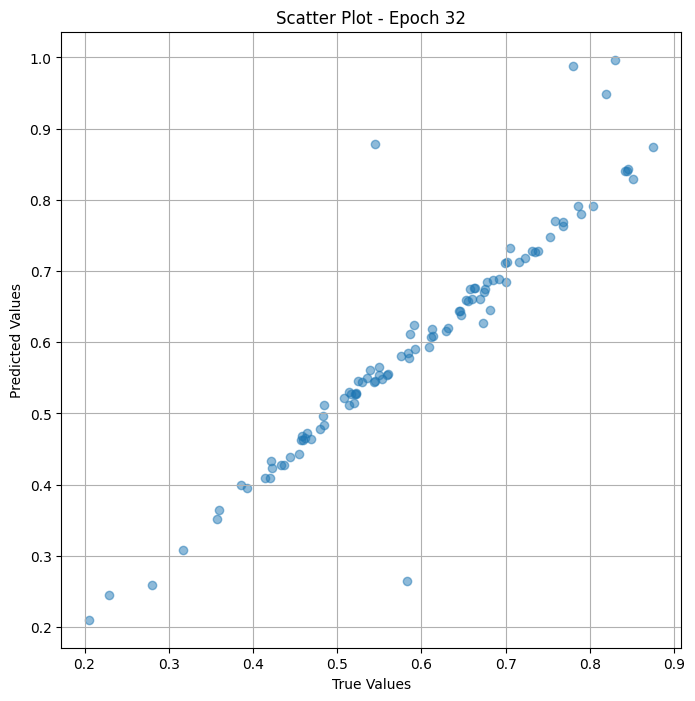


 Epoch: (33/50) Loss = 0.0069532026536762714

 Epoch: (33/50) Loss_rmse = 0.08338586241006851

 Epoch: (33/50) R^2 = 0.4093807339668274

 Epoch: (33/50) MAE = 0.042830780148506165

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

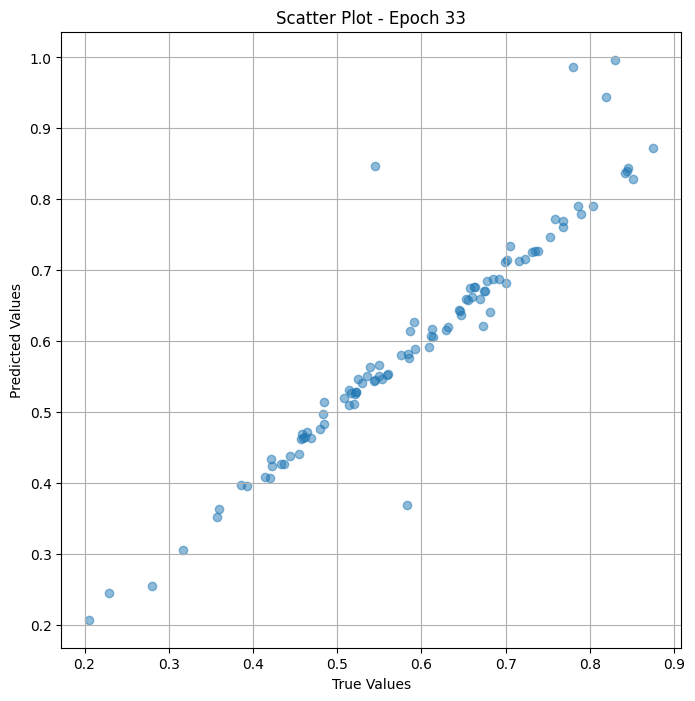


 Epoch: (34/50) Loss = 0.006938811391592026

 Epoch: (34/50) Loss_rmse = 0.08329952508211136

 Epoch: (34/50) R^2 = 0.4106031656265259

 Epoch: (34/50) MAE = 0.04311943054199219

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

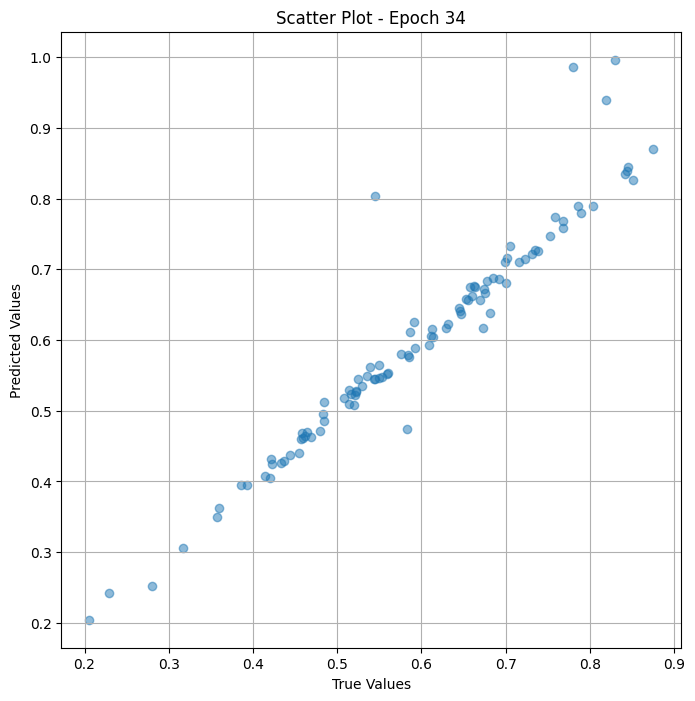


 Epoch: (35/50) Loss = 0.006922498811036348

 Epoch: (35/50) Loss_rmse = 0.08320155739784241

 Epoch: (35/50) R^2 = 0.4119887948036194

 Epoch: (35/50) MAE = 0.043320104479789734

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

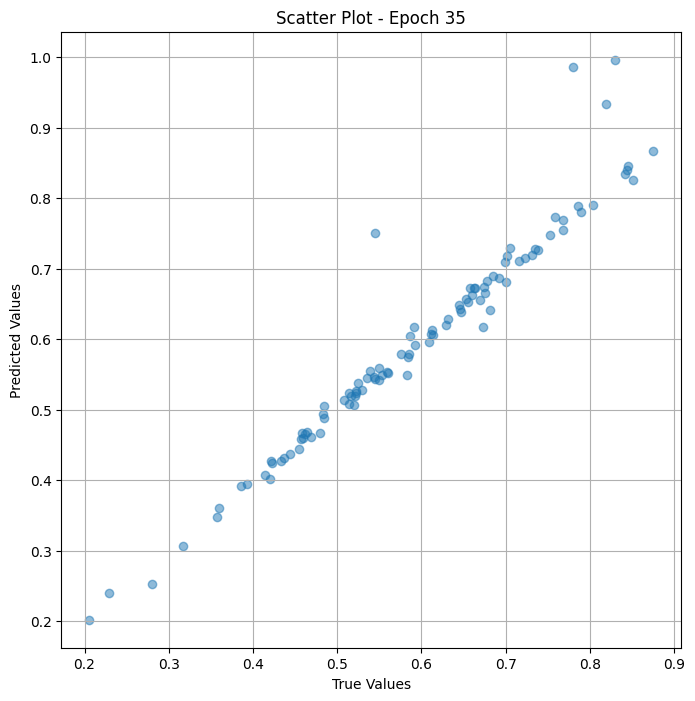


 Epoch: (36/50) Loss = 0.006903941743075848

 Epoch: (36/50) Loss_rmse = 0.08308996260166168

 Epoch: (36/50) R^2 = 0.4135650396347046

 Epoch: (36/50) MAE = 0.04334692656993866

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

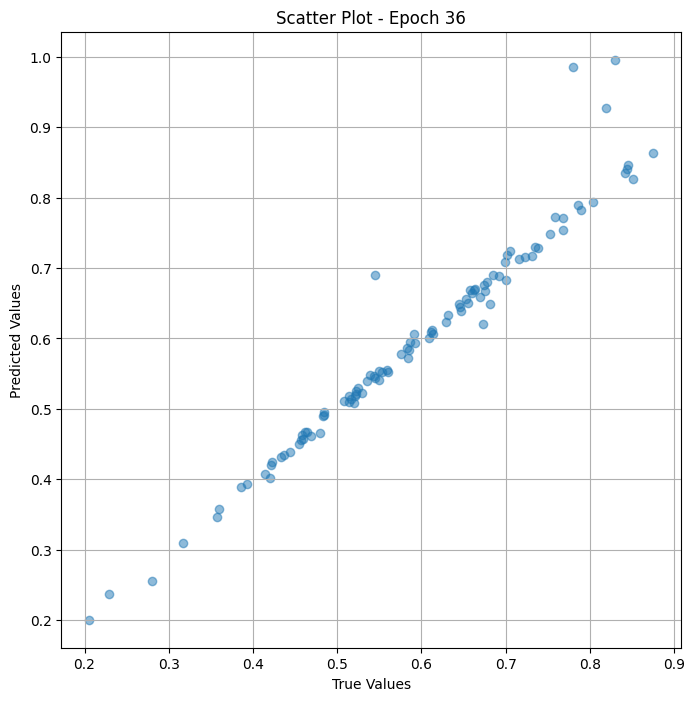


 Epoch: (37/50) Loss = 0.006881102453917265

 Epoch: (37/50) Loss_rmse = 0.08295240998268127

 Epoch: (37/50) R^2 = 0.415505051612854

 Epoch: (37/50) MAE = 0.042515188455581665

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

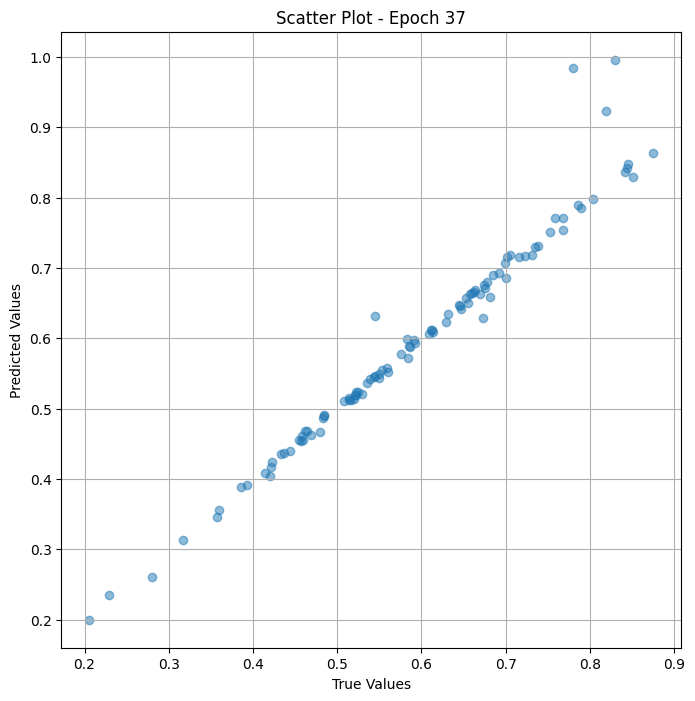


 Epoch: (38/50) Loss = 0.006858767941594124

 Epoch: (38/50) Loss_rmse = 0.0828176811337471

 Epoch: (38/50) R^2 = 0.4174022078514099

 Epoch: (38/50) MAE = 0.04163341224193573

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22881

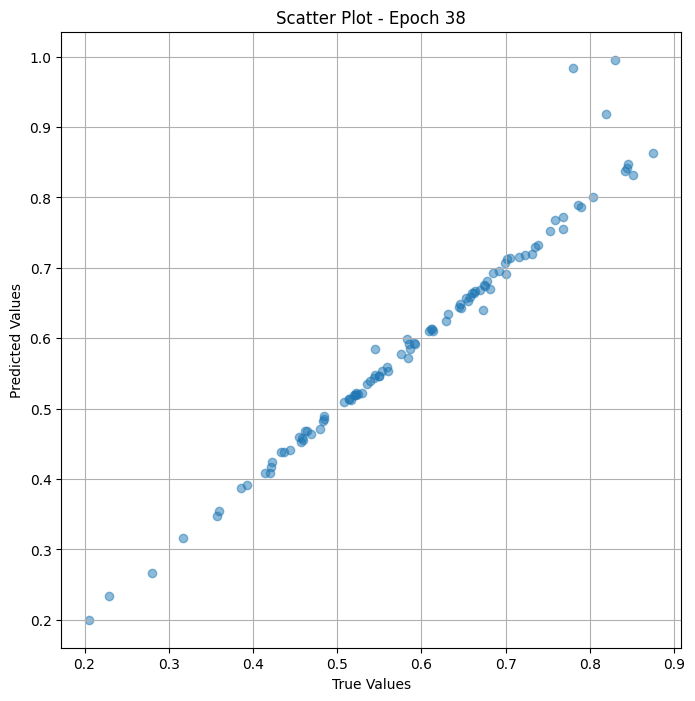


 Epoch: (39/50) Loss = 0.006836155895143747

 Epoch: (39/50) Loss_rmse = 0.08268105238676071

 Epoch: (39/50) R^2 = 0.4193229079246521

 Epoch: (39/50) MAE = 0.041601911187171936

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

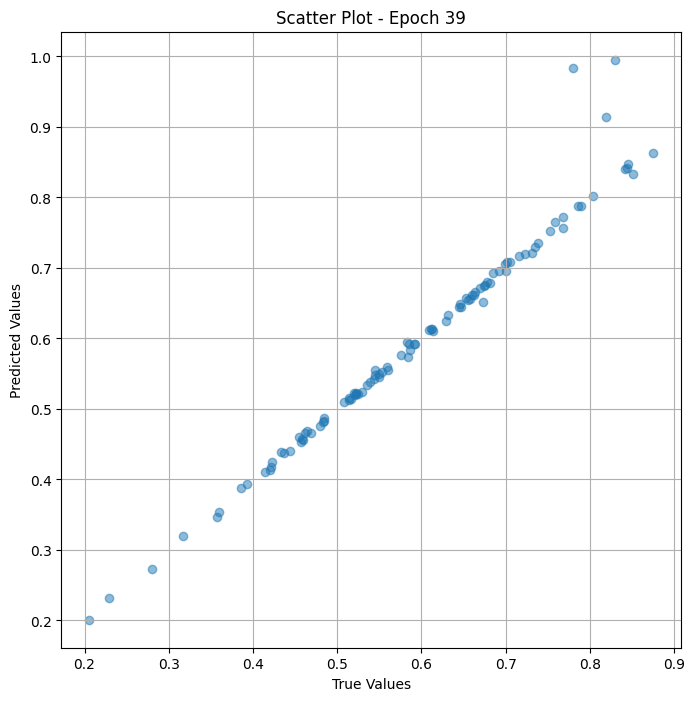


 Epoch: (40/50) Loss = 0.006812937557697296

 Epoch: (40/50) Loss_rmse = 0.08254051953554153

 Epoch: (40/50) R^2 = 0.4212951064109802

 Epoch: (40/50) MAE = 0.04156407713890076

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

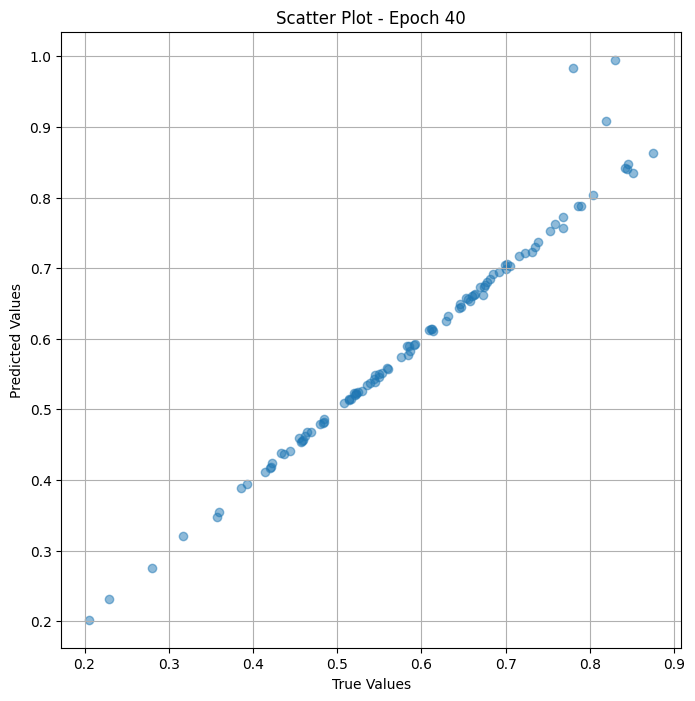


 Epoch: (41/50) Loss = 0.0067895324900746346

 Epoch: (41/50) Loss_rmse = 0.08239861577749252

 Epoch: (41/50) R^2 = 0.4232832193374634

 Epoch: (41/50) MAE = 0.041421160101890564

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

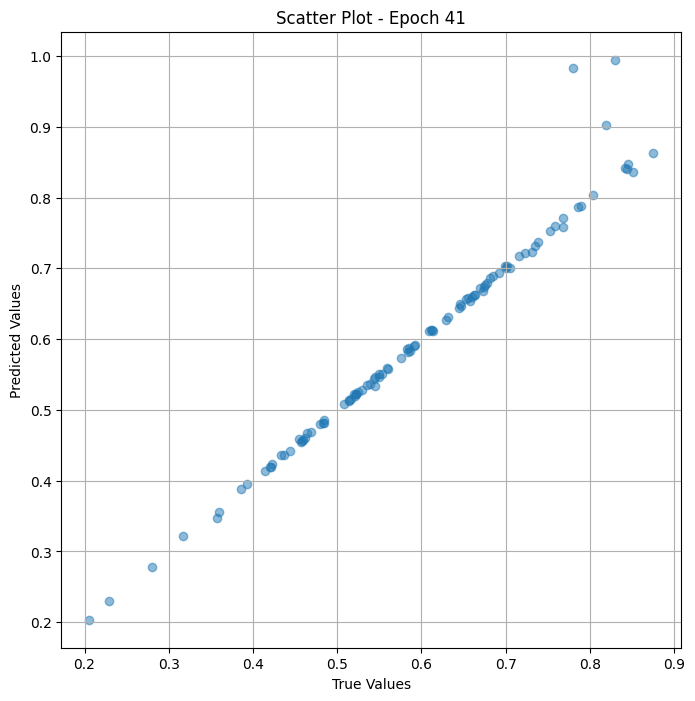


 Epoch: (42/50) Loss = 0.006764940917491913

 Epoch: (42/50) Loss_rmse = 0.08224926143884659

 Epoch: (42/50) R^2 = 0.42537206411361694

 Epoch: (42/50) MAE = 0.04137241840362549

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

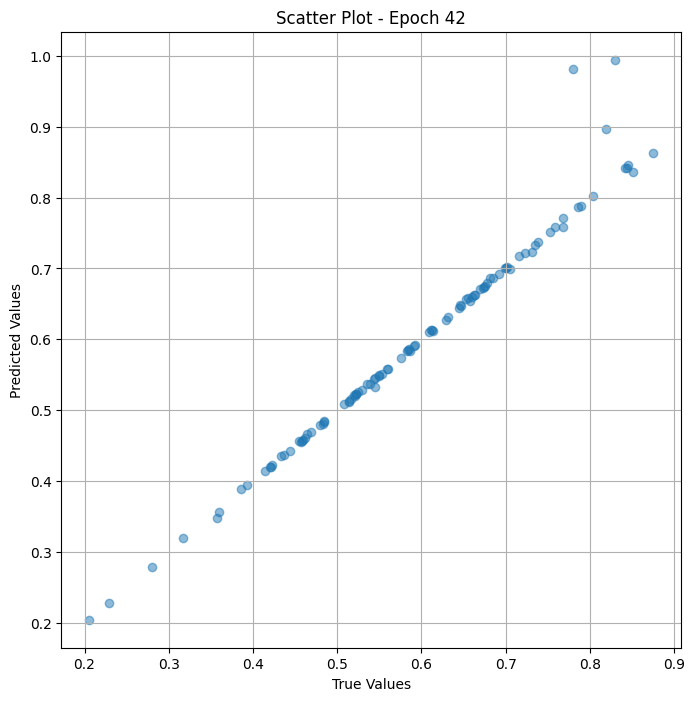


 Epoch: (43/50) Loss = 0.006737296003848314

 Epoch: (43/50) Loss_rmse = 0.08208103477954865

 Epoch: (43/50) R^2 = 0.42772024869918823

 Epoch: (43/50) MAE = 0.041220515966415405

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.22

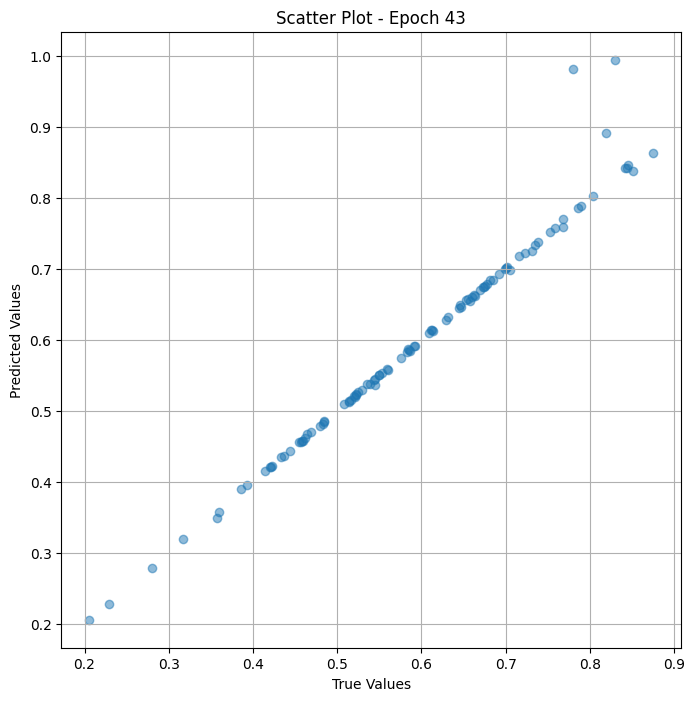


 Epoch: (44/50) Loss = 0.006705630570650101

 Epoch: (44/50) Loss_rmse = 0.08188791573047638

 Epoch: (44/50) R^2 = 0.4304100275039673

 Epoch: (44/50) MAE = 0.04110883176326752

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

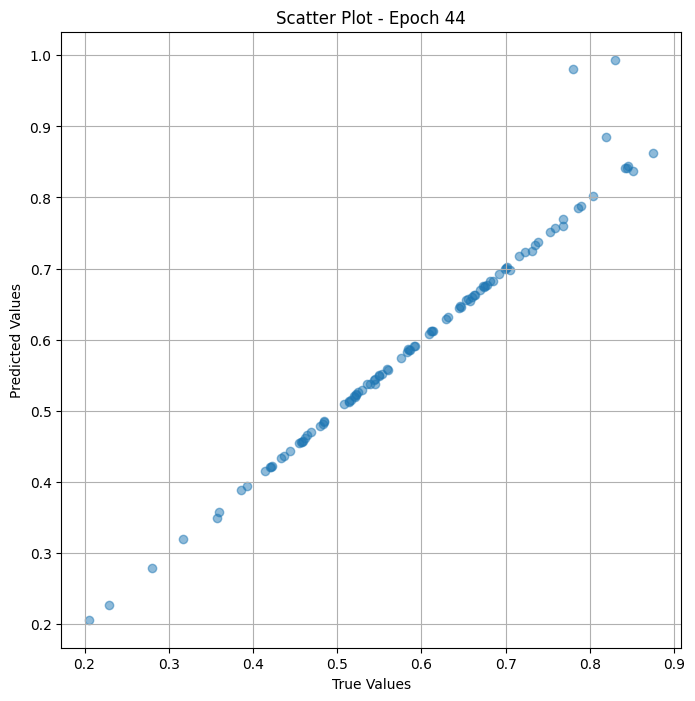


 Epoch: (45/50) Loss = 0.00667009549215436

 Epoch: (45/50) Loss_rmse = 0.08167064934968948

 Epoch: (45/50) R^2 = 0.43342840671539307

 Epoch: (45/50) MAE = 0.04099619388580322

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

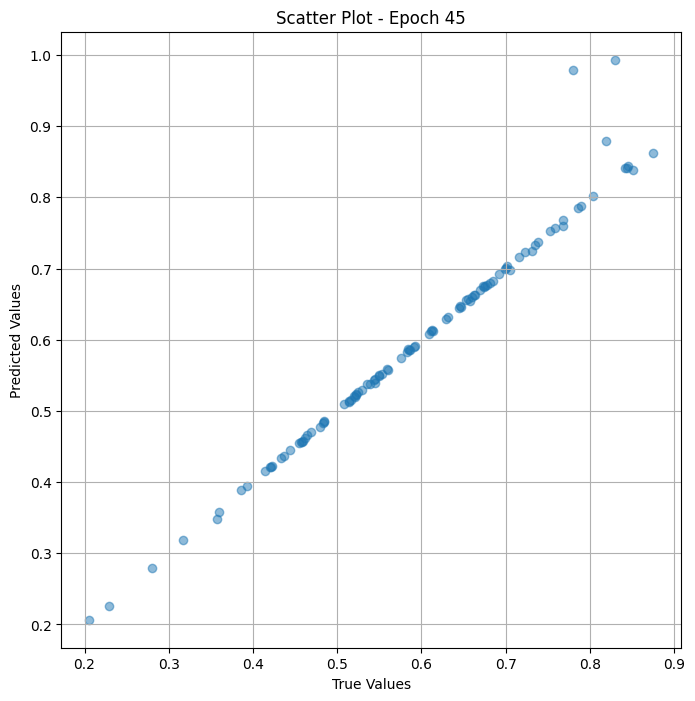


 Epoch: (46/50) Loss = 0.006629901006817818

 Epoch: (46/50) Loss_rmse = 0.08142420649528503

 Epoch: (46/50) R^2 = 0.4368426203727722

 Epoch: (46/50) MAE = 0.040869519114494324

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

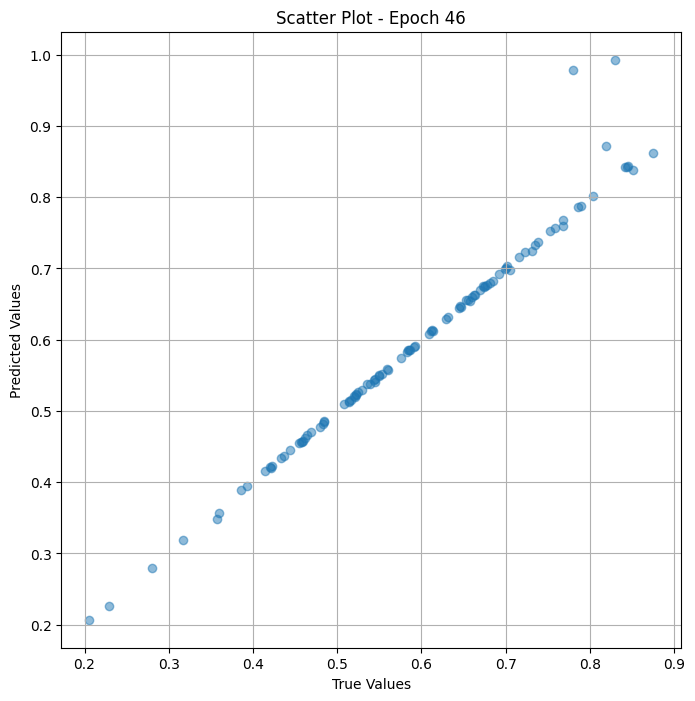


 Epoch: (47/50) Loss = 0.006583981215953827

 Epoch: (47/50) Loss_rmse = 0.08114173263311386

 Epoch: (47/50) R^2 = 0.4407431483268738

 Epoch: (47/50) MAE = 0.040715619921684265

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

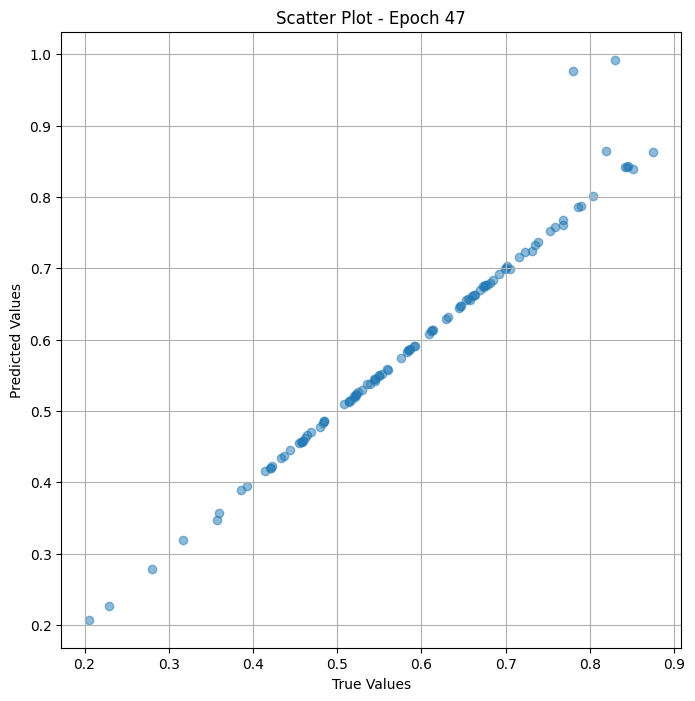


 Epoch: (48/50) Loss = 0.0065311226062476635

 Epoch: (48/50) Loss_rmse = 0.08081535995006561

 Epoch: (48/50) R^2 = 0.4452330470085144

 Epoch: (48/50) MAE = 0.04054547846317291

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

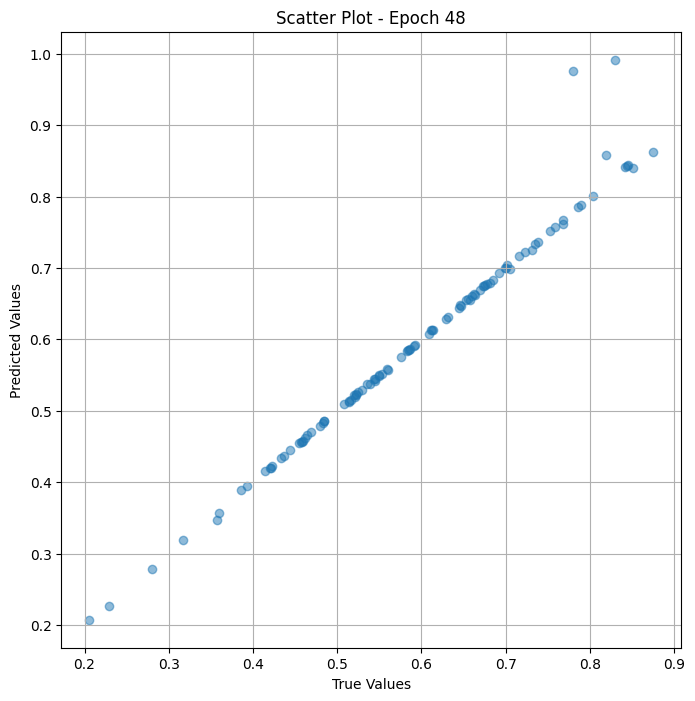


 Epoch: (49/50) Loss = 0.006469837389886379

 Epoch: (49/50) Loss_rmse = 0.08043529838323593

 Epoch: (49/50) R^2 = 0.4504387378692627

 Epoch: (49/50) MAE = 0.04034848511219025

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.2288

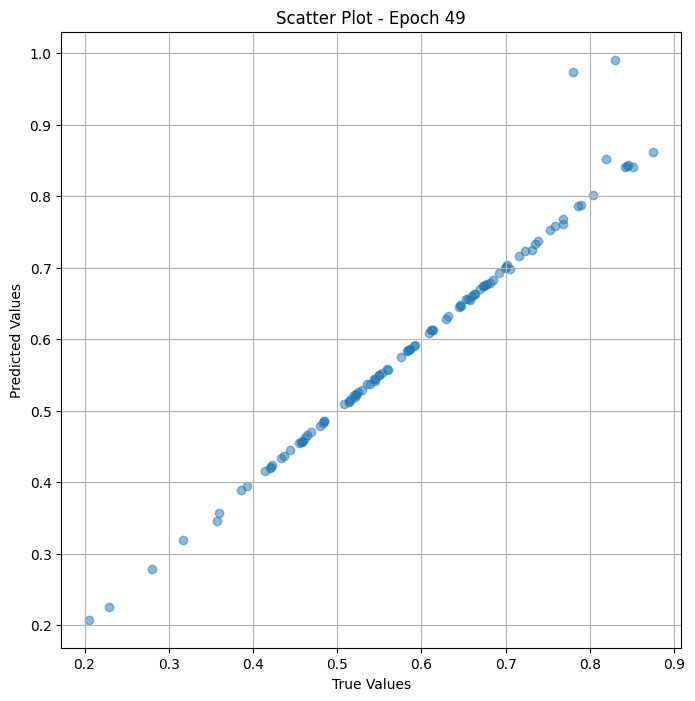


 Epoch: (50/50) Loss = 0.006398059893399477

 Epoch: (50/50) Loss_rmse = 0.07998787611722946

 Epoch: (50/50) R^2 = 0.4565356969833374

 Epoch: (50/50) MAE = 0.040123119950294495

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.5222222, 0.6695652, 0.71568626, 0.5208333, 0.76842105, 0.65957445, 0.5869565, 0.52040815, 0.53846157, 0.6756757, 0.58426964, 0.76842105, 0.35779816, 0.78640777, 0.6627907, 0.5145631, 0.6458333, 0.48453608, 0.67777777, 0.54901963, 0.5754717, 0.47916666, 0.43333334, 0.875, 0.5140187, 0.56, 0.8411215, 0.65555555, 0.46938777, 0.42045453, 0.53571427, 0.6818182, 0.54444444, 0.5252525, 0.45454547, 0.5217391, 0.8037383, 0.8455882, 0.59090906, 0.7, 0.5445545, 0.5531915, 0.45794392, 0.7582418, 0.72321427, 0.6571429, 0.7525773, 0.6846847, 0.6530612, 0.699187, 0.45918366, 0.7378641, 0.62857145, 0.61290324, 0.84444445, 0.5824176, 0.39325842, 0.6732673, 0.7798165, 0.42156863, 0.48421052, 0.31683168, 0.7894737, 0.67368424, 0.28, 0.228

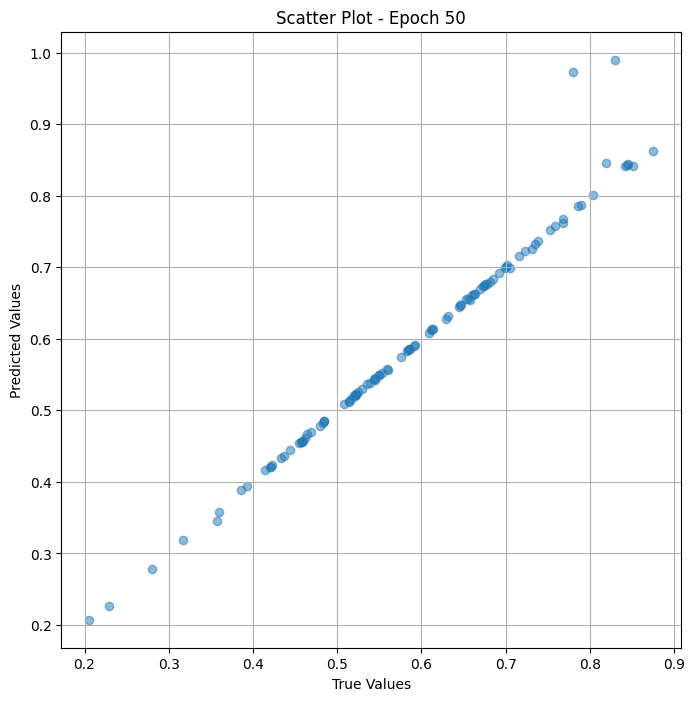

In [ ]:
# Training the model and save weights
fit(50, modelfine_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_valr_fine")

## Test

In [ ]:
# Merge the two models
class model_merge_fine_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_fine_test = model_merge_fine_test(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_fine_test = to_device(model_fine_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_fine_test.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_fine_test , train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_fine_test .eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_fine_test (x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.1319247931241989

 Epoch: (1/50) Loss_rmse = 0.36321452260017395

 Epoch: (1/50) R^2 = -14.308473587036133

 Epoch: (1/50) MAE = 0.31021058559417725

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620688

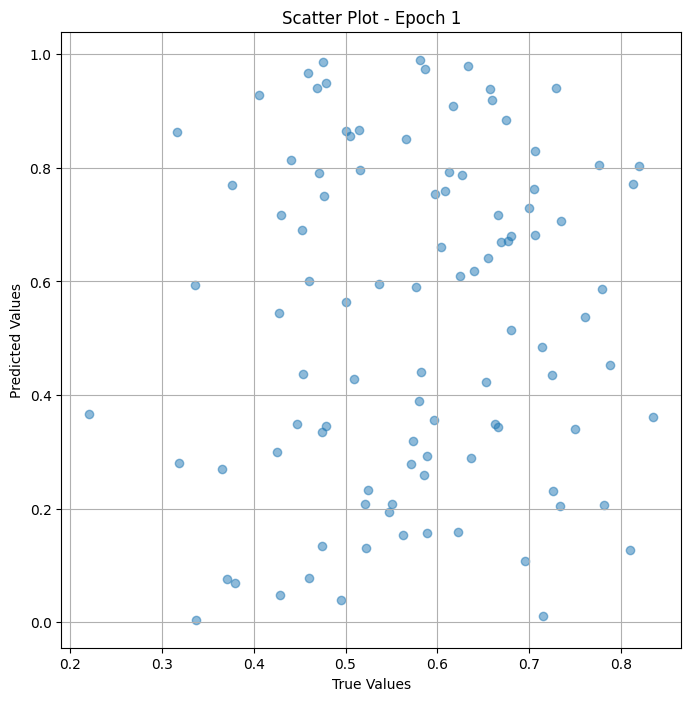


 Epoch: (2/50) Loss = 0.09617257118225098

 Epoch: (2/50) Loss_rmse = 0.31011703610420227

 Epoch: (2/50) R^2 = -10.159807205200195

 Epoch: (2/50) MAE = 0.24481183290481567

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362068

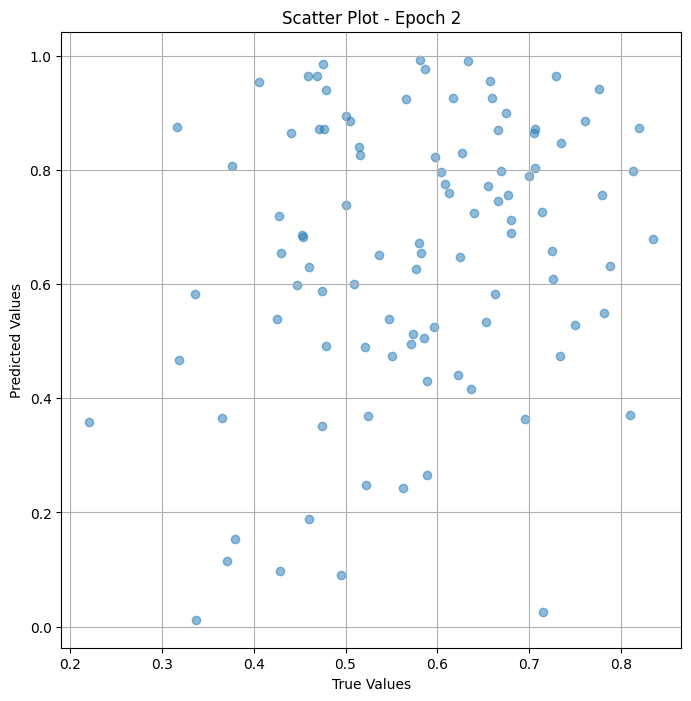


 Epoch: (3/50) Loss = 0.07471941411495209

 Epoch: (3/50) Loss_rmse = 0.27334851026535034

 Epoch: (3/50) R^2 = -7.670395851135254

 Epoch: (3/50) MAE = 0.21538439393043518

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620688

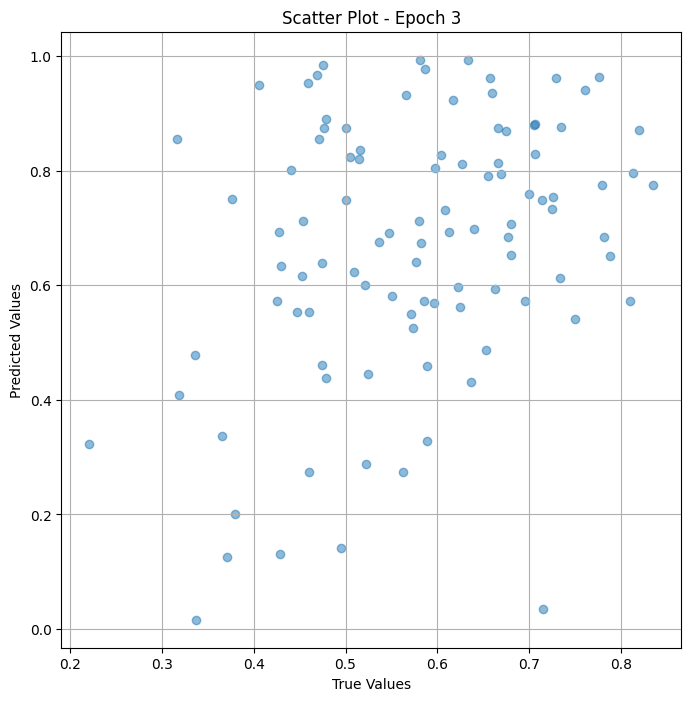


 Epoch: (4/50) Loss = 0.046063974499702454

 Epoch: (4/50) Loss_rmse = 0.21462519466876984

 Epoch: (4/50) R^2 = -4.345235824584961

 Epoch: (4/50) MAE = 0.18837514519691467

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362068

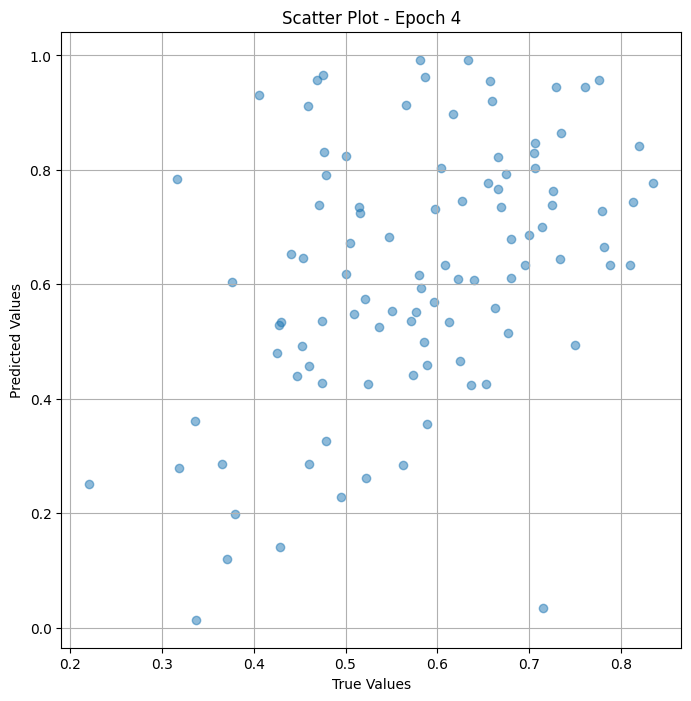


 Epoch: (5/50) Loss = 0.012331070378422737

 Epoch: (5/50) Loss_rmse = 0.11104535311460495

 Epoch: (5/50) R^2 = -0.4308900833129883

 Epoch: (5/50) MAE = 0.08554382622241974

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.336206

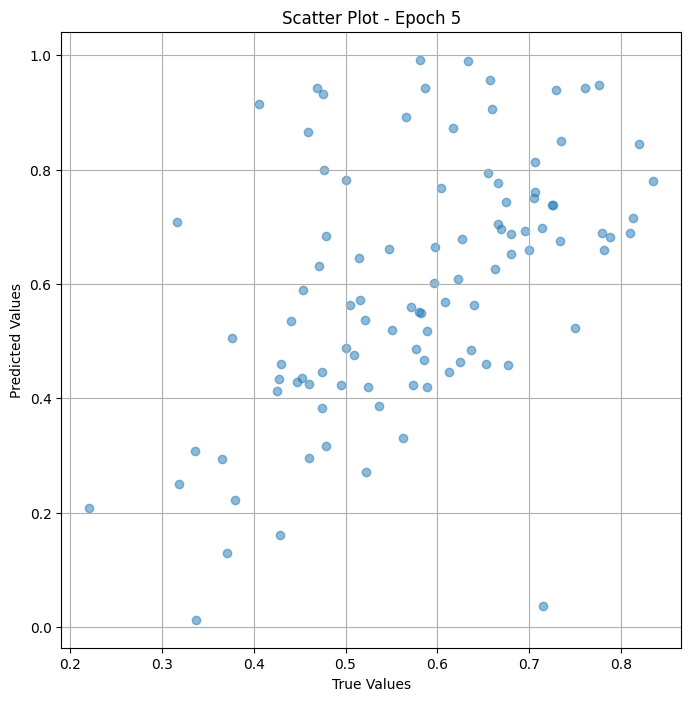


 Epoch: (6/50) Loss = 0.0038585555739700794

 Epoch: (6/50) Loss_rmse = 0.06211727112531662

 Epoch: (6/50) R^2 = 0.5522555112838745

 Epoch: (6/50) MAE = 0.053512685000896454

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620

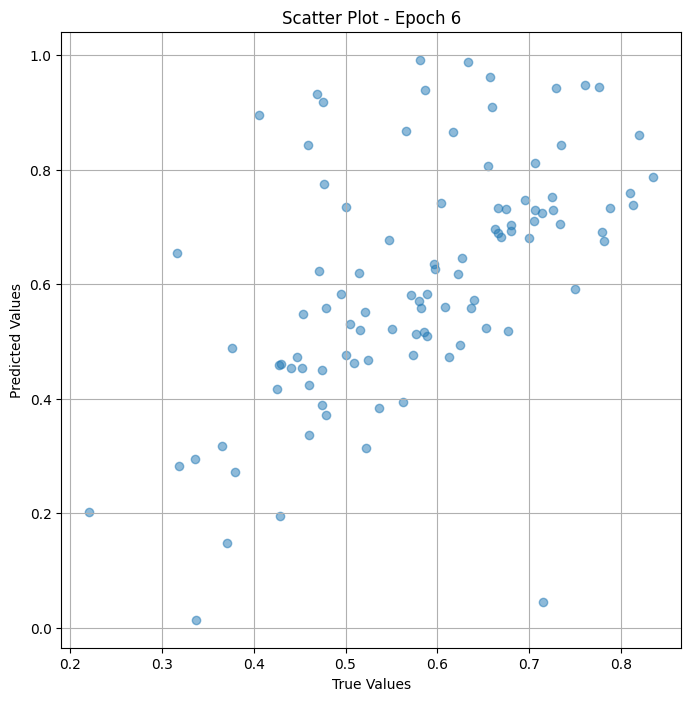


 Epoch: (7/50) Loss = 0.0017222402384504676

 Epoch: (7/50) Loss_rmse = 0.04149988293647766

 Epoch: (7/50) R^2 = 0.8001523017883301

 Epoch: (7/50) MAE = 0.038052111864089966

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620

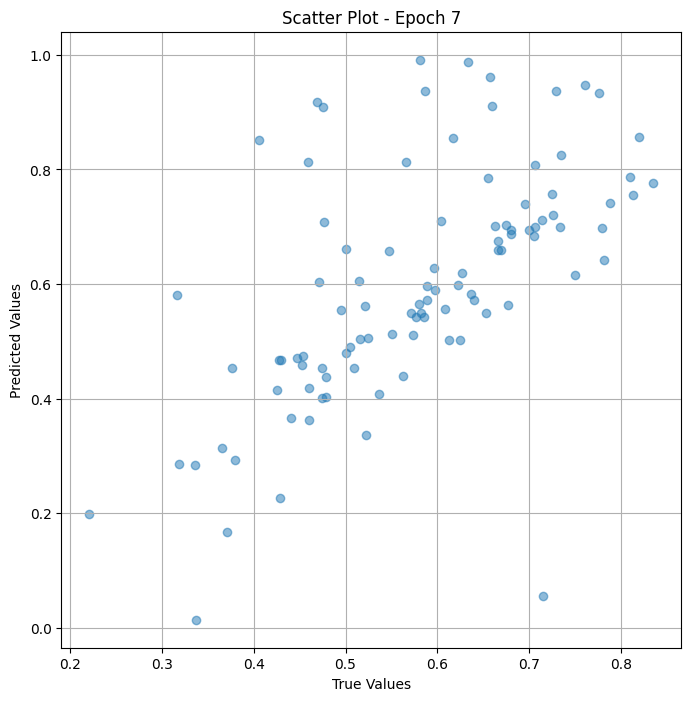


 Epoch: (8/50) Loss = 0.0013040582416579127

 Epoch: (8/50) Loss_rmse = 0.0361117459833622

 Epoch: (8/50) R^2 = 0.8486778736114502

 Epoch: (8/50) MAE = 0.02882208675146103

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3362068

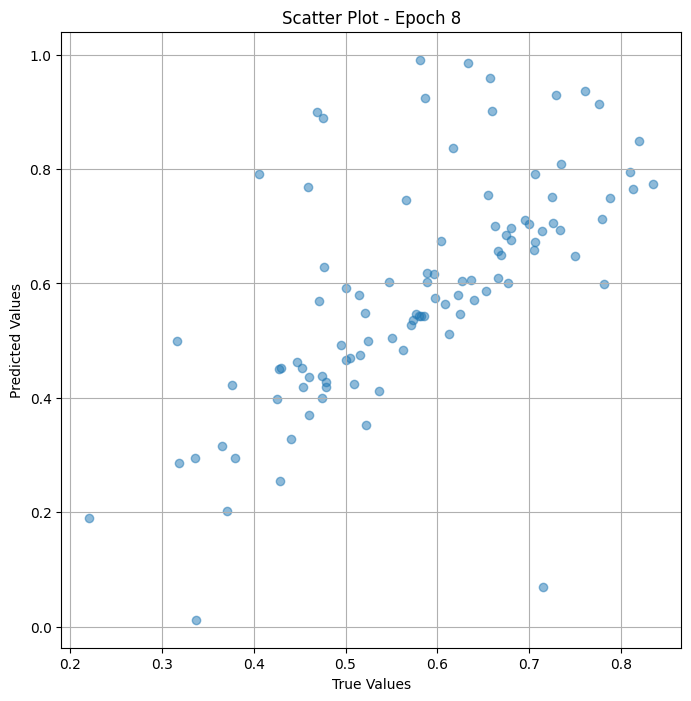


 Epoch: (9/50) Loss = 0.0005137032130733132

 Epoch: (9/50) Loss_rmse = 0.02266502194106579

 Epoch: (9/50) R^2 = 0.9403901696205139

 Epoch: (9/50) MAE = 0.021298125386238098

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620

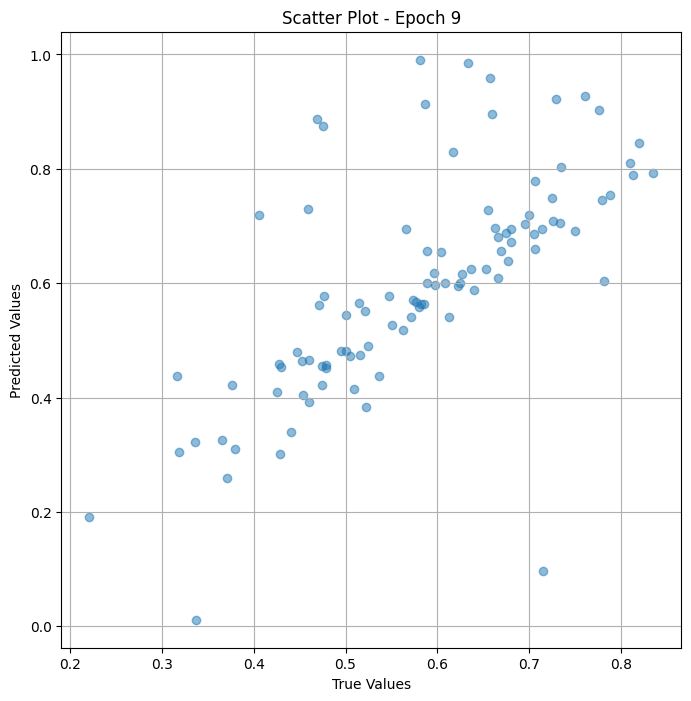


 Epoch: (10/50) Loss = 5.675316060660407e-05

 Epoch: (10/50) Loss_rmse = 0.00753346923738718

 Epoch: (10/50) R^2 = 0.9934144020080566

 Epoch: (10/50) MAE = 0.007454618811607361

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.3

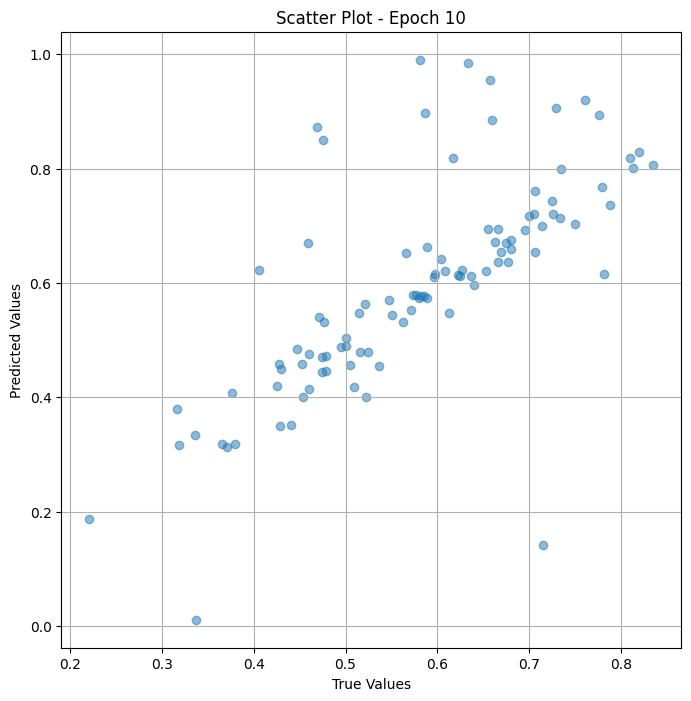


 Epoch: (11/50) Loss = 7.113378524081782e-05

 Epoch: (11/50) Loss_rmse = 0.008434085175395012

 Epoch: (11/50) R^2 = 0.99174565076828

 Epoch: (11/50) MAE = 0.006396360695362091

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33

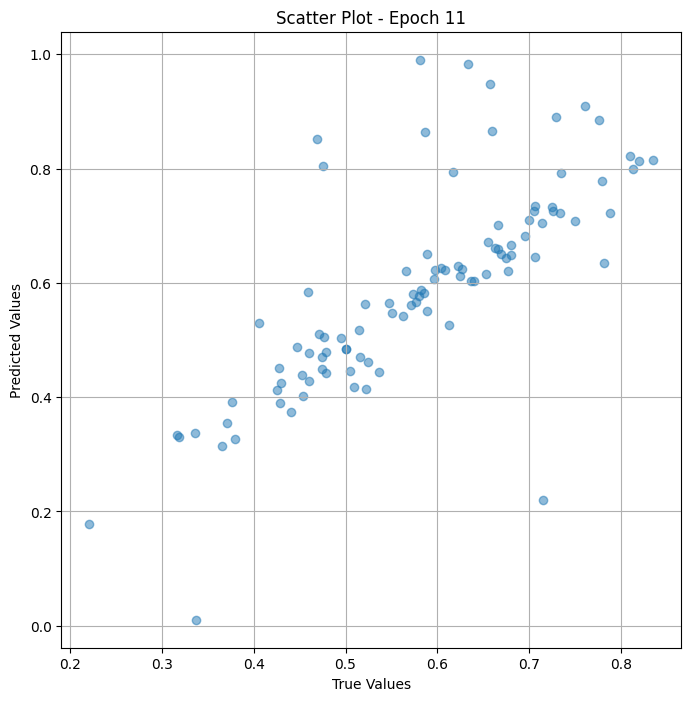


 Epoch: (12/50) Loss = 4.181775511824526e-05

 Epoch: (12/50) Loss_rmse = 0.006466664839535952

 Epoch: (12/50) R^2 = 0.9951474666595459

 Epoch: (12/50) MAE = 0.005399204790592194

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

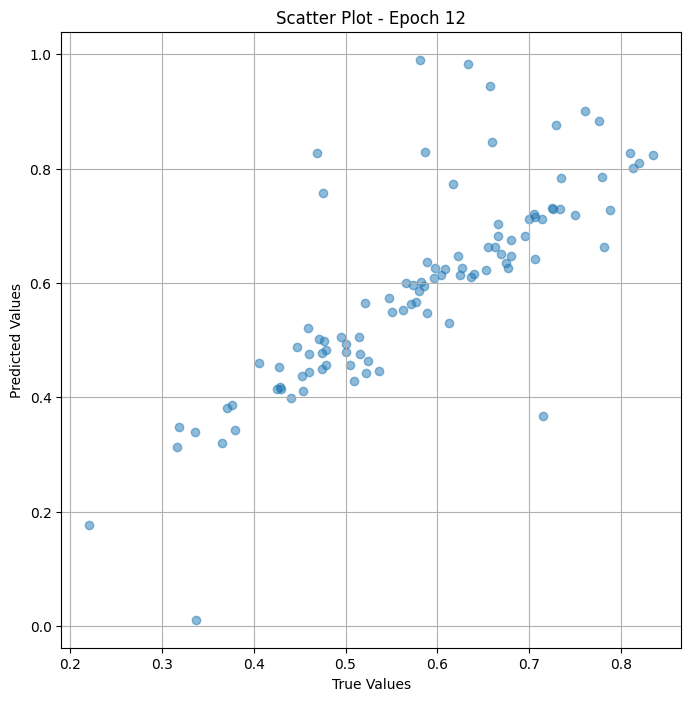


 Epoch: (13/50) Loss = 1.8337497749598697e-05

 Epoch: (13/50) Loss_rmse = 0.004282230511307716

 Epoch: (13/50) R^2 = 0.9978721141815186

 Epoch: (13/50) MAE = 0.0038724467158317566

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

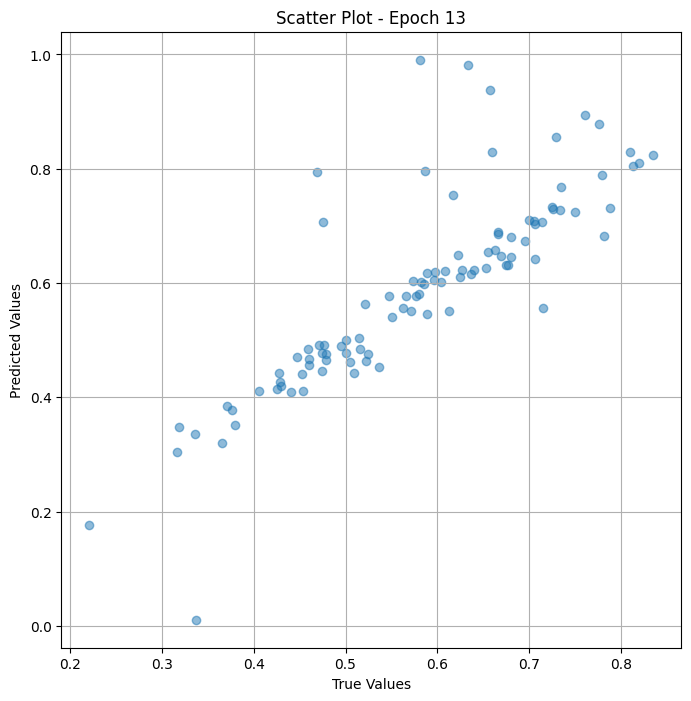


 Epoch: (14/50) Loss = 7.122785518731689e-06

 Epoch: (14/50) Loss_rmse = 0.0026688547804951668

 Epoch: (14/50) R^2 = 0.9991734623908997

 Epoch: (14/50) MAE = 0.002647392451763153

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

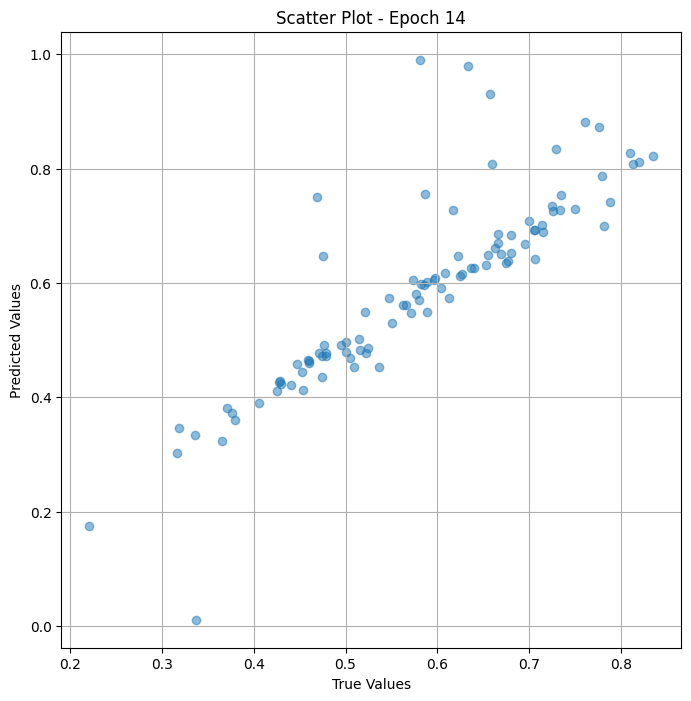


 Epoch: (15/50) Loss = 5.9991557463945355e-06

 Epoch: (15/50) Loss_rmse = 0.002449317369610071

 Epoch: (15/50) R^2 = 0.9993038773536682

 Epoch: (15/50) MAE = 0.0021637827157974243

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

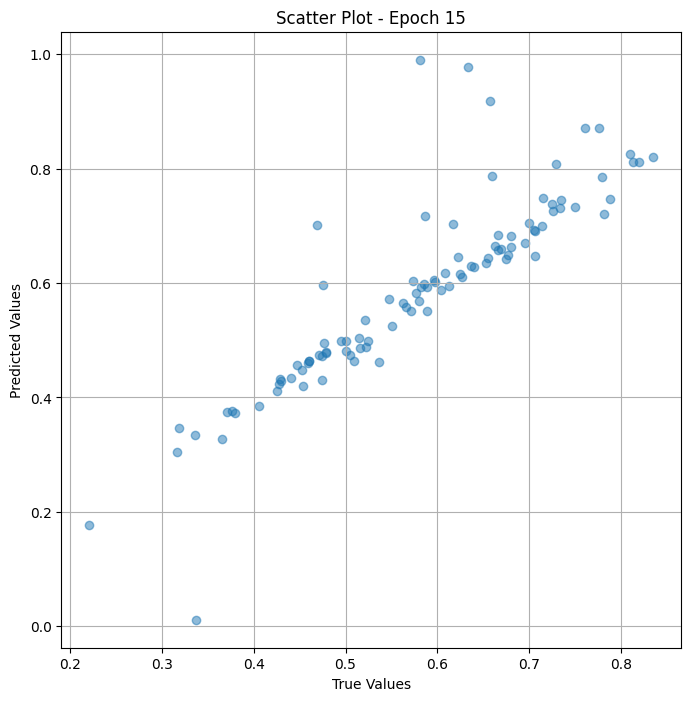


 Epoch: (16/50) Loss = 3.96234599975287e-06

 Epoch: (16/50) Loss_rmse = 0.0019905641674995422

 Epoch: (16/50) R^2 = 0.9995402097702026

 Epoch: (16/50) MAE = 0.0015713199973106384

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

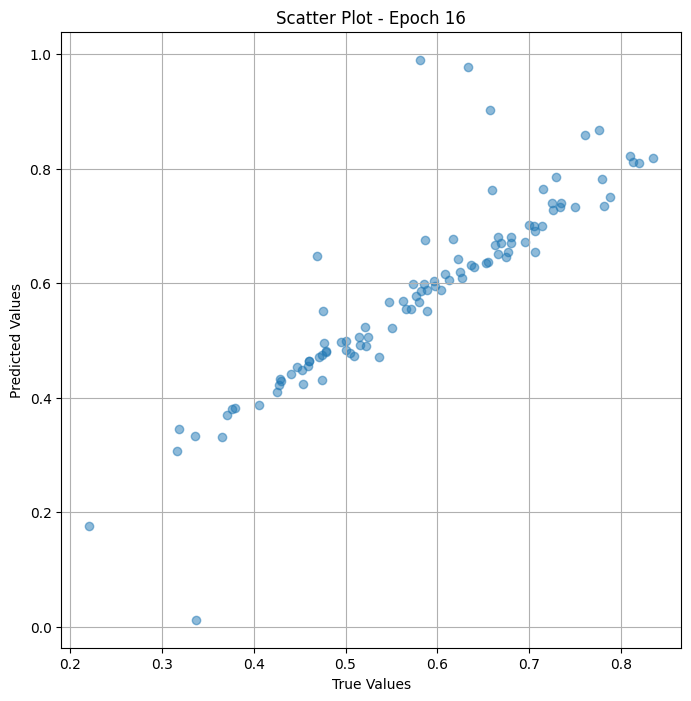


 Epoch: (17/50) Loss = 8.021472240216099e-06

 Epoch: (17/50) Loss_rmse = 0.0028322204016149044

 Epoch: (17/50) R^2 = 0.9990692138671875

 Epoch: (17/50) MAE = 0.002042442560195923

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

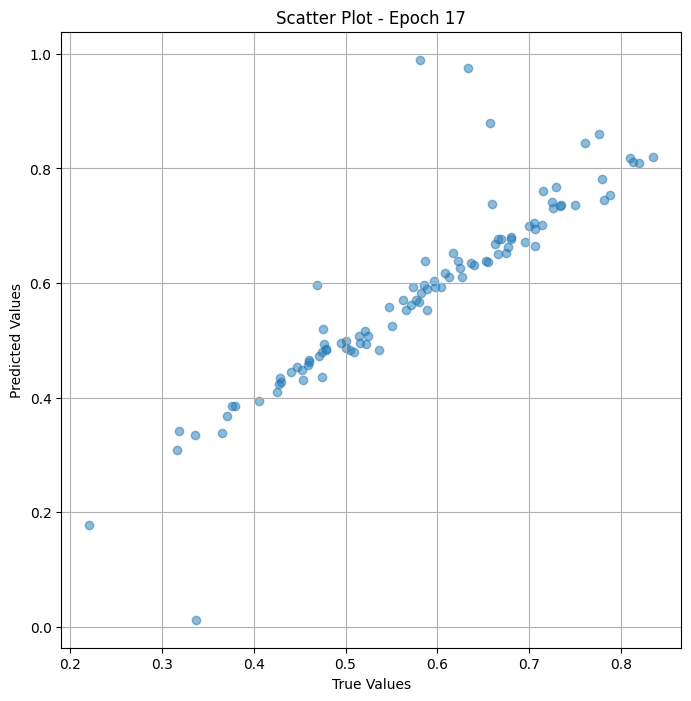


 Epoch: (18/50) Loss = 4.8132974370673764e-06

 Epoch: (18/50) Loss_rmse = 0.0021939228754490614

 Epoch: (18/50) R^2 = 0.9994414448738098

 Epoch: (18/50) MAE = 0.0018777996301651

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

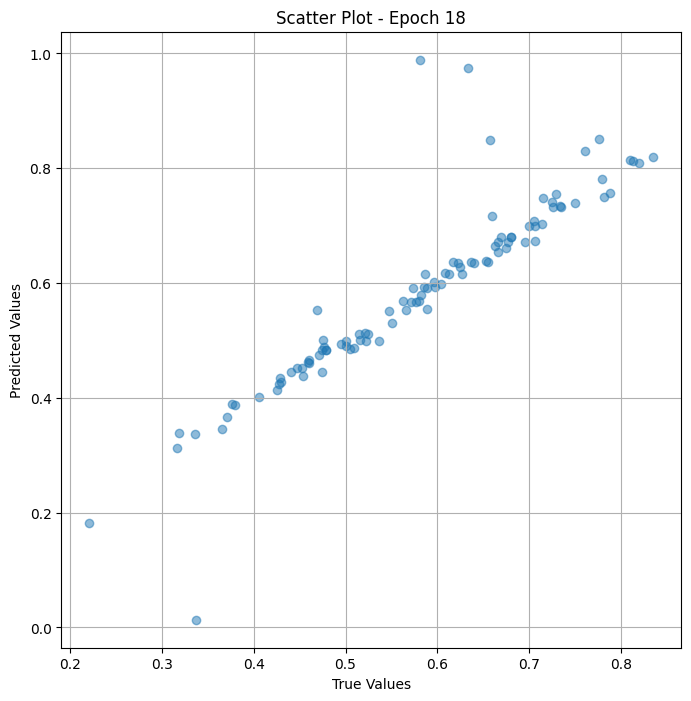


 Epoch: (19/50) Loss = 1.540183120596339e-06

 Epoch: (19/50) Loss_rmse = 0.0012410411145538092

 Epoch: (19/50) R^2 = 0.9998213052749634

 Epoch: (19/50) MAE = 0.0009552314877510071

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

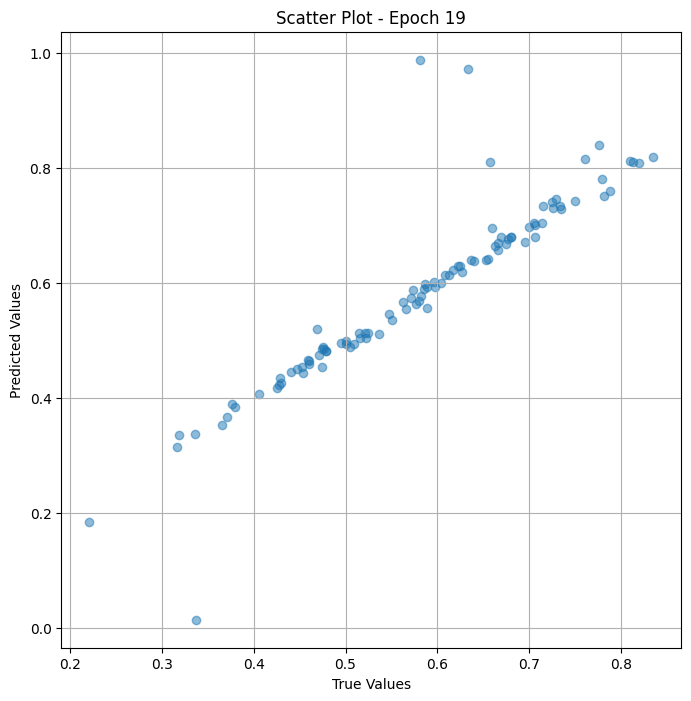


 Epoch: (20/50) Loss = 8.300265221805603e-07

 Epoch: (20/50) Loss_rmse = 0.0009110579267144203

 Epoch: (20/50) R^2 = 0.999903678894043

 Epoch: (20/50) MAE = 0.0007582828402519226

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

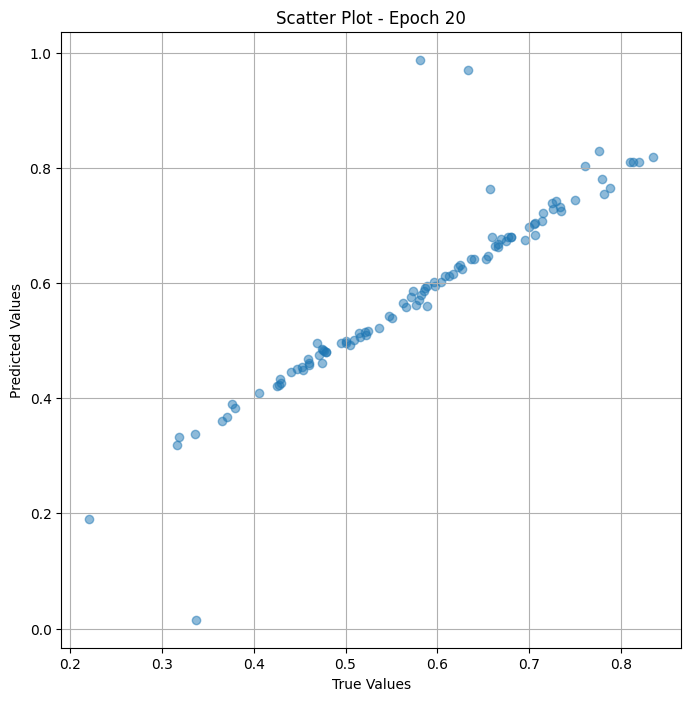


 Epoch: (21/50) Loss = 5.103780154058768e-07

 Epoch: (21/50) Loss_rmse = 0.0007144074770621955

 Epoch: (21/50) R^2 = 0.9999407529830933

 Epoch: (21/50) MAE = 0.0006783530116081238

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

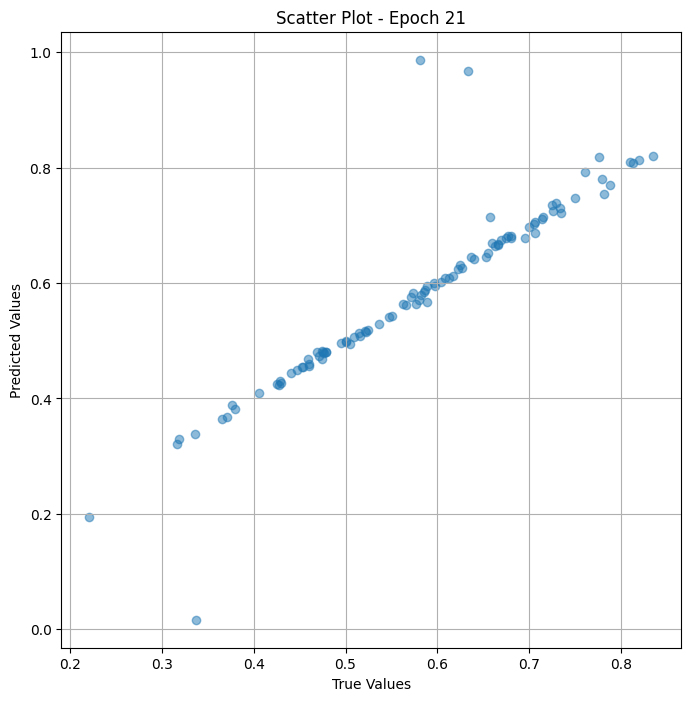


 Epoch: (22/50) Loss = 6.111507104833436e-07

 Epoch: (22/50) Loss_rmse = 0.0007817613077349961

 Epoch: (22/50) R^2 = 0.9999290704727173

 Epoch: (22/50) MAE = 0.0007370710372924805

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

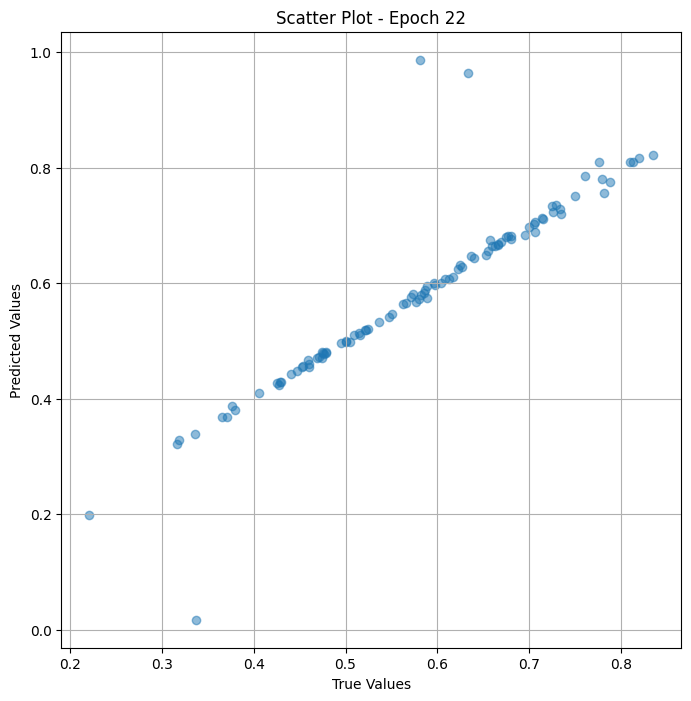


 Epoch: (23/50) Loss = 4.846688170800917e-07

 Epoch: (23/50) Loss_rmse = 0.0006961816106922925

 Epoch: (23/50) R^2 = 0.999943733215332

 Epoch: (23/50) MAE = 0.000474296510219574

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

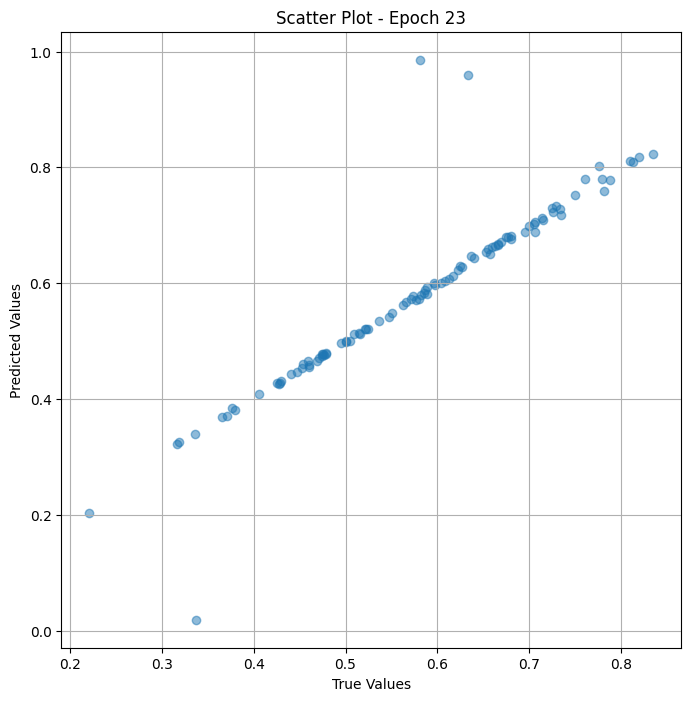


 Epoch: (24/50) Loss = 6.951568707336264e-07

 Epoch: (24/50) Loss_rmse = 0.0008337606559507549

 Epoch: (24/50) R^2 = 0.9999193549156189

 Epoch: (24/50) MAE = 0.0005387812852859497

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

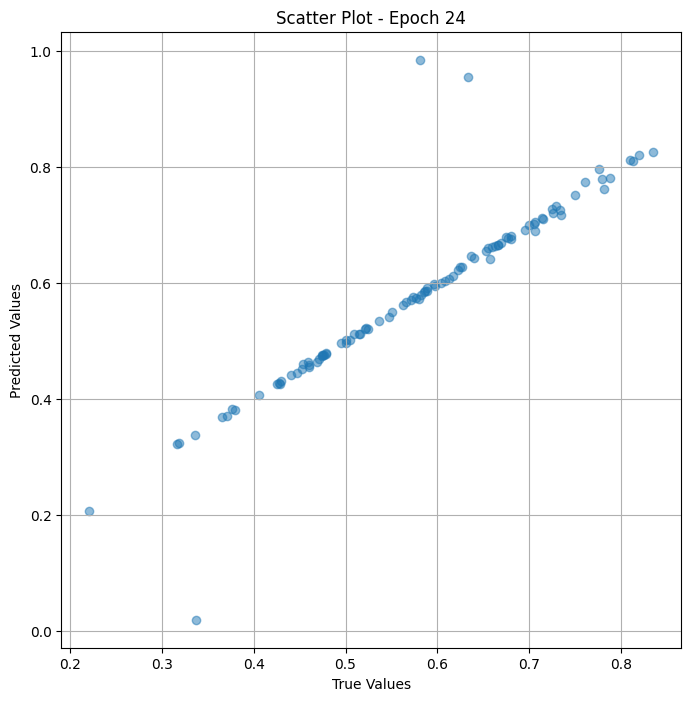


 Epoch: (25/50) Loss = 5.761112902291643e-07

 Epoch: (25/50) Loss_rmse = 0.0007590199820697308

 Epoch: (25/50) R^2 = 0.999933123588562

 Epoch: (25/50) MAE = 0.0005024895071983337

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

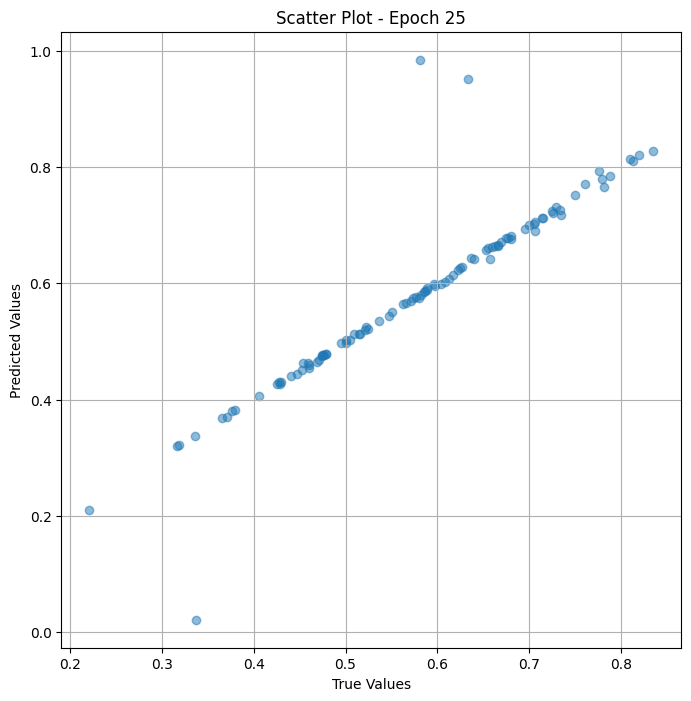


 Epoch: (26/50) Loss = 7.833165796000685e-07

 Epoch: (26/50) Loss_rmse = 0.0008850517333485186

 Epoch: (26/50) R^2 = 0.9999091029167175

 Epoch: (26/50) MAE = 0.0006747767329216003

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

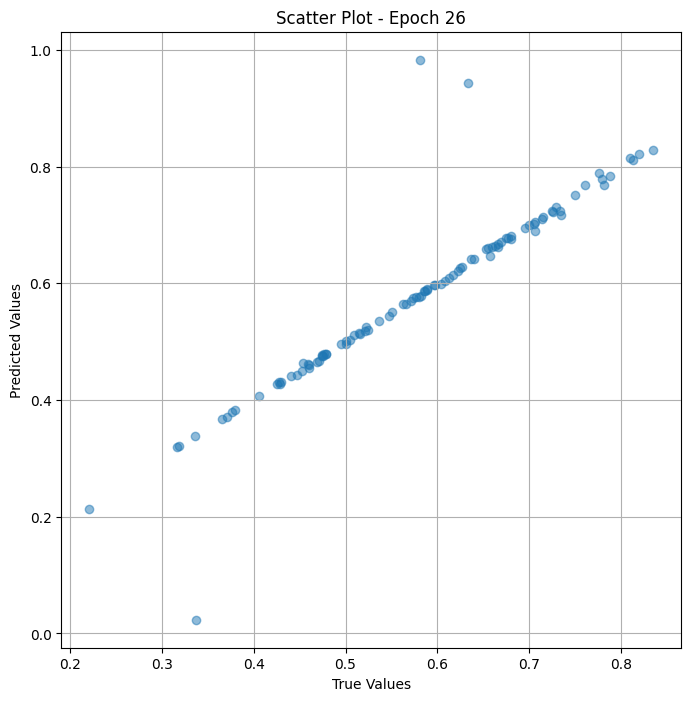


 Epoch: (27/50) Loss = 8.157480806403328e-07

 Epoch: (27/50) Loss_rmse = 0.0009031877270899713

 Epoch: (27/50) R^2 = 0.9999053478240967

 Epoch: (27/50) MAE = 0.0006989315152168274

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

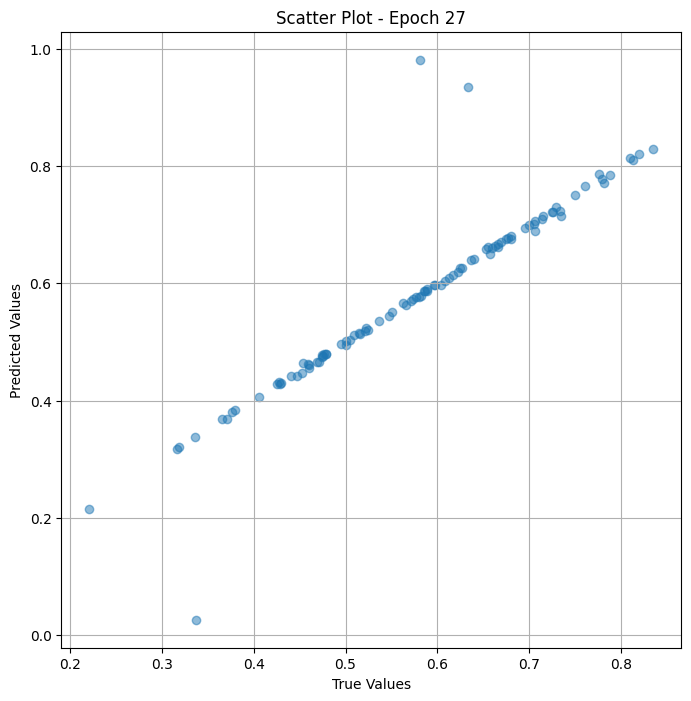


 Epoch: (28/50) Loss = 8.832977300698985e-07

 Epoch: (28/50) Loss_rmse = 0.0009398392285220325

 Epoch: (28/50) R^2 = 0.9998974800109863

 Epoch: (28/50) MAE = 0.0007145926356315613

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

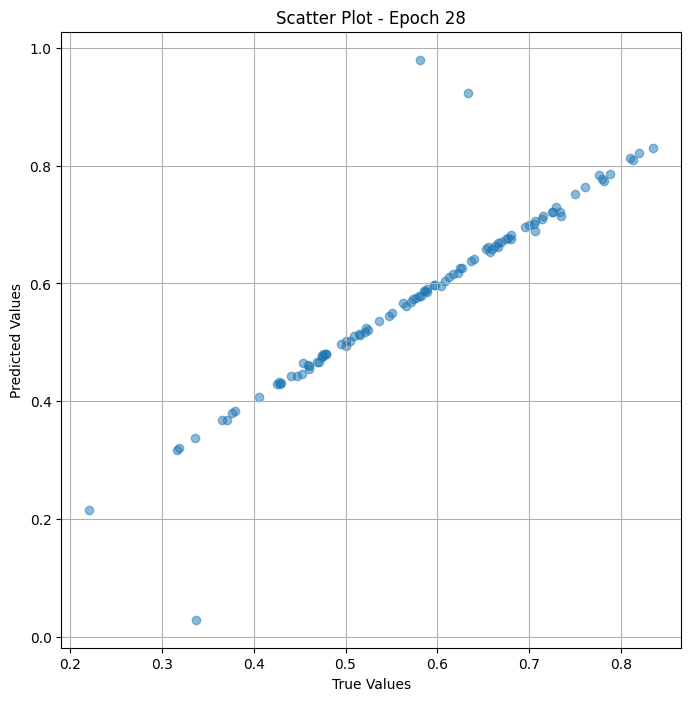


 Epoch: (29/50) Loss = 9.702250736154383e-07

 Epoch: (29/50) Loss_rmse = 0.0009850000496953726

 Epoch: (29/50) R^2 = 0.9998874068260193

 Epoch: (29/50) MAE = 0.0007286444306373596

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

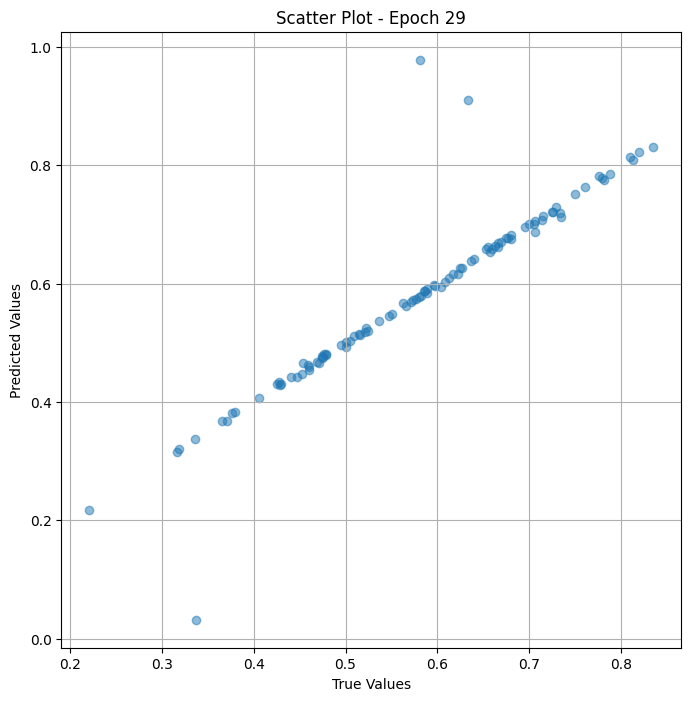


 Epoch: (30/50) Loss = 1.2229718322487315e-06

 Epoch: (30/50) Loss_rmse = 0.0011058805976063013

 Epoch: (30/50) R^2 = 0.9998580813407898

 Epoch: (30/50) MAE = 0.0007967352867126465

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

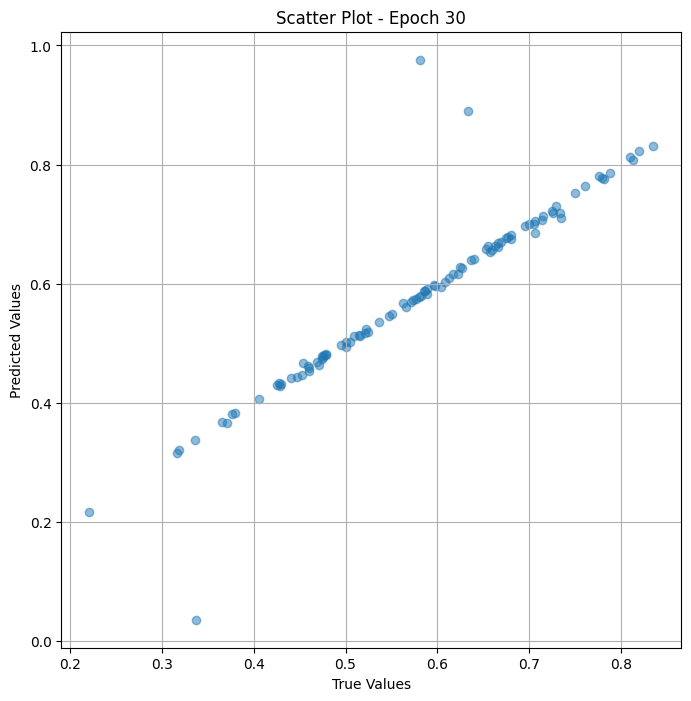


 Epoch: (31/50) Loss = 1.6271950471491436e-06

 Epoch: (31/50) Loss_rmse = 0.0012756155338138342

 Epoch: (31/50) R^2 = 0.9998111724853516

 Epoch: (31/50) MAE = 0.000950939953327179

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

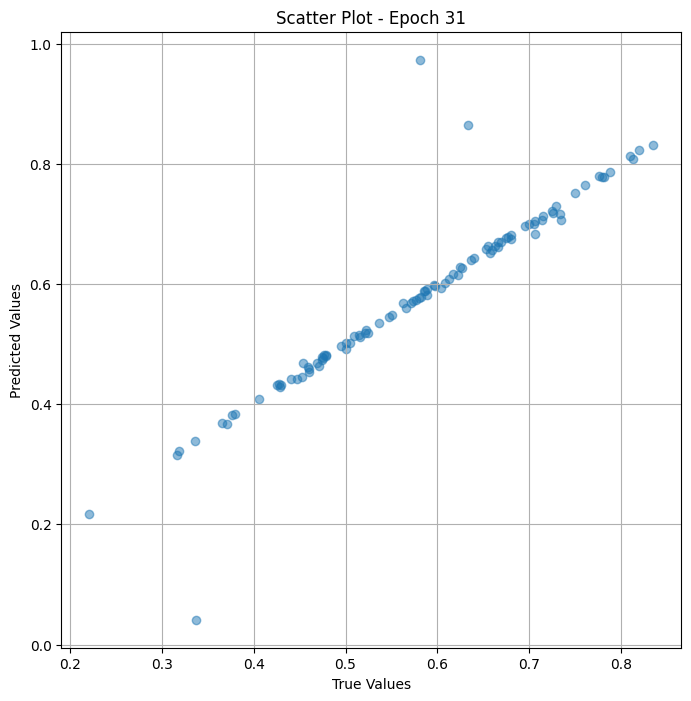


 Epoch: (32/50) Loss = 1.8807616015692474e-06

 Epoch: (32/50) Loss_rmse = 0.0013714085798710585

 Epoch: (32/50) R^2 = 0.9997817277908325

 Epoch: (32/50) MAE = 0.0010054633021354675

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

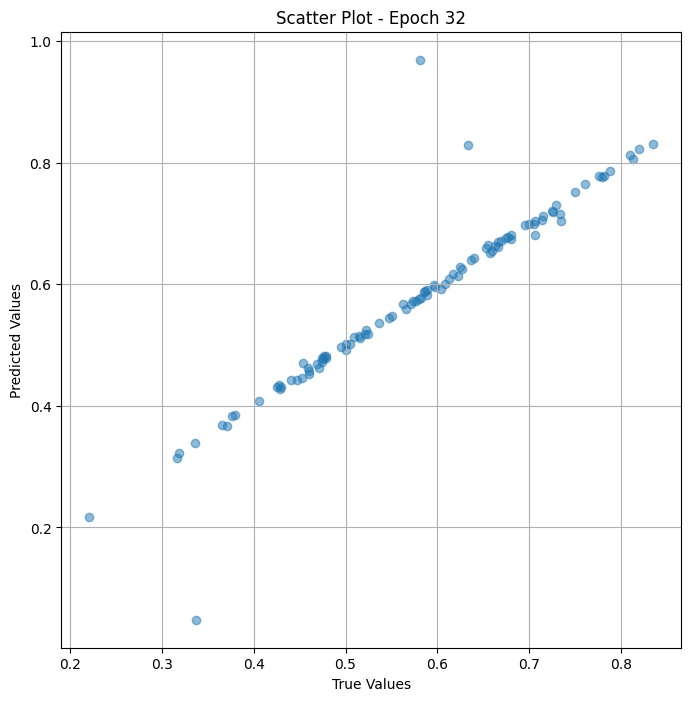


 Epoch: (33/50) Loss = 2.3466111542802537e-06

 Epoch: (33/50) Loss_rmse = 0.0015318652149289846

 Epoch: (33/50) R^2 = 0.999727725982666

 Epoch: (33/50) MAE = 0.0010768622159957886

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

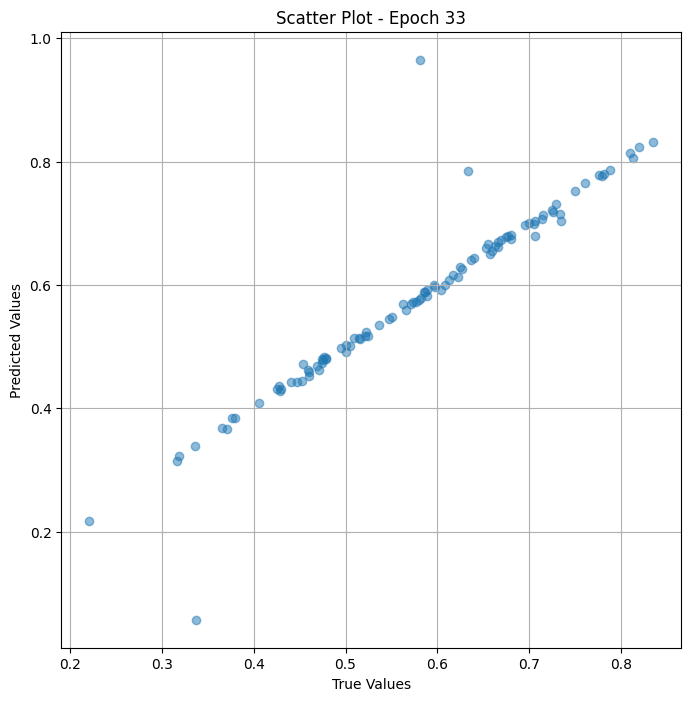


 Epoch: (34/50) Loss = 2.3650129605812253e-06

 Epoch: (34/50) Loss_rmse = 0.0015378599055111408

 Epoch: (34/50) R^2 = 0.9997255802154541

 Epoch: (34/50) MAE = 0.0009853839874267578

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

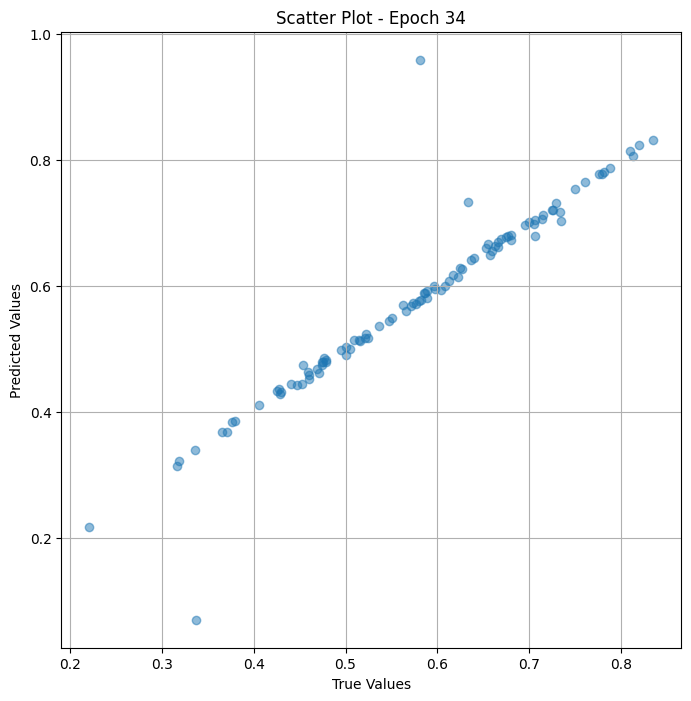


 Epoch: (35/50) Loss = 2.291392092956812e-06

 Epoch: (35/50) Loss_rmse = 0.0015137344598770142

 Epoch: (35/50) R^2 = 0.999734103679657

 Epoch: (35/50) MAE = 0.0009187087416648865

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

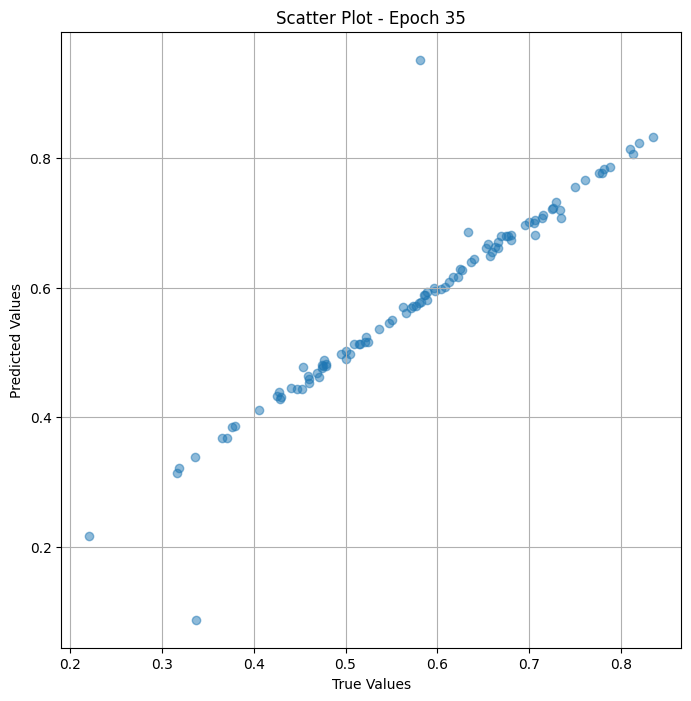


 Epoch: (36/50) Loss = 2.2892891138326377e-06

 Epoch: (36/50) Loss_rmse = 0.001513039693236351

 Epoch: (36/50) R^2 = 0.9997343420982361

 Epoch: (36/50) MAE = 0.0010078176856040955

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

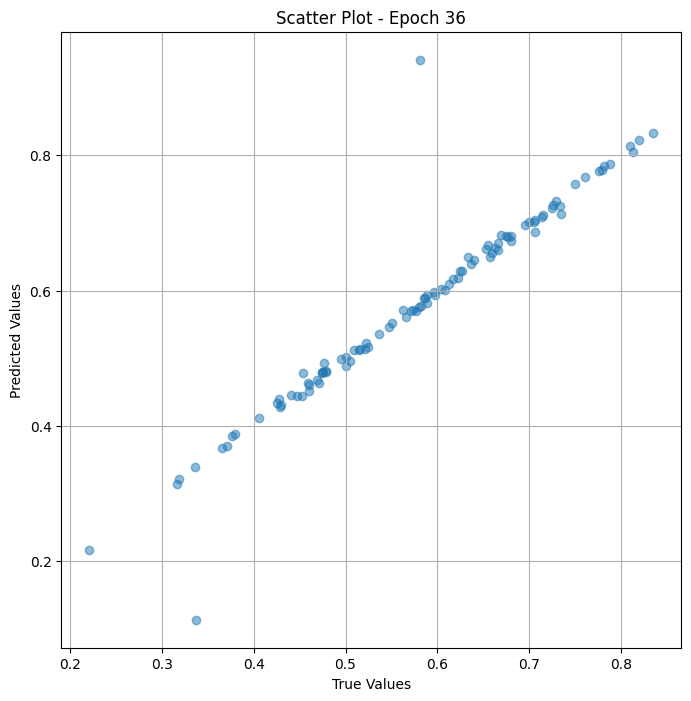


 Epoch: (37/50) Loss = 2.18082118408347e-06

 Epoch: (37/50) Loss_rmse = 0.0014767603715881705

 Epoch: (37/50) R^2 = 0.9997469186782837

 Epoch: (37/50) MAE = 0.0010651126503944397

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

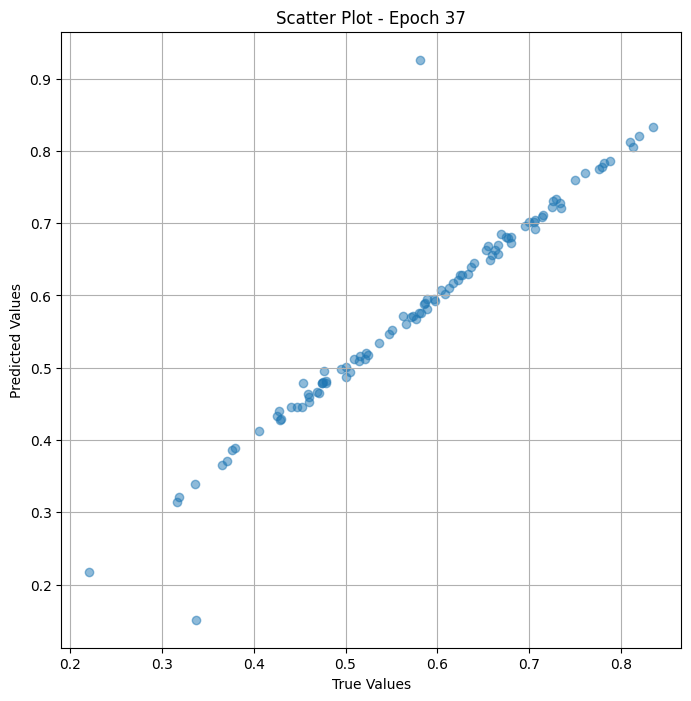


 Epoch: (38/50) Loss = 9.451712799091183e-07

 Epoch: (38/50) Loss_rmse = 0.0009721991955302656

 Epoch: (38/50) R^2 = 0.9998903274536133

 Epoch: (38/50) MAE = 0.000781714916229248

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

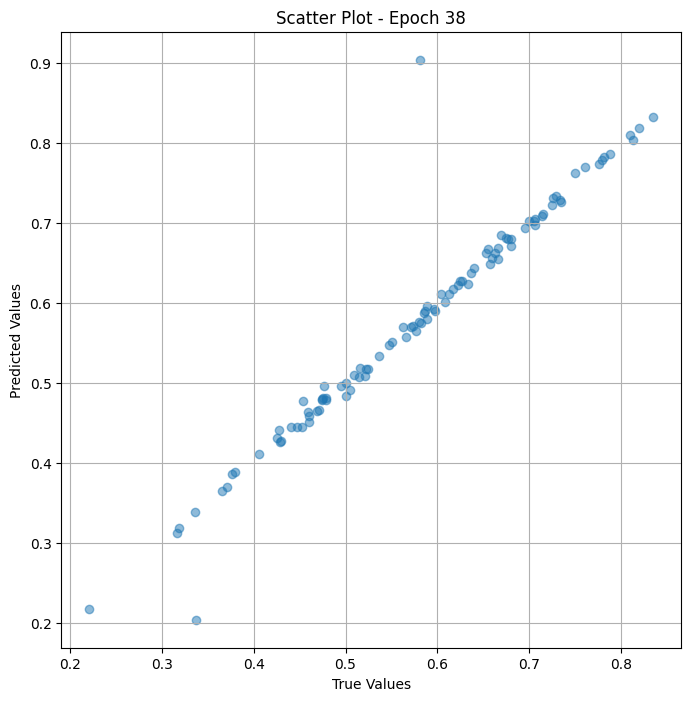


 Epoch: (39/50) Loss = 1.1713848380168201e-07

 Epoch: (39/50) Loss_rmse = 0.00034225499257445335

 Epoch: (39/50) R^2 = 0.9999864101409912

 Epoch: (39/50) MAE = 0.00025222450494766235

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.3707865

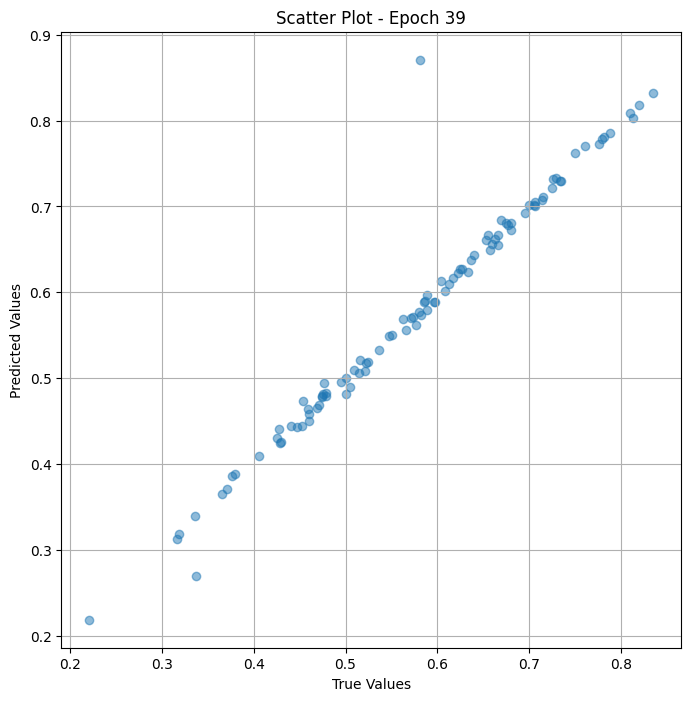


 Epoch: (40/50) Loss = 6.161110377433943e-07

 Epoch: (40/50) Loss_rmse = 0.0007849273970350623

 Epoch: (40/50) R^2 = 0.9999285340309143

 Epoch: (40/50) MAE = 0.0005539730191230774

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

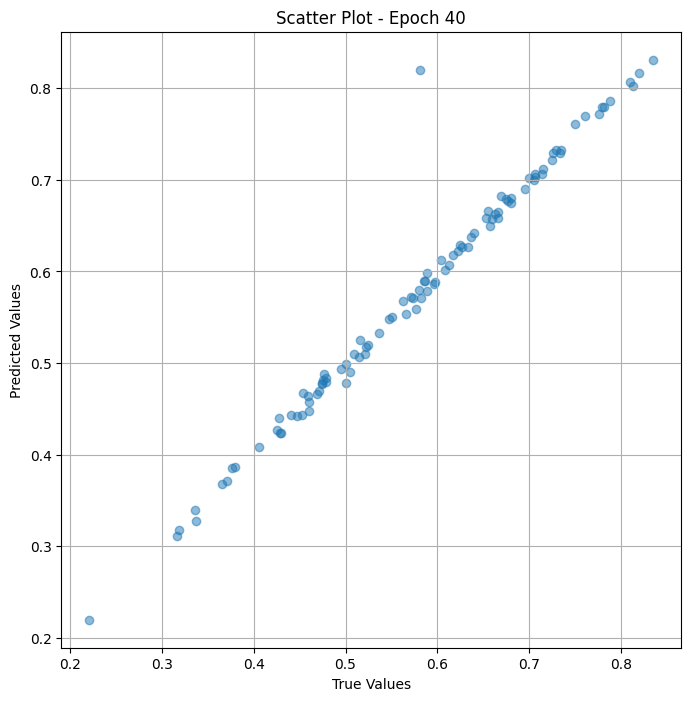


 Epoch: (41/50) Loss = 3.368597276676155e-07

 Epoch: (41/50) Loss_rmse = 0.0005803961539641023

 Epoch: (41/50) R^2 = 0.9999608993530273

 Epoch: (41/50) MAE = 0.0004678294062614441

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

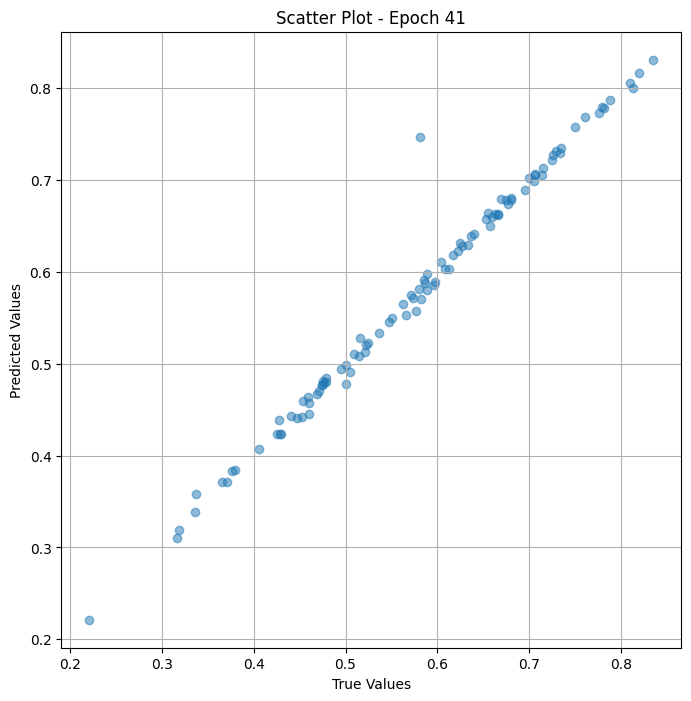


 Epoch: (42/50) Loss = 2.134669614406448e-07

 Epoch: (42/50) Loss_rmse = 0.00046202485100366175

 Epoch: (42/50) R^2 = 0.9999752044677734

 Epoch: (42/50) MAE = 0.0003988593816757202

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

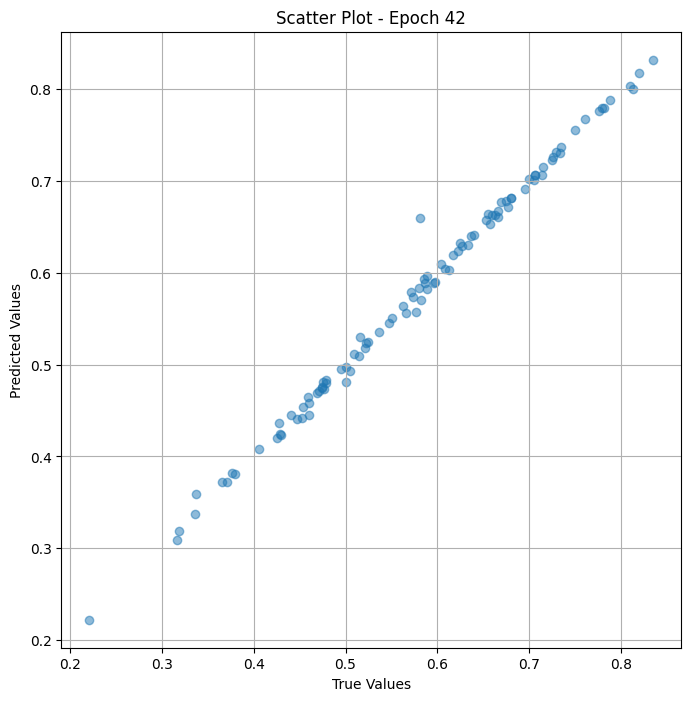


 Epoch: (43/50) Loss = 4.562889159842598e-07

 Epoch: (43/50) Loss_rmse = 0.0006754916394129395

 Epoch: (43/50) R^2 = 0.9999470710754395

 Epoch: (43/50) MAE = 0.00058746337890625

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.

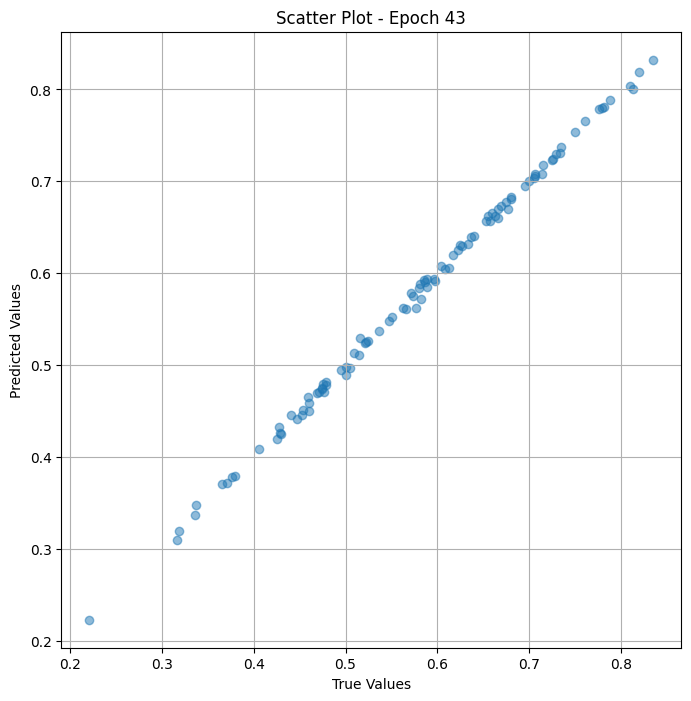


 Epoch: (44/50) Loss = 3.294517796348373e-07

 Epoch: (44/50) Loss_rmse = 0.0005739788757637143

 Epoch: (44/50) R^2 = 0.999961793422699

 Epoch: (44/50) MAE = 0.0004897266626358032

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

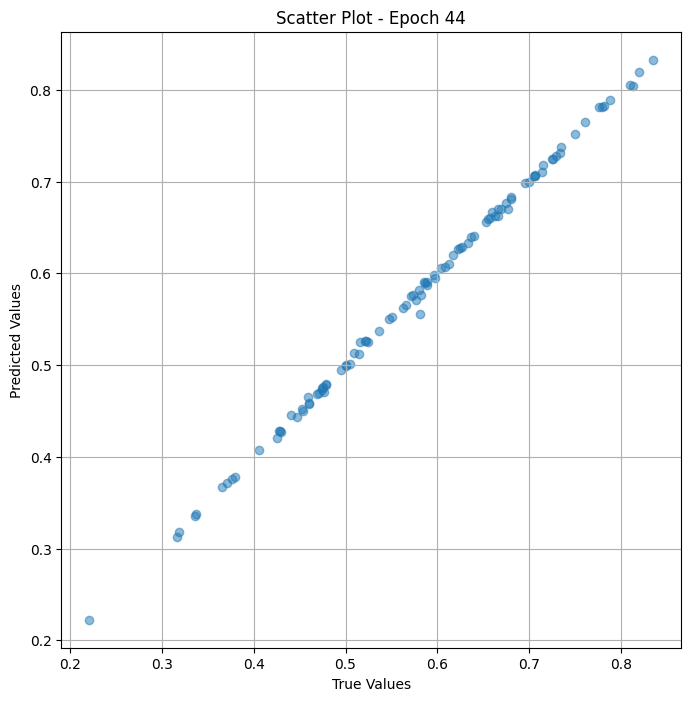


 Epoch: (45/50) Loss = 1.3084469685509248e-07

 Epoch: (45/50) Loss_rmse = 0.00036172461113892496

 Epoch: (45/50) R^2 = 0.9999848008155823

 Epoch: (45/50) MAE = 0.00030376017093658447

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.3707865

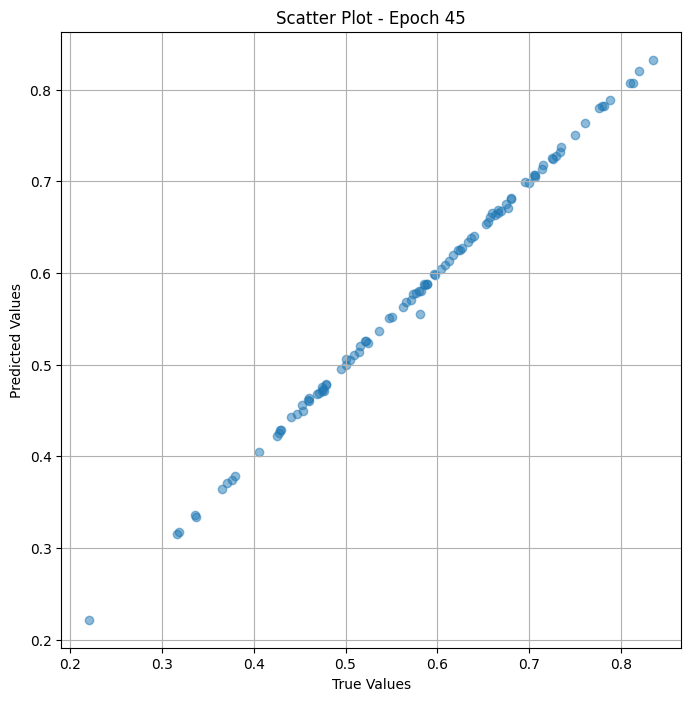


 Epoch: (46/50) Loss = 1.046994881903629e-07

 Epoch: (46/50) Loss_rmse = 0.00032357301097363234

 Epoch: (46/50) R^2 = 0.9999878406524658

 Epoch: (46/50) MAE = 0.00022374093532562256

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652

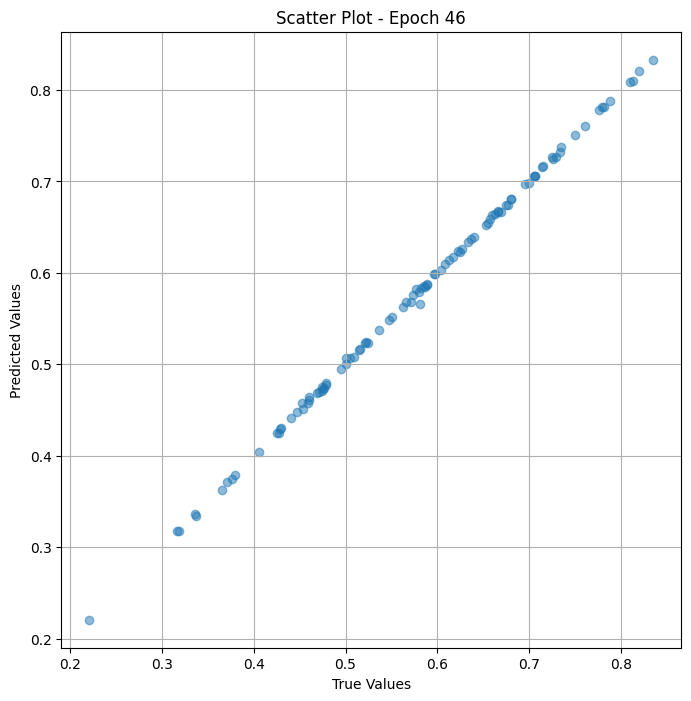


 Epoch: (47/50) Loss = 1.9105900861404734e-08

 Epoch: (47/50) Loss_rmse = 0.00013822410255670547

 Epoch: (47/50) R^2 = 0.9999977946281433

 Epoch: (47/50) MAE = 0.000118255615234375

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652,

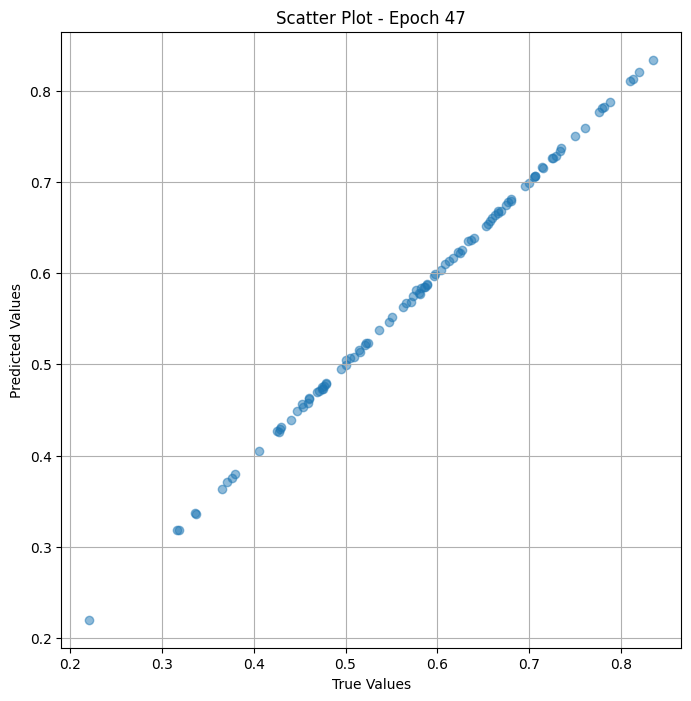


 Epoch: (48/50) Loss = 1.5550901011351925e-08

 Epoch: (48/50) Loss_rmse = 0.00012470324872992933

 Epoch: (48/50) R^2 = 0.9999982118606567

 Epoch: (48/50) MAE = 9.334087371826172e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652

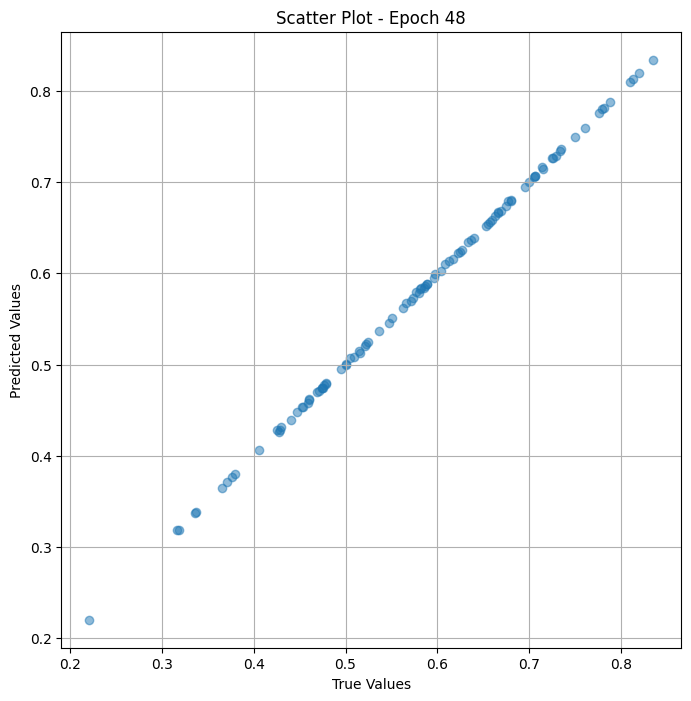


 Epoch: (49/50) Loss = 5.645865552850182e-09

 Epoch: (49/50) Loss_rmse = 7.513897435273975e-05

 Epoch: (49/50) R^2 = 0.9999993443489075

 Epoch: (49/50) MAE = 6.724894046783447e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 

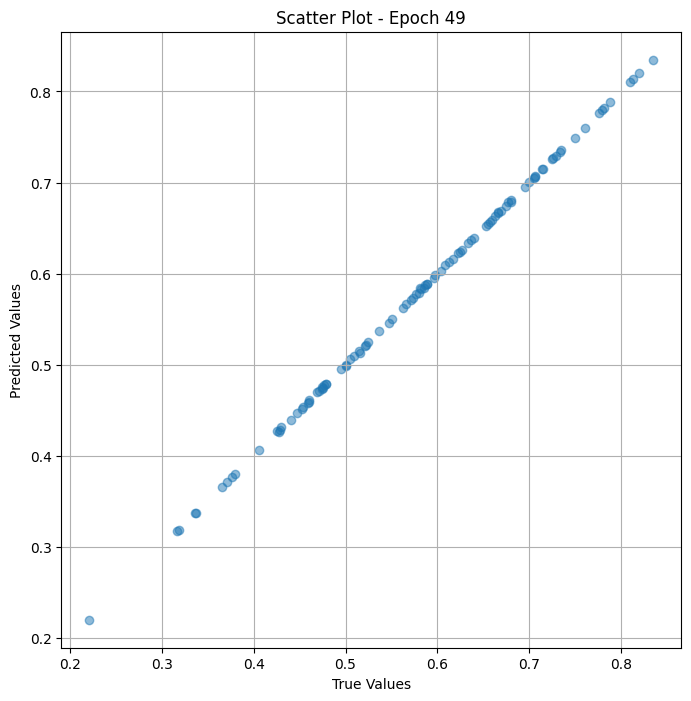


 Epoch: (50/50) Loss = 9.076734031054912e-09

 Epoch: (50/50) Loss_rmse = 9.527189831715077e-05

 Epoch: (50/50) R^2 = 0.999998927116394

 Epoch: (50/50) MAE = 8.643418550491333e-05

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0

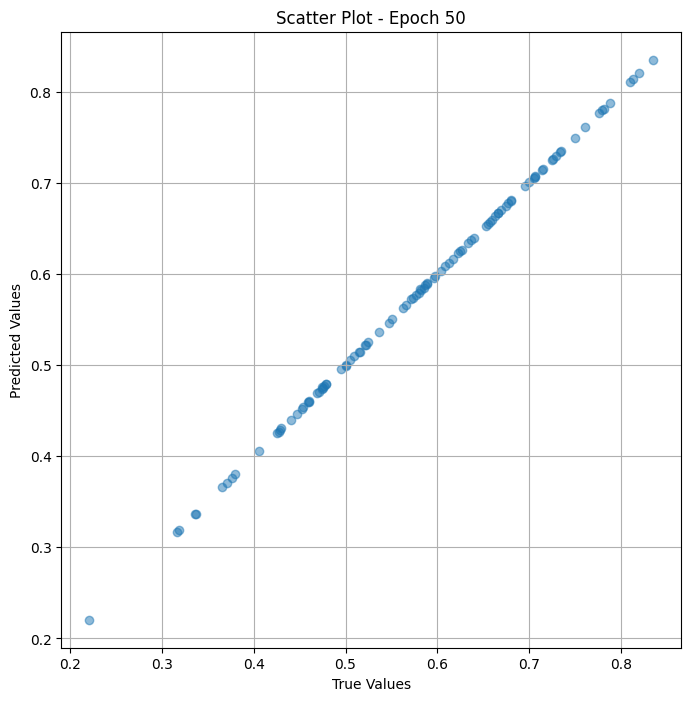

In [ ]:
# Training the model and save weights
fit(50, model_fine_test, train_dl_test)
torch.save(model_fine_test.state_dict(), "model_weights_vr_fine")

In [ ]:
import numpy as np
from scipy.stats import spearmanr

true_values_list = [0.53636366, 0.5869565, 0.70642203, 0.509434, 0.7263158, 0.6597938, 0.5154639, 0.47524753, 0.5217391, 0.43, 0.70526314, 0.52427185, 0.5769231, 0.76106197, 0.4742268, 0.51428574, 0.5, 0.72527474, 0.6168224, 0.42553192, 0.6037736, 0.6122449, 0.22093023, 0.46, 0.5471698, 0.70652175, 0.71568626, 0.4742268, 0.6666667, 0.33653846, 0.8131868, 0.45918366, 0.5855856, 0.5510204, 0.776699, 0.57954544, 0.62637365, 0.8105263, 0.31683168, 0.47058824, 0.6086956, 0.42718446, 0.4691358, 0.42857143, 0.6571429, 0.78, 0.4528302, 0.6339286, 0.58181816, 0.6226415, 0.58928573, 0.6960784, 0.597561, 0.78125, 0.6395349, 0.7, 0.57391304, 0.37634408, 0.6770833, 0.52272725, 0.67469877, 0.7352941, 0.5816327, 0.38, 0.5046729, 0.7294118, 0.37078652, 0.33620688, 0.73333335, 0.4787234, 0.47663552, 0.71428573, 0.8202247, 0.56565654, 0.44660193, 0.83516484, 0.31868133, 0.45348838, 0.75, 0.66964287, 0.6528926, 0.5625, 0.65555555, 0.5882353, 0.5959596, 0.4408602, 0.5, 0.625, 0.63716817, 0.5714286, 0.7878788, 0.46067417, 0.68, 0.36585367, 0.6666667, 0.4059406, 0.47916666, 0.68085104, 0.49514562, 0.6632653]

predicted_values_list = [0.43740878, 0.913644, 0.65984434, 0.41508242, 0.7096201, 0.895109, 0.4749887, 0.874591, 0.5516597, 0.45418343, 0.6860149, 0.4909877, 0.5663074, 0.92727244, 0.42122746, 0.56458515, 0.48132205, 0.7497263, 0.8295983, 0.41041633, 0.65510297, 0.54104155, 0.19026004, 0.39210784, 0.57729924, 0.7795963, 0.09617399, 0.45486808, 0.60995007, 0.011440725, 0.788647, 0.7292453, 0.5641847, 0.52705884, 0.9029469, 0.558862, 0.61529154, 0.8102769, 0.43815267, 0.56099284, 0.5997581, 0.45805457, 0.88797766, 0.30078334, 0.9585988, 0.74542356, 0.46391144, 0.9850466, 0.56371635, 0.59552044, 0.65554917, 0.7031303, 0.59756064, 0.6034202, 0.5877052, 0.718641, 0.5702519, 0.42159975, 0.6395284, 0.38413325, 0.6877181, 0.80391926, 0.99082667, 0.30960572, 0.47346658, 0.92152965, 0.2599688, 0.32201302, 0.70515966, 0.45199278, 0.5775932, 0.69545454, 0.8460046, 0.695631, 0.47913975, 0.79258, 0.30558398, 0.40532818, 0.6906662, 0.6570191, 0.6241218, 0.5190113, 0.72777754, 0.6010221, 0.61722267, 0.3390499, 0.5443525, 0.60052246, 0.62528145, 0.5402176, 0.7542167, 0.46623877, 0.6723315, 0.32533336, 0.6803987, 0.7185844, 0.4563549, 0.69541204, 0.4806975, 0.6966369]

spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.7364662748537892 2.506685417472619e-18
